In [1]:
import pandas as pd
import numpy as np
import numpy.ma as ma
from astropy.stats import sigma_clip
from scipy.constants import pi, parsec, c
import matplotlib.pyplot as plt
import seaborn as sns
import hacktools
import hackprocessing as hp
import lightgbm as lgbm  # need to reinstall/update (or use mlearn env)
from usefulfuncs import estimate_density

plt.style.use('onedork')
%load_ext autoreload
pd.options.display.max_columns = 99

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/lightgbm/__init__.py:46: UserWarning: Starting from version 2.2.1, the library file in distribution wheels for macOS is built by the Apple Clang (Xcode_9.4.1) compiler.
This means that in case of installing LightGBM from PyPI via the ``pip install lightgbm`` command, you don't need to install the gcc compiler anymore.
Instead of that, you need to install the OpenMP library, which is required for running LightGBM on the system with the Apple Clang compiler.
You can install the OpenMP library by the following command: ``brew install libomp``.
  "You can install the OpenMP library by the following command: ``brew install libomp``.", UserWarning)


In [2]:
%autoreload
ht = hacktools.HackTools()
ht.read_meta('metadata_refit_valid.csv', name='valid')
ht.read_meta('metadata_refit.csv', name='full')
ht.read_meta('data/metadata/metadata_morph_cumprobs.tsv', name='metamorph')

In [4]:
df_meta = ht.get_meta('valid')
print(df_meta.shape)
df_meta.head()

(73627, 26)


,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89
1237662500543987740,242.00880,36.05398,0.562341,0.0658,46.129129,282.000016,0.546870,1.192938,10.439780,0.044860,1.748155e+10,1.137885e+08,True,True,2.752836e+10,2.843540e+09,1.574709,0.162659,16.988,15.997,1.775870,242.008785,36.053987,0.557186,1.315225,63.55
1237662474235085097,251.31645,25.60003,0.512861,0.0681,43.540800,291.857134,0.565985,1.540025,9.999021,0.040437,9.267565e+09,5.920384e+07,True,True,9.977489e+09,9.289901e+08,1.076603,0.100241,17.715,16.918,1.205651,251.316496,25.600029,0.510505,3.539973,42.81


In [5]:
df_full = ht.get_meta('full')

In [6]:
df_metamorph = ht.get_meta('metamorph')
print(df_metamorph.shape)
df_metamorph.head()

(73627, 396)


,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,modelMag_u,modelMag_r,modelMag_z
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,20.35955,17.40932,16.63860
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,19.38518,17.61691,17.15460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,17.51221,16.00672,15.59723
1237662500543987740,242.00880,36.05398,

In [7]:
# progress bar
def log_progress(sequence, every=None, size=None, name='Items'):
    from ipywidgets import IntProgress, HTML, VBox
    from IPython.display import display

    is_iterator = False
    if size is None:
        try:
            size = len(sequence)
        except TypeError:
            is_iterator = True
    if size is not None:
        if every is None:
            if size <= 200:
                every = 1
            else:
                every = int(size / 200)     # every 0.5%
    else:
        assert every is not None, 'sequence is iterator, set every'

    if is_iterator:
        progress = IntProgress(min=0, max=1, value=1)
        progress.bar_style = 'info'
    else:
        progress = IntProgress(min=0, max=size, value=0)
    label = HTML()
    box = VBox(children=[label, progress])
    display(box)

    index = 0
    try:
        for index, record in enumerate(sequence, 1):
            if index == 1 or index % every == 0:
                if is_iterator:
                    label.value = '{name}: {index} / ?'.format(
                        name=name,
                        index=index
                    )
                else:
                    progress.value = index
                    label.value = u'{name}: {index} / {size}'.format(
                        name=name,
                        index=index,
                        size=size
                    )
            yield record
    except:
        progress.bar_style = 'danger'
        raise
    else:
        progress.bar_style = 'success'
        progress.value = index
        label.value = "{name}: {index}".format(
            name=name,
            index=str(index or '?')
        )

# Exploration

## Sample weights

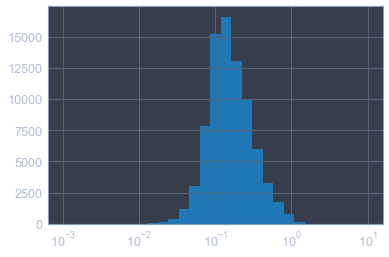

In [9]:
bins = np.logspace(-3, 1, 30)
df_meta.ML_bayes_err.hist(bins=bins)
plt.xscale('log')

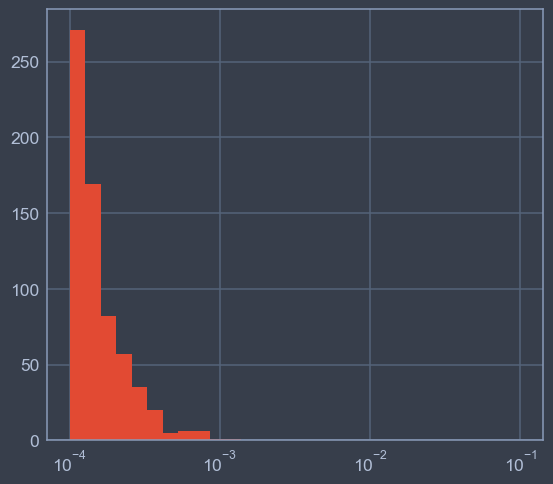

In [76]:
ml_err = np.maximum(df_meta['ML_bayes_err'], 0.05 * df_meta['ML_bayes'])
ml_err = ml_err[df_meta['reduced_chi_square'] < 5]
w = 1 / np.square(ml_err)
w /= w.sum()
bins = np.logspace(-4, -1, 30)
w.hist(bins=bins)
plt.xscale('log')

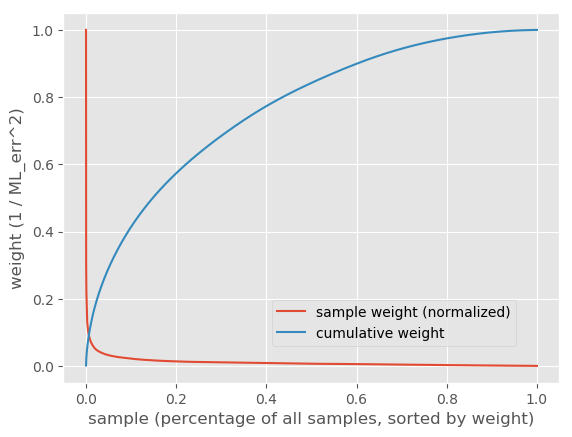

In [80]:
weightsort = np.sort(w)[::-1]
sampleperc = np.linspace(0, 1, num=len(weightsort))
weightcum = np.cumsum(weightsort)
weightsortnorm = weightsort / weightsort[0]
with plt.style.context(['default', 'ggplot']):
    plt.plot(sampleperc, weightsortnorm, label='sample weight (normalized)')
    plt.plot(sampleperc, weightcum, label='cumulative weight')
    plt.xlabel('sample (percentage of all samples, sorted by weight)')
    plt.ylabel('weight (1 / ML_err^2)')
    plt.legend(loc=(0.42,0.1))
    plt.savefig('plots/metadata/sample_weights.pdf')
    plt.show()

In [12]:
df_full.head()

,RA,DEC,D25,redshift,logMstar,err_logMstar,GalSize_kpc,D_Mpc,d_pix_kpc,ML_g,ML_i,ML_g_rel_err,ML_i_rel_err,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,petroMag_g,petroMagErr_g,petroMag_i,petroMagErr_i,ML_g_zibetti,hasimg,isgalaxy
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,
1237652947452297303,0.84015,-9.98328,0.524807,0.0767,11.312,0.016,50.181627,328.714294,0.637461,3.454194,2.535231,0.038462,0.037361,0.840174,-9.983275,0.522396,1.489361,13.61,16.08249,0.008462,14.72806,0.006688,5.510479,False,True
1237652899137912944,1.00260,-11.17802,0.616595,0.0383,9.708,0.071,29.440700,164.142858,0.318315,0.546950,0.960530,0.169947,0.171029,1.002601,-11.178018,0.622300,1.698244,12.10,16.58351,0.033600,16.17631,0.051881,0.243054,False,True
1237661433779716229,211.48905,43.88251,0.758578,0.0337,9.260,0.062,31.869792,144.428574,0.280084,0.483092,0.692986,0.146810,0.146034,211.488998,43.882507,0.756833,3.155005,155.59,17.29087,0.024682,16.66400,0.030830,0.501246,False,True
1237664668967108672,142.38180,31.96324,0.416869,0.0425,9.401,0.021,22.087078,182.142859,0.353221,0.517802,0.694433,20.603089,1.058870,142.381732,31.963244,0.416869,3.162278,140.70,17.51750,3.662392,16.81756,1.000653,0.637697,False,True
1237656494040678605,1.79835,13.76842,0.537032,0.0179,9.224,0.033,11.984016,76.714283,0.148769,0.588344,0.865952,0.086919,0.078625,1.798401,13.768416,0.537032,2.648500,162.93,16.22099,0.032295,15.62204,0.021630,0.457191,False,True


(0, 25)

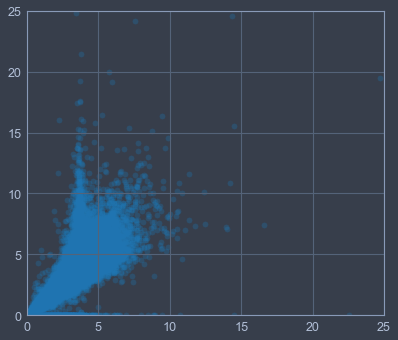

In [14]:
ml_val = df_meta['ML_bayes']
ml_full = df_full.loc[ml_val.index, 'ML_g']
plt.scatter(ml_val, ml_full, alpha=0.3)
plt.xlim([0, 25])
plt.ylim([0, 25])

## Check if image procesing went well

In [5]:
df_imgfeats = pd.read_csv('/Volumes/nancy/astrohack/data/imgfeatures_scauto_incep/img_feats.tsv', sep='\t',
                          index_col='SDSS_ID')
print(df_imgfeats.shape)
df_imgfeats.head()

(73530, 16)


,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.max,post.min,post.std,post.center,post.mean.center
SDSS_ID,,,,,,,,,,,,,,,,
1237658802570789037,8.714087e+07,1259.825478,154676.261632,-5379.851464,5238.528138,137870.213417,125730.706351,263,77.066806,10700.10,0.119687,1.0,0.0,0.123846,0.963935,0.957154
1237668671327567885,1.209642e+07,399.538306,24526.501911,-2639.526403,1799.169956,23135.798119,21622.482522,174,21.735497,8631.71,0.096550,1.0,0.0,0.150640,0.990343,0.987101
1237654653644112020,1.242024e+07,590.736670,64869.100412,-3176.805225,2314.813430,61678.097327,46126.293966,145,47.197297,8955.43,0.100171,1.0,0.0,0.107985,0.953918,0.934827
1237665531723317728,7.523004e+06,497.257233,169243.193853,-1460.152686,4909.532164,149629.031569,101997.849319,123,882.376197,9831.98,0.109976,1.0,0.0,0.143450,0.950789,0.937829
1237658423552114703,1.463927e+07,609.334995,185411.726971,-1952.178025,3852.500691,185411.726971,105551.280210,155,474.691176,10751.10,0.120257,1.0,0.0,0.139301,0.973463,0.951860


In [6]:
import os
from ipywidgets import interact

def std_scale(x):
    xmin = x.min()
    return (x - xmin) / (x.max() - xmin)
processdir = '/Volumes/nancy/astrohack/data/processed_scauto_incep/'

def compare_processed(idx):
    sdss_id = str(df_meta.index[idx])
    img_proc = np.load(processdir + sdss_id + '_processed.npy')[:, :, 0]
    img_raw = ht.get_galaxydata(sdss_id)
    f, axarr = plt.subplots(ncols=3, figsize=(14, 5))
    scaleval = df_imgfeats.loc[int(sdss_id), "pre.scaleval"]
    print(img_raw.min(), img_raw.max())
    print(img_proc.min(), img_proc.max())
    print(f'scaleval {scaleval}')
    axarr[0].imshow(img_raw)
    axarr[0].set_title('raw')
    axarr[1].imshow(np.log10(1 + scaleval * img_raw))
    axarr[1].set_title('logged')
    axarr[2].imshow(img_proc)
    axarr[2].set_title('processed')
    plt.show()
interact(compare_processed, idx=(0, 30, 1))

interactive(children=(IntSlider(value=15, description='idx', max=30), Output()), _dom_classes=('widget-interact',))

<function __main__.compare_processed>

In [58]:
import hackprocessing as hp
sdss_id = df_meta.index[0]
xraw = hp.read_image(sdss_id)
x_meta = df_meta.loc[sdss_id]
a_maj = x_meta['GalSize_kpc'] / x_meta['d_pix_kpc']
r25 = x_meta['R25_leda']
if np.isnan(r25):
    r25 = 1
pa = x_meta['pa_leda']
angle = pa - 90
fix_sv = False
scaleval = 'auto' if not fix_sv else 10.41
x_sc = hp.scale_image(xraw, scaleval=scaleval, ellipse_kwargs={'a_maj': a_maj, 'a_min': a_maj / r25, 
                                                           'angle': angle * pi / 180}, 
                                        scaleval_kwargs={'eps': 1e-3})
x_crop = hp.crop_image(x_sc, a_maj)

0.0 0.31486


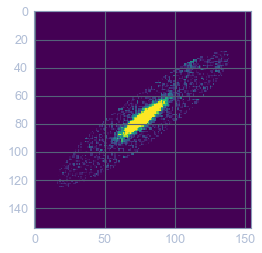

In [82]:
x_cust = xraw.copy()
x_cust[x_cust < 0] = 0
x_cust = hp.keep_ellipse(x_cust, a_maj, a_maj/r25, angle * pi / 180)
print(x_cust.min(), x_cust.max())
#x_cust = hp.std_scale(x_cust)
xmin, xmax = x_cust.min(), x_cust.max()
x_cust = (x_cust - xmin) / (xmax - xmin)
x_cust = np.clip(x_cust, xmin, xmax)
#x_cust = np.log10(1 + 10.41 * x_cust * 0.315)
plt.imshow(x_cust)

## Meta luminosity vs image luminosity

In [93]:
from astropy.io import fits
L_g_sun = 3.8935298980711754365983040493576929289761207847701E11
imgdir = 'data/sdss_ellipse_ssub/'
def img_lum(sdss_id, ellipse_only=False):
    '''Returns image luminosity in Jy'''
    
    try:
        filename = f'{imgdir}{sdss_id}_Ssub.fits'
        x = fits.getdata(filename)
    except FileNotFoundError as e:
        print(f'{sdss_id} not found!')
        return np.nan
    if ellipse_only:
        x_meta = df_meta.loc[sdss_id]
        a_maj = x_meta['GalSize_kpc'] / x_meta['d_pix_kpc']
        r25 = x_meta['R25_leda']
        if np.isnan(r25):
            r25 = 1
        angle = x_meta['pa_leda'] - 90
        x = hp.keep_ellipse(x, a_maj, a_maj/r25, angle*pi/180)
    return 3.631e-6 * x.sum()

def img_lum_raw(sdss_id):
    return img_lum(sdss_id, False)
def img_lum_ellipse(sdss_id):
    return img_lum(sdss_id, True)

In [56]:
fluxs_meta = (df_meta['L_g_bayes'] * L_g_sun * 1e26 / 
              (4 * pi * np.square(df_meta['D_Mpc'] * 1e6 * parsec)))

In [66]:
%%time  # 4 min als je effectief gewoon de bestandsnaam gebruikt ipv die te zoeken
from multiprocessing import Pool
p = Pool()
fluxs_img_raw = p.map(img_lum_raw, df_meta.index)
fluxs_img_raw = pd.Series(fluxs_img_raw, index=df_meta.index)

1237662199888150767 not found!
1237657589244493861 not found!
1237656240625287429 not found!
1237671958588227741 not found!
1237662637448495521 not found!
1237655109448106079 not found!
1237662503754727790 not found!
1237661387616813317 not found!
1237659131681177831 not found!
1237660765380870215 not found!
1237661136887087160 not found!
1237662224061431906 not found!
1237664668974186560 not found!
1237661138496323675 not found!
1237661384384774337 not found!
1237660342861496486 not found!
1237660342861430868 not found!
1237664819287621702 not found!
1237664295298531529 not found!
1237660635452670026 not found!
1237661353241477230 not found!
1237658299523268724 not found!
1237654948914200909 not found!
1237652598493544679 not found!
1237663238739329061 not found!
1237661387602460874 not found!
1237648703525814811 not found!
1237665548888047792 not found!
1237663542609707303 not found!
1237664668976808133 not found!
1237666406845382706 not found!
1237667781201756310 not found!
12376593

In [76]:
# Save
fluxs_img_raw.name = 'fluxs_img_raw'
fluxs_img_raw.index.name = 'SDSS_ID'
fluxs_img_raw.to_csv('data/flux_img_raw.tsv', sep='\t', header=True)

In [101]:
p = Pool()
fluxs_img_ell = p.map(img_lum_ellipse, df_meta.index)
fluxs_img_ell = pd.Series(fluxs_img_ell, index=df_meta.index)

1237662199888150767 not found!
1237657589244493861 not found!
1237656240625287429 not found!
1237671958588227741 not found!
1237662637448495521 not found!
1237662503754727790 not found!
1237661387616813317 not found!
1237659131681177831 not found!
1237660765380870215 not found!
1237661136887087160 not found!
1237662224061431906 not found!
1237664668974186560 not found!
1237661138496323675 not found!
1237661384384774337 not found!
1237660342861496486 not found!
1237660342861430868 not found!
1237664819287621702 not found!
1237664295298531529 not found!
1237660635452670026 not found!
1237655109448106079 not found!
1237661353241477230 not found!
1237658299523268724 not found!
1237654948914200909 not found!
1237652598493544679 not found!
1237663238739329061 not found!
1237661387602460874 not found!
1237648703525814811 not found!
1237665548888047792 not found!
1237664668976808133 not found!
1237663542609707303 not found!
1237667781201756310 not found!
1237666406845382706 not found!
12376593

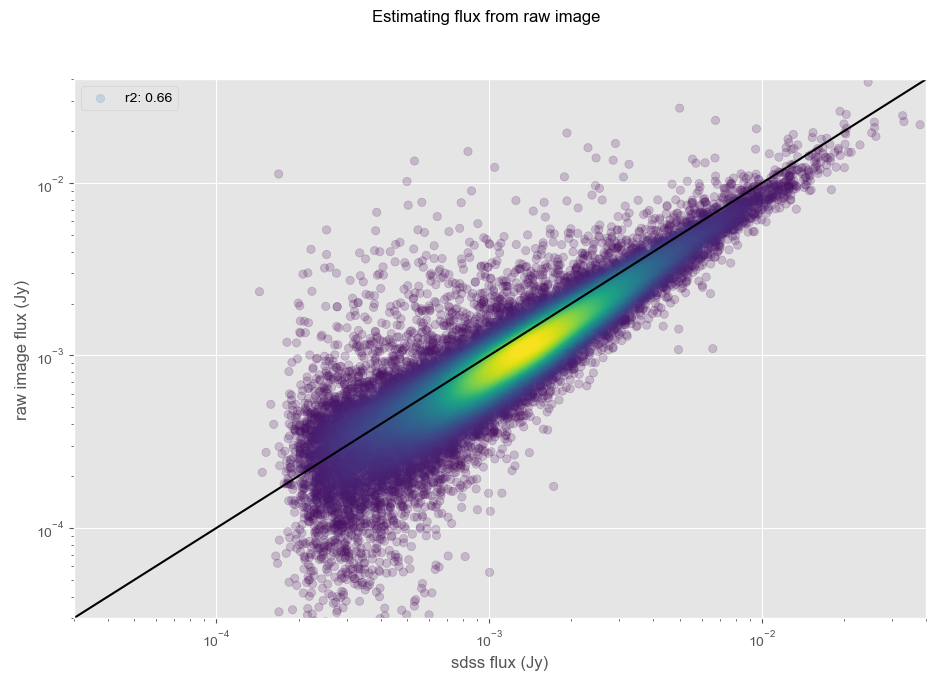

In [124]:
from sklearn.metrics import r2_score
with plt.style.context(['default', 'ggplot']):
    plt.figure(figsize=(11, 7))
    idx = fluxs_img_raw > 0
    r2 = r2_score(np.log10(fluxs_meta.loc[idx]), np.log10(fluxs_img_raw.loc[idx]))
    x, y, c = estimate_density(fluxs_meta.loc[idx], fluxs_img_raw.loc[idx], logspace=True,
                               subSample=30000)
    plt.scatter(x, y, c=c, alpha=0.2, label=f'r2: {r2:.2f}')
    plt.legend()
    plt.xscale('log')
    plt.yscale('log')
    rnge = [3e-5, 4e-2]
    plt.xlim(rnge)
    plt.ylim(rnge)
    plt.plot(rnge, rnge, 'k')
    plt.xlabel('sdss flux (Jy)')
    plt.ylabel('raw image flux (Jy)')
    plt.suptitle('Estimating flux from raw image')
    plt.savefig('plots/preprocessing/estimating_flux_raw_img.png')

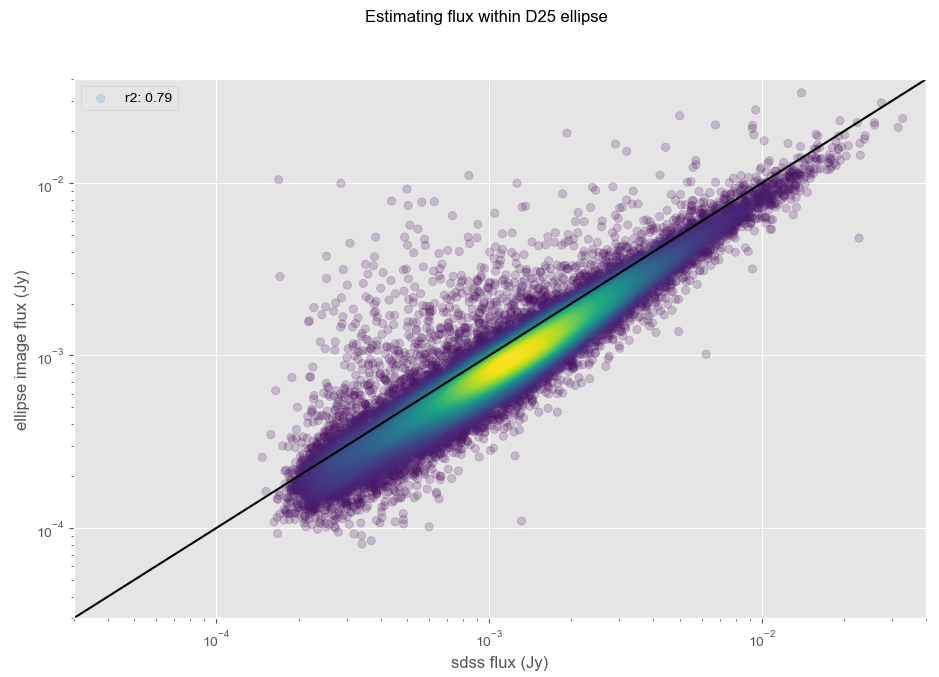

In [125]:
with plt.style.context(['default', 'ggplot']):
    plt.figure(figsize=(11, 7))
    idx = fluxs_img_raw > 0
    r2 = r2_score(np.log10(fluxs_meta.loc[idx]), np.log10(fluxs_img_ell.loc[idx]))
    x, y, c = estimate_density(fluxs_meta.loc[idx], fluxs_img_ell.loc[idx], logspace=True,
                               subSample=30000)
    plt.scatter(x, y, c=c, alpha=0.2, label=f'r2: {r2:.2f}')
    plt.legend()
    plt.xscale('log')
    plt.yscale('log')
    rnge = [3e-5, 4e-2]
    plt.xlim(rnge)
    plt.ylim(rnge)
    plt.plot(rnge, rnge, 'k')
    plt.xlabel('sdss flux (Jy)')
    plt.ylabel('ellipse image flux (Jy)')
    plt.suptitle('Estimating flux within D25 ellipse')
    plt.savefig('plots/preprocessing/estimating_flux_ellipse_img.png')

## log M distribution

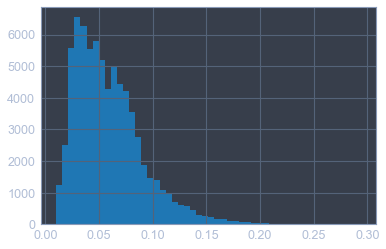

In [11]:
df_metamorph['redshift'].hist(bins=50)

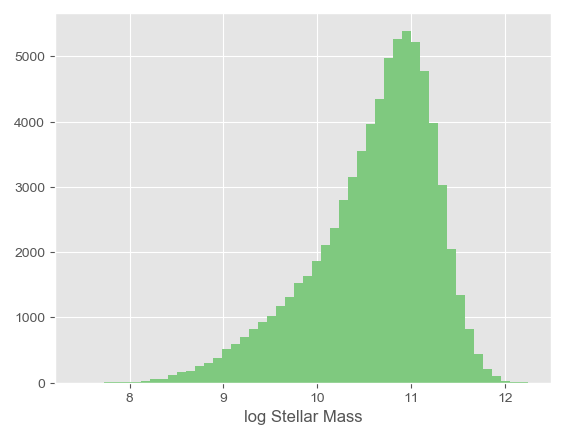

In [16]:
with plt.style.context(['default', 'ggplot']):
    df_metamorph['logM_bayes'].hist(bins=50, color='#7fc97f')
    plt.xlabel('log Stellar Mass')
    plt.savefig('plots/metadata/logM_hist.pdf')

In [17]:
np.median(df_metamorph['logM_bayes'])

10.7285240926

## Malmquist bias of M/L distribution

In [6]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.502520,0.199998
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.176818,0.340460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.990084,0.811851
1237662500

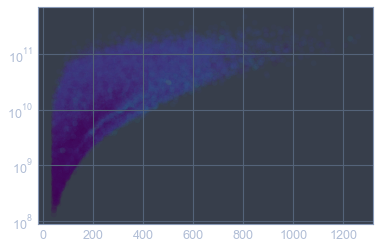

In [9]:
lum = df_metamorph['L_g_bayes']
d = df_metamorph['D_Mpc']
ml = df_metamorph['ML_bayes']
plt.scatter(d, lum, c=ml, alpha=0.1)
plt.yscale('log')

In [12]:
d.describe()

count    73627.000000
mean       254.409085
std        136.953922
min         42.857142
25%        149.142859
50%        228.857137
75%        326.571433
max       1258.714327
Name: D_Mpc, dtype: float64

In [38]:
np.log10(lum).describe()

count    73627.000000
mean        10.239789
std          0.471964
min          8.121636
25%          9.950446
50%         10.297011
75%         10.579898
max         11.668494
Name: L_g_bayes, dtype: float64

number treshold 295


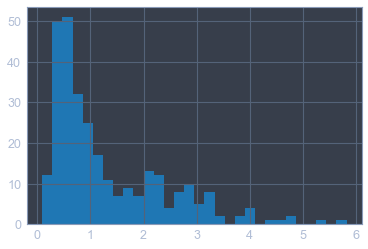

In [62]:
mind = 0
maxd = 50
minl = 0
maxl = np.inf
minml = 0
maxml = 100
b_bins = (d > mind) & (d < maxd) & (np.log10(lum) > minl) & (np.log10(lum) < maxl)
binml = ml[b_bins]
print('number treshold', len(binml))
binml.hist(bins=30)
if minml > 0:
    plt.axvline(x=minml, c='r')
if maxml < 10:
    plt.axvline(x=maxml, c='r')

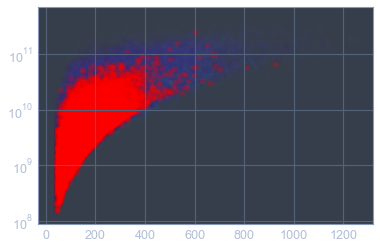

In [28]:
b_ml = (ml > minml) & (ml < maxml)
plt.scatter(d, lum, c=ml, alpha=0.05)
plt.scatter(d[b_ml], lum[b_ml], c='r', alpha=0.25)
plt.yscale('log')

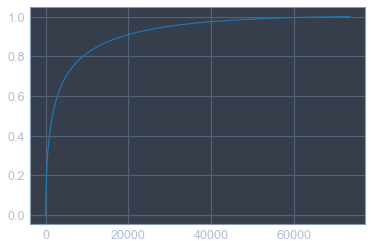

In [52]:
weights = np.power(lum, -3/2).copy()
weights = weights.sort_values(ascending=False) / np.sum(weights)
w_cumsum = np.cumsum(weights)
plt.plot(list(range(len(weights))), w_cumsum)

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6571: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


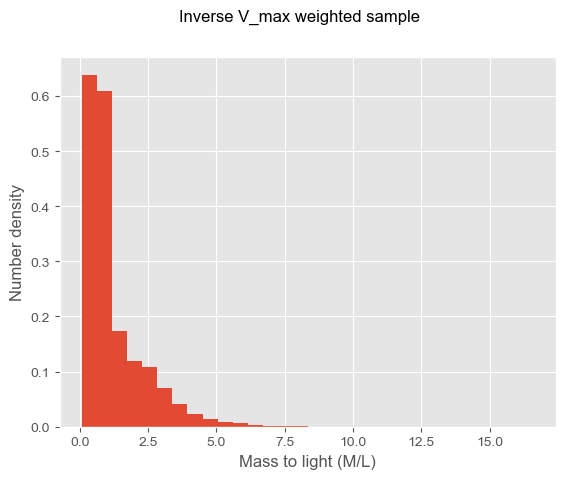

In [59]:
with plt.style.context(['default', 'ggplot']):
    plt.hist(ml, bins=30, weights=np.power(lum, -3/2), normed=True);
    plt.xlabel('Mass to light (M/L)')
    plt.ylabel('Number density')
    plt.suptitle('Inverse V_max weighted sample')
    plt.savefig('plots/)

## Mismatches

In [7]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,modelMag_u,modelMag_r,modelMag_z
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,20.35955,17.40932,16.63860
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,19.38518,17.61691,17.15460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,17.51221,16.00672,15.59723
1237662500543987740,242.00880,36.05398,

In [12]:
mismatch_dist = df_metamorph['dist_gz2']
mismatch_dist.shape

(73627,)

In [9]:
1/3600

0.0002777777777777778

In [13]:
np.sum(mismatch_dist < (1/3600))

58716

In [14]:
np.sum(mismatch_dist < (1e-3))

58966

In [15]:
58716 / 58966

0.9957602686293796

In [17]:
np.sum(mismatch_dist > (10/3600))

14518

In [16]:
np.sum(mismatch_dist > (1e-3))

14661

In [18]:
14518/14661

0.9902462314985335

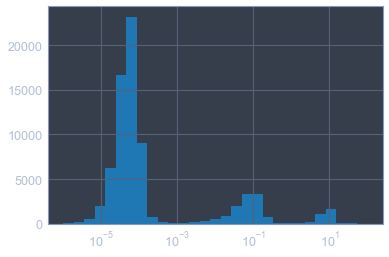

In [8]:
bins = np.logspace(-6, 2, 30)
plt.hist(mismatch_dist, bins=bins)
plt.xscale('log')

# Feature transformations

## Log scaling -- scale factor
http://ds9.si.edu/doc/ref/how.html

Good examples:
* 1237652629098594325
* 1237662307810213986  (for this one, scaleval has to be at least 100)
* 1237662504296120502  (for this one, scaleval would be better if it was < 100)
* 1237662263250190354  (very little background noise)
* 1237662336261227045  (a lot of background noise)

Possible improvement: using a variable scalefactor. Use sigma clipping to only keep galaxy pixels, then compute mean (or median) brightness. Basically, the background should always be dark and the galaxy bright.

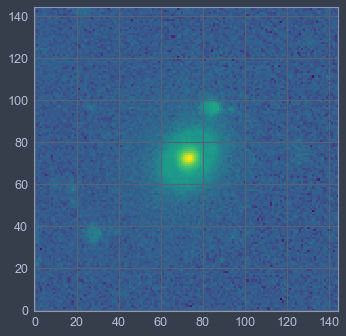

In [207]:
ht.plot_galaxy(1237662268609265671)

In [12]:
df_meta.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89
1237662500543987740,242.00880,36.05398,0.562341,0.0658,46.129129,282.000016,0.546870,1.192938,10.439780,0.044860,1.748155e+10,1.137885e+08,True,True,2.752836e+10,2.843540e+09,1.574709,0.162659,16.988,15.997,1.775870,242.008785,36.053987,0.557186,1.315225,63.55
1237662474235085097,251.31645,25.60003,0.512861,0.0681,43.540800,291.857134,0.565985,1.540025,9.999021,0.040437,9.267565e+09,5.920384e+07,True,True,9.977489e+09,9.289901e+08,1.076603,0.100241,17.715,16.918,1.205651,251.316496,25.600029,0.510505,3.539973,42.81


scaleval 86.42, xmin 0, xmax 1.7107813358306885


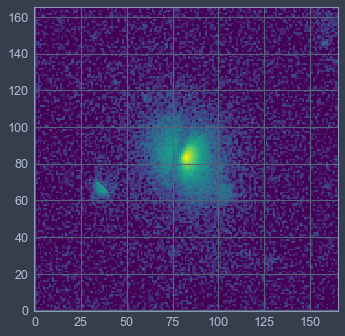

In [21]:
%autoreload
ht.plot_galaxy(1237667253453390234, ellipse_mode='removeneg')

In [20]:
df_features.loc[1237667253453390234, 'pre.scaleval']

86.4225408087

In [18]:
from ipywidgets import interact
def plot_gal(i):
    sdssid = df_metamorph.index[i]
    ht.plot_galaxy(sdssid)
    plt.title(sdssid)
    
interact(plot_gal, i=(0, 1000))

interactive(children=(IntSlider(value=500, description='i', max=1000), Output()), _dom_classes=('widget-intera…

<function __main__.plot_gal(i)>

## Keep only ellipse

In [83]:
def keep_ellipse(img, a_maj, a_min, angle):
    """
    Removes everything outside the ellipse.
    Assumes ellipse is at center of img.
    """
    
    h, w = img.shape
    if np.isnan(a_maj) or np.isnan(a_min) or np.isnan(angle) or np.isnan(img).any():
        print("Something is nan!")
        print('amaj', a_maj, 'amin', a_min, 'angle', angle, 'img', np.isnan(img).any())
    cos, sin = np.cos(angle), np.sin(angle)
    cos_sq, sin_sq = np.square(cos), np.square(sin)
    a_sq, b_sq = np.square(a_maj), np.square(a_min)
    arr_w = np.broadcast_to(np.arange(w), (h, w)) - (w//2)
    arr_h = np.broadcast_to(np.arange(h), (w, h)).T - (h//2)
    arr_ell = (((cos_sq / a_sq) + (sin_sq / b_sq)) * np.square(arr_w)
               + 2 * cos * sin * ((1 / a_sq) - (1 / b_sq)) * arr_w * arr_h
               + ((sin_sq / a_sq) + (cos_sq / b_sq)) * np.square(arr_h))
    img_cpy = img.copy()
    img_cpy[arr_ell > 1] = 0
    return img_cpy

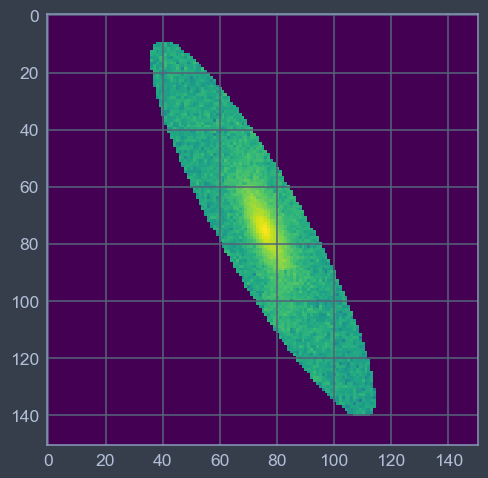

In [94]:
sample = 1237652629098594325
galsize_pix = df_meta.loc[sample, 'GalSize_kpc'] / df_meta.loc[sample, 'd_pix_kpc']
r25 = df_full.loc[sample, 'R25_leda']
pa = df_full.loc[sample, 'pa_leda']
angle = pa - 90
x = hacktools.HackTools.scale_image(ht.get_galaxydata(sample))
y = keep_ellipse(x, galsize_pix, galsize_pix / r25, angle * pi/180)
plt.imshow(y)

## Rotating

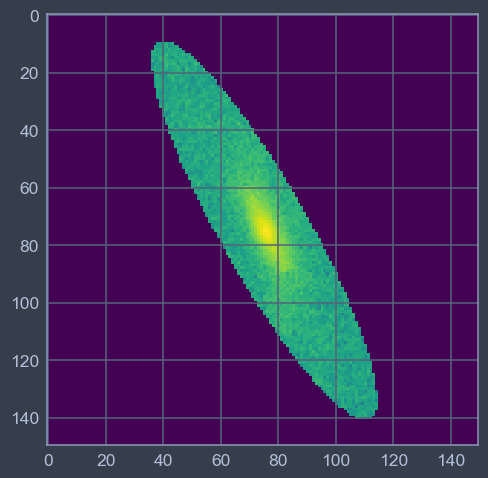

In [158]:
%autoreload
import hackprocessing as hp

y_crop = hp.crop_image(y, galsize_pix)
plt.imshow(y_crop)

(150, 150)


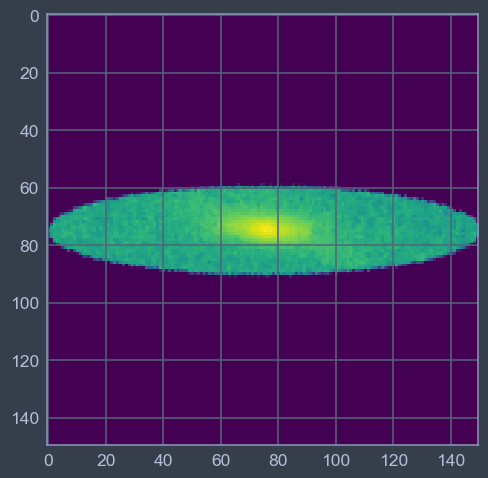

In [163]:
import cv2
h, w = y_crop.shape

M = cv2.getRotationMatrix2D((w//2, h//2),angle,1)
#M = cv2.getRotationMatrix2D((30, 40),angle,1)
#y_rot = cv2.warpAffine(y_crop,M,(w, h))
y_rot = cv2.warpAffine(y_crop,M,(w, h), flags=cv2.INTER_LINEAR)
print(y_rot.shape)
plt.imshow(y_rot)

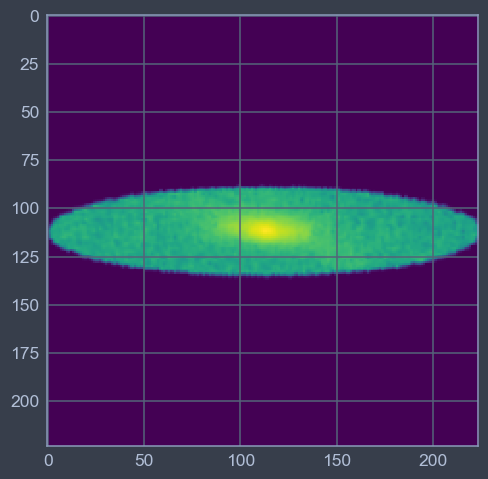

In [170]:
y_sc = cv2.resize(y_rot, (224, 224), cv2.INTER_CUBIC)
plt.imshow(y_sc)

## Which scaling is best?

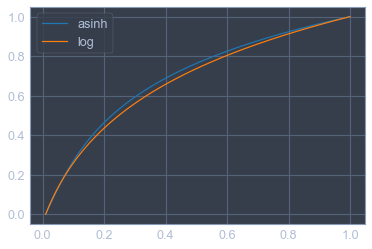

In [23]:
x = np.linspace(0.01, 1, 100)
q = 1
alph = 10
y = np.arcsinh(alph * q * x)/q
y = (y - y.min()) / (y.max() - y.min())
y2 = np.log(1+10*x)
y2 = (y2 - y2.min()) / (y2.max() - y2.min())
plt.plot(x, y, label='asinh')
plt.plot(x, y2, label='log')
plt.legend()

In [7]:
from ipywidgets import interact, IntSlider, Layout
from astropy.stats import sigma_clip
from scipy.optimize import least_squares

examples = ['1237652629098594325', '1237645943978328289', '1237645943978983683',
            '1237645943979114622', '1237645879578460255']
examples = examples + df_meta.index.astype('str')[:100].tolist()  # all galaxies

def invlogscale(y, a):
    y_norm = y * np.log10(1 + a)
    x = (np.power(10, y_norm) - 1) / a
    return x

def fit_scaleval(scaleval, noise, fixnoise=0.2):
    return (np.log10(1 + scaleval * noise) / np.log10(1 + scaleval)) - fixnoise

def noiselvl(a, noise):
    return np.log10(1 + a * noise) / np.log10(1 + a)

def find_scaleval(log_scaleval=2, ssubed=True, removeneg=False, only_ellipse=False, 
                  fix_scaleval=0, asinh=False, idx=0):
    ssubtype = 'ssub' if ssubed else 'raw'
    scaleval = np.power(10, log_scaleval)
    raw_img = ht.get_galaxydata(examples[idx], ssubtype=ssubtype)
    img = raw_img.copy()
    if only_ellipse:
        iidx = int(examples[idx])
        galsize_pix = df_meta.loc[iidx, 'GalSize_kpc'] / df_meta.loc[iidx, 'd_pix_kpc']
        r25 = df_full.loc[iidx, 'R25_leda']
        if np.isnan(r25):
            r25 = 1
        pa = df_full.loc[iidx, 'pa_leda']
        angle = (pa - 90) * pi / 180
        img = keep_ellipse(raw_img, galsize_pix, galsize_pix / r25, angle)
    h, w = raw_img.shape
    f, axarr = plt.subplots(ncols=3, figsize=(14, 4))
    # process image
    if removeneg:
        img[img < 0] = 0
    rescaled_img = (img - img.min()) / (img.max() - img.min())
    if fix_scaleval > 0:
        noise_outlvl = log_scaleval / 10.  # eg. log_scaleval 2 -> fix noise to 0.2 after log
        # Get original noise level
        img_sc = (raw_img - raw_img.min()) / (raw_img.max() - raw_img.min())
#         if removeneg or only_ellipse:
#             img_sc = ma.masked_where(img_sc <= 0, img_sc)
        img_sc = sigma_clip(img_sc, sigma=2, iters=5)
        noise_mean = 0 if removeneg else img_sc.mean()
        noise_std = img_sc.std()
        noise = noise_mean + (noise_std * fix_scaleval)
        # Fit scaleval
        res = least_squares(fit_scaleval, np.array(100), bounds=([0.1, 1e4]), 
                            args=(noise, noise_outlvl))
        scaleval = res.x[0]
        print(f'Sigma clipped image stats. Std: {noise_std:.4f}. '
              f'Mean: {noise_mean:.4f}. ')
        print(f'Fixed scaleval at {scaleval:.2f}. '
              f'The noise went from {noise:.2f} to {noiselvl(scaleval, noise):.4f} '
              f'(target: {noise_outlvl:.2f}) after logging.')
    if not asinh:
        logged_img = np.log10(1 + (scaleval * rescaled_img))
    else:
        logged_img = np.arcsinh(0.06 * 3.5 * rescaled_img) / 3.5
    logged_img = (logged_img - logged_img.min()) / (logged_img.max() - logged_img.min())
    # image
    axarr[0].imshow(logged_img, origin='lower')
    # center row
    arr_w = np.array(range(w))
    axarr[1].plot(arr_w, rescaled_img[h//2, :], c='C0')
    axarr[1].plot(arr_w, logged_img[h//2, :], 'r', alpha=0.7)
    zeropoint = - raw_img.min() / (raw_img.max() - raw_img.min())
    axarr[1].axhline(zeropoint, c='k')  # old zeropoint, recentered
    if fix_scaleval > 0:
        axarr[1].axhline(noise, c='b')  # noiselevel
    # log scale
    axtwin = axarr[1].twiny()
    stdrange = np.linspace(0, 1, 100)
    axtwin.plot(stdrange, invlogscale(stdrange, scaleval), 'g--')
    # pixel hist
    axarr[2].hist(rescaled_img.flatten(), bins=20)
    axarr[2].set_yscale('log', nonposy='clip')
interact(find_scaleval, log_scaleval=(0, 5, 1), ssubed=True, removeneg=False,
         only_ellipse=False, fix_scaleval=(0., 4., 0.5), asinh=False,
         idx=IntSlider(min=0, max=len(examples) - 1, layout=Layout(width='100%')))

interactive(children=(IntSlider(value=2, description='log_scaleval', max=5), Checkbox(value=True, description='ssubed'), Checkbox(value=False, description='removeneg'), Checkbox(value=False, description='only_ellipse'), FloatSlider(value=0.0, description='fix_scaleval', max=4.0, step=0.5), Checkbox(value=False, description='asinh'), IntSlider(value=0, description='idx', layout=Layout(width='100%'), max=104), Output()), _dom_classes=('widget-interact',))

<function __main__.find_scaleval(log_scaleval=2, ssubed=True, removeneg=False, only_ellipse=False, fix_scaleval=0, asinh=False, idx=0)>

### Influence of scaleval

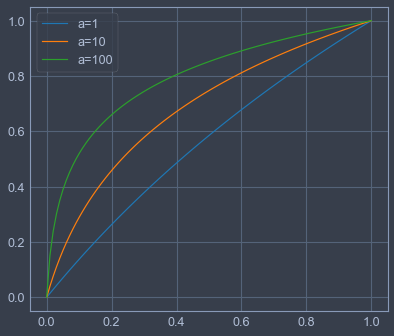

In [62]:
x = np.linspace(0, 1, 100)
def logscale(x, a):
    y = np.log10(1+(a*x))
    return (y - y.min())/(y.max() - y.min())
plt.plot(x, logscale(x, 1), label='a=1')
plt.plot(x, logscale(x, 10), label='a=10')
plt.plot(x, logscale(x, 100), label='a=100')
plt.legend()
plt.show()

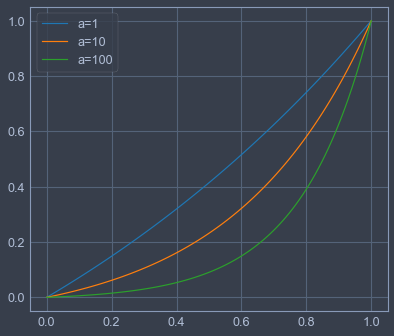

In [57]:
y = np.linspace(0, 1, 100)
def invlogscale(y, a):
    y_norm = y * np.log10(1 + a)
    x = (np.power(10, y_norm) - 1) / a
    return x
    #return (x - x.min())/(x.max() - x.min())
plt.plot(y, invlogscale(y, 1), label='a=1')
plt.plot(y, invlogscale(y, 10), label='a=10')
plt.plot(y, invlogscale(y, 100), label='a=100')
plt.legend()
plt.show()

## Galaxy sizes + ellipses

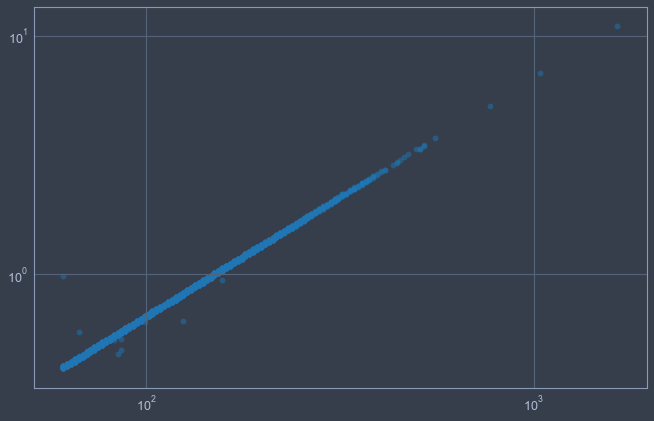

In [107]:
plt.figure(figsize=(11, 7))
plt.xscale('log')
plt.yscale('log')
plt.scatter(df_full['GalSize_kpc'] / df_full['d_pix_kpc'], df_full['D25_leda'], alpha=0.5)
plt.show()

In [170]:
(df_full['GalSize_kpc'] / df_full['d_pix_kpc']).describe()

count    84722.000000
mean        83.750381
std         29.533789
min         61.107044
25%         65.477373
50%         73.466823
75%         90.383932
max       1644.717150
dtype: float64

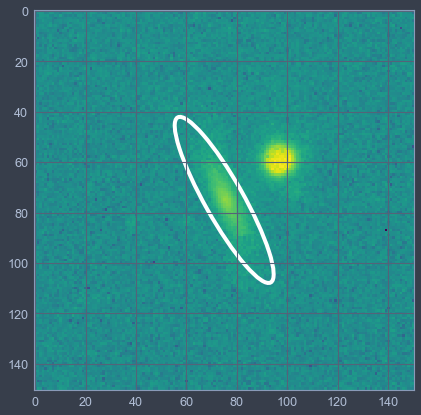

In [133]:
from matplotlib.patches import Ellipse
sample = 1237652629098594325
galsize_pix = df_meta.loc[sample, 'GalSize_kpc'] / df_meta.loc[sample, 'd_pix_kpc']
r25 = df_full.loc[sample, 'R25_leda']
pa = df_full.loc[sample, 'pa_leda']
angle = pa - 90
x = hacktools.HackTools.scale_image(ht.get_galaxydata(sample))
cx, cy = x.shape[0] // 2, x.shape[1] // 2
f, ax = plt.subplots(figsize=(11, 7))
ax.imshow(x)
ax.add_patch(Ellipse((cx, cy), galsize_pix, galsize_pix / r25, angle=angle, facecolor='none', 
                     edgecolor='white', linewidth=4))

## Number of pixels distribution

(array([3.148e+04, 1.638e+04, 8.833e+03, 5.064e+03, 3.529e+03, 2.469e+03,
        1.529e+03, 1.202e+03, 8.750e+02, 6.510e+02, 4.610e+02, 2.590e+02,
        2.120e+02, 2.310e+02, 7.700e+01, 8.100e+01, 8.300e+01, 3.000e+01,
        4.300e+01, 4.200e+01, 2.300e+01, 9.000e+00, 1.400e+01, 3.000e+00,
        7.000e+00, 1.000e+01, 5.000e+00, 4.000e+00, 6.000e+00, 0.000e+00,
        3.000e+00, 2.000e+00, 2.000e+00, 2.000e+00, 2.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([123. , 142.8, 162.6, 182.4, 202.2, 222. , 241.8, 261.6, 281.4,
        301.2, 321. , 340.8, 360.6, 380.4, 400.2, 420. , 439.8, 459.6,
        479.4, 499.2, 519. , 538.8, 558.6, 578.4, 598.2, 618. , 637.8,
        657.6, 677.4, 697.2, 717. , 736.8, 756.6, 776.4, 796.2, 816. ,
        835.8, 855.6, 875.4, 895.2, 915. ]),
 <a list of 40 Patch objects>)

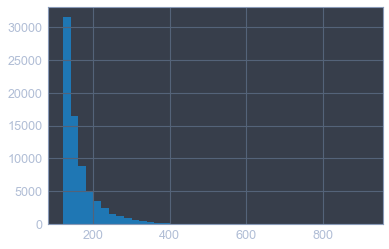

In [161]:
x = df_features['pre.width'].values
plt.hist(x[x < 1000], bins=40)

In [162]:
df_features['pre.width'].describe()

count    73627.000000
mean       166.295449
std         54.362921
min        123.000000
25%        132.000000
50%        148.000000
75%        182.000000
max       3322.000000
Name: pre.width, dtype: float64

In [164]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.502520
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000000,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.176818
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.213653,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.990

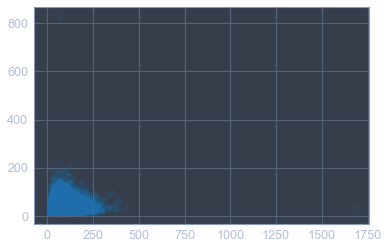

In [170]:
plt.scatter(df_features['pre.width']*df_features['d_pix_kpc'], df_metamorph['GalSize_kpc'],
            alpha=0.1)

## Complete pipeline

In [212]:
%autoreload
import hackprocessing as hp

def process_image(sdss_id):
    x = hp.read_image(sdss_id)
    x_meta = df_full.loc[sdss_id]
    a_maj = x_meta['GalSize_kpc'] / x_meta['d_pix_kpc']
    r25 = x_meta['R25_leda']
    if np.isnan(r25):
        r25 = 1
    pa = x_meta['pa_leda']
    angle = pa - 90
    x = hp.scale_image(x, ellipse_kwargs={'a_maj': a_maj, 'a_min': a_maj / r25, 
                                          'angle': angle * pi / 180}, 
                       scaleval_kwargs={'eps': 1e-3, 'verbose': True})
    x = hp.crop_image(x, a_maj)
    x = hp.rotate_image(x, angle)
    x = hp.resize_image(x)
    x = hp.std_scale(x)
    return x

Scaleval 8.88711577446


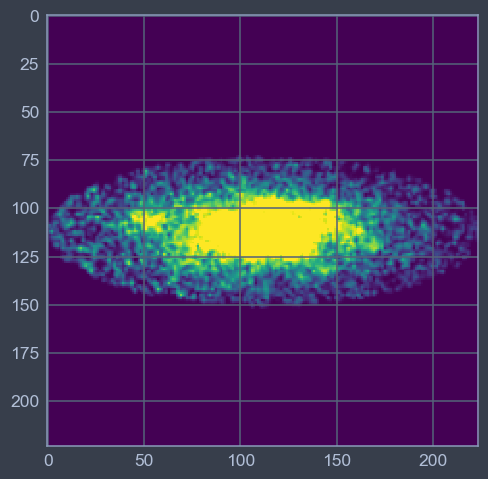

In [215]:
x = process_image(1237645943978328289)
plt.imshow(x)

## Bulge to disk ratio

In [152]:
%autoreload
from ipywidgets import interact
import cv2

npix = 197

def resize_image(x):
    if x.shape[0] >= npix:  # downscale
        x = cv2.resize(x, (npix, npix), cv2.INTER_AREA)
    else:  # upscale
        x = cv2.resize(x, (npix, npix), cv2.INTER_CUBIC)
    return x

def plot_galaxy(idx, box=True, delta=3):
    sdss_id = df_metamorph.index[idx]
    data = ht.get_galaxydata(sdss_id)
    data = (data - data.min()) / (data.max() - data.min())
    data = resize_image(data)
    cx = npix // 2
    if box:
        data[cx-delta:cx+delta+1, cx-delta:cx+delta+1] = 0
    return ht.plot_data(data, scaleval_kwargs={'verbose': True})
    
interact(plot_galaxy, idx=(0, df_metamorph.shape[0]), delta=(1, 10))

interactive(children=(IntSlider(value=36813, description='idx', max=73627), Checkbox(value=True, description='box'), IntSlider(value=3, description='delta', max=10, min=1), Output()), _dom_classes=('widget-interact',))

<function __main__.plot_galaxy(idx, box=True, delta=3)>

# Combining features

## Dataset features

In [160]:
preprocess = 'scauto'

In [161]:
#df_feats_cnn = pd.read_hdf(f'data/features/cnn_features_{preprocess}/cnn_feats.hdf5')
import glob

df_parts = [pd.read_csv(filename, sep='\t', index_col=0) for filename in glob.glob(
        f'data/features/cnn_features_{preprocess}/cnn_feats_*.tsv'
    )]
print(f'Found {len(df_parts)} parts.')
df_feats_cnn = pd.concat(df_parts, axis=1)
print(df_feats_cnn.shape)
df_feats_cnn.head()

Found 5 parts.
(73627, 2196)


,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,r50_scauto_197_gz2.35,r50_scauto_197_gz2.36,xcep_scauto_128_gz2.0,xcep_scauto_128_gz2.1,xcep_scauto_128_gz2.2,xcep_scauto_128_gz2.3,xcep_scauto_128_gz2.4,xcep_scauto_128_gz2.5,xcep_scauto_128_gz2.6,xcep_scauto_128_gz2.7,xcep_scauto_128_gz2.8,xcep_scauto_128_gz2.9,xcep_scauto_128_gz2.10,xcep_scauto_128_gz2.11,...,r50_scauto_197_gz2.1999.notop,r50_scauto_197_gz2.2000.notop,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237668585429336280,0.740201,0.237173,0.022626,0.019118,0.218055,0.117188,0.100867,0.058446,0.159609,0.000000,0.059499,0.129053,0.029503,0.114596,0.862779,0.170932,0.720502,0.108565,0.032419,0.012276,0.020379,0.016145,0.025959,0.007417,0.0,0.015318,0.001943,0.001857,0.016153,0.022474,0.019819,0.006732,0.036659,0.000929,0.0,0.000000,0.014127,0.613545,0.367707,0.018748,0.026068,0.341639,0.232856,0.108783,0.065716,0.275923,0.00000,0.084934,0.209182,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.043068,0.0,0.224260,0.000000,0.024407,0.011006,0.073846,0.001351,0.000000,0.000000,0.123772,0.008990,0.010413,0.0,0.068624,0.0,0.000000,0.001444,0.00000,0.012351,0.000000,0.000000,0.000000,0.135248,0.133160,0.331012,0.0,0.000000,0.075122,0.061513,0.0,0.000000,0.000000,0.003945,0.000000,0.355697,0.000000,0.0,0.072258,0.098127
1237653616397451469,0.544845,0.448317,0.006837,0.129843,0.318474,0.047735,0.270739,0.179146,0.139328,0.028833,0.207414,0.074189,0.008039,0.112449,0.880714,0.148591,0.369720,0.481689,0.014179,0.009103,0.024306,0.025506,0.033378,0.005977,0.0,0.075379,0.008862,0.045602,0.082153,0.064311,0.032682,0.007709,0.052679,0.009519,0.0,0.000000,0.109240,0.613812,0.371034,0.015154,0.147126,0.223908,0.027760,0.196148,0.107599,0.116309,0.01229,0.156081,0.053154,...,0.050370,0.0,0.0,0.0,0.0,0.188239,0.0,0.070149,0.0,0.000000,

In [162]:
# drop columns where everything is 0
dropcols = list(filter(lambda col: np.all(df_feats_cnn[col] == 0), df_feats_cnn.columns))
df_feats_cnn.drop(columns=dropcols, inplace=True)
print(df_feats_cnn.shape)
df_feats_cnn.head()

(73627, 2179)


,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,r50_scauto_197_gz2.35,r50_scauto_197_gz2.36,xcep_scauto_128_gz2.0,xcep_scauto_128_gz2.1,xcep_scauto_128_gz2.2,xcep_scauto_128_gz2.3,xcep_scauto_128_gz2.4,xcep_scauto_128_gz2.5,xcep_scauto_128_gz2.6,xcep_scauto_128_gz2.7,xcep_scauto_128_gz2.8,xcep_scauto_128_gz2.9,xcep_scauto_128_gz2.10,xcep_scauto_128_gz2.11,...,r50_scauto_197_gz2.1999.notop,r50_scauto_197_gz2.2000.notop,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237668585429336280,0.740201,0.237173,0.022626,0.019118,0.218055,0.117188,0.100867,0.058446,0.159609,0.000000,0.059499,0.129053,0.029503,0.114596,0.862779,0.170932,0.720502,0.108565,0.032419,0.012276,0.020379,0.016145,0.025959,0.007417,0.0,0.015318,0.001943,0.001857,0.016153,0.022474,0.019819,0.006732,0.036659,0.000929,0.0,0.000000,0.014127,0.613545,0.367707,0.018748,0.026068,0.341639,0.232856,0.108783,0.065716,0.275923,0.00000,0.084934,0.209182,...,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.043068,0.0,0.224260,0.000000,0.024407,0.011006,0.073846,0.001351,0.000000,0.000000,0.123772,0.008990,0.010413,0.0,0.068624,0.0,0.000000,0.001444,0.00000,0.012351,0.000000,0.000000,0.000000,0.135248,0.133160,0.331012,0.0,0.000000,0.075122,0.061513,0.0,0.000000,0.000000,0.003945,0.000000,0.355697,0.000000,0.0,0.072258,0.098127
1237653616397451469,0.544845,0.448317,0.006837,0.129843,0.318474,0.047735,0.270739,0.179146,0.139328,0.028833,0.207414,0.074189,0.008039,0.112449,0.880714,0.148591,0.369720,0.481689,0.014179,0.009103,0.024306,0.025506,0.033378,0.005977,0.0,0.075379,0.008862,0.045602,0.082153,0.064311,0.032682,0.007709,0.052679,0.009519,0.0,0.000000,0.109240,0.613812,0.371034,0.015154,0.147126,0.223908,0.027760,0.196148,0.107599,0.116309,0.01229,0.156081,0.053154,...,0.050370,0.0,0.0,0.0,0.0,0.188239,0.0,0.070149,0.0,0.000000,

In [165]:
dropcols

['custom_scauto_69_gz2.12',
 'custom_scauto_69_gz2.13',
 'custom_scauto_69_gz2.15',
 'custom_scauto_69_gz2.18',
 'custom_scauto_69_gz2.19',
 'custom_scauto_69_gz2.20',
 'custom_scauto_69_gz2.21',
 'custom_scauto_69_gz2.22',
 'custom_scauto_69_gz2.23',
 'custom_scauto_69_gz2.24',
 'r50_scauto_197_gz2.939.notop',
 'r50_scauto_197_gz2.1208.notop',
 'r50_scauto_197_gz2.1301.notop',
 'r50_scauto_197_gz2.1325.notop',
 'r50_scauto_197_gz2.1440.notop',
 'r50_scauto_197_gz2.1464.notop',
 'r50_scauto_197_gz2.1503.notop']

In [178]:
df_feats_cnn['r50_scauto_197_gz2.25'].median()

0.021267673000693318

In [453]:
df_feats_img = pd.read_csv(f'data/features/img_features_{preprocess}/img_feats.tsv', 
                           sep='\t', index_col=0)
df_feats_img.drop(columns=['post.max', 'post.min'], inplace=True)
print(df_feats_img.shape)
df_feats_img.head()

(73627, 14)


,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center
SDSS_ID,,,,,,,,,,,,,,
1237665531723317728,7.523004e+06,497.257233,169243.193853,-1460.152686,4909.532164,149629.031569,101997.849319,123,882.376197,5532.53,0.110263,0.143871,0.967705,0.949886
1237658423552114703,1.463927e+07,609.334995,185411.726971,-1952.178025,3852.500691,185411.726971,105551.280210,155,474.691176,6087.69,0.121327,0.140543,1.000000,0.962872
1237664091830747173,7.940918e+06,114.804576,44875.960506,-633.296232,875.278448,44875.960506,31575.901538,263,472.529567,5355.32,0.106731,0.124300,1.000000,0.947219
1237662225702715433,2.248975e+07,491.085541,18568.673650,-1120.300453,1220.556966,18568.673650,14934.978687,214,35.559121,9473.81,0.188811,0.196161,1.000000,0.963532
1237668332031443103,2.541612e+07,1394.574281,368539.768514,-5462.474004,9148.261137,278910.526569,223621.632710,135,226.601246,5274.72,0.105124,0.112000,0.968452,0.961269


In [211]:
df_bulgelum = pd.read_csv(f'data/features/img_features_{preprocess}/bulgelum.tsv', 
                         sep='\t', index_col=0)
df_bulgelum = df_bulgelum.loc[df_feats_img.index]
df_bulgelum['bulg.flux'] = df_bulgelum['bulg.flux'] * 4*np.pi*np.square(
    df_metamorph.loc[df_bulgelum.index, 'D_Mpc']).values
df_bulgelum.columns = ['bulge.lum']
df_bulgelum['bulge_to_total'] = df_bulgelum['bulge.lum'] / df_feats_img['pre.sum.lum']
print(df_bulgelum.shape)
df_bulgelum.head()

(73627, 2)


,bulge.lum,bulge_to_total
SDSS_ID,,
1237665531723317728,1.078966e+08,14.342221
1237658423552114703,7.259354e+07,4.958821
1237664091830747173,1.657319e+07,2.087062
1237662225702715433,1.306790e+07,0.581060
1237668332031443103,1.883756e+08,7.411660


In [205]:
# Add log lum features
if False:
    prelum_cols = list(filter(lambda x: ('pre' in x) and ('lum' in x) and (not 'log' in x),
                              df_feats_img.columns))
    prelumlog_cols = list(map(lambda x: x+'.log', prelum_cols))
    df_feats_img[prelumlog_cols] = np.log10(df_feats_img[prelum_cols])
    df_feats_img['pre.min.lum.log'] = np.log10((-1)*df_feats_img['pre.min.lum'])
    df_feats_img.fillna(0, inplace=True)

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:5: RuntimeWarning: invalid value encountered in log10


In [454]:
idx = df_feats_img.index

In [455]:
dist = df_meta.loc[idx, 'D_Mpc']
redshift = df_meta.loc[idx, 'redshift']
dpix = df_meta.loc[idx, 'd_pix_kpc']
df_dists = pd.concat([redshift, dpix], axis=1)
df_dists.columns = ['redshift', 'd_pix_kpc']
print(df_dists.shape)
df_dists.head()

(73627, 2)


,redshift,d_pix_kpc
SDSS_ID,,
1237665531723317728,0.0396,0.329119
1237658423552114703,0.0438,0.364026
1237664091830747173,0.0245,0.203622
1237662225702715433,0.0323,0.268448
1237668332031443103,0.0814,0.676523


In [456]:
df_features = pd.concat([df_feats_img, df_feats_cnn, df_dists], axis=1)
print(df_features.shape)
df_features.head()

(73627, 2195)


,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,...,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,0.044273,0.039052,0.021237,0.010907,0.039915,0.000000,0.000000,...,0.0,0.0,0.000000,0.419165,0.0,0.043426,0.000000,0.000000,0.0,0.026036,0.085248,0.017091,0.0,0.001851,0.000000,0.373822,0.040094,0.000000,0.434619,0.000000,0.0,0.127402,0.000000,0.000000,0.000000,0.0,0.000000,0.043323,0.036078,0.285451,0.0,0.054541,0.000000,0.0,0.305673,0.0,0.000000,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,0.1213,1.008135
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,0.057638,0.014038,0.000000,0.002556,0.010689,0.006664,0.005807,...,0.0,0.0,0.019311,0.102425,0.0,0.270107,0.000000,0.040571,0.0,0.000000,0.011425,0.037226,0.0,0.116023,0.053348,0.250478,0.242314,0.024494,0.104177,0.000000,0.0,0.198361,0.0

In [457]:
df_features.to_hdf(f'data/features/combined_{preprocess}/all_features.h5', 'all_features')

## Importing modelmags from SDSS

In [21]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704
123766250

In [22]:
df_modelmags = pd.read_csv('./data/metadata/modelmags_ugriz.csv', index_col=0)
print('shape', df_modelmags.shape)
df_modelmags.head()

shape (73627, 5)


,modelMag_u,modelMag_g,modelMag_r,modelMag_i,modelMag_z
objID,,,,,
1237665225700868335,17.89961,16.31855,15.50847,15.04203,14.64511
1237665129075834890,16.85874,15.16673,14.30086,13.85750,13.54400
1237665129075834991,17.66496,15.81568,14.98854,14.58033,14.29442
1237665129097789649,18.53782,16.66099,15.70498,15.26170,14.91504
1237665129097854995,18.26003,16.31712,15.45597,14.99377,14.70228


In [26]:
for col in df_modelmags.columns:  # also works if column already exists
    df_metamorph.loc[:, col] = df_modelmags.loc[df_metamorph.index, col].copy()

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [31]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,modelMag_u,modelMag_r,modelMag_z
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,20.35955,17.40932,16.63860
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,19.38518,17.61691,17.15460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,17.51221,16.00672,15.59723
1237662500543987740,242.00880,36.05398,

In [32]:
df_metamorph.to_csv('data/metadata/metadata_morph_cumprobs.tsv', sep='\t')

# Premade train test split

In [55]:
from sklearn.model_selection import train_test_split
idx_train, idx_test = train_test_split(df_meta.index, test_size=0.1, 
                                       random_state=1, shuffle=True)
idx_tr, idx_val = train_test_split(idx_train, test_size=0.1, 
                                   random_state=1, shuffle=True)

In [14]:
pd.Series(idx_test).to_csv('data/splits/test_ids.txt', index=False)
pd.Series(idx_tr).to_csv('data/splits/tr_ids.txt', index=False)
pd.Series(idx_val).to_csv('data/splits/val_ids.txt', index=False)

# Predicting from imported features

## Dataset preparation

In [9]:
preprocess = 'scauto'

In [10]:
%autoreload
df_features = pd.read_hdf(f'data/features/combined_{preprocess}/all_features.h5', 'all_features')
print(df_features.shape)
df_features.head()

(73627, 2195)


,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,...,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,0.044273,0.039052,0.021237,0.010907,0.039915,0.000000,0.000000,...,0.0,0.0,0.000000,0.419165,0.0,0.043426,0.000000,0.000000,0.0,0.026036,0.085248,0.017091,0.0,0.001851,0.000000,0.373822,0.040094,0.000000,0.434619,0.000000,0.0,0.127402,0.000000,0.000000,0.000000,0.0,0.000000,0.043323,0.036078,0.285451,0.0,0.054541,0.000000,0.0,0.305673,0.0,0.000000,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,0.1213,1.008135
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,0.057638,0.014038,0.000000,0.002556,0.010689,0.006664,0.005807,...,0.0,0.0,0.019311,0.102425,0.0,0.270107,0.000000,0.040571,0.0,0.000000,0.011425,0.037226,0.0,0.116023,0.053348,0.250478,0.242314,0.024494,0.104177,0.000000,0.0,0.198361,0.0

In [11]:
idx_test = pd.read_csv('data/splits/test_ids.txt', header=None)[0].values
idx_tr = pd.read_csv('data/splits/tr_ids.txt', header=None)[0].values
idx_val = pd.read_csv('data/splits/val_ids.txt', header=None)[0].values

### Subsetting features

In [9]:
diff_feats = np.unique(list(map(lambda x: x.split('.')[0], df_features.columns)))
diff_feats

array(['custom_scauto_69_gz2', 'd_pix_kpc', 'post', 'pre',
       'r50_scauto_197_gz2', 'r50_scauto_197_pretrainedchi', 'redshift',
       'xcep_scauto_128_gz2'], dtype='<U28')

In [680]:
list(filter(lambda x: 'post.' in x, df_features.columns))

['post.sum', 'post.mean', 'post.std', 'post.center', 'post.mean.center']

In [91]:
removefeats = 'kpc'  # these are NOT present # .log, dist, inv
keepfeats = None  # exception to above rule if this is present
if removefeats is not None:
    if keepfeats is not None:
        subcols = list(filter(lambda x: (not removefeats in x) or (keepfeats in x),
                              df_features.columns))
    else:
        subcols = list(filter(lambda x: not removefeats in x,
                              df_features.columns))
    nfeats_old = df_features.shape[1]
    df_features = df_features[subcols]
    nfeats = df_features.shape[1]
    print(f'Dropped {nfeats_old - nfeats} features ({nfeats} remaining)')

Dropped 1 features (2143 remaining)


In [971]:
extrafeats = ['modelMag_g', 'modelMag_i']
for extrafeat in extrafeats:
    df_features[extrafeat] = df_metamorph.loc[df_features.index, extrafeat].copy()

In [972]:
# Improved color M/L relation (no morpho)
#df_features = df_metamorph.loc[df_features.index, ['modelMag_g', 'modelMag_i', 'redshift']].copy()
for feat in ['modelMag_g', 'modelMag_i']:
    df_features[feat] = np.power(10, df_features[feat]) * np.square(
        df_metamorph.loc[df_features.index, 'D_Mpc'].copy()) / 1e20
df_features.rename(columns={'modelMag_g': 'lum_g', 'modelMag_i': 'lum_i'}, inplace=True)
df_features['gi_color'] = np.log10(df_features['lum_g'] / df_features['lum_i']).copy()

In [973]:
# Use only features from gbm model
df_features = df_features[gbm.feature_name()]

In [489]:
# Only use most important features
df_features = df_features.iloc[:, gbm.feature_importance().argsort()[::-1][:50]]

In [735]:
# When removing distance features
lumcols = list(filter(lambda x: '.lum' in x, df_features.columns))
for col in lumcols:
    df_features[col] = df_features[col] / (4 * np.pi * np.square(dist.loc[df_features.index]))

In [1032]:
# Cheat features
cheatcols = df_metamorph.loc[:, 't01_a01_cum_weighted':'t11_a37_cum_weighted'].columns
df_features[cheatcols] = df_metamorph.loc[df_features.index, cheatcols].copy()
df_features.head()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,...,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc,t01_a01_cum_weighted,t01_a02_cum_weighted,t01_a03_cum_weighted,t02_a04_cum_weighted,t02_a05_cum_weighted,t03_a06_cum_weighted,t03_a07_cum_weighted,t04_a08_cum_weighted,t04_a09_cum_weighted,t05_a10_cum_weighted,t05_a11_cum_weighted,t05_a12_cum_weighted,t05_a13_cum_weighted,t06_a14_cum_weighted,t06_a15_cum_weighted,t07_a16_cum_weighted,t07_a17_cum_weighted,t07_a18_cum_weighted,t08_a19_cum_weighted,t08_a20_cum_weighted,t08_a21_cum_weighted,t08_a22_cum_weighted,t08_a23_cum_weighted,t08_a24_cum_weighted,t08_a38_cum_weighted,t09_a25_cum_weighted,t09_a26_cum_weighted,t09_a27_cum_weighted,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,0.044273,0.039052,0.021237,0.010907,0.039915,0.000000,0.000000,...,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,0.1213,1.008135,0.935000,0.065000,0.000000,0.000000,0.065000,0.000000,0.065000,0.021645,0.043355,0.000000,0.043355,0.021645,0.000,0.023000,0.977000,0.043010,0.890120,0.001870,0.001587,0.000000,0.000000,0.000000,0.000000,0.000000,0.021413,0.000000,0.000000,0.000000,0.000000,0.000000,0.021645,0.0,0.000000,0.000000,0.000000,0.000000,0.021645
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,0.057638,0.014038,0.000000,0.002556,0.010689,0.006664,0.005807,...,0.0,0.000000,0.006307,0.000000,0.191135,0.000000,0.086487,0.0,0.176069,0.156100,0.0403,0.334937,0.615385,0.322677,0.061938,0.234586,0.088091,0.000000,0.088091,0.029334,0.058757,0.000000,0.000000,0.088091,0.000,0.088178,0.849884,0.000000,0.146462,0.468923,0.029363,0.058815,0.000000,0.000000,0.000000,0.000000,0.000000,0.175940,0.029323,0.029323,0.000000,0.000000,0.029334,0.0,0.029334,0.000000,0.000000,0.000000,0.000000
1237645943974396134,9.200295e+07,6081.231

In [44]:
# Some extra features
# df_features['pre.width_kpc'] = df_features['pre.width'] * df_features['d_pix_kpc']
# df_features['modelMag_g'] = df_metamorph.loc[df_features.index, 'modelMag_g'].copy()
# df_features['avg_AB'] = df_axisratios.loc[df_features.index, 'avg_AB'].copy()

In [960]:
print(df_features.shape)
df_features.head()

(73627, 4)


,gi_color,redshift,lum_i,lum_g
SDSS_ID,,,,
1237645879578460255,1.42787,0.1213,93.176847,2495.617426
1237645941824356443,1.08436,0.0403,0.138655,1.683823
1237645943974396134,1.65905,0.1532,139.705648,6371.826811
1237645943975837722,1.17412,0.0668,2.492983,37.225396
1237645943978328289,0.72431,0.0388,18.193653,96.433939


In [930]:
# use only part of data
idx_tr = idx_tr[:(len(idx_tr)//2)]

### Prepare model

In [92]:
log_ml = False
df_valid = ht.get_meta('valid')
idx = df_features.index
y = df_valid['ML_bayes'].loc[idx]
if log_ml:
    y = np.log10(y)

In [292]:
# df_features.to_hdf('data/features/all_features_filt.h5', 'features')

In [93]:
uniform_weight = False
ml_err = np.maximum(df_valid['ML_bayes_err'], 0.05 * df_valid['ML_bayes'])
if not log_ml:
    weight = 1 / np.square(ml_err) if not uniform_weight else pd.Series(np.ones(ml_err.shape),
                                                                        index=ml_err.index)
else:
    weight = 1 / np.square(np.log10(np.exp(1))*ml_err/np.power(10, y)) if not uniform_weight else pd.Series(np.ones(ml_err.shape),
                                                                        index=ml_err.index)
if uniform_weight:
    weight.iloc[0] = 1.001  # weird hack: asigning uniform weights does not work

In [94]:
X_tr, y_tr = df_features.loc[idx_tr], y.loc[idx_tr]
X_val, y_val = df_features.loc[idx_val], y.loc[idx_val]
X_test, y_test = df_features.loc[idx_test], y.loc[idx_test]

In [95]:
def chisq(y_true, y_pred, weight):  # weight is 1/(err)^2
    return (weight * np.square(y_true - y_pred)).mean()

def chisq_log(y_true, y_pred, weight):
    return (weight * np.square(np.power(10, y_true) - np.power(10, y_pred))).mean()
chisq_cur = chisq_log if log_ml else chisq

In [96]:
def lgb_chi2(Yp, train_data):
    Y = train_data.get_label()
    weight = train_data.get_weight()  # 1 / errsq
    xi_sq = (weight * np.square(Y - Yp)).mean()
    return 'Chi-sq', round(xi_sq,1), False

def lgb_chi2_2dec(Yp, train_data):
    Y = train_data.get_label()
    weight = train_data.get_weight()  # 1 / errsq
    xi_sq = (weight * np.square(Y - Yp)).mean()
    return 'Chi-sq', round(xi_sq,2), False

def lgb_chi2_dec(decimals):
    def lgb_chi2_ndec(Yp, train_data):
        Y = train_data.get_label()
        weight = train_data.get_weight()  # 1 / errsq
        xi_sq = (weight * np.square(Y - Yp)).mean()
        return 'Chi-sq', round(xi_sq, decimals), False
    return lgb_chi2_ndec

def lgb_chi_dec(decimals):
    def lgb_chi_ndec(Yp, train_data):
        Y = train_data.get_label()
        weight = train_data.get_weight()  # 1 / errsq
        xi = np.abs((Y - Yp) * np.sqrt(weight)).mean()
        return 'Chi', round(xi, decimals), False
    return lgb_chi_ndec

def lgb_mse(Yp, train_data):
    Y = train_data.get_label()
    mse = np.square(Y - Yp).mean()
    return 'MSE', mse, False

def lgb_mse_dec(decimals):
    def lgb_mse_ndec(Yp, train_data):
        Y = train_data.get_label()
        mse = np.square(Y - Yp).mean()
        return 'MSE', round(mse, decimals), False
    return lgb_mse_ndec

def lgb_mae_dec(decimals):
    def lgb_mae_ndec(Yp, train_data):
        Y = train_data.get_label()
        mae = np.abs(Y - Yp).mean()
        return 'MAE', round(mae, decimals), False
    return lgb_mae_ndec

def lgb_chi2_log(Yp, train_data):
    Y = train_data.get_label()
    weight = train_data.get_weight()  # 1 / errsq
    xi_sq = (weight * np.square(np.power(10, Y) - np.power(10, Yp))).mean()
    return 'Chi-sq', round(xi_sq,1), False
lgb_chi2_cur = lgb_chi2_log if log_ml else lgb_chi2

In [53]:
# saving
y.loc[idx].to_hdf(f'data/features/combined_{preprocess}/extras.h5', 'target')
weight.loc[idx].to_hdf(f'data/features/combined_{preprocess}/extras.h5', 'weight')
df_valid.loc[idx, 'reduced_chi_square'].to_hdf(
    f'data/features/combined_{preprocess}/extras.h5', 'chisq'
)

## Single model

In [97]:
# params
lgbm_params = {
    'boosting_type': 'gbdt',
    'objective': 'regression_l2',
    'nthread': 2,
    #'silent': True,
    'num_leaves': 40, # was 2**4,
    'min_data_in_leaf': 150,
    'learning_rate': 0.01,
    'max_depth': -1,  # was 10
    'max_bin': 255,
    'feature_fraction': 0.4,
    'bagging_fraction': 0.8,
    'bagging_freq': 40,
    #'subsample_for_bin': 50000,
    #'subsample': 0.8,
    #'subsample_freq': 1,
    #'colsample_bytree': 0.8,
    #'reg_alpha': 1,
    #'reg_lambda': 0,
    #'min_split_gain': 0.5,
    #'min_child_weight': 1,
    #'min_child_samples': 60,
    #'scale_pos_weight': 1,
    'device' : 'cpu',  # was gpu
    'metric' : 'rmse',
    #'metric' : 'multi_error',
    'verbose':0,          
}
max_boost_runs = 30000

In [98]:
if df_features.shape[1] < 400:  # Not a lot of features
    print('Using small nfeat params')
    lgbm_params['bagging_fraction'] = 1.
    lgbm_params['feature_fraction'] = 1
    lgbm_params['num_leaves'] = 31
    lgbm_params['min_data_in_leaf'] = 90

In [123]:
(df_valid['ML_bayes_err'] / df_valid['ML_bayes']).describe()

count    79474.000000
mean         0.080398
std          0.041494
min          0.010000
25%          0.048513
50%          0.074407
75%          0.104474
max          0.733766
dtype: float64

### Load / save model

In [101]:
if gbm:
    gbm.save_model('data/lgbm_model/handicapped/no_cnn4prepostdpixkpc.txt')

In [731]:
gbm = lgbm.Booster(model_file='data/lgbm_model/handicapped/no_dist.txt')

In [102]:
# Standard
gbm = lgbm.Booster(model_file='data/lgbm_model/model_chi.txt')

In [969]:
gbm = lgbm.Booster(model_file='data/lgbm_model/model_chi_morph-gi.txt')

In [956]:
gbm = lgbm.Booster(model_file='data/lgbm_model/model_chi_nomorph-gi.txt')

### Training models

In [99]:
%%time
# Standard rounding 1. For accurate models: 2. For MSElog: 4.
l1_loss = True  # if True, don't use squared errors, but instead L1
round_decimals = 3
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

if not uniform_weight:
    if l1_loss:
        feval = lgb_chi_dec(round_decimals)
    else:
        feval = lgb_chi2_dec(round_decimals)
else:  # no errors (uniform weight)
    if l1_loss:
        feval = lgb_mae_dec(round_decimals)
    else:
        feval = lgb_mse_dec(round_decimals)

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = feval
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.654856	train's Chi: 3.981	eval's rmse: 0.692962	eval's Chi: 4.032
[200]	train's rmse: 0.522532	train's Chi: 3.045	eval's rmse: 0.585295	eval's Chi: 3.164
[300]	train's rmse: 0.47415	train's Chi: 2.714	eval's rmse: 0.549947	eval's Chi: 2.875
[400]	train's rmse: 0.449041	train's Chi: 2.555	eval's rmse: 0.531808	eval's Chi: 2.748
[500]	train's rmse: 0.433302	train's Chi: 2.464	eval's rmse: 0.521689	eval's Chi: 2.687
[600]	train's rmse: 0.421912	train's Chi: 2.401	eval's rmse: 0.515037	eval's Chi: 2.651
[700]	train's rmse: 0.412611	train's Chi: 2.351	eval's rmse: 0.510513	eval's Chi: 2.624
[800]	train's rmse: 0.404731	train's Chi: 2.309	eval's rmse: 0.50681	eval's Chi: 2.606
[900]	train's rmse: 0.397695	train's Chi: 2.273	eval's rmse: 0.50405	eval's Chi: 2.593
[1000]	train's rmse: 0.391438	train's Chi: 2.239	eval's rmse: 0.502535	eval's Chi: 2.581
[1100]	train's rmse: 0.385743	train's Chi: 2.209	eval's rms

In [19]:
gbm_nocnn4 = gbm

In [100]:
gbm_onlymorph = gbm

### Other

In [26]:
# scauto (training on gz2, with 3 CNNs)
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.624261	train's Chi-sq: 22	eval's rmse: 0.647242	eval's Chi-sq: 23.9
[200]	train's rmse: 0.503204	train's Chi-sq: 14.3	eval's rmse: 0.539138	eval's Chi-sq: 16.6
[300]	train's rmse: 0.467434	train's Chi-sq: 12.3	eval's rmse: 0.509325	eval's Chi-sq: 14.8
[400]	train's rmse: 0.451905	train's Chi-sq: 11.5	eval's rmse: 0.49902	eval's Chi-sq: 14.2
[500]	train's rmse: 0.442529	train's Chi-sq: 11	eval's rmse: 0.493475	eval's Chi-sq: 13.9
[600]	train's rmse: 0.435354	train's Chi-sq: 10.7	eval's rmse: 0.489229	eval's Chi-sq: 13.7
[700]	train's rmse: 0.429521	train's Chi-sq: 10.4	eval's rmse: 0.486274	eval's Chi-sq: 13.5
[800]	train's rmse: 0.424414	train's Chi-sq: 10.2	eval's rmse: 0.484257	eval's Chi-sq: 13.4
Early stopping, best iteration is:
[744]	train's rmse: 0.42722	train's Chi-sq: 10.3	eval's rmse: 0.485168	eval's Chi-sq: 13.4
CPU times: user 57.7 s, sys: 1.21 s, total: 58.9 s
Wall time: 34.8 s


In [181]:
# With true logL (cheating)
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.624612	train's Chi-sq: 22	eval's rmse: 0.646571	eval's Chi-sq: 23.9
[200]	train's rmse: 0.504632	train's Chi-sq: 14.4	eval's rmse: 0.541797	eval's Chi-sq: 16.8
[300]	train's rmse: 0.471635	train's Chi-sq: 12.6	eval's rmse: 0.515825	eval's Chi-sq: 15.2
[400]	train's rmse: 0.456865	train's Chi-sq: 11.8	eval's rmse: 0.505124	eval's Chi-sq: 14.6
[500]	train's rmse: 0.447627	train's Chi-sq: 11.3	eval's rmse: 0.497727	eval's Chi-sq: 14.2
[600]	train's rmse: 0.440751	train's Chi-sq: 11	eval's rmse: 0.492905	eval's Chi-sq: 13.9
[700]	train's rmse: 0.435288	train's Chi-sq: 10.7	eval's rmse: 0.490333	eval's Chi-sq: 13.7
Early stopping, best iteration is:
[691]	train's rmse: 0.435749	train's Chi-sq: 10.7	eval's rmse: 0.490563	eval's Chi-sq: 13.7
CPU times: user 46.3 s, sys: 1.15 s, total: 47.5 s
Wall time: 26.3 s


In [142]:
# With true GZ2 morphology and true logL (cheating)
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.62272	train's Chi-sq: 21.9	eval's rmse: 0.644529	eval's Chi-sq: 23.7
[200]	train's rmse: 0.499159	train's Chi-sq: 14.1	eval's rmse: 0.535914	eval's Chi-sq: 16.4
[300]	train's rmse: 0.463744	train's Chi-sq: 12.1	eval's rmse: 0.508646	eval's Chi-sq: 14.8
[400]	train's rmse: 0.447393	train's Chi-sq: 11.3	eval's rmse: 0.496628	eval's Chi-sq: 14.1
[500]	train's rmse: 0.437218	train's Chi-sq: 10.8	eval's rmse: 0.489246	eval's Chi-sq: 13.7
[600]	train's rmse: 0.429595	train's Chi-sq: 10.4	eval's rmse: 0.484145	eval's Chi-sq: 13.4
[700]	train's rmse: 0.42341	train's Chi-sq: 10.1	eval's rmse: 0.481466	eval's Chi-sq: 13.2
Early stopping, best iteration is:
[695]	train's rmse: 0.423692	train's Chi-sq: 10.1	eval's rmse: 0.481565	eval's Chi-sq: 13.2
CPU times: user 1min 4s, sys: 1.71 s, total: 1min 6s
Wall time: 46.9 s


In [23]:
# test
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[X_tr.index])
lgb_val.set_weight(weight.loc[X_val.index])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.674571	train's Chi-sq: 25.7	eval's rmse: 0.709189	eval's Chi-sq: 28.7
[200]	train's rmse: 0.565592	train's Chi-sq: 18	eval's rmse: 0.622712	eval's Chi-sq: 22.1
[300]	train's rmse: 0.526763	train's Chi-sq: 15.7	eval's rmse: 0.594314	eval's Chi-sq: 20.2
[400]	train's rmse: 0.50553	train's Chi-sq: 14.4	eval's rmse: 0.580013	eval's Chi-sq: 19.2
[500]	train's rmse: 0.491001	train's Chi-sq: 13.6	eval's rmse: 0.571571	eval's Chi-sq: 18.7
[600]	train's rmse: 0.479796	train's Chi-sq: 13	eval's rmse: 0.566507	eval's Chi-sq: 18.3
[700]	train's rmse: 0.470382	train's Chi-sq: 12.5	eval's rmse: 0.563637	eval's Chi-sq: 18.1
[800]	train's rmse: 0.462199	train's Chi-sq: 12.1	eval's rmse: 0.561731	eval's Chi-sq: 18
[900]	train's rmse: 0.454857	train's Chi-sq: 11.7	eval's rmse: 0.560092	eval's Chi-sq: 17.9
Early stopping, best iteration is:
[863]	train's rmse: 0.457475	train's Chi-sq: 11.8	eval's rmse: 0.560557	eval's Ch

In [52]:
# norotate
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.67562	train's Chi-sq: 25.9	eval's rmse: 0.692135	eval's Chi-sq: 27
[200]	train's rmse: 0.565689	train's Chi-sq: 18.1	eval's rmse: 0.596927	eval's Chi-sq: 20.1
[300]	train's rmse: 0.527063	train's Chi-sq: 15.8	eval's rmse: 0.56896	eval's Chi-sq: 18.2
[400]	train's rmse: 0.50602	train's Chi-sq: 14.5	eval's rmse: 0.557279	eval's Chi-sq: 17.5
[500]	train's rmse: 0.491517	train's Chi-sq: 13.7	eval's rmse: 0.551245	eval's Chi-sq: 17.1
[600]	train's rmse: 0.480305	train's Chi-sq: 13.1	eval's rmse: 0.546842	eval's Chi-sq: 16.8
[700]	train's rmse: 0.471043	train's Chi-sq: 12.6	eval's rmse: 0.544102	eval's Chi-sq: 16.7
[800]	train's rmse: 0.462949	train's Chi-sq: 12.2	eval's rmse: 0.542246	eval's Chi-sq: 16.6
[900]	train's rmse: 0.455699	train's Chi-sq: 11.8	eval's rmse: 0.541565	eval's Chi-sq: 16.5
Early stopping, best iteration is:
[811]	train's rmse: 0.462113	train's Chi-sq: 12.1	eval's rmse: 0.542033	eval's 

In [42]:
# norotate - r50 only
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.676091	train's Chi-sq: 25.9	eval's rmse: 0.692376	eval's Chi-sq: 27
[200]	train's rmse: 0.566938	train's Chi-sq: 18.2	eval's rmse: 0.596738	eval's Chi-sq: 20.1
[300]	train's rmse: 0.528573	train's Chi-sq: 15.8	eval's rmse: 0.569099	eval's Chi-sq: 18.2
[400]	train's rmse: 0.507712	train's Chi-sq: 14.6	eval's rmse: 0.557767	eval's Chi-sq: 17.5
[500]	train's rmse: 0.493469	train's Chi-sq: 13.8	eval's rmse: 0.551971	eval's Chi-sq: 17.2
[600]	train's rmse: 0.482505	train's Chi-sq: 13.2	eval's rmse: 0.548051	eval's Chi-sq: 16.9
[700]	train's rmse: 0.473417	train's Chi-sq: 12.7	eval's rmse: 0.545314	eval's Chi-sq: 16.7
Early stopping, best iteration is:
[698]	train's rmse: 0.473586	train's Chi-sq: 12.7	eval's rmse: 0.54537	eval's Chi-sq: 16.7
CPU times: user 11min 39s, sys: 7.33 s, total: 11min 46s
Wall time: 6min 5s


In [31]:
# norotate - vgg only
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.694659	train's Chi-sq: 27.4	eval's rmse: 0.709051	eval's Chi-sq: 28.3
[200]	train's rmse: 0.595609	train's Chi-sq: 20.1	eval's rmse: 0.623331	eval's Chi-sq: 21.9
[300]	train's rmse: 0.561719	train's Chi-sq: 17.9	eval's rmse: 0.600267	eval's Chi-sq: 20.3
[400]	train's rmse: 0.542961	train's Chi-sq: 16.7	eval's rmse: 0.590194	eval's Chi-sq: 19.6
[500]	train's rmse: 0.529769	train's Chi-sq: 15.9	eval's rmse: 0.585199	eval's Chi-sq: 19.3
[600]	train's rmse: 0.519305	train's Chi-sq: 15.3	eval's rmse: 0.582283	eval's Chi-sq: 19.1
[700]	train's rmse: 0.510503	train's Chi-sq: 14.8	eval's rmse: 0.580851	eval's Chi-sq: 19
Early stopping, best iteration is:
[652]	train's rmse: 0.514621	train's Chi-sq: 15	eval's rmse: 0.581618	eval's Chi-sq: 19
CPU times: user 5min 2s, sys: 2.97 s, total: 5min 5s
Wall time: 2min 38s


In [23]:
# rotate + autoscaleval
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.672286	train's Chi-sq: 25.6	eval's rmse: 0.68841	eval's Chi-sq: 26.7
[200]	train's rmse: 0.559885	train's Chi-sq: 17.8	eval's rmse: 0.590301	eval's Chi-sq: 19.6
[300]	train's rmse: 0.520839	train's Chi-sq: 15.4	eval's rmse: 0.562213	eval's Chi-sq: 17.8
[400]	train's rmse: 0.499954	train's Chi-sq: 14.2	eval's rmse: 0.550405	eval's Chi-sq: 17.1
[500]	train's rmse: 0.486173	train's Chi-sq: 13.4	eval's rmse: 0.544192	eval's Chi-sq: 16.7
[600]	train's rmse: 0.47559	train's Chi-sq: 12.8	eval's rmse: 0.541051	eval's Chi-sq: 16.5
[700]	train's rmse: 0.466669	train's Chi-sq: 12.3	eval's rmse: 0.539128	eval's Chi-sq: 16.4
[800]	train's rmse: 0.458985	train's Chi-sq: 11.9	eval's rmse: 0.537586	eval's Chi-sq: 16.3
Early stopping, best iteration is:
[724]	train's rmse: 0.464722	train's Chi-sq: 12.2	eval's rmse: 0.538823	eval's Chi-sq: 16.3
CPU times: user 18min 2s, sys: 12.8 s, total: 18min 14s
Wall time: 9min 27s


In [21]:
# scauto + incep
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.679504	train's Chi-sq: 26.2	eval's rmse: 0.695421	eval's Chi-sq: 27.2
[200]	train's rmse: 0.57302	train's Chi-sq: 18.6	eval's rmse: 0.602498	eval's Chi-sq: 20.4
[300]	train's rmse: 0.535258	train's Chi-sq: 16.2	eval's rmse: 0.575975	eval's Chi-sq: 18.7
[400]	train's rmse: 0.515017	train's Chi-sq: 15	eval's rmse: 0.564632	eval's Chi-sq: 18
[500]	train's rmse: 0.501207	train's Chi-sq: 14.2	eval's rmse: 0.558493	eval's Chi-sq: 17.6
[600]	train's rmse: 0.490522	train's Chi-sq: 13.6	eval's rmse: 0.55516	eval's Chi-sq: 17.4
[700]	train's rmse: 0.481651	train's Chi-sq: 13.2	eval's rmse: 0.552735	eval's Chi-sq: 17.2
[800]	train's rmse: 0.474042	train's Chi-sq: 12.7	eval's rmse: 0.551056	eval's Chi-sq: 17.1
Early stopping, best iteration is:
[752]	train's rmse: 0.477568	train's Chi-sq: 12.9	eval's rmse: 0.551831	eval's Chi-sq: 17.1
CPU times: user 9min 30s, sys: 7.04 s, total: 9min 37s
Wall time: 5min


In [91]:
# uniform weights (rotate + autoscaleval)
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

wt, wv = weight.loc[idx_tr], weight.loc[idx_val]
wt.iloc[0] = 1.0000001
wv.iloc[0] = 1.0000001
lgb_train.set_weight(wt)
lgb_val.set_weight(wv)

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.904599	train's Chi-sq: 0.8	eval's rmse: 0.888805	eval's Chi-sq: 0.8
[200]	train's rmse: 0.813101	train's Chi-sq: 0.7	eval's rmse: 0.807588	eval's Chi-sq: 0.7
[300]	train's rmse: 0.774928	train's Chi-sq: 0.6	eval's rmse: 0.780036	eval's Chi-sq: 0.6
Early stopping, best iteration is:
[204]	train's rmse: 0.810994	train's Chi-sq: 0.7	eval's rmse: 0.80595	eval's Chi-sq: 0.6
CPU times: user 7min 41s, sys: 10.7 s, total: 7min 51s
Wall time: 4min 14s


In [28]:
# log
%%time
lgb_train = lgbm.Dataset(X_tr, y_tr)
lgb_val = lgbm.Dataset(X_val, y_val)

lgb_train.set_weight(weight.loc[idx_tr])
lgb_val.set_weight(weight.loc[idx_val])

gbm = lgbm.train(lgbm_params, lgb_train,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_train,lgb_val],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                 feval = lgb_chi2_cur
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.209695	train's Chi-sq: 32.9	eval's rmse: 0.226623	eval's Chi-sq: 34.4
[200]	train's rmse: 0.170791	train's Chi-sq: 21.6	eval's rmse: 0.199418	eval's Chi-sq: 23.4
[300]	train's rmse: 0.154643	train's Chi-sq: 18	eval's rmse: 0.19138	eval's Chi-sq: 20
[400]	train's rmse: 0.145384	train's Chi-sq: 16.3	eval's rmse: 0.187922	eval's Chi-sq: 18.5
[500]	train's rmse: 0.13895	train's Chi-sq: 15.3	eval's rmse: 0.186169	eval's Chi-sq: 17.8
[600]	train's rmse: 0.134022	train's Chi-sq: 14.7	eval's rmse: 0.18543	eval's Chi-sq: 17.4
[700]	train's rmse: 0.129964	train's Chi-sq: 14.2	eval's rmse: 0.185131	eval's Chi-sq: 17.1
[800]	train's rmse: 0.126459	train's Chi-sq: 13.8	eval's rmse: 0.184942	eval's Chi-sq: 16.9
[900]	train's rmse: 0.123434	train's Chi-sq: 13.4	eval's rmse: 0.184951	eval's Chi-sq: 16.8
Early stopping, best iteration is:
[859]	train's rmse: 0.124628	train's Chi-sq: 13.5	eval's rmse: 0.184816	eval's Ch

### Test set error

In [37]:
y_err = y_test_err = df_metamorph.loc[idx_test, 'ML_bayes_err']

In [990]:
y_pred = gbm.predict(X_test)
y_pred = pd.Series(y_pred, index=y_test.index, name='ML_pred')

In [991]:
# last model
if log_ml:
    y_test_cur = np.power(10, y_test)
    y_pred_cur = np.power(10, y_pred)
else:
    y_test_cur = y_test
    y_pred_cur = y_pred
cur_chisq = np.mean(np.square((y_test_cur - y_pred_cur) / y_test_err))
cur_rmse = np.sqrt(np.mean(np.square(y_test_cur-y_pred_cur)))
# cur_dex = np.median(np.abs(np.log10(y_pred_cur / y_test_cur)))
meancut100_chisq = np.mean(np.square((y_test_cur - y_pred_cur) / y_test_err).sort_values(
    ascending=False)[100:])
mean_chi = np.mean(np.abs((y_test_cur - y_pred_cur) / y_test_err))
med_chi = np.median(np.abs((y_test_cur - y_pred_cur) / y_test_err))
rms = lambda x: np.sqrt(np.mean(np.square(x)))
cur_rmsdex = rms(np.log10(y_pred_cur / y_test_cur))
print(f'mean chi-sq {cur_chisq:.2f}')
print(f'mean cut 100 chi-sq {meancut100_chisq:.2f}')
print(f'median chi {med_chi:.3f}')
print(f'mean chi {mean_chi:.3f}')
print(f'rms dex {cur_rmsdex:.3f}')

mean chi-sq 11.49
mean cut 100 chi-sq 7.58
median chi 1.696
mean chi 2.292
rms dex 0.124


In [824]:
%%time
y_pred_tr = gbm.predict(X_tr)

CPU times: user 19.5 s, sys: 3.07 s, total: 22.6 s
Wall time: 16.4 s


In [825]:
y_tr_err = df_metamorph.loc[idx_tr, 'ML_bayes_err']
chi_train = np.mean(np.abs((y_tr - y_pred_tr) / y_tr_err))
print(f'train chi {chi_train:.2f}')

train chi 1.92


In [90]:
print('training improvement', 15.3 / (6*60+17))
print('eval improvement', 2.1 / 11)
print('training improvement cpu', 11.9 / (11*60 + 44))

training improvement 0.040583554376657824
eval improvement 0.19090909090909092
training improvement cpu 0.01690340909090909


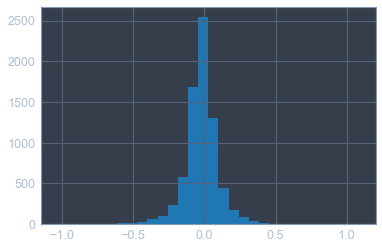

In [826]:
np.log10(y_pred_cur / y_test_cur).hist(bins=30)

In [798]:
# Saving predictions
d_preds['no_cnn13'] = y_pred.copy()

### Previous test set errors

In [200]:
# scauto morphology for no edge-ons
pedge = df_metamorph.loc[y_test.index, 't02_a04_cum_weighted'].values
noedge_chisq = chisq(y_test[pedge < 0.1], y_pred[pedge < 0.1], 
                     weight.loc[y_test.index][pedge < 0.1])
print('chi-sq without edge ons', noedge_chisq)

chi-sq without edge ons 12.904455437351302


In [185]:
# logL cheating
cur_chisq = chisq(y_test, y_pred, weight.loc[y_test.index])
print('chi-sq', cur_chisq)

chi-sq 12.987414779484848


In [145]:
# gz2 + logL cheating
cur_chisq = chisq(y_test, y_pred, weight.loc[y_test.index])
print('chi-sq', cur_chisq)

chi-sq 12.112413194430621


In [23]:
# scauto + incep
cur_chisq = chisq(y_test, y_pred, weight.loc[y_test.index])
print('chi-sq', cur_chisq)

chi-sq 16.25413247096925


In [94]:
# uniform weights
cur_chisq = chisq(y_test, y_pred, (1 / np.square(ml_err)).loc[y_test.index])
print('chi-sq', cur_chisq)

chi-sq 34.46479730500369


### True vs pred

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


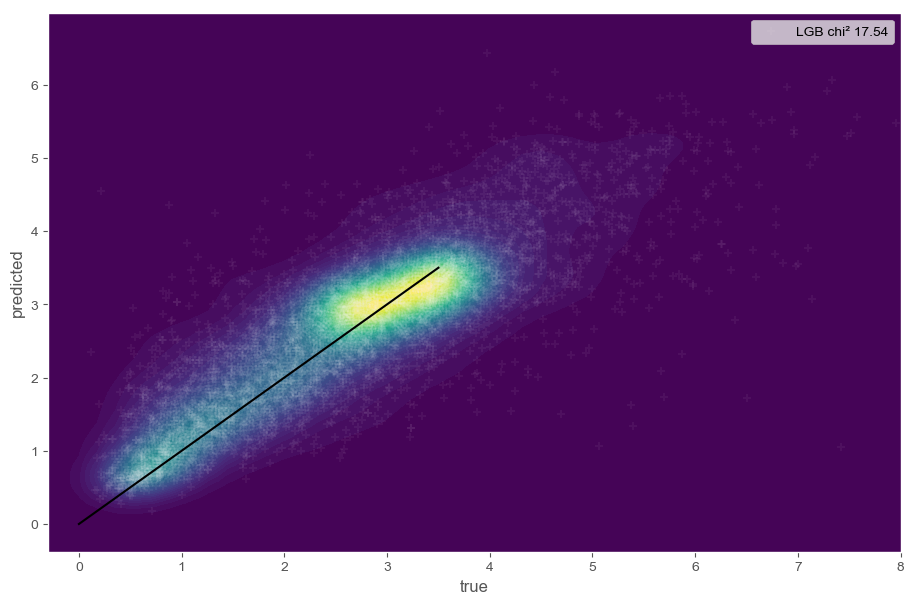

In [384]:
#x1, y1, c1 = estimate_density(y_test, y_pred)
# redshift = df_meta.loc[y_test.index, 'redshift']
with plt.style.context(['default', 'ggplot']):
    plt.figure(figsize=(11, 7))
    sns.kdeplot(y_test, y_pred, alpha=1, cmap=cmap, shade=True, #bw=0.2, cut=0, n_levels=60, 
                n_levels=60)
    plt.scatter(y_test, y_pred, marker='+', c='w', alpha=0.05,
                label=f'LGB chi² {cur_chisq:.2f}')
    plt.plot([0, 3.5], [0, 3.5], 'k')
    plt.xlim([-0.3, 8])
    plt.legend()
    plt.xlabel('true')
    plt.ylabel('predicted')
    #plt.savefig('plots/lgbm/truevspred_gz2_3cnn_r50ML37.png')

### Paper true vs pred

In [39]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.502520
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000000,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.176818
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.213653,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.990

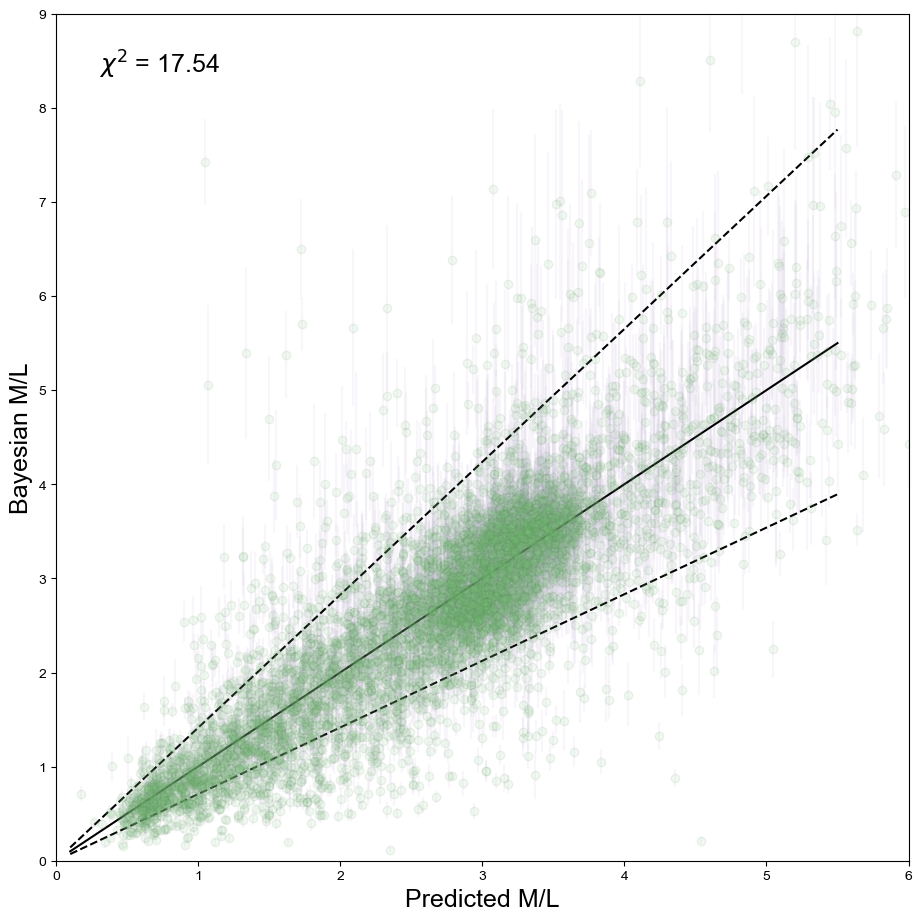

In [385]:
c = df_metamorph.loc[idx_test, 't02_a04_cum_weighted']
y_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
x = np.linspace(0.1, 5.5, 10)
dexlines = 0.15
with plt.style.context(['default']):
    plt.rcParams['axes.labelsize'] = 18
    plt.figure(figsize=(11, 11))
#     sns.kdeplot(y_test, y_pred, alpha=1, cmap=cmap, shade=True, #bw=0.2, cut=0, n_levels=60, 
#                 n_levels=60)
#     plt.scatter(y_pred, y_test, c=c, alpha=0.1,
#                 label=f'LGB chi² {cur_chisq:.2f}')
    plt.errorbar(y_pred, y_test, yerr=y_err, linestyle='None', alpha=0.1, marker='o',
                 ecolor='#beaed4', mfc='#7fc97f', mec='#588958')
    chisq = np.mean(np.square((y_test - y_pred) / y_test_err))
    ax = plt.gca()
    ax.text(0.05, 0.93, r'$\chi^2$ = '+f'{chisq:.2f}', transform=ax.transAxes,
                fontsize=18)
    #plt.scatter(y_pred, y_test, alpha=0.2)
    plt.plot(x, x, 'k')
    plt.plot(x, np.power(10, dexlines)*x, 'k--')
    plt.plot(x, np.power(10, -dexlines)*x, 'k--')
    plt.xlim([0, 6])
    plt.ylim([0, 9])
    #plt.legend()
    plt.ylabel('Bayesian M/L')
    plt.xlabel('Predicted M/L')
#     plt.savefig('plots/lgbm/truevspred.pdf', bbox_inches='tight')

Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density


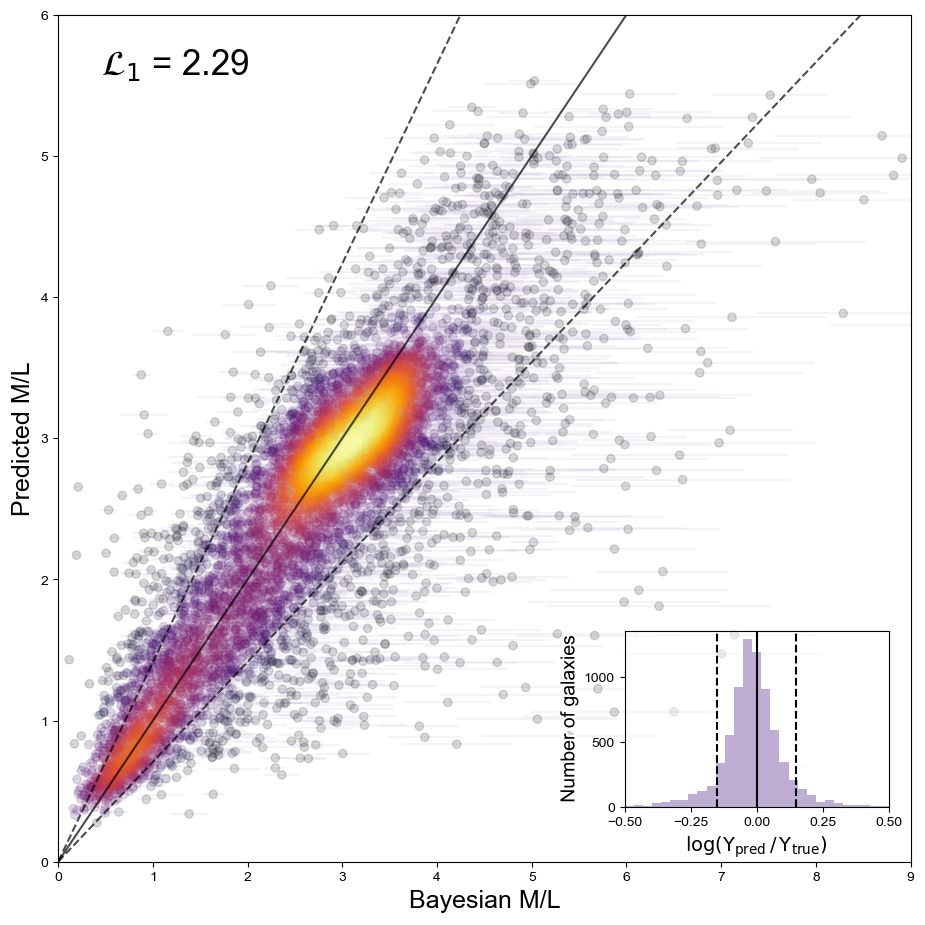

In [574]:
import matplotlib.patheffects as path_effects
c = df_metamorph.loc[idx_test, 't02_a04_cum_weighted']
y_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
x = np.linspace(0.001, 9, 10)
dexlines = 0.15
with plt.style.context(['default']):
    plt.rcParams['axes.labelsize'] = 18
    f = plt.figure(figsize=(11, 11))
#     sns.kdeplot(y_test, y_pred, alpha=1, cmap=cmap, shade=True, #bw=0.2, cut=0, n_levels=60, 
#                 n_levels=60)
#     plt.scatter(y_pred, y_test, c=c, alpha=0.1,
#                 label=f'LGB chi² {cur_chisq:.2f}')
#     plt.errorbar(y_pred, y_test, yerr=y_err, linestyle='None', alpha=0.1, marker='o',
#                  ecolor='#beaed4', mfc='#7fc97f', mec='#588958')
    y_test_c, y_pred_c, c = estimate_density(y_test, y_pred,
                                            verbose=True)
    plt.errorbar(y_test, y_pred, xerr=y_test_err, linestyle='None', alpha=0.15, marker='None',
                 ecolor='#beaed4')
    plt.scatter(y_test_c, y_pred_c, c=c, alpha=0.15, zorder=50, cmap='inferno')
    
    chi = np.mean(np.abs((y_test - y_pred) / y_test_err))
    ax = plt.gca()
    ax.text(0.05, 0.93, r'$\mathcal{L}_1$ = '+f'{chi:.2f}', transform=ax.transAxes,
                fontsize=25)
    #plt.scatter(y_pred, y_test, alpha=0.2)
    alpha = 0.7
    plt.plot(x, x, 'k', zorder=100, alpha=alpha)
    plt.plot(x, np.power(10, dexlines)*x, 'k--', zorder=100, alpha=alpha)
    plt.plot(x, np.power(10, -dexlines)*x, 'k--', zorder=100, alpha=alpha)
    plt.ylim([0, 6])
    plt.xlim([0, 9])
    #plt.legend()
    plt.xlabel('Bayesian M/L')
    plt.ylabel('Predicted M/L')
    # Create inset histogram
    axh = f.add_axes([0.64, 0.16, 0.24, 0.16])
    axh.patch.set_alpha(0.5)
    bins = np.linspace(-0.5, 0.5, 30)
    axh.hist(np.log10((y_pred / y_test)), bins=bins, color='#beaed4')
    axh.set_xlim([-0.5, 0.5])
    axh.xaxis.set_major_locator(plt.LinearLocator(numticks=5))
    axh.axvline(x=dexlines, color='k', linestyle='--')
    axh.axvline(x=-dexlines, color='k', linestyle='--')
    axh.axvline(x=0, color='k')
    axh.set_xlabel(r'$\log (\Upsilon_{\rm{pred}}\, / \, \Upsilon_{\rm{true}})$', fontsize=14)
    axh.set_ylabel('Number of galaxies', fontsize=14,
                  path_effects = [path_effects.Stroke(linewidth=3, foreground='white'),
                       path_effects.Normal()])
    plt.savefig('plots/lgbm/truevspred_chi.pdf', bbox_inches='tight')

### True vs pred (recal Zibetti) (paper)

In [285]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704
123766250

In [575]:
y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_minchi']
chisq_zib = np.square((y_test - y_zib) / y_test_err)
chisq_zib.head()

SDSS_ID
1237661360762257515    2.170571
1237659327092818026    0.442035
1237667430096765097    1.725613
1237657769627877412    0.004999
1237661358078886007    0.001014
dtype: float64

mean chisq (leave out 2) 8.76169962679062
median chisq 2.120213352988249


(0, 10)

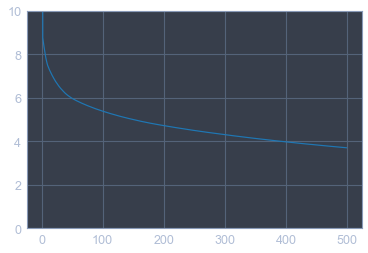

In [156]:
print('mean chisq (leave out 2)', chisq_zib.sort_values()[:-2].mean())
print('median chisq', chisq_zib.median())
x = list(range(500))
val = list(map(lambda x: chisq_zib.sort_values()[:-x].mean(), x))
plt.plot(x, val)
plt.ylim([0, 10])

Calculating density...
Kernel factor = 0.22673080521045796
Sorting by density


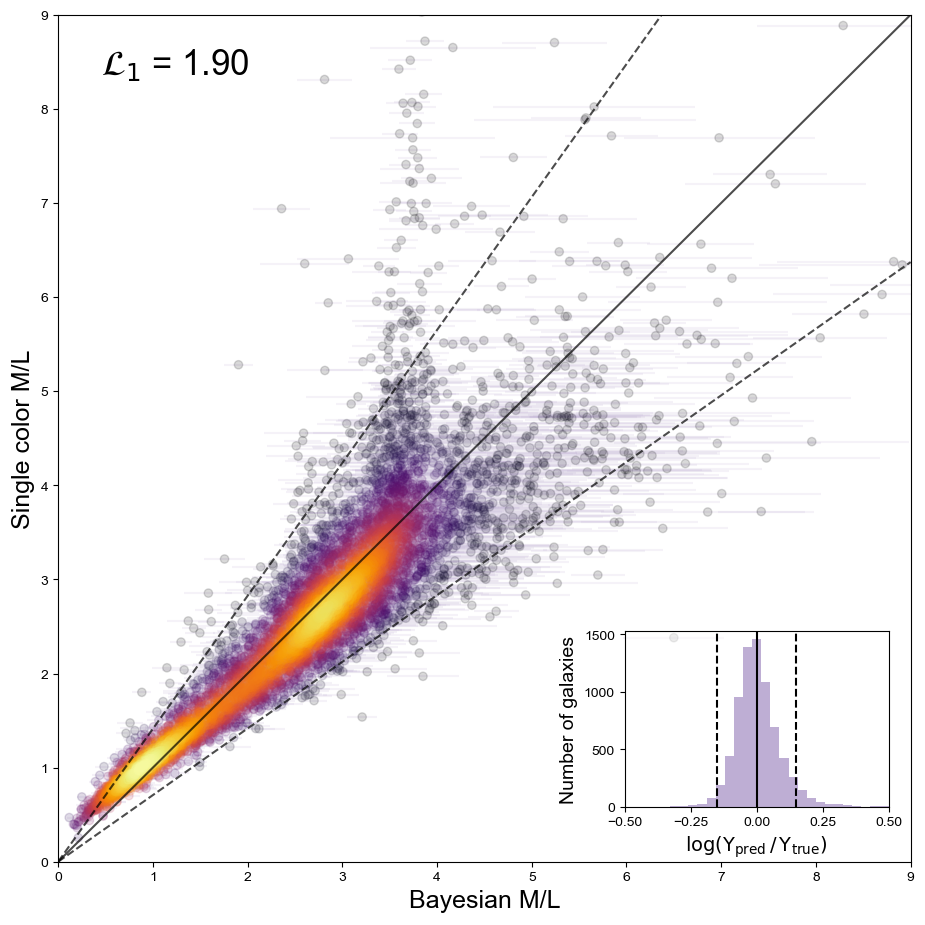

In [577]:
# Zibetti
%autoreload
from usefulfuncs import estimate_density_sk
x = np.linspace(0.001, 9, 10)
dexlines = 0.15
y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_minchi']
with plt.style.context(['default']):
    plt.rcParams['axes.labelsize'] = 18
    f = plt.figure(figsize=(11, 11))
#     sns.kdeplot(y_test, y_pred, alpha=1, cmap=cmap, shade=True, #bw=0.2, cut=0, n_levels=60, 
#                 n_levels=60)
#     plt.scatter(y_pred, y_test, c=c, alpha=0.1,
#                 label=f'LGB chi² {cur_chisq:.2f}')
    b_sel = (y_zib < 1e3)
#     y_test_c, y_zib_c, c = estimate_density_sk(y_test[b_sel].values.copy(), y_zib[b_sel].values.copy(),
#                                                verbose=True)
    y_test_c, y_zib_c, c = estimate_density(y_test[b_sel].values.copy(), y_zib[b_sel].values.copy(),
                                            verbose=True)
#     plt.errorbar(y_test, y_zib, yerr=y_test_err, linestyle='None', alpha=0.1, marker='o',
#                  ecolor='#beaed4', mfc='#7fc97f', mec='#588958')
    plt.errorbar(y_test, y_zib, xerr=y_test_err, linestyle='None', alpha=0.15, marker='None',
                 ecolor='#beaed4')
    plt.scatter(y_test_c, y_zib_c, c=c, alpha=0.15, zorder=50, cmap='inferno')
    chi = np.abs((y_test - y_zib) / y_test_err)
    chi = chi.sort_values()[:-2].mean()
    ax = plt.gca()
    ax.text(0.05, 0.93, r'$\mathcal{L}_1$ = '+f'{chi:.2f}', transform=ax.transAxes,
                fontsize=25)
    #plt.scatter(y_pred, y_test, alpha=0.2)
    alpha = 0.7
    plt.plot(x, x, 'k', zorder=100, alpha=alpha)
    plt.plot(x, np.power(10, dexlines)*x, 'k--', zorder=100, alpha=alpha)
    plt.plot(x, np.power(10, -dexlines)*x, 'k--', zorder=100, alpha=alpha)
    plt.xlim([0, 9])
    plt.ylim([0, 9])
    #plt.legend()
    plt.xlabel('Bayesian M/L')
    plt.ylabel('Single color M/L')
    # Create inset histogram
    axh = f.add_axes([0.64, 0.16, 0.24, 0.16])
    axh.patch.set_alpha(0.5)
    bins = np.linspace(-0.5, 0.5, 30)
    axh.hist(np.log10((y_zib / y_test)[b_sel]), bins=bins, color='#beaed4')
    axh.set_xlim([-0.5, 0.5])
    axh.xaxis.set_major_locator(plt.LinearLocator(numticks=5))
    axh.axvline(x=dexlines, color='k', linestyle='--')
    axh.axvline(x=-dexlines, color='k', linestyle='--')
    axh.axvline(x=0, color='k')
    axh.set_xlabel(r'$\log (\Upsilon_{\rm{pred}}\, / \, \Upsilon_{\rm{true}})$', fontsize=14)
    axh.set_ylabel('Number of galaxies', fontsize=14)
    plt.savefig('plots/zibetti/truevspred_zib.pdf', bbox_inches='tight')

### Original Zibetti

In [134]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.502520,0.199998
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.176818,0.340460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.990084,0.811851
1237662500

In [136]:
col = (df_metamorph['modelMag_g'] - df_metamorph['modelMag_i']).loc[idx_test]
col.describe()

count    7363.000000
mean        1.163192
std         0.304227
min         0.003450
25%         0.991325
50%         1.226950
75%         1.353205
max         9.011450
dtype: float64

In [181]:
# a, b = -1.197, 1.431  # original zibetti
a, b = -0.51106904, 0.75871943  # -0.51106904 + (0.75871943
ml_zibo = np.power(10, a+(b*col))
ml_zibo.describe()

count    7.363000e+03
mean     3.249524e+02
std      2.486971e+04
min      3.101334e-01
25%      1.742082e+00
50%      2.629310e+00
75%      3.278188e+00
max      2.118816e+06
dtype: float64

In [182]:
ml_zibo.head()

SDSS_ID
1237661360762257515    1.197433
1237659327092818026    3.656625
1237667430096765097    1.184760
1237657769627877412    6.066661
1237661358078886007    1.092492
dtype: float64

In [179]:
df_metamorph.loc[idx_test, 'ML_zibetti'].head()

SDSS_ID
1237661360762257515    1.102069
1237659327092818026    3.938463
1237667430096765097    1.048419
1237657769627877412    6.474390
1237661358078886007    0.985506
Name: ML_zibetti, dtype: float64

In [175]:
(df_metamorph.loc[idx_test, 'ML_zibetti'] / ml_zibo).head()

SDSS_ID
1237661360762257515     60.779305
1237659327092818026    160.885084
1237667430096765097     57.986137
1237657769627877412    230.818562
1237661358078886007     55.707822
dtype: float64

In [171]:
y_test.head()

SDSS_ID
1237661360762257515    0.930582
1237659327092818026    3.590328
1237667430096765097    0.972972
1237657769627877412    6.351525
1237661358078886007    0.999493
Name: ML_bayes, dtype: float64

In [168]:
chisq_zibo = np.square((y_test - ml_zibo) / y_test_err)
chisq_zibo.describe()

count    7363.000000
mean      213.214912
std       136.310906
min         9.324092
25%        88.680701
50%       177.280400
75%       398.438767
max       399.921650
dtype: float64

In [144]:
chisq_zibo.sort_values(ascending=False).head()

SDSS_ID
1237665429185298588    8.134162e+24
1237656567575478581    4.396090e+20
1237660558670299363    8.391863e+04
1237658203975319678    6.597321e+04
1237658607685664807    6.317951e+04
dtype: float64

In [145]:
chisq_zibo.sort_values(ascending=False)[2:].mean()

209.66496101166805

In [232]:
chisq_zibo.sort_values(ascending=False)[1000:].head()

SDSS_ID
1237662198823649660    399.231103
1237667537464131836    399.230574
1237658423553163512    399.230028
1237656242243633405    399.229393
1237656242242191510    399.228985
dtype: float64

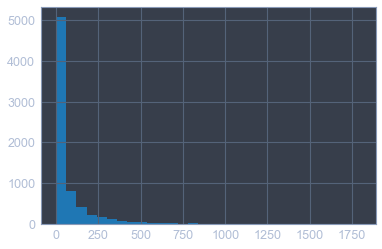

In [143]:
chisq_zibo.sort_values(ascending=False)[100:].hist(bins=30)

### Morpho g+i

In [511]:
# Run after training gi model
y_pred_gi = y_pred.copy()

Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density
Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density


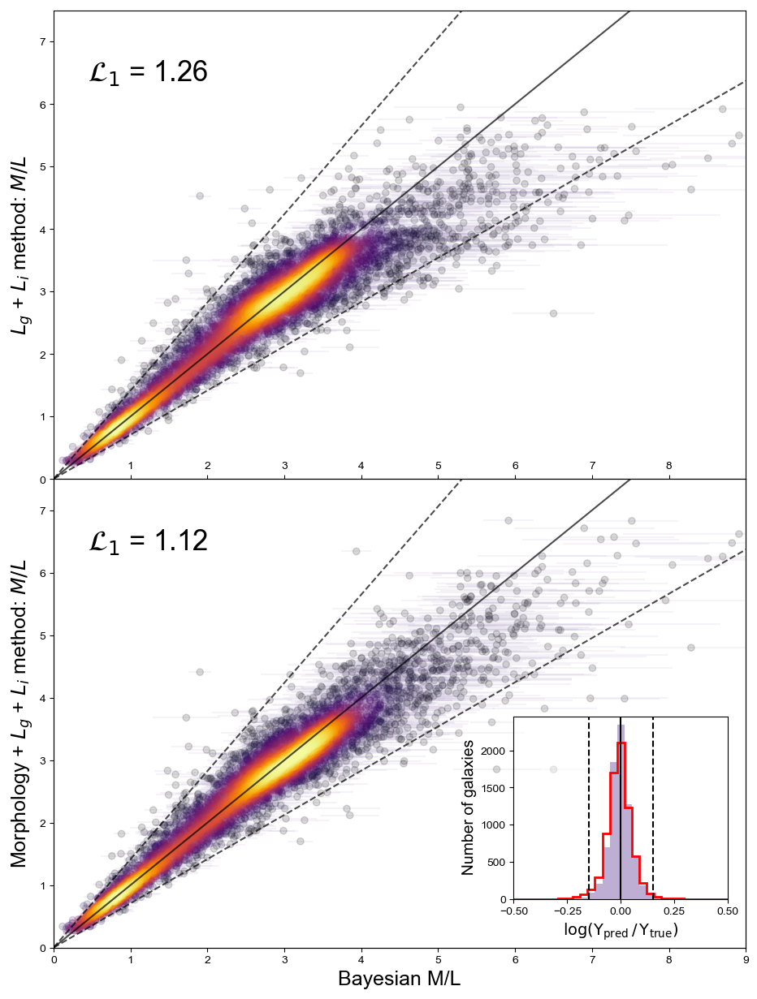

In [561]:
y_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
x = np.linspace(0.001, 9, 10)
dexlines = 0.15
with plt.style.context(['default']):
    plt.rcParams['axes.labelsize'] = 18
    f, axarr = plt.subplots(nrows=2, figsize=(11, 15), gridspec_kw={'hspace': 0})
    first = True
    for ax, y_meth, methname in zip(axarr, [y_pred_gi, y_pred], 
                                    ['$L_g$ + $L_i$ method: $M/L$',
                                     'Morphology + $L_g$ + $L_i$ method: $M/L$']):
        y_test_c, y_meth_c, c = estimate_density(y_test, y_meth,
                                            verbose=True)
        ax.errorbar(y_test, y_meth, xerr=y_err, linestyle='None', alpha=0.15, marker='None',
                     ecolor='#beaed4')
        ax.scatter(y_test_c, y_meth_c, c=c, alpha=0.15, zorder=50, cmap='inferno')
#         ax.errorbar(y_test, y_meth, xerr=y_err, linestyle='None', alpha=0.1, marker='o',
#                      ecolor='#beaed4', mfc='#7fc97f', mec='#588958')
        chi = np.mean(np.abs((y_test - y_meth) / y_test_err))
        ax.text(0.05, 0.85, r'$\mathcal{L}_1$ = '+f'{chi:.2f}', transform=ax.transAxes,
                fontsize=25)
        alpha = 0.7
        ax.plot(x, x, 'k', zorder=100, alpha=alpha)
        ax.plot(x, np.power(10, dexlines)*x, 'k--', zorder=100, alpha=alpha)
        ax.plot(x, np.power(10, -dexlines)*x, 'k--', zorder=100, alpha=alpha)
        ax.set_ylim([0, 7.5])
        ax.set_xlim([0, 9])
#         ax.tick_params('x', direction='inout')
        if not first:
            ax.set_xlabel('Bayesian M/L')
            ax.tick_params('x', bottom=True, labelbottom=True, direction='out')
            axt = ax.twiny()
            axt.set_xlim([0, 9])
            axt.tick_params('x', top=True, labeltop=True, direction='out')
            plt.draw()
            axt.set_xticks(list(range(1, 9)))
#             ax.set_xticklabels(ax.get_xticklabels(),
#                               path_effects = [path_effects.Stroke(linewidth=3, foreground='white'),
#                        path_effects.Normal()])
#             ax.tick_params('x', bottom=True, top=True, labelbottom=True, labeltop=True)
            axh = f.add_axes([0.64, 0.15, 0.24, 0.15])
            axh.patch.set_alpha(0.5)
            axh.hist(np.log10((y_pred / y_test)), bins=bins, color='#beaed4', histtype='stepfilled')
            axh.hist(np.log10((y_pred_gi / y_test)), bins=bins, color='r', histtype='step',
                     linewidth=2)
            axh.set_xlim([-0.5, 0.5])
            axh.xaxis.set_major_locator(plt.LinearLocator(numticks=5))
            axh.axvline(x=dexlines, color='k', linestyle='--')
            axh.axvline(x=-dexlines, color='k', linestyle='--')
            axh.axvline(x=0, color='k')
            axh.set_xlabel(r'$\log (\Upsilon_{\rm{pred}}\, / \, \Upsilon_{\rm{true}})$', fontsize=14)
            axh.set_ylabel('Number of galaxies', fontsize=14,
                          path_effects = [path_effects.Stroke(linewidth=3, foreground='white'),
                               path_effects.Normal()])
        else:
            ax.tick_params('x', bottom=False, top=False, labelbottom=False)
            first = False
        ax.set_ylabel(methname)
    #plt.tight_layout()
    plt.savefig('plots/lgbm/truevspred_morph-gi_vs_gi.pdf', dpi=100, bbox_inches='tight')

Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density
Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density


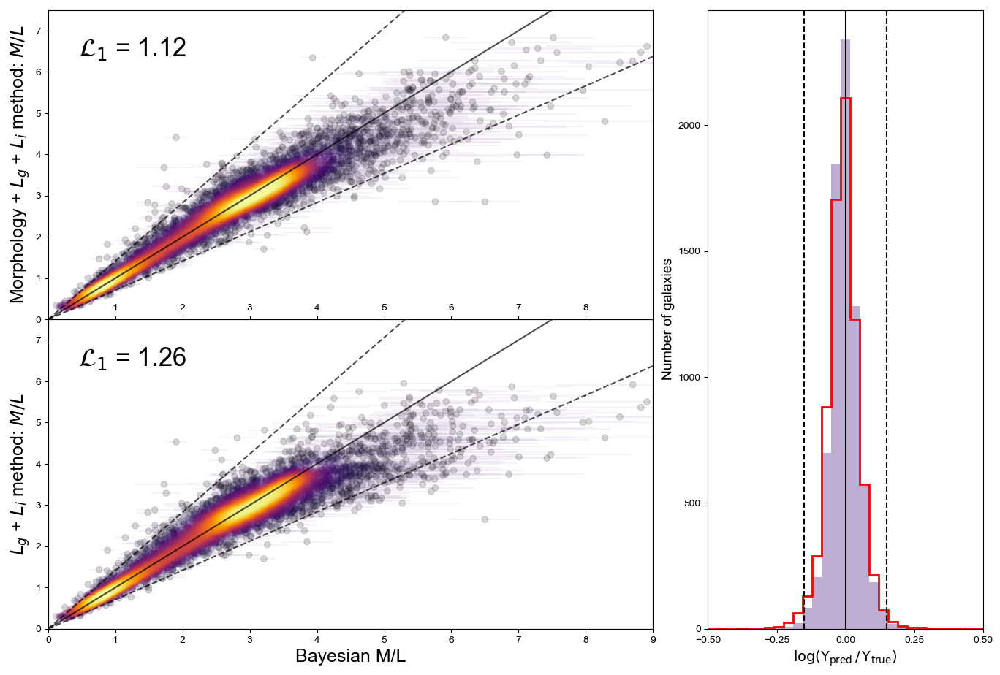

In [548]:
# With extra histogram
import matplotlib.gridspec as gridspec

y_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
x = np.linspace(0.001, 9, 10)
dexlines = 0.15
with plt.style.context(['default']):
    f = plt.figure(figsize=(16.5, 11))
    gs = gridspec.GridSpec(2, 3, figure=f, hspace=0)
    plt.rcParams['axes.labelsize'] = 18
#     f, axarr = plt.subplots(nrows=2, figsize=(11, 11), gridspec_kw={'hspace': 0})
    first = True
    axarr = [plt.subplot(gs[0, :2]), plt.subplot(gs[1, :-1])]
    for ax, y_meth, methname in zip(axarr, [y_pred, y_pred_gi], 
                                    ['Morphology + $L_g$ + $L_i$ method: $M/L$',
                                     '$L_g$ + $L_i$ method: $M/L$']):
        y_test_c, y_meth_c, c = estimate_density(y_test, y_meth,
                                            verbose=True)
        ax.errorbar(y_test, y_meth, xerr=y_err, linestyle='None', alpha=0.15, marker='None',
                     ecolor='#beaed4')
        ax.scatter(y_test_c, y_meth_c, c=c, alpha=0.15, zorder=50, cmap='inferno')
#         ax.errorbar(y_test, y_meth, xerr=y_err, linestyle='None', alpha=0.1, marker='o',
#                      ecolor='#beaed4', mfc='#7fc97f', mec='#588958')
        chi = np.mean(np.abs((y_test - y_meth) / y_test_err))
        ax.text(0.05, 0.85, r'$\mathcal{L}_1$ = '+f'{chi:.2f}', transform=ax.transAxes,
                fontsize=25)
        alpha = 0.7
        ax.plot(x, x, 'k', zorder=100, alpha=alpha)
        ax.plot(x, np.power(10, dexlines)*x, 'k--', zorder=100, alpha=alpha)
        ax.plot(x, np.power(10, -dexlines)*x, 'k--', zorder=100, alpha=alpha)
        ax.set_ylim([0, 7.5])
        ax.set_xlim([0, 9])
#         ax.tick_params('x', direction='inout')
        if not first:
            ax.set_xlabel('Bayesian M/L')
            ax.tick_params('x', bottom=True, labelbottom=True, direction='out')
            axt = ax.twiny()
            axt.set_xlim([0, 9])
            axt.tick_params('x', top=True, labeltop=True, direction='out')
            plt.draw()
            axt.set_xticks(list(range(1, 9)))
#             ax.set_xticklabels(ax.get_xticklabels(),
#                               path_effects = [path_effects.Stroke(linewidth=3, foreground='white'),
#                        path_effects.Normal()])
#             ax.tick_params('x', bottom=True, top=True, labelbottom=True, labeltop=True)
        else:
            ax.tick_params('x', bottom=False, top=False, labelbottom=False)
            first = False
        ax.set_ylabel(methname)
    # Histogram
    axh = plt.subplot(gs[:, -1])
    bins = np.linspace(-0.5, 0.5, 30)
    axh.hist(np.log10((y_pred / y_test)), bins=bins, color='#beaed4', histtype='stepfilled')
    axh.hist(np.log10((y_pred_gi / y_test)), bins=bins, color='r', histtype='step',
             linewidth=2)
    axh.set_xlim([-0.5, 0.5])
    axh.xaxis.set_major_locator(plt.LinearLocator(numticks=5))
    axh.axvline(x=dexlines, color='k', linestyle='--')
    axh.axvline(x=-dexlines, color='k', linestyle='--')
    axh.axvline(x=0, color='k')
    axh.set_xlabel(r'$\log (\Upsilon_{\rm{pred}}\, / \, \Upsilon_{\rm{true}})$', fontsize=14)
    axh.set_ylabel('Number of galaxies', fontsize=14,
                  path_effects = [path_effects.Stroke(linewidth=3, foreground='white'),
                       path_effects.Normal()])
    #plt.tight_layout()
#     plt.savefig('plots/lgbm/truevspred_morph-gi_vs_gi.pdf', dpi=100, bbox_inches='tight')

In [79]:
from sklearn.metrics import r2_score
test_weights = weight.loc[y_test.index]
test_weights /= test_weights.sum()
r2_score(y_test, y_pred, sample_weight=test_weights)

0.74223686558351476

### Feature importance

In [292]:
gbm.feature_importance()

array([1075,  170,  364, ...,   35, 1083,  700])

In [302]:
imp_idx = gbm.feature_importance().argsort()[::-1]
np.array(gbm.feature_name())[imp_idx][:10]

array(['redshift', 'pre.sum.lum', 'pre.mean.center.lum', 'd_pix_kpc',
       'r50_scauto_197_pretrained.6.notop', 'pre.min.lum',
       'pre.center.lum', 'r50_scauto_197_pretrained.14.notop',
       'pre.scaleval', 'r50_scauto_197_pretrained.8.notop'], dtype='<U34')

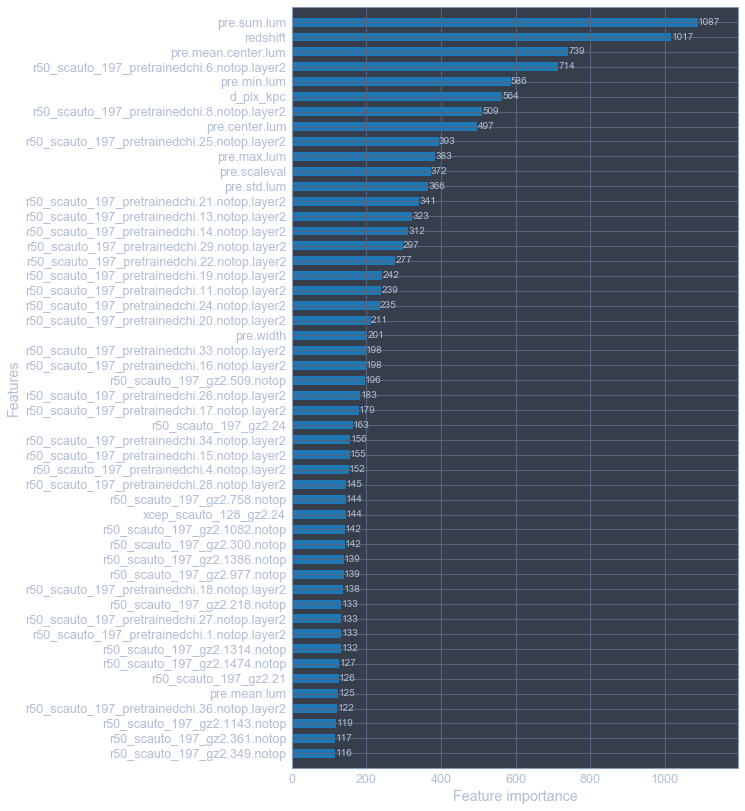

In [578]:
lgbm.plot_importance(gbm, max_num_features=50, title='', height=0.6, figsize=(8, 14))

In [629]:
def hex2rgb(chex):
    return tuple(int(chex[i+1:i+3], 16) for i in (0, 2 ,4))
    
def rgb2hex(crgb):
    s = '#'
    for val in crgb:
        s += hex(val)[-2:].replace('x', '0')
    return s

def blend_hex(c1, c2='#ffffff', f=0.5):
    rgb1 = hex2rgb(c1)
    rgb2 = hex2rgb(c2)
    rgbm = [int(f*rgb1[i]+(1-f)*rgb2[i]) for i in range(3)]
    return rgb2hex(rgbm)
    
hex2rgb('#00ff10')
rgb2hex(hex2rgb('#00ff10'))
blend_hex('#00ff10', f=0.1)

'#e5ffe7'

In [630]:
def add_shadow(positions, values, ax, height=0.7, color='#5e7c5e', deltay=0.09, deltax=2,
               step=0.1, zorder=2, maxstep=2):
    cstep = step
    while cstep <= maxstep:
        dy, dx = cstep * deltay, cstep * deltax
        alpha = (1-(cstep/maxstep))
        col = blend_hex(color, f=alpha)
        ax.barh(positions - dy, values + dx, zorder=zorder, height=height, color=col,
                left=1)
        cstep += step

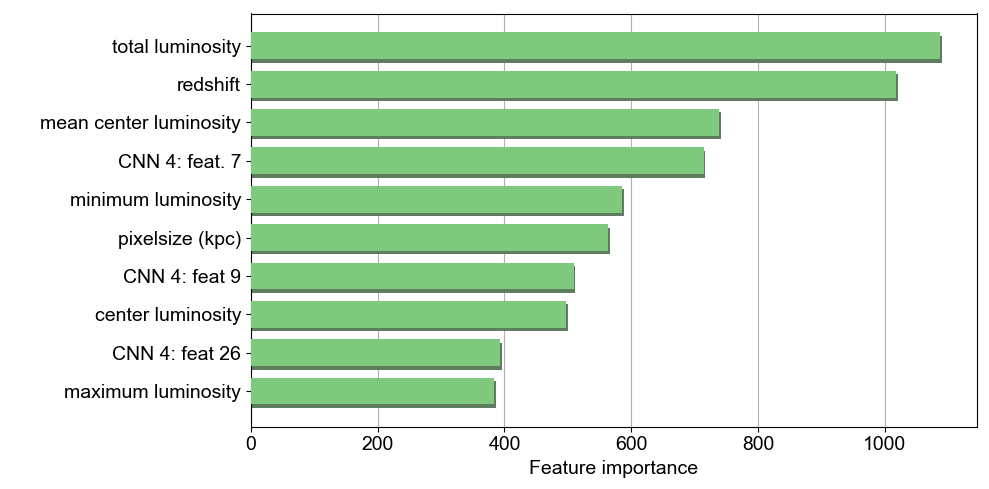

In [21]:
 with plt.style.context(['ggplot', 'default']):
    #plt.rcParams['font.family'] = 'helvetica'
    importances = np.sort(gbm.feature_importance())[::-1][:10][::-1]
    d_labelmap = {'redshift': 'redshift', 'pre.sum.lum': 'total luminosity', 
                  'pre.mean.center.lum': 'mean center luminosity',
                  'd_pix_kpc': 'pixelsize (kpc)', 
                  'r50_scauto_197_pretrainedchi.6.notop.layer2': 'CNN 4: feat. 7', 
                  'pre.min.lum': 'minimum luminosity', 'pre.center.lum': 'center luminosity',
                  'r50_scauto_197_pretrainedchi.25.notop.layer2': 'CNN 4: feat 26',
                  'pre.scaleval': 'scaling value', 'pre.max.lum': 'maximum luminosity',
                  'r50_scauto_197_pretrainedchi.8.notop.layer2': 'CNN 4: feat 9'}
    imp_idx = gbm.feature_importance().argsort()[::-1]
    top10 = np.array(gbm.feature_name())[imp_idx][:10]
    labels = list(map(lambda x: d_labelmap[x], top10))[::-1]
    
    positions = np.arange(len(importances))
#     ax = lgbm.plot_importance(gbm, max_num_features=10, height=0.6, title='',
#                               importance_type='split', grid=False, zorder=3, figsize=(8, 4),
#                               linewidth=1.5, edgecolor='#000000')
    f, ax = plt.subplots(figsize=(10, 5))
    ax.barh(positions, importances, zorder=3, color='#7fc97f', height=0.7)
    ax.barh(positions-0.09, importances+2, zorder=2, height=0.7, color='#5e7c5e',
            left=1, alpha=1)
#     add_shadow(positions, importances, ax, step=0.01)
    plt.yticks(positions, labels)
    #ax.yaxis.set_ticklabels(labels)
    #plt.grid(False, axis='y')
    plt.tick_params(labelsize=14)
    plt.grid(axis='x', zorder=-10)
    plt.ylabel('')
    plt.xlabel('Feature importance', fontsize=14)
    plt.sca(ax)
    plt.tight_layout()
    plt.savefig('plots/lgbm/feature_importance.pdf', bbox_inches='tight')

In [79]:
'r50_scauto_197_pretrainedchi.888.notop.layer2'.split('.')

['r50_scauto_197_pretrainedchi', '888', 'notop', 'layer2']

In [84]:
df_features.head()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,...,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,0.044273,0.039052,0.021237,0.010907,0.039915,0.000000,0.000000,...,0.0,0.0,0.000000,0.419165,0.0,0.043426,0.000000,0.000000,0.0,0.026036,0.085248,0.017091,0.0,0.001851,0.000000,0.373822,0.040094,0.000000,0.434619,0.000000,0.0,0.127402,0.000000,0.000000,0.000000,0.0,0.000000,0.043323,0.036078,0.285451,0.0,0.054541,0.000000,0.0,0.305673,0.0,0.000000,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,0.1213,1.008135
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,0.057638,0.014038,0.000000,0.002556,0.010689,0.006664,0.005807,...,0.0,0.0,0.019311,0.102425,0.0,0.270107,0.000000,0.040571,0.0,0.000000,0.011425,0.037226,0.0,0.116023,0.053348,0.250478,0.242314,0.024494,0.104177,0.000000,0.0,0.198361,0.0

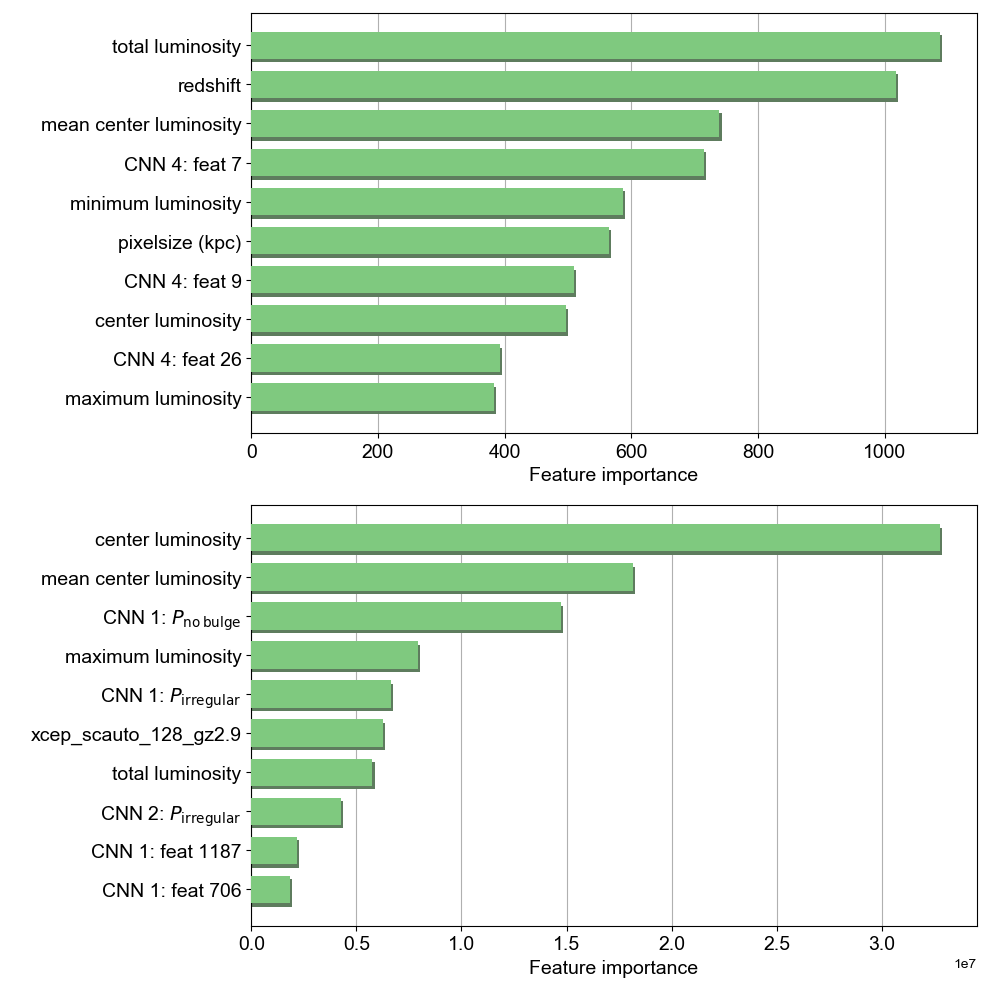

In [133]:
# Also for no CNN4
d_labelmap = {'redshift': 'redshift', 'pre.sum.lum': 'total luminosity', 
                  'pre.mean.center.lum': 'mean center luminosity',
                  'd_pix_kpc': 'pixelsize (kpc)', 
                  'pre.min.lum': 'minimum luminosity', 'pre.center.lum': 'center luminosity',
                  'pre.scaleval': 'scaling value', 'pre.max.lum': 'maximum luminosity',
                  'r50_scauto_197_gz2.9': r'CNN 1: $P_{\rm{no\,bulge}}$',
                  'r50_scauto_197_gz2.21': r'CNN 1: $P_{\rm{irregular}}$',
                  'r50_scauto_197_gz2.24': r'CNN 1: $P_{\rm{dustlane}}$',
                  'xcep_scauto_128_gz2.21': r'CNN 2: $P_{\rm{irregular}}$'}
def improve_name(label):
    if label in d_labelmap:
        return d_labelmap[label]
    if 'pretrainedchi' in label:
        nr = int(label.split('.')[1]) + 1
        return 'CNN 4: feat ' + str(nr)
    if 'r50' in label:
        nr = int(label.split('.')[1]) + 1
        return 'CNN 1: feat ' + str(nr)
    return label

def make_importance_plot(predictor, ax, importance_type='split'):
    plot_importances(predictor.feature_importance(importance_type), 
                     predictor.feature_name(), ax)
    
def plot_importances(importances, names, ax):
    importances, names = np.array(list(importances)), np.array(list(names))
    importance_top10 = np.sort(importances)[::-1][:10][::-1]
    imp_idx = importances.argsort()[::-1]
    names_top10 = np.array(names)[imp_idx][:10]
    names_top10 = list(map(improve_name, names_top10))[::-1]
    positions = np.arange(len(importance_top10))
    # Plot (with shadow)
    ax.barh(positions, importance_top10, zorder=3, color='#7fc97f', height=0.7)
    step = np.max(importance_top10)/1000
    ax.barh(positions-0.09, importance_top10+2*step, zorder=2, height=0.7, color='#5e7c5e',
            left=step, alpha=1)
    # Customize
    ax.set_yticks(positions)
    ax.set_yticklabels(names_top10)
    plt.sca(ax)
    plt.tick_params(labelsize=14)
    plt.grid(axis='x', zorder=-10)
    ax.set_ylabel('')
    ax.set_xlabel('Feature importance', fontsize=14)
    
    
with plt.style.context(['ggplot', 'default']):
    #plt.rcParams['font.family'] = 'helvetica'
    f, axarr = plt.subplots(nrows=2, figsize=(10, 10))
    make_importance_plot(gbm, axarr[0], importance_type='split')
    make_importance_plot(gbm_nocnn4, axarr[1], importance_type='gain')
    plt.tight_layout()
#     plt.savefig('plots/lgbm/feature_importance.pdf', bbox_inches='tight')

### Permutation importance
https://explained.ai/rf-importance/index.html  
https://link.springer.com/article/10.1186%2F1471-2105-8-25

In [42]:
df_features_nocnn4 = df_features.copy()

In [103]:
df_features_onlymorph = df_features.copy()

In [106]:
def l1_loss(true, pred, err):
    return np.mean(np.abs(true - pred) / err)

In [46]:
from tqdm import tqdm_notebook as tqdm
import time

for feat_name in tqdm(X_val.columns):
    time.sleep(0.001)

In [ ]:
X_val = df_features.loc[idx_val, :]
y_val = df_valid.loc[idx_val, 'ML_bayes']
y_valerr = np.maximum(df_valid['ML_bayes_err'], 0.05 * df_valid['ML_bayes']).loc[idx_val]
y_valpred = gbm.predict(X_val)
l1_base = l1_loss(y_val, y_valpred, y_valerr)
d_importance = {}

for feat_name in tqdm(X_val.columns):
    save = X_val[feat_name].copy()
    X_val[feat_name] = np.random.permutation(X_val[feat_name])
    y_shufflepred = gbm.predict(X_val)
    l1_shuffle = l1_loss(y_val, y_shufflepred, y_valerr)
    d_importance[feat_name] = l1_shuffle - l1_base
    X_val[feat_name] = save

In [107]:
X_val = df_features_onlymorph.loc[idx_val, :]
y_val = df_valid.loc[idx_val, 'ML_bayes']
y_valerr = np.maximum(df_valid['ML_bayes_err'], 0.05 * df_valid['ML_bayes']).loc[idx_val]
y_valpred = gbm_onlymorph.predict(X_val)
l1_base = l1_loss(y_val, y_valpred, y_valerr)
d_importance_onlymorph = {}

for feat_name in tqdm(X_val.columns):
    save = X_val[feat_name].copy()
    X_val[feat_name] = np.random.permutation(X_val[feat_name])
    y_shufflepred = gbm_onlymorph.predict(X_val)
    l1_shuffle = l1_loss(y_val, y_shufflepred, y_valerr)
    d_importance_onlymorph[feat_name] = l1_shuffle - l1_base
    X_val[feat_name] = save

In [63]:
import pickle

with open('data/export/d_importance.pkl', 'wb') as outf:
    pickle.dump(d_importance, outf)

with open('data/export/d_importance_nocnn4.pkl', 'wb') as outf:
    pickle.dump(d_importance_nocnn4, outf)
    
with open('data/export/d_importance_onlymorph.pkl', 'wb') as outf:
    pickle.dump(d_importance_onlymorph, outf)

In [73]:
d_importance

{'pre.sum.lum': 0.24543008765075003,
 'pre.mean.lum': 0.001787511534491415,
 'pre.max.lum': 0.02488371227440167,
 'pre.min.lum': 0.04617236728393337,
 'pre.std.lum': 0.013753875801149285,
 'pre.center.lum': 0.019526808658154593,
 'pre.mean.center.lum': 0.1178195833745761,
 'pre.width': 0.0005259687240322108,
 'pre.scaleval': 0.007507772180039396,
 'post.sum': 0.0001309082626903546,
 'post.mean': 0.00011892973345073443,
 'post.std': 0.0001512738568814065,
 'post.center': 0.0005623076296257246,
 'post.mean.center': 6.689668600623477e-05,
 'r50_scauto_197_gz2.0': 2.688542614448508e-05,
 'r50_scauto_197_gz2.1': -4.76924586876315e-05,
 'r50_scauto_197_gz2.2': 0.00010982758964406258,
 'r50_scauto_197_gz2.3': 0.00010061935584237958,
 'r50_scauto_197_gz2.4': 5.157048157267141e-05,
 'r50_scauto_197_gz2.5': -1.493982872213806e-05,
 'r50_scauto_197_gz2.6': 0.0008902319513266477,
 'r50_scauto_197_gz2.7': 0.00010593238378087122,
 'r50_scauto_197_gz2.8': 2.670764699352901e-05,
 'r50_scauto_197_gz2.9

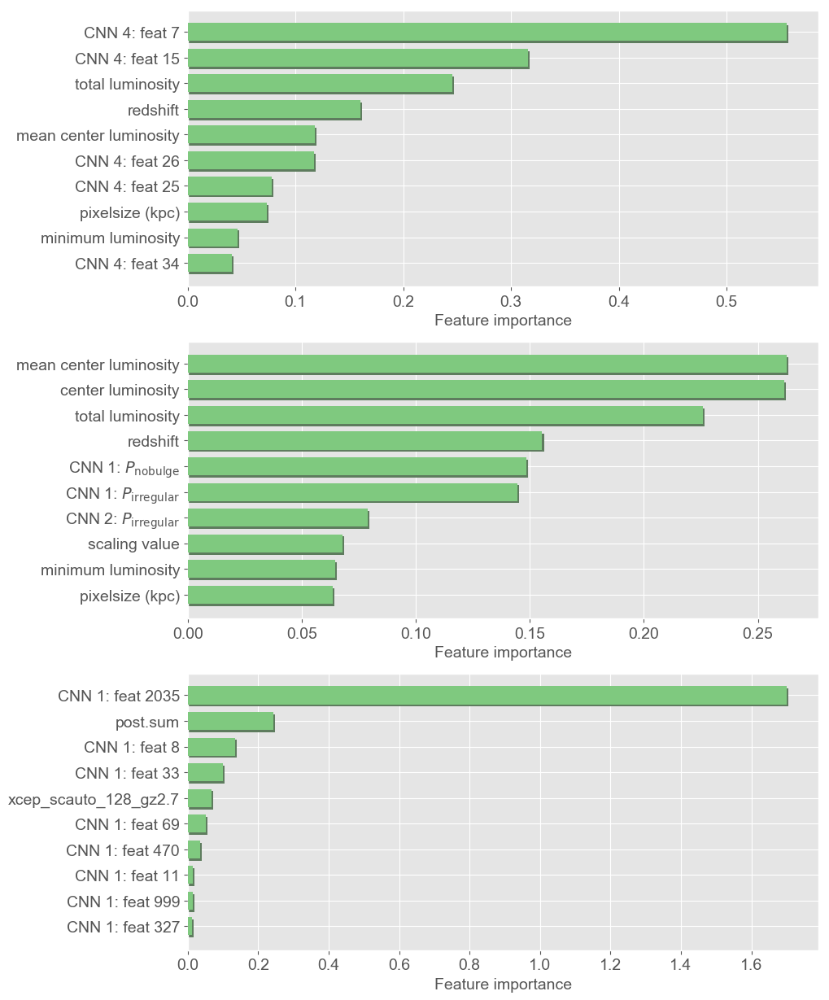

In [111]:
with plt.style.context(['default', 'ggplot']):
    f, axarr = plt.subplots(nrows=3, figsize=(10, 15))
    plot_importances(d_importance.values(), d_importance.keys(), axarr[0])
    plot_importances(d_importance_nocnn4.values(), d_importance_nocnn4.keys(), axarr[1])
    plot_importances(d_importance_onlymorph.values(), d_importance_nocnn4.keys(), axarr[2])

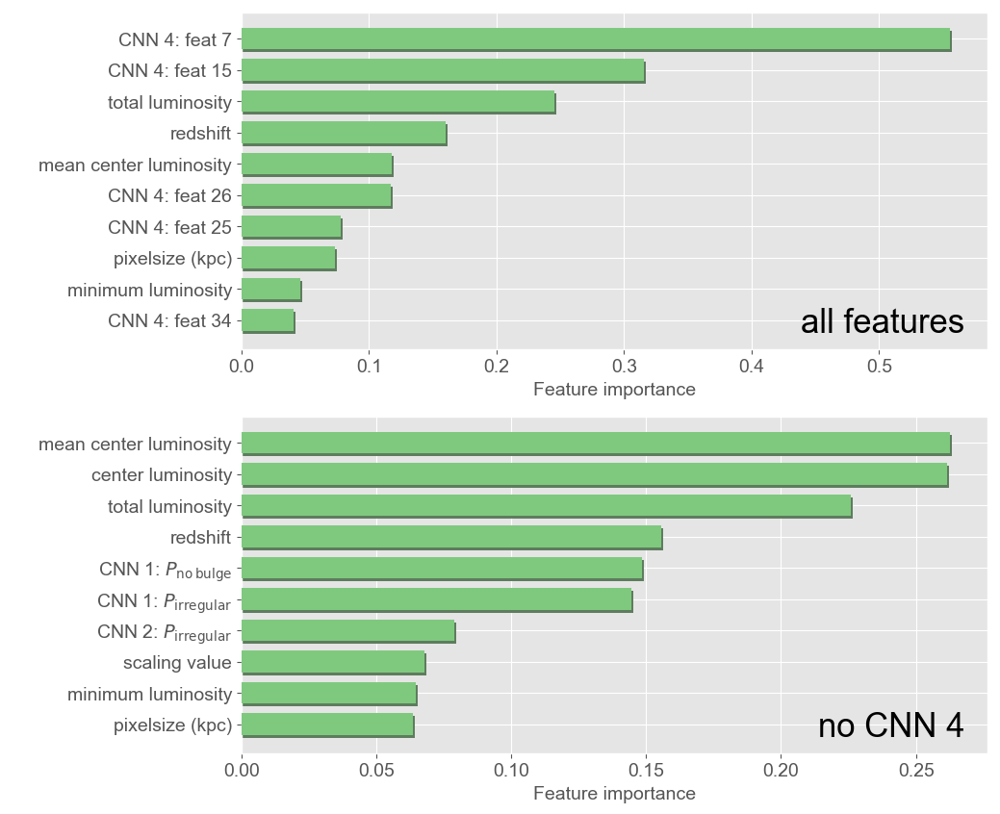

In [135]:
with plt.style.context(['default', 'ggplot']):
    f, axarr = plt.subplots(nrows=2, figsize=(10, 10))
    ax = axarr[0]
    plot_importances(d_importance.values(), d_importance.keys(), ax)
    ax.text(0.97, 0.05, 'all features', fontsize=25, transform=ax.transAxes, 
            horizontalalignment='right')
    ax = axarr[1]
    plot_importances(d_importance_nocnn4.values(), d_importance_nocnn4.keys(), ax)
    ax.text(0.97, 0.05, 'no CNN 4', fontsize=25, transform=ax.transAxes,
            horizontalalignment='right')
    plt.savefig('plots//lgbm/permutation_importances.pdf', bbox_inches='tight')

### Distance dependence

Text(0,0.5,'log(y_pred / y_test)')

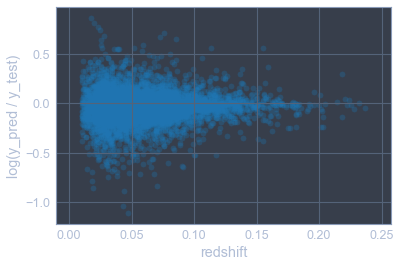

In [44]:
redshift = df_meta.loc[y_test.index, 'redshift']
plt.scatter(redshift, np.log10(y_pred / y_test), alpha=0.3)
plt.xlabel('redshift')
plt.ylabel('log(y_pred / y_test)')

Text(0,0.5,'relative error')

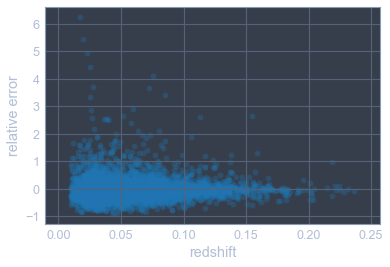

In [45]:
plt.scatter(redshift, (y_pred - y_test) / y_test, alpha=0.3)
plt.xlabel('redshift')
plt.ylabel('relative error')

In [48]:
df_meta.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89
1237662500543987740,242.00880,36.05398,0.562341,0.0658,46.129129,282.000016,0.546870,1.192938,10.439780,0.044860,1.748155e+10,1.137885e+08,True,True,2.752836e+10,2.843540e+09,1.574709,0.162659,16.988,15.997,1.775870,242.008785,36.053987,0.557186,1.315225,63.55
1237662474235085097,251.31645,25.60003,0.512861,0.0681,43.540800,291.857134,0.565985,1.540025,9.999021,0.040437,9.267565e+09,5.920384e+07,True,True,9.977489e+09,9.289901e+08,1.076603,0.100241,17.715,16.918,1.205651,251.316496,25.600029,0.510505,3.539973,42.81


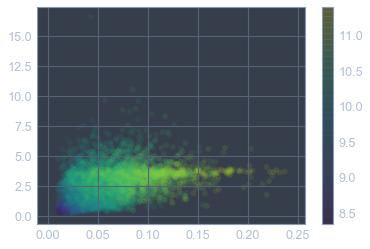

In [51]:
loglum = np.log10(df_meta.loc[y_test.index, 'L_g_bayes'])
plt.scatter(redshift, y_test, alpha=0.1, c=loglum)
plt.colorbar()

### Scatter around true value (dex differences)

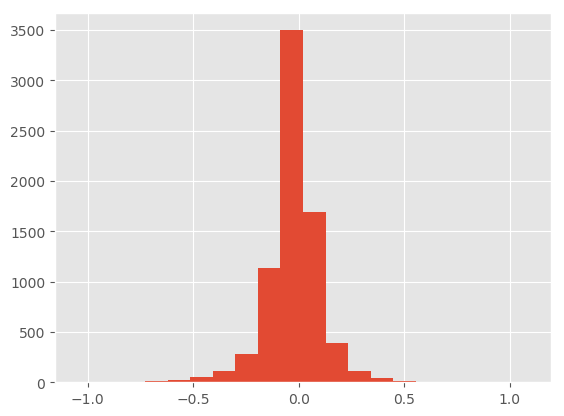

In [123]:
frac = y_pred / y_test
logfrac = np.log10(frac)
plt.hist(logfrac, bins=20);

In [129]:
frac_mean = np.mean(frac)
frac_scat = np.std(frac)
print(f'Lin space frac: {frac_mean:.2f} ± {frac_scat:.2f}')

Lin space frac: 0.99 ± 0.35


In [126]:
logfrac_mean = np.mean(logfrac)
logfrac_scat = np.std(logfrac)
print(f'Log space frac: {logfrac_mean:.2f} ± {logfrac_scat:.2f}')

Log space frac: -0.02 ± 0.13


In [127]:
frac_mean = np.mean(frac)
frac_scat = np.std(frac)
print(f'Log space frac from lin mean: {np.log10(frac_mean):.2f} ± {np.log10(1+frac_scat):.2f}')

Log space frac from lin mean: -0.00 ± 0.13


Text(0,0.5,'fraction of points outside of dex limit')

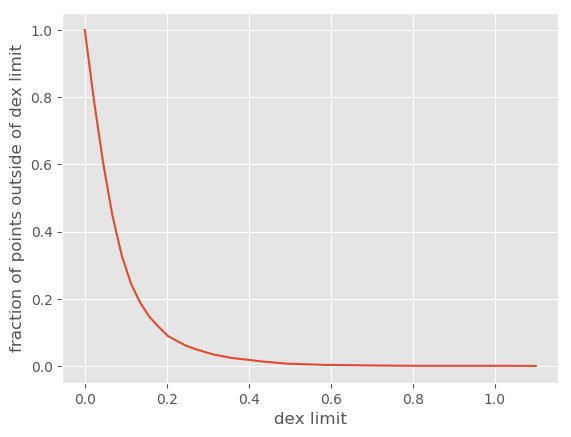

In [134]:
# Fraction of points lying outside dexlim dex
dexlim = np.linspace(0, 1.1)
ntest = len(logfrac)
outlier_frac = np.array([np.sum(np.abs(logfrac) > dexlim_cur)/ntest for dexlim_cur in dexlim])
plt.plot(dexlim, outlier_frac)
plt.xlabel('dex limit')
plt.ylabel('fraction of points outside of dex limit')

In [142]:
np.sum(np.abs(logfrac) > 0.5)/ntest

0.006383267689800353

## Zibetti

In [109]:
y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_modelmag']
chisq_zib = np.square((y_zib - y_test) / y_err)
chisq_zib.head()

SDSS_ID
1237661360762257515    4.979982
1237659327092818026    0.136389
1237667430096765097    5.277922
1237657769627877412    0.085884
1237661358078886007    1.326745
dtype: float64

In [144]:
np.min(y_zib), np.max(y_zib)

(0.3101334011970399, 2118815.627613366)

In [146]:
y_zib.max()

2118815.627613366

In [110]:
chisq_ml = np.square((y_pred - y_test) / y_err)

In [150]:
chisq_zib.sort_values(ascending=False)[2:].mean()

8.761699626790623

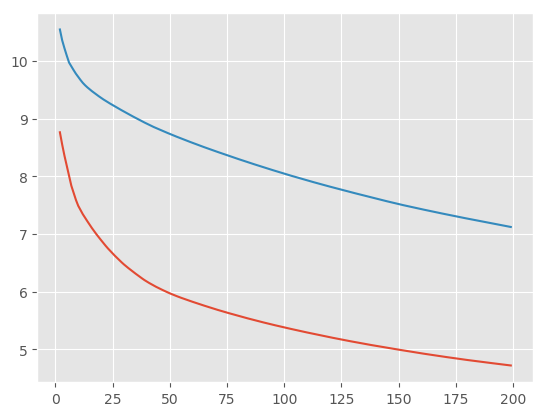

In [111]:
zidx = list(range(2, 200))
zib_chisq = [np.mean(chisq_zib.sort_values(ascending=False)[i:])for i in zidx]
ml_chisq = [np.mean(chisq_ml.sort_values(ascending=False)[i:])for i in zidx]
plt.plot(zidx, zib_chisq)
plt.plot(zidx, ml_chisq)

## Refit Zibetti with modelmags

In [54]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t09_a27_cum_weighted,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.0,0.000000,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.0,0.213653,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226
1237662500

In [131]:
~col.index.isin(X_test.index)

array([ True,  True,  True, ...,  True,  True,  True])

In [185]:
# Fitting
from scipy import optimize

zib_orig = lambda x: -1.197 + (1.431*x)

col = df_metamorph['modelMag_g'] - df_metamorph['modelMag_i']
validmask = (df_metamorph['modelMag_g'] < 90) & (df_metamorph['modelMag_i'] < 90)
validmask = (validmask & (col > 0) & (col < 2.5))
validmask = (validmask & (~col.index.isin(X_test.index)))
MLg = df_metamorph['ML_bayes']
logMLg = np.log10(df_metamorph['ML_bayes'])
# error on log = relative error (divided by log(10))  (also set a minimum)
MLgerr = np.maximum(df_metamorph['ML_bayes_err'], 0.05 * df_metamorph['ML_bayes'])
logMLgerr = MLgerr / (df_metamorph['ML_bayes'] * np.log(10.))

col = col[validmask]
MLg = MLg[validmask]
MLgerr = MLgerr[validmask]
logMLg = logMLg[validmask]
logMLgerr = logMLgerr[validmask]
chisq = df_metamorph['reduced_chi_square'][validmask]

estimate_ml_pl = lambda p, x: np.power(10, p[0] + p[1] * x)

errchisqfunc = lambda p, x, y, err: (y - estimate_ml_pl(p, x)) / err
errchifunc = lambda p, x, y, err: np.sqrt(np.abs((y - estimate_ml_pl(p, x)) / err))
err_rmsle = lambda p, x, y: np.log10(estimate_ml_pl(p, x) / y)

pinit = [-1.197, 1.431]  # use zibetti as initial guess

# res_logchisq = optimize.least_squares(errlogchisqfunc, pinit,
#                                    args=(col, logMLg, logMLgerr))
res_chisq = optimize.least_squares(errchisqfunc, pinit,
                                 args=(col, MLg, MLgerr))
res_chi = optimize.least_squares(errchifunc, pinit,
                                 args=(col, MLg, MLgerr))
res_rmsle = optimize.least_squares(err_rmsle, pinit, args=(col, MLg))

#pfinalchisq, covchisq = outchisq[0], outchisq[1]
#pfinalm, cov = outchisqm[0], outchisqm[1]
# print(res_logchisq.x)
print('params chi', res_chi.x)
print('params chisq', res_chisq.x)
print('params rmsle', res_rmsle.x)
print('mean chisq', np.square(errchisqfunc(res_chisq.x, col, MLg, MLgerr)).mean())

params chi [-0.59444456  0.8220304 ]
params chisq [-0.49474609  0.72590892]
params rmsle [-0.64768361  0.86451224]
mean chisq 8.155844199278569


In [206]:
print('mean chisq', errchisqfunc([-0.51, (-1.90/-2.5)], col, MLg, MLgerr).mean())

mean chisq 9.114088501302586


In [204]:
zib_modelmag = lambda x: np.power(10, -0.64768361 + (0.86451224*x))
# zib_modelmag_logchisq = lambda x: -0.51106904 + (0.75871943*x)
zib_modelmag_chi = lambda x: np.power(10, -0.59444269 + (0.8220289*x))
zib_modelmag_chisq = lambda x: np.power(10, -0.49474609 + (0.72590892*x))
zib_modelmag_rmsle = lambda x: np.power(10, -0.64768361 + (0.86451224*x))

### Plots

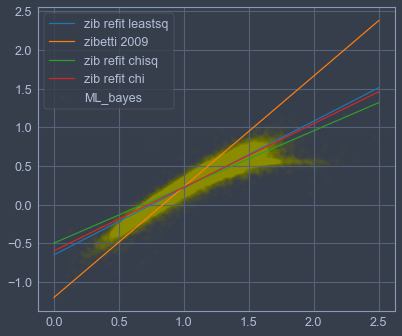

In [241]:
plt.style.use('onedork')
plt.scatter(col, logMLg, c='y', alpha=0.02)
#plt.xlim([0, 2.5])
colrange = np.array([0, 2.5])
plt.plot(colrange, zib_modelmag(colrange), label='zib refit leastsq')
plt.plot(colrange, zib_orig(colrange), label='zibetti 2009')
plt.plot(colrange, zib_modelmag_chisq(colrange), label='zib refit chisq')
plt.plot(colrange, zib_modelmag_chi(colrange), label='zib refit chi')
plt.legend()

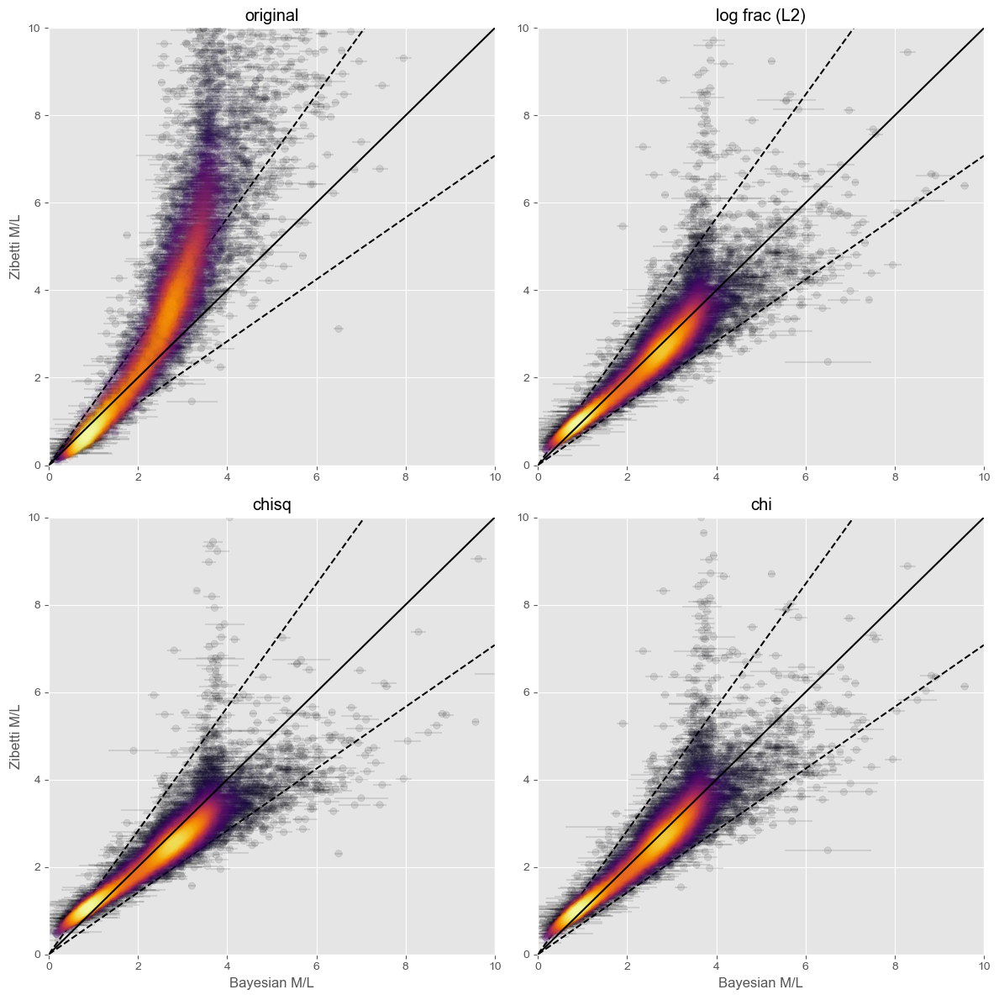

In [267]:
d_map = {'original': zib_orig, 'log frac (L2)': zib_modelmag,
         'chisq': zib_modelmag_chisq, 'chi': zib_modelmag_chi}
dexlines = 0.15
linex = np.linspace(0.001, 10, 10)
with plt.style.context(['default', 'ggplot']):
    f, axarr = plt.subplots(2, 2, figsize=(12, 12))
    for (i, ax, name, f) in zip(range(4), axarr.flatten(), d_map.keys(), d_map.values()):
        x = df_metamorph.loc[idx_test, 'ML_bayes']
        xerr = np.maximum(df_metamorph.loc[idx_test, 'ML_bayes_err'], 0.05*x)
        y = np.power(10, f(col.loc[idx_test]))
        ymin, ymax = 0, 10
        b_sel = (y < ymax) & (y > ymin)
        x, y, xerr = x[b_sel], y[b_sel], xerr[b_sel]
        x, y, c = estimate_density(x, y)
        ax.errorbar(x, y, xerr=xerr, alpha=0.1, color='k', linestyle='None', marker='None',
                    zorder=1)
        ax.scatter(x, y, c=c, alpha=0.1, cmap='inferno', zorder=10)
        ax.set_xlim([0, 10])
        ax.set_ylim([0, 10])
        ax.plot(linex, linex, 'k', zorder=50, alpha=0.7)
        ax.plot(linex, np.power(10, dexlines)*linex, 'k--')
        ax.plot(linex, np.power(10, -dexlines)*linex, 'k--')
        ax.set_title(name)
        if i > 1:
            ax.set_xlabel('Bayesian M/L')
        if (i%2) == 0:
            ax.set_ylabel('Zibetti M/L')
    plt.tight_layout()
    plt.savefig('plots/zibetti/truevspred_zibrefits.pdf')

### Performance on range of metrics

In [219]:
zib_method = zib_modelmag_rmsle
col = (df_metamorph['modelMag_g'] - df_metamorph['modelMag_i']).loc[idx_test]
y_test = df_metamorph.loc[idx_test, 'ML_bayes']
y_test_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
y_zib = zib_method(col)
dexerr = np.log10(y_zib / y_test).sort_values(ascending=False)[2:]
idx = dexerr.index
chi_test = lambda y: ((y - y_test) / y_test_err).loc[idx]
rms = lambda x: np.sqrt(np.mean(np.square(x)))
mae = lambda x: np.mean(np.abs(x))

print('metric L1', mae(chi_test(y_zib)))
print('metric L2', rms(chi_test(y_zib)))
print('RMSLE', rms(dexerr))
print('median L1', np.median(np.abs(chi_test(y_zib))))

metric L1 1.9140805853251803
metric L2 3.203365211392236
RMSLE 0.08238057457193017
median L1 1.3607951335136725


In [199]:
idx_test

array([1237661360762257515, 1237659327092818026, 1237667430096765097, ...,
       1237658203970601069, 1237661386533896356, 1237655499203936406])

In [200]:
y_test.head()

SDSS_ID
1237661360762257515    0.930582
1237659327092818026    3.590328
1237667430096765097    0.972972
1237657769627877412    6.351525
1237661358078886007    0.999493
Name: ML_bayes, dtype: float64

In [206]:
y_zib.head()

SDSS_ID
1237661360762257515    1.106756
1237659327092818026    3.709680
1237667430096765097    1.094071
1237657769627877412    6.420255
1237661358078886007    1.002064
dtype: float64

In [207]:
dexerr.head()

SDSS_ID
1237652943694463423    0.603413
1237660558670299363    0.523440
1237658607685664807    0.505918
1237657774467776730    0.503469
1237658203975319678    0.489965
dtype: float64

In [208]:
dexerr.describe()

count    7361.000000
mean        0.004436
std         0.083612
min        -0.436194
25%        -0.047967
50%        -0.005156
75%         0.047165
max         0.603413
dtype: float64

### Error distribution (min chi)

In [428]:
dexerr.sort_values(ascending=False).head()

SDSS_ID
1237665429185298588    6.641923
1237656567575478581    5.579165
1237652943694463423    0.603413
1237660558670299363    0.523440
1237658607685664807    0.505918
dtype: float64

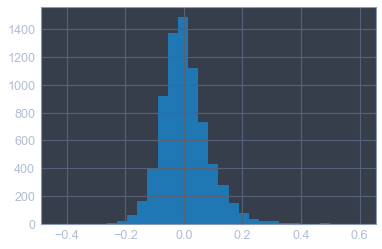

In [430]:
y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_minchi']
dexerr = np.log10(y_zib / y_test).sort_values(ascending=False)[2:]
dexerr.hist(bins=30)

In [433]:
dexerr.mean(), dexerr.std(), rms(dexerr)

(0.004435633869950504, 0.08361176244720274, 0.0837236641709321)

### Error distribution (original 2009)

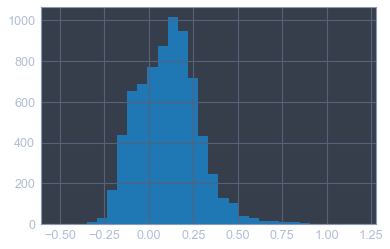

In [442]:
y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_2009']
dexerr = np.log10(y_zib / y_test).sort_values(ascending=False)[2:]
dexerr.hist(bins=30)

In [443]:
dexerr.mean(), dexerr.std()

(0.10903026454941914, 0.1762276437438011)

In [445]:
l1err = np.abs(y_zib - y_test) / y_err
l1err = l1err.sort_values(ascending=False)[2:]
l1err.mean()

7.4658574218140386

### Chi-squared

In [331]:
def chisq(true, pred, true_err):
    return np.mean(np.square((true - pred) / true_err))

In [345]:
col = df_metamorph['modelMag_g'] - df_metamorph['modelMag_i']
validmask = (df_metamorph['modelMag_g'] < 90) & (df_metamorph['modelMag_i'] < 90)
validmask = (validmask & (col > 0) & (col < 2.5))
validmask = (validmask & (col.index.isin(X_test.index)))
col_test = col[validmask]
MLgerr_test = np.maximum(df_metamorph['ML_bayes_err'], 0.05 * df_metamorph['ML_bayes'])
zibpred_test = np.power(10, zib_modelmag_chisq(col_test))
zibo_test = np.power(10, zib_orig(col_test))
ziblq_test = np.power(10, zib_modelmag(col_test))
cidx = zibpred_test.index
zib_chisq = chisq(y_test.loc[cidx], zibpred_test, MLgerr_test.loc[cidx])
zibo_chisq = chisq(y_test.loc[cidx], zibo_test, MLgerr_test.loc[cidx])
print('refit chisq', zib_chisq)
print('original chisq', zibo_chisq)

refit chisq 0.16593049951940353
original chisq 3.4872641575441774


In [216]:
zibo_chisqdist = np.square((y_test.loc[cidx] - zibo_test) / MLgerr_test.loc[cidx])
zibo_chisqdist.sort_values(ascending=False).head()

SDSS_ID
1237660558670299363    83918.625720
1237658203975319678    65973.214724
1237658607685664807    63179.511280
1237661464375328956    54234.643037
1237663529187213557    46456.374757
dtype: float64

In [221]:
rms = lambda x: np.sqrt(np.mean(np.square(x)))

In [313]:
# original zib
x = list(range(500))
chisq_cut = list(map(lambda x: zibo_chisqdist.sort_values(ascending=False)[x:].mean(),
                     x))
print('median chisq zibo', zibo_chisqdist.median())
print('mean chisq zibo', zibo_chisqdist.mean())
print('mean cut 100 chisq zibo', zibo_chisqdist.sort_values(ascending=False)[100:].mean())
print('mean chi zibo', np.sqrt(zibo_chisqdist).mean())
print('rms log frac zibo', rms(np.log10(zibo_test / y_test.loc[cidx])))
# plt.plot(x, chisq_cut)

median chisq zibo 17.064473368813427
mean chisq zibo 209.66496101166805
mean cut 100 chisq zibo 86.65184863599482
mean chi zibo 7.465857421814039
rms log frac zibo 0.20721863330898052


In [314]:
# refit zib (min chisq)
zib_chisqdist = np.square((y_test.loc[cidx] - zibpred_test) / MLgerr_test.loc[cidx])
print('median chisq zibo', zib_chisqdist.median())
print('mean chisq zibo', zib_chisqdist.mean())
print('mean cut 100 chisq zibo', zib_chisqdist.sort_values(ascending=False)[100:].mean())
print('mean chi zibo', np.sqrt(zib_chisqdist).mean())
print('rms log frac zibo', rms(np.log10(zibpred_test / y_test.loc[cidx])))

median chisq zibo 2.691571537121461
mean chisq zibo 8.067088018923164
mean cut 100 chisq zibo 5.662201242952696
mean chi zibo 2.0503569247610622
rms log frac zibo 0.09246012784604495


In [315]:
# refit zib (min logfrac)
ziblq_chisqdist = np.square((y_test.loc[cidx] - ziblq_test) / MLgerr_test.loc[cidx])
print('median chisq zibo', ziblq_chisqdist.median())
print('mean chisq zibo', ziblq_chisqdist.mean())
print('mean cut 100 chisq zibo', ziblq_chisqdist.sort_values(ascending=False)[100:].mean())
print('mean chi zibo', np.sqrt(ziblq_chisqdist).mean())
print('rms log frac zibo', rms(np.log10(ziblq_test / y_test.loc[cidx])))

median chisq zibo 1.8517633953944939
mean chisq zibo 10.261548677558022
mean cut 100 chisq zibo 4.982730686879159
mean chi zibo 1.9140805853251803
rms log frac zibo 0.08238057457193017


In [347]:
# refit zib (min chi)
zibchi_test = np.power(10, zib_modelmag_chi(col_test))
zib_chi = chisq(y_test.loc[cidx], zibchi_test, MLgerr_test.loc[cidx])
zibchi_chisqdist = np.square((y_test.loc[cidx] - zibchi_test) / MLgerr_test.loc[cidx])
print('median chisq zibchi', zibchi_chisqdist.median())
print('mean chisq zibchi', zibchi_chisqdist.mean())
print('mean cut 100 chisq zibchi', zibchi_chisqdist.sort_values(ascending=False)[100:].mean())
print('mean chi zibo', np.sqrt(zibchi_chisqdist).mean())
print('rms log frac zibo', rms(np.log10(zibchi_test / y_test.loc[cidx])))

median chisq zibchi 1.933158363220468
mean chisq zibchi 9.258982161367225
mean cut 100 chisq zibchi 4.923892251037441
mean chi zibo 1.9025660153016233
rms log frac zibo 0.0837236641709321


In [148]:
list(filter(lambda x: 'zib' in x, df_metamorph.columns))

['ML_zibetti']

In [235]:
df_metamorph['ML_zibetti_modelmaglogprev'] = df_metamorph['ML_zibetti_modelmag'].copy()

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [440]:
col = (df_metamorph['modelMag_g'] - df_metamorph['modelMag_i']).copy()
df_metamorph['ML_zibetti_modelmag'] = np.power(10, zib_modelmag_chisq(col)).copy()
df_metamorph['ML_zibetti_minlfsq'] = np.power(10, zib_modelmag(col)).copy()
df_metamorph['ML_zibetti_minchi'] = np.power(10, zib_modelmag_chi(col)).copy()

In [441]:
zib_orig = lambda x: -1.197 + (1.431*x)
df_metamorph['ML_zibetti_2009'] = np.power(10, zib_orig(col)).copy()

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [248]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704
123766250

In [249]:
df_metamorph.to_csv('data/metadata/metadata_morph_cumprobs.tsv', sep='\t')

### True vs pred

In [171]:
np.sort(pred)[::-1]

array([11.74886819, 11.24756196, 10.59504005, ...,  0.45110609,
        0.42555943,  0.3101334 ])

In [ ]:
df_metamorph['modelMag_g', 'modelMag_i', 'ML_zibetti_modelmag'].iloc[5079]

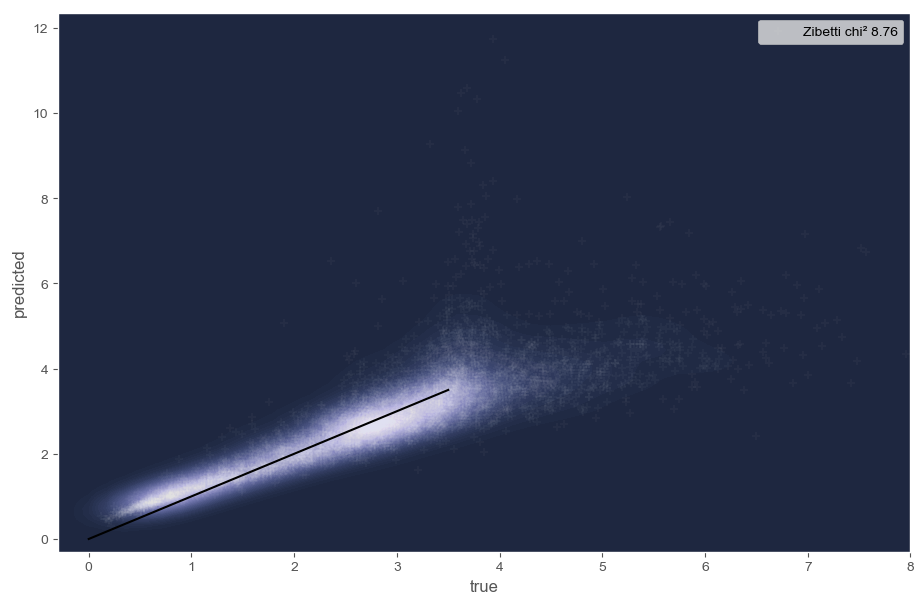

In [173]:
true = df_metamorph.loc[validmask, 'ML_bayes'].values
pred = df_metamorph.loc[validmask, 'ML_zibetti_modelmag'].values
with plt.style.context(['default', 'ggplot']):
    plt.figure(figsize=(11, 7))
    sns.kdeplot(true, pred, alpha=1, cmap=cmap, shade=True, #bw=0.2, cut=0, n_levels=60, 
                n_levels=60)
    plt.scatter(true, pred, marker='+', c='w', alpha=0.03, label=f'Zibetti chi² {zib_chisq:.2f}')
    plt.plot([0, 3.5], [0, 3.5], 'k')
    plt.xlim([-0.3, 8])
    plt.legend()
    plt.xlabel('true')
    plt.ylabel('predicted')
    plt.savefig('plots/zibetti/truevspred_zibetti_modelmag.png')

In [178]:
from sklearn.metrics import r2_score
zib_r2 = r2_score(true, pred)
gbm_r2 = r2_score(y_test, y_pred)
print(zib_r2, gbm_r2)

0.7445399563061031 0.6108613116113133


## Result exploration

In [21]:
df_axisratios = pd.read_csv('data/metadata/axisratios_sdss.csv', index_col=0)
df_axisratios['avg_AB'] = (df_axisratios['deVAB_g'] * df_axisratios['fracDeV_g'] + 
                           df_axisratios['expAB_g'] * (1 - df_axisratios['fracDeV_g']))
df_axisratios.iloc[127, 1:] = 1  # fix -9999
print(df_axisratios.shape)
df_axisratios.head()

(73627, 4)


,deVAB_g,expAB_g,fracDeV_g,avg_AB
objID,,,,
1237645879578460255,0.246842,0.285504,0.782729,0.255242
1237645941824356443,0.339572,0.335529,0.822057,0.338853
1237645943974396134,0.758263,0.658212,1.000000,0.758263
1237645943975837722,0.464938,0.503385,0.000000,0.503385
1237645943978328289,0.327550,0.358346,0.098875,0.355301


In [22]:
import altair as alt
alt.renderers.enable('notebook')
plt.style.use(['default', 'ggplot'])
# For test indices
ntest = y_test.shape[0]  # subset
df_results = df_meta.loc[y_test.index].copy()
df_results['ML_pred'] = y_pred
df_results = df_results.iloc[:ntest]
df_results['SDSS_ID'] = df_results.index.astype(str)
df_results['ML_zibetti'] = df_metamorph.loc[y_test.index, 'ML_zibetti_modelmag']
df_results['logL'] = np.log10(df_results['L_g_bayes'])
df_results['log_frac'] = np.log10(y_pred / y_test)
df_results['abs_log_frac'] = np.abs(df_results['log_frac'])
df_results['ml_err'] = ml_err.loc[y_test.index]
df_results['chisq'] = (df_results['ML_pred'] - df_results['ML_bayes']) / df_results['ml_err']
df_results['avg_AB'] = df_axisratios['avg_AB'].loc[y_test.index]
df_results = pd.concat([df_results, df_features.loc[df_results.index]], axis=1)

In [23]:
df_results.to_csv('data/results/df_lgbm_predictions.tsv', sep='\t')

In [40]:
df_features.head()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,pre.sum.lum.log,pre.mean.lum.log,pre.max.lum.log,pre.min.lum.log,pre.std.lum.log,pre.center.lum.log,pre.mean.center.lum.log,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,...,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,dist_sq,inv_dist_sq,redshift,inv_redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,7.224680,3.044870,5.079478,4.048952,3.772244,5.072669,4.919357,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,...,0.419165,0.0,0.043426,0.000000,0.000000,0.0,0.026036,0.085248,0.017091,0.0,0.001851,0.000000,0.373822,0.040094,0.000000,0.434619,0.000000,0.0,0.127402,0.000000,0.000000,0.000000,0.0,0.000000,0.043323,0.036078,0.285451,0.0,0.054541,0.000000,0.0,0.305673,0.0,0.000000,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,270251.435487,0.000004,0.1213,8.244023,1.008135
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,8.119182,2.978097,4.911692,3.339470,3.282417,4.864386,4.780726,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,...,0.102425,0.0,0.270107,0.000000,0.040571,0.0,0.000000,0.011425,0.037226,0.0,0.116023,0.053348,0.250478,0.242314,0.024494,0.104177,0.000000,0.0,0.198361,0.000000,0.000000,0.000519,0.0,0.000000,0.000000,0.000288,0.212493,0.0,0.464362,0.000000,0.0

In [24]:
df_results.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,ML_pred,SDSS_ID,logL,log_frac,abs_log_frac,ml_err,chisq,avg_AB,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,...,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237661360762257515,205.72260,44.81848,0.416869,0.0603,31.337666,258.428571,0.501159,2.182980,9.725140,0.055806,5.706700e+09,3.895303e+07,True,True,5.310552e+09,6.824009e+08,0.930582,0.119579,17.937,17.185,1.197433,205.722580,44.818477,0.414954,1.945360,97.65,0.845897,1237661360762257515,9.756385,-0.041437,0.041437,0.119579,-0.708192,0.635745,5.134887e+06,323.437066,20892.670730,-3540.231066,1447.500049,19150.946408,16578.781106,126,7.648774,4694.68,0.093564,0.126423,0.987221,0.981800,0.180225,...,0.0,0.0,0.147137,0.000000,0.000000,0.007828,0.0,0.000000,0.0,0.321521,0.000791,0.069742,0.0,0.045841,0.003611,0.037015,0.0,0.0,0.028870,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.061784,0.017801,0.000000,0.000000,0.048716,0.0,0.039801,0.000000,0.000503,0.0,0.076614,0.009349,0.051059,0.000000,0.043911,0.110129,0.0,0.152493,0.015282,0.0603,0.501159
1237659327092818026,221.42745,55.74718,0.489779,0.0910,55.563643,389.999992,0.756309,0.408195,11.267634,0.019001,5.158217e+10,2.305652e+08,True,True,1.851969e+11,8.102779e+09,3.590328,0.179516,16.736,15.346,3.656625,221.427453,55.747180,0.487528,1.218990,146.28,3.321306,1237659327092818026,10.712500,-0.033825,0.033825,0.179516,-1.498591,0.620420,3.478213e+07,1587.935035,404983.480458,-8031.324424,11149.760816,386482.658713,291066.466873,148,187.540200,5058.59,0.100817,0.111112,0.993986,0.979221,0.884025,...,0.0,0.0,0.000000,0.072553,0.000000,0.000000,0.0,0.113164,0.0,0.000000,0.000000,0.044421,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.057763,0.117153,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.244998,0.040148,0.0,0.000000,0.045986,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.484817,0.000000,0.0,0.000000,0.223840,0.0910,0.756309
1237667430096765097,147.59925,22.33972,0.512861,0.0285,18.221921,122.142857,0.236866,0.243269,9.318114,0.041149,2.138028e+09,1.164553e+07,True,True,2.080241e+09,1.970989e+08,0.972972,0.092187,17.317,16.590,1.184760

In [186]:
x = pd.read_csv('data/results/df_lgbm_predictions.tsv', sep='\t', index_col=0).head()

In [129]:
df_results.describe()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,ML_pred,logL,log_frac,abs_log_frac
count,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3.000000e+03,3.000000e+03,3.000000e+03,3.000000e+03,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,2836.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000
mean,185.822471,25.742427,0.551512,0.059374,38.199149,254.461572,0.493466,1.080123,10.589079,0.035105,2.819127e+10,1.599822e+08,8.551156e+10,5.668865e+09,2.619225,0.210106,16.499590,15.387914,2.596738,185.822471,25.742428,0.551464,2.163500,84.642070,2.344323,10.233667,-0.035497,0.099689
std,57.450361,19.172518,0.180458,0.032378,18.717988,138.762674,0.269096,1.025742,0.662939,0.017688,2.862537e+10,1.497487e+08,1.016269e+11,7.572263e+09,1.238427,0.147557,0.950666,0.984959,1.325016,57.450363,19.172518,0.180528,1.020882,54.187554,0.972234,0.479098,0.141450,0.106430
min,0.018600,-11.103440,0.407380,0.010000,5.434169,42.857142,0.083111,0.004457,7.856383,0.001285,2.209021e+08,1.771744e+06,7.184278e+07,1.454535e+07,0.199020,0.018420,12.998000,11.617000,0.374270,0.018540,-11.103436,0.403645,1.106624,0.000000,0.401071,8.344200,-1.108481,0.000141
25%,153.804863,9.827012,0.436516,0.034575,24.729431,148.178573,0.287356,0.350168,10.225276,0.021199,8.761158e+09,5.523866e+07,1.679873e+10,1.208047e+09,1.703936,0.125940,15.899750,14.768000,1.600772,153.804854,9.827013,0.437522,1.421511,36.912500,1.515338,9.942562,-0.092205,0.029973
50%,187.766325,25.319795,0.489779,0.053000,35.347355,227.142854,0.440488,0.717563,10.732208,0.032770,1.956871e+10,1.216544e+08,5.397692e+10,3.424121e+09,2.717240,0.169576,16.530000,15.369000,2.589798,187.766368,25.319795,0.490908,1.819701,84.050000,2.579379,10.291562,-0.028303,0.067069
75%,223.351350,40.199978,0.588844,0.076600,47.486584,328.285715,0.636630,1.451497,11.064307,0.046087,3.785454e+10,2.167109e+08,1.159598e+11,7.355679e+09,3.398295,0.246051,17.143250,16.045250,3.330446,223.351374,40.199977,0.593267,2.595674,131.650000,3.041196,10.578118,0.032466,0.126082
max,359.311500,68.290530,2.187762,0.231800,185.653541,993.428592,1.926511,4.965020,11.978681,0.124114,2.500492e+11,2.110972e+09,9.520963e+11,1.181329e+11,9.632765,1.509665,19.057000,17.764000,13.046695,359.311575,68.290531,2.182730,9.862795,179.950000,5.302554,11.398025,0.673232,1.108481


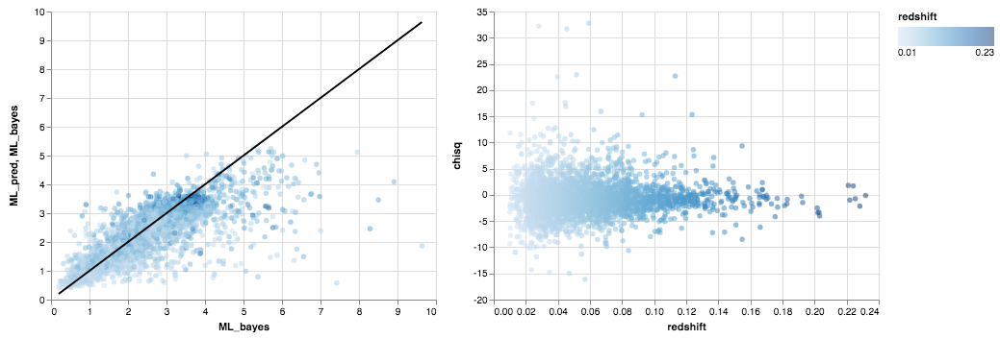

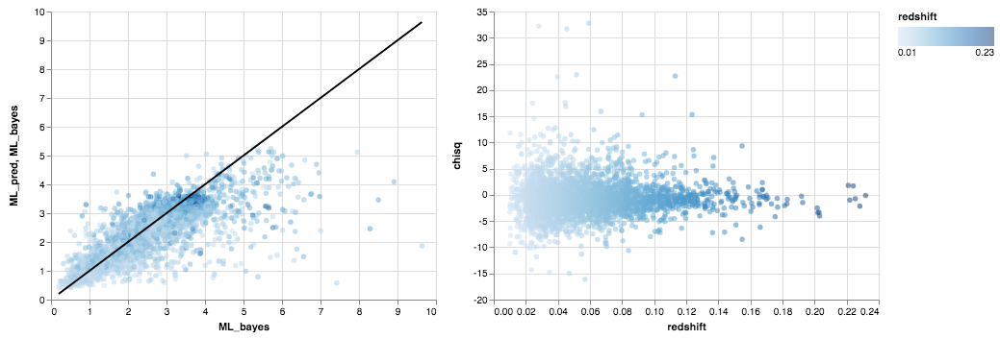

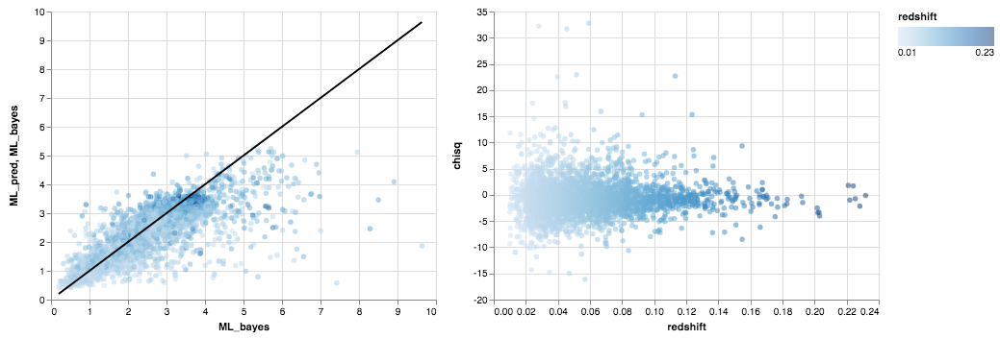

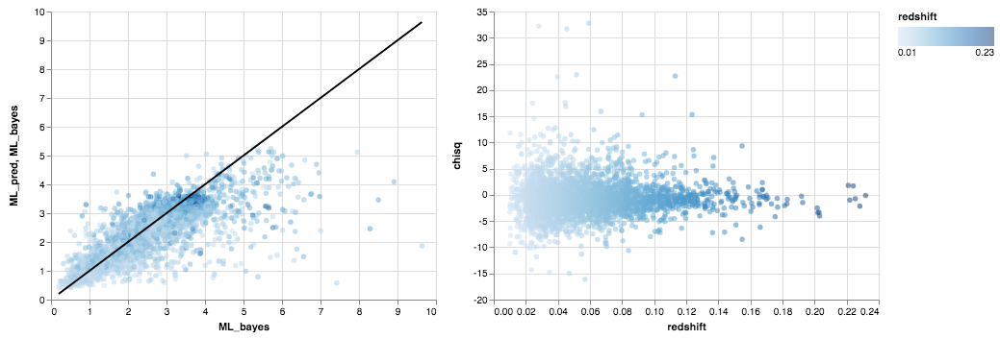

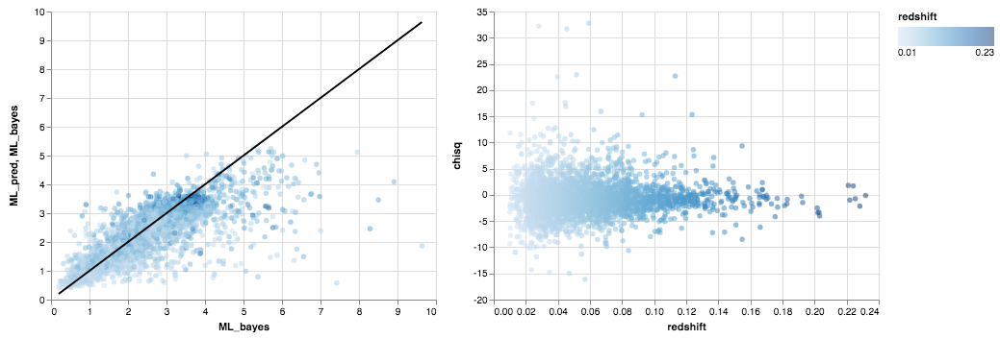

...

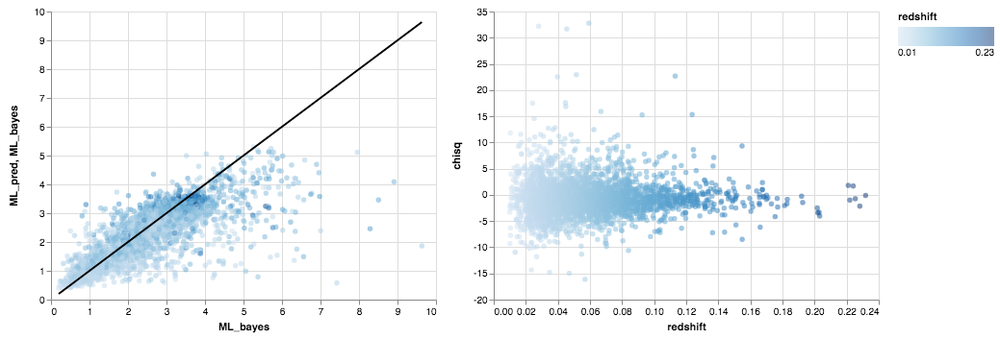

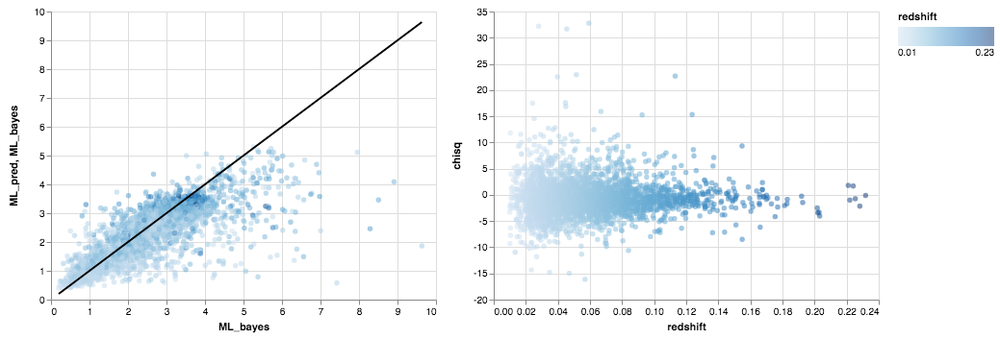

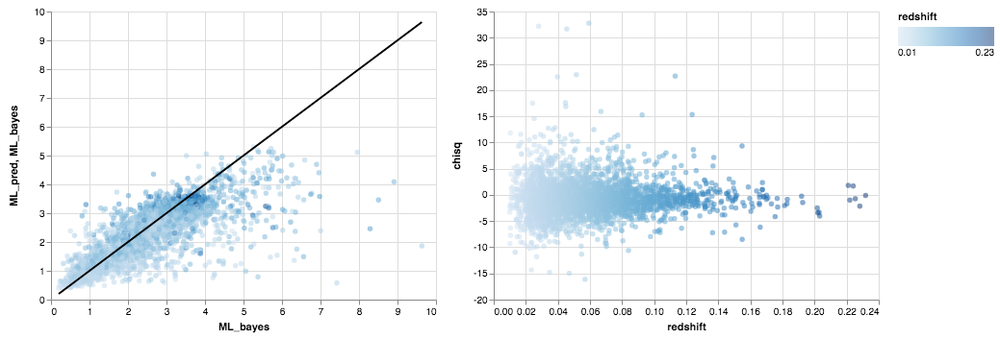

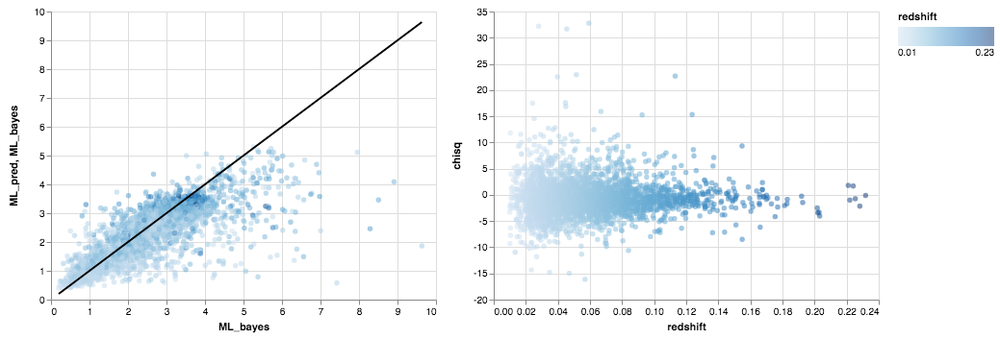

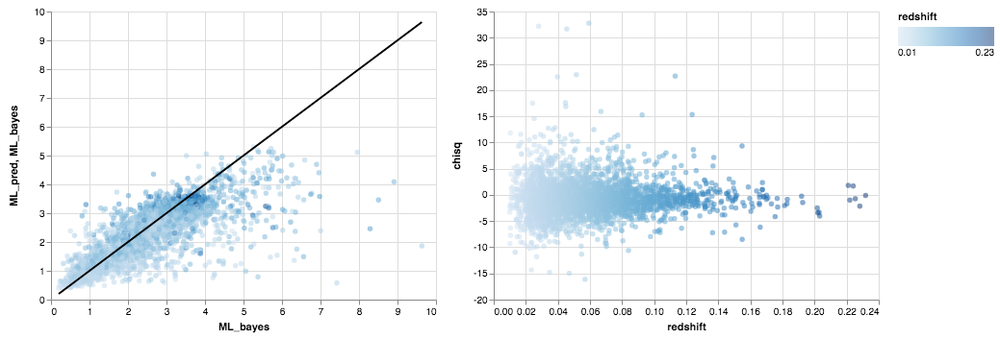

In [157]:
c_base = alt.Chart(df_results).properties(
    selection=brush
).encode(                      #.interactive()
    color=alt.condition(brush, 'redshift', alt.value('lightgray')),
    opacity=alt.condition(brush, alt.value(0.5), alt.value(0.2)),
    tooltip='SDSS_ID'
)    
brush = alt.selection_interval()
c_tvp = c_base.mark_circle().encode(
    x='ML_bayes',
    y='ML_pred'
)
mn, mx = df_results['ML_bayes'].min(), df_results['ML_bayes'].max()
c_1t1 = alt.Chart(df_results).mark_line().encode(
    x='ML_bayes',
    y='ML_bayes',
    color=alt.value('black')
).transform_filter(
    alt.FieldOneOfPredicate(field='ML_bayes', oneOf=[mn, mx])
)
c_z = c_base.mark_circle().encode(
    x='redshift',
    y='chisq'
)

((c_tvp + c_1t1) | c_z).configure(
    background='white'
)

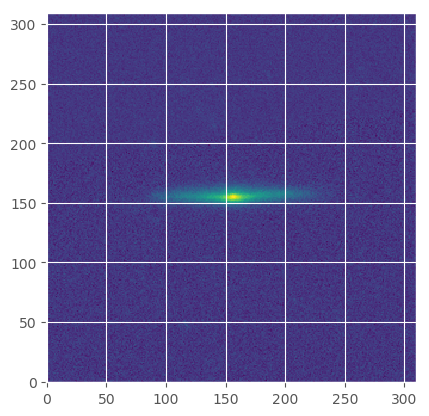

In [166]:
ht.plot_galaxy(1237661850399473746, ssubtype='ssub')

In [191]:
from bokeh.plotting import figure, show, output_file
from bokeh.models import HoverTool

N = 500
x = np.linspace(0, 10, N)
y = np.linspace(0, 10, N)
xx, yy = np.meshgrid(x, y)
d = np.sin(xx)*np.cos(yy)

p = figure(x_range=(0, 10), y_range=(0, 10),
           tools=[HoverTool(tooltips=[("x", "$x"), ("y", "$y"), ("value", "@image")])])

# must give a vector of image data for image parameter
p_img = p.image(image=[d], x=0, y=0, dw=10, dh=10, palette="Spectral11")

## Plotting bokeh stuff

In [7]:
df_metamorph = pd.read_csv('data/metadata/metadata_morph_cumprobs.tsv', sep='\t',
                           index_col=0)
print(df_metamorph.shape)
df_metamorph.head()

(73627, 386)


,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t09_a25_cum_weighted,t09_a26_cum_weighted,t09_a27_cum_weighted,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000000,0.024375,0.0,0.000000,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000000,0.000000,0.0,0.213653,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000

In [8]:
list(filter(lambda x: 'cum_weighted' in x, df_metamorph.columns))

['t01_a01_cum_weighted',
 't01_a02_cum_weighted',
 't01_a03_cum_weighted',
 't02_a04_cum_weighted',
 't02_a05_cum_weighted',
 't03_a06_cum_weighted',
 't03_a07_cum_weighted',
 't04_a08_cum_weighted',
 't04_a09_cum_weighted',
 't05_a10_cum_weighted',
 't05_a11_cum_weighted',
 't05_a12_cum_weighted',
 't05_a13_cum_weighted',
 't06_a14_cum_weighted',
 't06_a15_cum_weighted',
 't07_a16_cum_weighted',
 't07_a17_cum_weighted',
 't07_a18_cum_weighted',
 't08_a19_cum_weighted',
 't08_a20_cum_weighted',
 't08_a21_cum_weighted',
 't08_a22_cum_weighted',
 't08_a23_cum_weighted',
 't08_a24_cum_weighted',
 't08_a38_cum_weighted',
 't09_a25_cum_weighted',
 't09_a26_cum_weighted',
 't09_a27_cum_weighted',
 't10_a28_cum_weighted',
 't10_a29_cum_weighted',
 't10_a30_cum_weighted',
 't11_a31_cum_weighted',
 't11_a32_cum_weighted',
 't11_a33_cum_weighted',
 't11_a34_cum_weighted',
 't11_a36_cum_weighted',
 't11_a37_cum_weighted']

In [14]:
pfeat.describe()

count    73627.000000
mean         0.445557
std          0.321082
min          0.000000
25%          0.142000
50%          0.382000
75%          0.744745
max          1.000000
Name: t01_a02_cum_weighted, dtype: float64

In [18]:
pfeat = df_metamorph['t01_a02_cum_weighted']
pedge = df_metamorph['t02_a04_cum_weighted']
ml = df_metamorph['ML_bayes']
pfeat_t = pfeat.loc[idx_test]
pedge_t = pedge.loc[idx_test]
ml_t = ml.loc[idx_test]

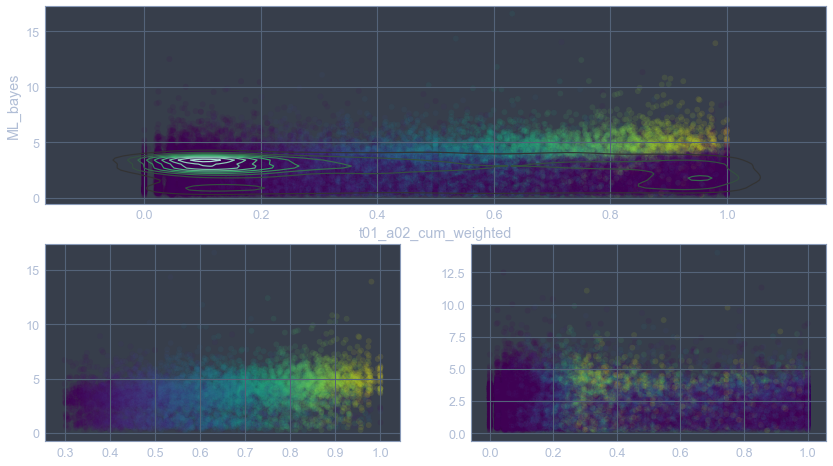

In [21]:
plt.figure(figsize=(14, 8))

ax1 = plt.subplot2grid((2, 2), (0, 0), colspan=2)
ax1.scatter(pfeat, ml, c=pedge, alpha=0.1)
sns.kdeplot(pfeat_t, ml_t, ax=ax1)
ax2 = plt.subplot2grid((2, 2), (1, 0))
ax2.scatter(pfeat[pedge > 0.3], ml[pedge > 0.3], c=pedge[pedge > 0.3], alpha=0.1)
ax3 = plt.subplot2grid((2, 2), (1, 1))
ax3.scatter(pfeat[pedge <= 0.3], ml[pedge <= 0.3], c=pedge[pedge <= 0.3], alpha=0.1)

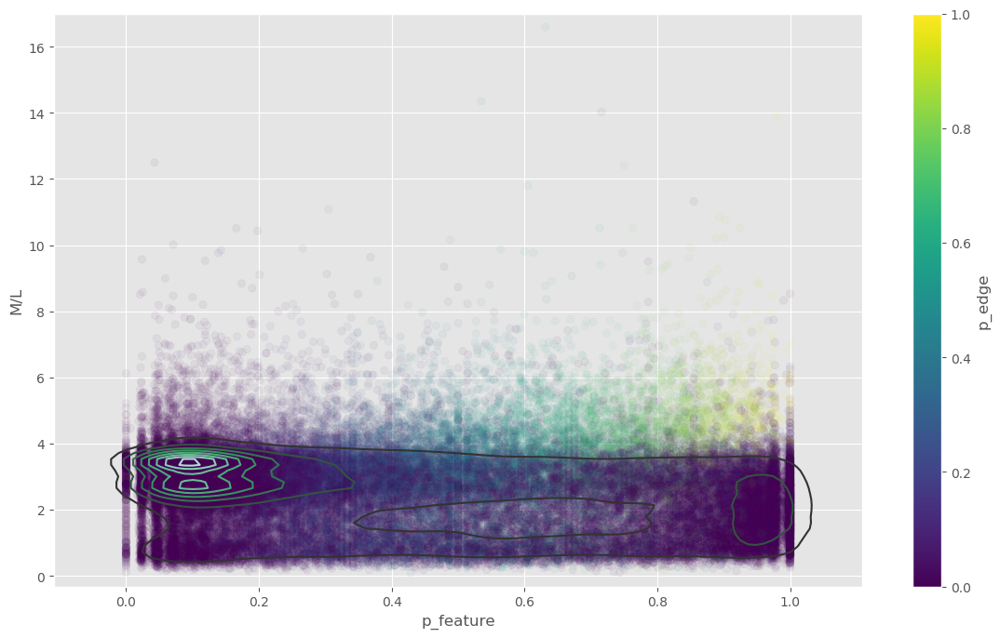

In [43]:
with plt.style.context(['default', 'ggplot']):
    f, ax = plt.subplots(figsize=(14, 8))
    plt.scatter(pfeat, ml, c=pedge, alpha=0.05)
    cbar = plt.colorbar()
    cbar.set_label('p_edge')
    cbar.solids.set(alpha=1)
    sns.kdeplot(pfeat, ml, ax=ax)
    ax.set_xlabel('p_feature')
    ax.set_ylabel('M/L')
    
    plt.savefig('plots/data/weird_edgeon.png')

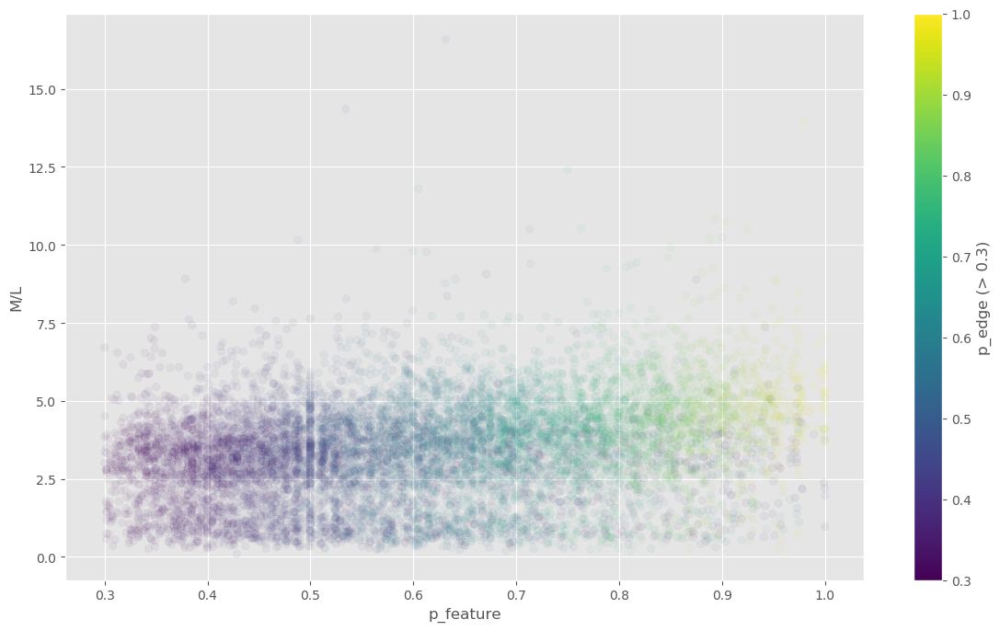

In [51]:
%matplotlib inline
with plt.style.context(['default', 'ggplot']):
    f, ax = plt.subplots(figsize=(14, 8))
    x, y, c = pfeat[pedge > 0.3], ml[pedge > 0.3], pedge[pedge > 0.3]
    plt.scatter(x, y, c=c, alpha=0.05)
    cbar = plt.colorbar()
    cbar.set_label('p_edge (> 0.3)')
    cbar.solids.set(alpha=1)
    #sns.kdeplot(x, y, ax=ax)
    ax.set_xlabel('p_feature')
    ax.set_ylabel('M/L')
    
    plt.savefig('plots/data/weird_edgeon_highpedge.png')

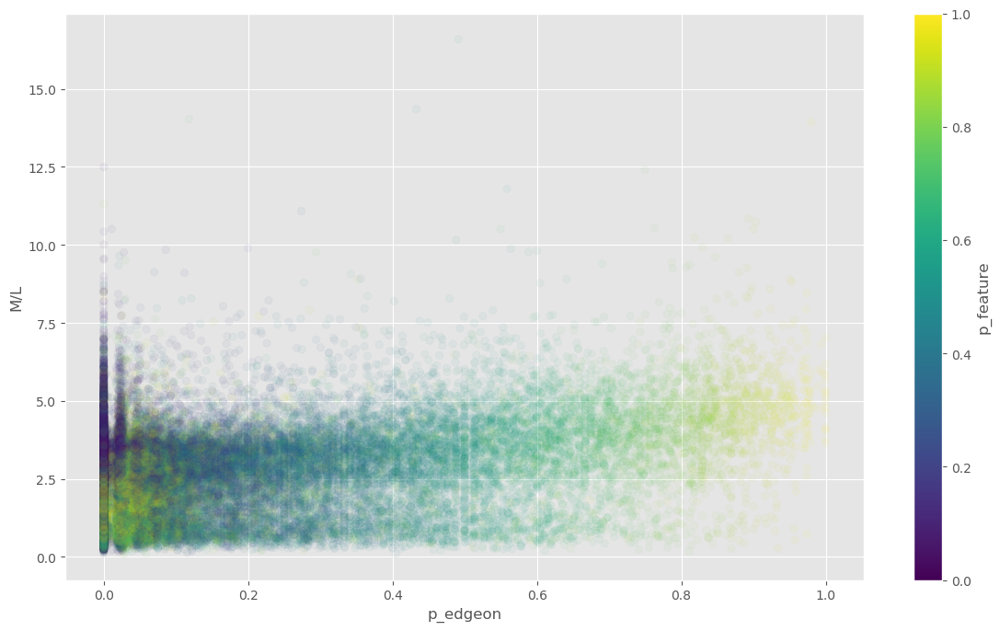

In [52]:
with plt.style.context(['default', 'ggplot']):
    f, ax = plt.subplots(figsize=(14, 8))
    plt.scatter(pedge, ml, c=pfeat, alpha=0.05)
    cbar = plt.colorbar()
    cbar.set_label('p_feature')
    cbar.solids.set(alpha=1)
    #sns.kdeplot(pfeat, ml, ax=ax)
    ax.set_xlabel('p_edgeon')
    ax.set_ylabel('M/L')
    
    plt.savefig('plots/data/weird_edgeon_pfeatx.png')

<IPython.core.display.Javascript object>


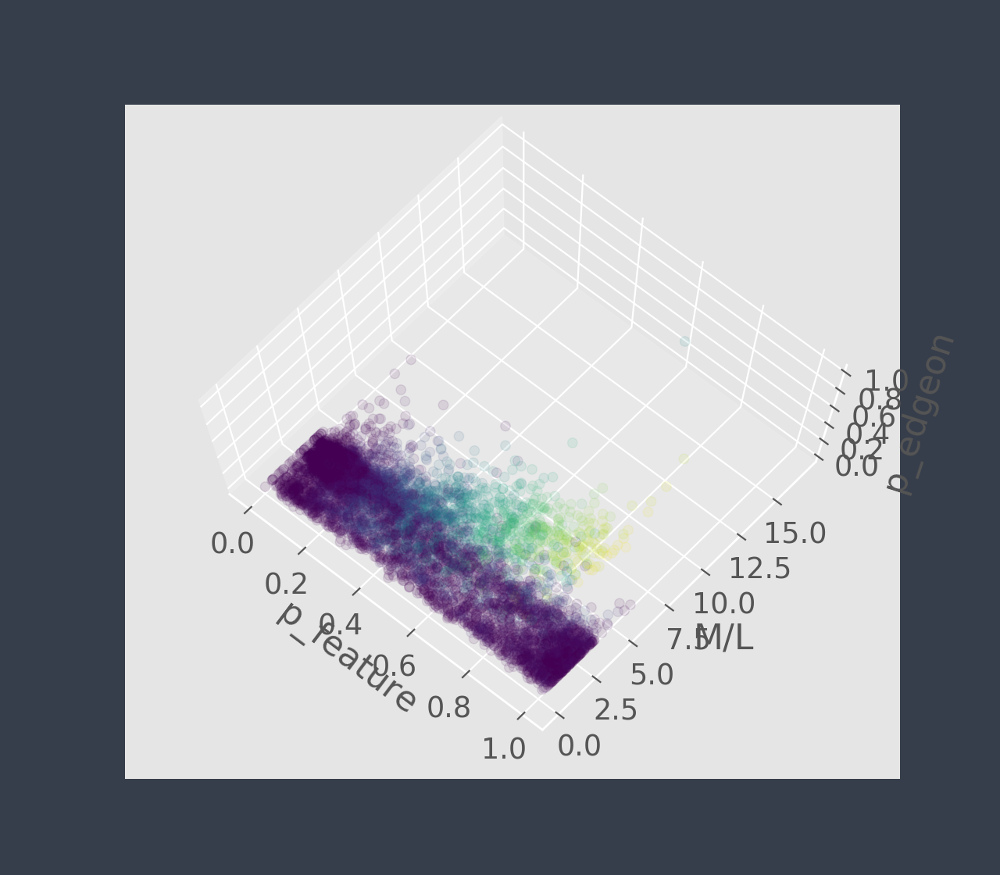

Text(0.5,0,'p_edgeon')

In [48]:
# 3D
%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(pfeat_t, ml_t, pedge_t, c=pedge_t, alpha=0.1)
ax.set_xlabel('p_feature')
ax.set_ylabel('M/L')
ax.set_zlabel('p_edgeon')

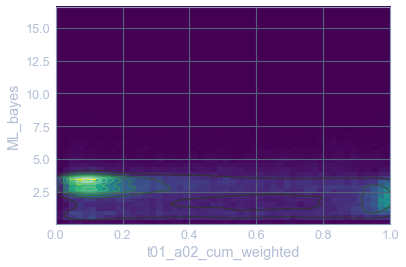

In [34]:
f, ax = plt.subplots()
ax.hist2d(pfeat, ml, bins=50)
sns.kdeplot(pfeat, ml, bw='scott', ax=ax)
plt.show()

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:52: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


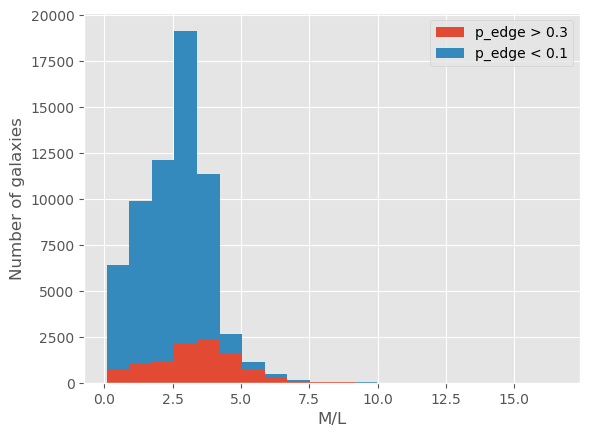

In [72]:
with plt.style.context(['default', 'ggplot']):
    ml_edge = ml[pedge > 0.3]
    ml_noedge = ml[pedge < 0.1]
    plt.hist([ml_edge, ml_noedge], bins=20, histtype='barstacked', 
             label=['p_edge > 0.3', 'p_edge < 0.1'])
    plt.legend()
    plt.xlabel('M/L')
    plt.ylabel('Number of galaxies')
    plt.savefig('plots/data/weird_edgeon_hist.pdf')

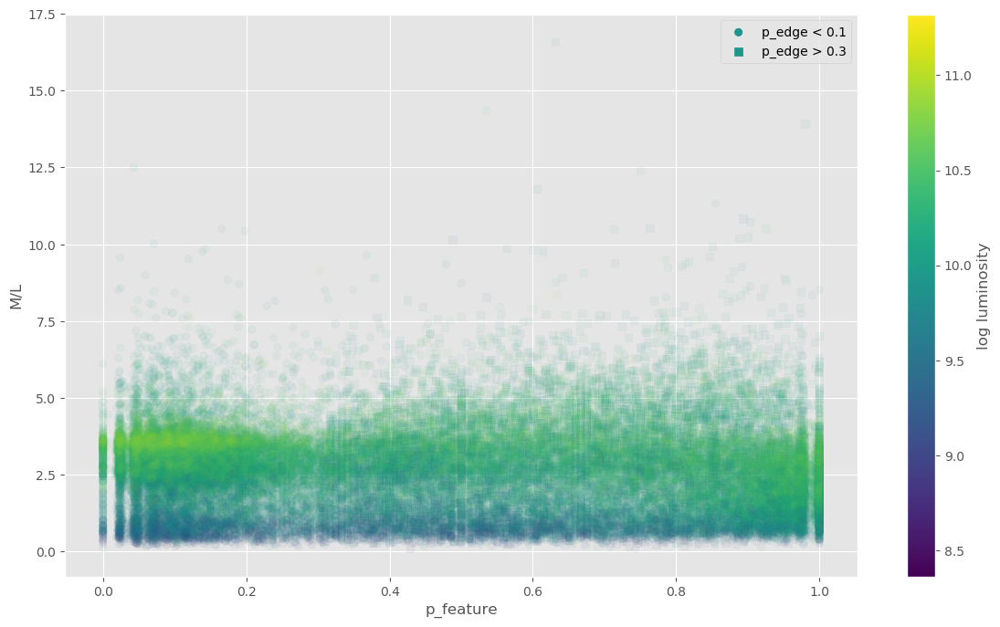

In [83]:
with plt.style.context(['default', 'ggplot']):
    f, ax = plt.subplots(figsize=(14, 8))
    logl = np.log10(df_metamorph.loc[ml.index, 'L_g_bayes'])
    pfeat_ne, pfeat_e = pfeat[pedge < 0.1], pfeat[pedge > 0.3]
    ml_ne, ml_e = ml[pedge < 0.1], ml[pedge > 0.3]
    logl_ne, logl_e = logl[pedge < 0.1], logl[pedge > 0.3]
    plt.scatter(pfeat_ne, ml_ne, c=logl_ne, alpha=0.05, label='p_edge < 0.1')
    plt.scatter(pfeat_e, ml_e, c=logl_e, alpha=0.05, marker='s', label='p_edge > 0.3')
    cbar = plt.colorbar()
    cbar.set_label('log luminosity')
    cbar.solids.set(alpha=1)
    ax.set_xlabel('p_feature')
    ax.set_ylabel('M/L')
    leg = plt.legend()
    for lh in leg.legendHandles: 
        lh.set_alpha(1)
    
    plt.savefig('plots/data/weird_edgeon_luminosity_dependence.png')

In [26]:
80000**(-1./(2+4))

0.15234153789450827

## Predicting uncertainty

In [23]:
y_pred_val = gbm.predict(X_val)
chisq_tr = np.square((y_tr - y_pred_tr) / df_metamorph.loc[idx_tr, 'ML_bayes_err'])
chisq_val = np.square((y_val - y_pred_val) / df_metamorph.loc[idx_val, 'ML_bayes_err'])
chisq_test = np.square((y_test - y_pred) / y_test_err)

In [24]:
%%time
lgb_tr_err = lgbm.Dataset(X_tr, y_tr)
lgb_val_err = lgbm.Dataset(X_val, y_val)

gbm_err = lgbm.train(lgbm_params, lgb_tr_err,
                 num_boost_round=max_boost_runs,
                 valid_sets=[lgb_tr_err,lgb_val_err],  # eval training data
                 valid_names=['train', 'eval'],
                 verbose_eval=100,
                 early_stopping_rounds=100,
                )

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.78096	eval's rmse: 0.823323
[200]	train's rmse: 0.668744	eval's rmse: 0.729163
[300]	train's rmse: 0.633509	eval's rmse: 0.705133
[400]	train's rmse: 0.615499	eval's rmse: 0.69565
[500]	train's rmse: 0.602851	eval's rmse: 0.690551
[600]	train's rmse: 0.592316	eval's rmse: 0.687159
[700]	train's rmse: 0.582502	eval's rmse: 0.684313
[800]	train's rmse: 0.573592	eval's rmse: 0.682491
[900]	train's rmse: 0.5652	eval's rmse: 0.681293
[1000]	train's rmse: 0.557199	eval's rmse: 0.679891
[1100]	train's rmse: 0.549712	eval's rmse: 0.678609
[1200]	train's rmse: 0.542518	eval's rmse: 0.677931
[1300]	train's rmse: 0.535706	eval's rmse: 0.676728
[1400]	train's rmse: 0.529184	eval's rmse: 0.67601
[1500]	train's rmse: 0.523017	eval's rmse: 0.675601
[1600]	train's rmse: 0.51691	eval's rmse: 0.674999
[1700]	train's rmse: 0.510996	eval's rmse: 0.674067
[1800]	train's rmse: 0.505171	eval's rmse: 0.6737
[1900]	train's rms

In [25]:
gbm_err = gbm

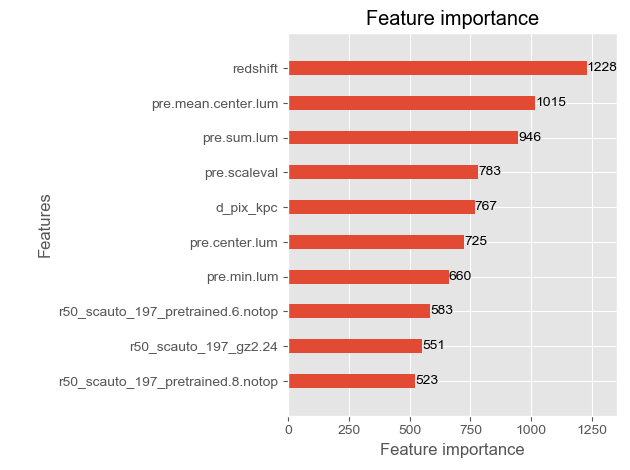

In [26]:
with plt.style.context(['default', 'ggplot']):
    ax = lgbm.plot_importance(gbm_err, max_num_features=10, height=0.4, 
                              importance_type='split')
    plt.sca(ax)
    plt.tight_layout()

## Some relations

In [869]:
def find_feature(feat_name, log=False, subset=None):
    if feat_name in df_features.columns:
        feat = df_features[feat_name]
    elif feat_name in df_metamorph.columns:
        feat = df_metamorph.loc[df_features.index, feat_name]
    else:
        raise ValueError(f'Could not find feature {feat_name}')
    if subset is not None:
        feat = feat.loc[subset]
    if log:
        return np.log10(feat)
    return feat

d_alias = {'pre.sum.lum': 'Total luminosity', 'ML_bayes': 'Bayesian M/L', 
           'r50_scauto_197_pretrainedchi.6.notop.layer2': 'CNN 4: feat. 7', 'redshift': 'Redshift',
           'r50_scauto_197_gz2.3': r'CNN 1: $P_{\rm{edge}}$',
           'r50_scauto_197_gz2.1': r'CNN 1: $P_{\rm{feature}}$',
           'r50_scauto_197_pretrainedchi.8.notop.layer2': 'CNN 4: feat. 9',
           'avg_AB': 'axis ratio', 'pre.scaleval': 'scaling value'}
    
def plot_relation(x_name, y_name, c_name, ax=None, logx=False, logy=False, logc=False,
                  alpha=0.3, subset=None, cax=None, sc_kwargs=None):
    x = find_feature(x_name, logx, subset)
    y = find_feature(y_name, logy, subset)
    if ax is None:
        f, ax = plt.subplots()
    else:
        f = ax.get_figure()
    if sc_kwargs is None:
        sc_kwargs = {}
    if subset is None:
            subset = df_features.index
    if (c_name != 'morpho') and (c_name != 'feat'):
        c = find_feature(c_name, logc, subset)
        s = ax.scatter(x, y, c=c, alpha=alpha, s=10, **sc_kwargs)
    elif c_name == 'feat':
        c_name = 'r50_scauto_197_gz2.1'
        c = find_feature(c_name, logc, subset)
        idx_edge = df_features.loc[subset, 'r50_scauto_197_gz2.3'] > 0.4
        s = ax.scatter(x.loc[~idx_edge], y.loc[~idx_edge], c=c.loc[~idx_edge], 
                       alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_edge], y.loc[idx_edge], label='edge-on', color='C1',
                       alpha=alpha, s=10, **sc_kwargs)
    else:
        idx_edge = df_features.loc[subset, 'r50_scauto_197_gz2.3'] > 0.4
        idx_feat = df_features.loc[subset, 'r50_scauto_197_gz2.1'] > 0.4
        idx_irr = df_features.loc[subset, 'r50_scauto_197_gz2.21'] > 0.2
        idx_ell = (~idx_edge) & (~idx_feat) & (~idx_irr)
        idx_feat = (~idx_edge) & (idx_feat) & (~idx_irr)
        idx_edge = (idx_edge) & (~idx_irr)
        idx_irr = idx_irr
        ax.scatter(x.loc[idx_feat], y.loc[idx_feat], label='feature or disk',
                   alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_edge], y.loc[idx_edge], label='edge-on disk',
                   alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_ell], y.loc[idx_ell], label='elliptical',
                   alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_irr], y.loc[idx_irr], label='irregular',
                   alpha=alpha, s=10, **sc_kwargs)
        leg = ax.legend()
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if cax:
        cbar = f.colorbar(s, cax=cax, orientation='horizontal')
        cbar.set_alpha(1)
        cbar.draw_all()
#         with plt.rc_context(rc={'xtick.labeltop':True, 'xtick.labelbottom': False}):
        clabel = d_alias[c_name] if c_name in d_alias else c_name
        if logc:
            clabel = clabel + ' (log)'
        cax.set_xlabel(clabel)
        cax.get_xaxis().set_label_position('top')
        cax.tick_params(which='both', labelsize=8)
    xlabel = d_alias[x_name] if x_name in d_alias else x_name
    ylabel = d_alias[y_name] if y_name in d_alias else y_name
    if logx:
        xlabel = xlabel + ' (log)'
    if logy:
        ylabel = ylabel + ' (log)'
    ax.set_xlabel(xlabel, fontsize=12)
    ax.set_ylabel(ylabel, fontsize=12)
    if y_name == 'ML_bayes':
        ax.set_ylim([-0.5, 10.5])

In [162]:
def create_subaxes(f, main_bounds, wfrac=0.8, dtop=0.025, height=0.02):
    x0, y0, w, h = main_bounds
    cx = x0 + (w / 2)
    nw = w * wfrac # n for new axes
    nx = cx - (nw/2)
    top0 = y0 + h
    ny = top0 - dtop - height  # dtop: distance from top
    return f.add_axes([nx, ny, nw, height])

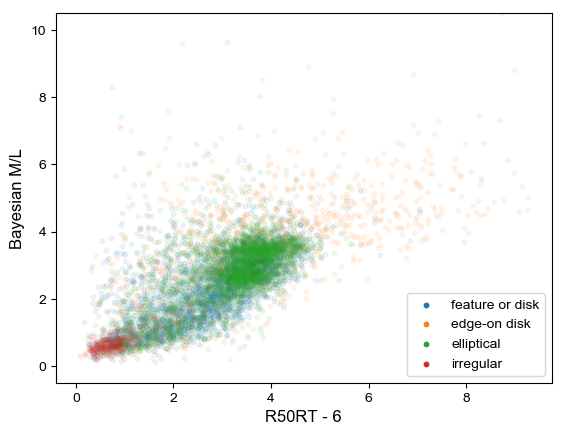

In [102]:
with plt.style.context(['ggplot', 'default']):
    plot_relation('r50_scauto_197_pretrained.6.notop', 'ML_bayes',
                  'morpho', subset=idx_test, alpha=0.07)

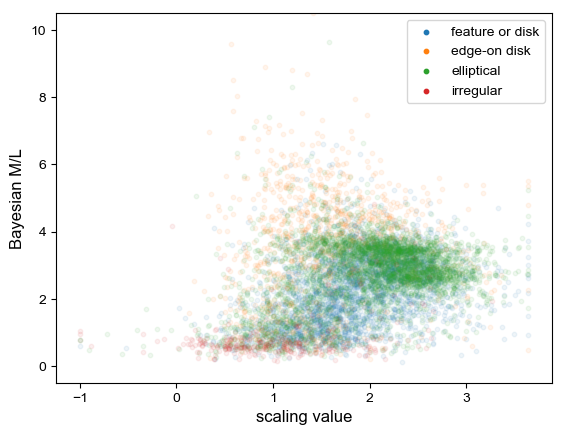

In [111]:
with plt.style.context(['ggplot', 'default']):
    plot_relation('pre.scaleval', 'ML_bayes',
                  'morpho', subset=idx_test, logx=True, alpha=0.07)

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in log10


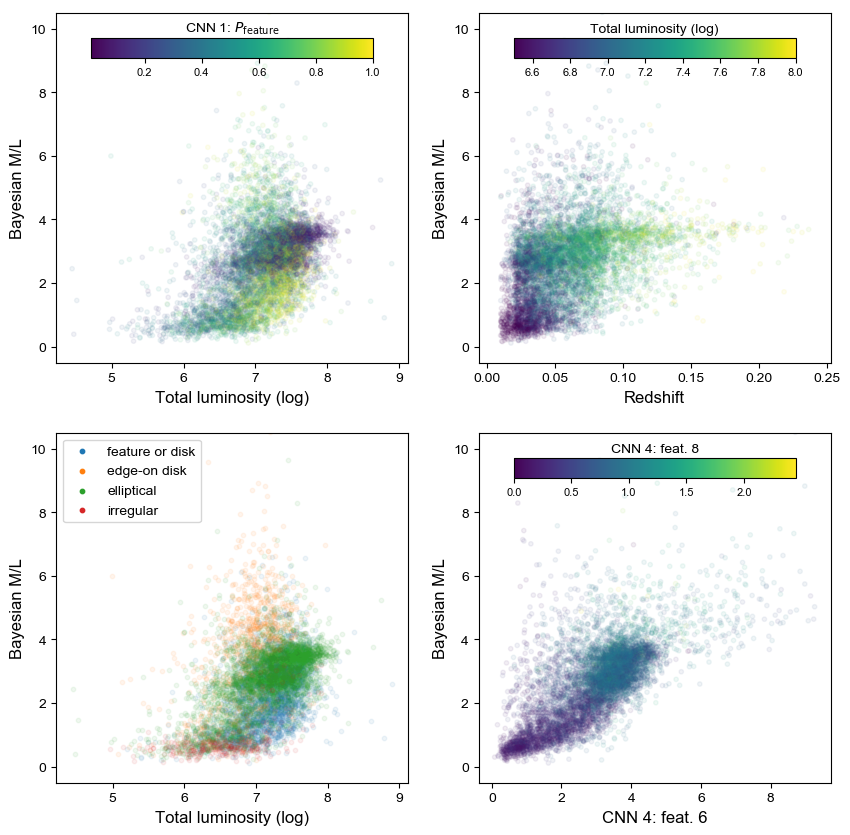

In [364]:
with plt.style.context(['ggplot', 'default']):
    # TODO: change subset to None (all points)
    subset = idx_test
    alpha = 0.07
    f, axarr = plt.subplots(2, 2, figsize=(10, 10))
    cax = create_subaxes(f, axarr[0, 0].get_position().bounds)
    plot_relation('pre.sum.lum', 'ML_bayes', 'r50_scauto_197_gz2.1', axarr[0, 0],
                  logx=True, alpha=alpha, subset=subset, cax=cax)
    cax = create_subaxes(f, axarr[0, 1].get_position().bounds)
    plot_relation('redshift', 'ML_bayes', 'pre.sum.lum', axarr[0, 1],
                  logc=True, alpha=alpha, subset=subset, cax=cax,
                  sc_kwargs={'vmin': 6.5, 'vmax': 8})
    plot_relation('pre.sum.lum', 'ML_bayes', 'morpho', axarr[1, 0],
                  logx=True, alpha=alpha, subset=subset)
    cax = create_subaxes(f, axarr[1, 1].get_position().bounds)
    plot_relation('r50_scauto_197_pretrained.6.notop', 'ML_bayes', 
                  'r50_scauto_197_pretrained.8.notop', axarr[1, 1],
                  alpha=alpha, subset=subset, cax=cax)
#     plot_relation('r50_scauto_197_pretrained.6.notop', 'ML_bayes',
#                   'morpho', axarr[0, 2], subset=idx_test, alpha=0.07)
#     plot_relation('pre.scaleval', 'ML_bayes',
#                   'morpho', axarr[1, 2], subset=idx_test, logx=True, alpha=0.07)
    plt.savefig('plots/paper/scaling_relations.pdf', dpi=300, bbox_inches='tight')
    ## TODO: verander treshold probabilities zodat er meer ellipticals zijn

## Some relations (binned)

In [46]:
%autoreload
from customplots import hist2d_color

def find_feature(feat_name, log=False, subset=None):
    if feat_name in df_features.columns:
        feat = df_features[feat_name]
    elif feat_name in df_metamorph.columns:
        feat = df_metamorph.loc[df_features.index, feat_name]
    else:
        raise ValueError(f'Could not find feature {feat_name}')
    if subset is not None:
        feat = feat.loc[subset]
    if log:
        return np.log10(feat)
    return feat

d_alias = {'pre.sum.lum': 'Total luminosity', 'ML_bayes': 'Bayesian M/L', 
           'r50_scauto_197_pretrained.6.notop': 'CNN 4: feat. 6', 'redshift': 'Redshift',
           'r50_scauto_197_gz2.3': r'CNN 1: $P_{\rm{edge}}$',
           'r50_scauto_197_gz2.1': r'CNN 1: $P_{\rm{feature}}$',
           'r50_scauto_197_pretrained.8.notop': 'CNN 4: feat. 8',
           'avg_AB': 'axis ratio', 'pre.scaleval': 'scaling value'}
    
def plot_relation_bin(x_name, y_name, c_name, ax=None, logx=False, logy=False, logc=False,
                  alpha=0.3, subset=None, cax=None, sc_kwargs=None):
    x = find_feature(x_name, logx, subset)
    y = find_feature(y_name, logy, subset)
    if ax is None:
        f, ax = plt.subplots()
    else:
        f = ax.get_figure()
    if sc_kwargs is None:
        sc_kwargs = {}
    if subset is None:
        subset = df_features.index
    if (c_name != 'morpho') and (c_name != 'feat'):
        c = find_feature(c_name, logc, subset)
#         s = ax.scatter(x, y, c=c, alpha=alpha, s=10, **sc_kwargs)
        hist2d_color(x, y, c=c, ax=ax, bins=50)
    elif c_name == 'feat':
        c_name = 'r50_scauto_197_gz2.1'
        c = find_feature(c_name, logc, subset)
        idx_edge = df_features.loc[subset, 'r50_scauto_197_gz2.3'] > 0.4
        s = ax.scatter(x.loc[~idx_edge], y.loc[~idx_edge], c=c.loc[~idx_edge], 
                       alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_edge], y.loc[idx_edge], label='edge-on', color='C1',
                       alpha=alpha, s=10, **sc_kwargs)
    else:
        idx_edge = df_features.loc[subset, 'r50_scauto_197_gz2.3'] > 0.4
        idx_feat = df_features.loc[subset, 'r50_scauto_197_gz2.1'] > 0.4
        idx_irr = df_features.loc[subset, 'r50_scauto_197_gz2.21'] > 0.2
        idx_ell = (~idx_edge) & (~idx_feat) & (~idx_irr)
        idx_feat = (~idx_edge) & (idx_feat) & (~idx_irr)
        idx_edge = (idx_edge) & (~idx_irr)
        idx_irr = idx_irr
        ax.scatter(x.loc[idx_feat], y.loc[idx_feat], label='feature or disk',
                   alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_edge], y.loc[idx_edge], label='edge-on disk',
                   alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_ell], y.loc[idx_ell], label='elliptical',
                   alpha=alpha, s=10, **sc_kwargs)
        ax.scatter(x.loc[idx_irr], y.loc[idx_irr], label='irregular',
                   alpha=alpha, s=10, **sc_kwargs)
        leg = ax.legend()
        for lh in leg.legendHandles: 
            lh.set_alpha(1)
    if cax:
        cbar = f.colorbar(s, cax=cax, orientation='horizontal')
        cbar.set_alpha(1)
        cbar.draw_all()
#         with plt.rc_context(rc={'xtick.labeltop':True, 'xtick.labelbottom': False}):
        clabel = d_alias[c_name] if c_name in d_alias else c_name
        if logc:
            clabel = clabel + ' (log)'
        cax.set_xlabel(clabel)
        cax.get_xaxis().set_label_position('top')
        cax.tick_params(which='both', labelsize=8)
    xlabel = d_alias[x_name] if x_name in d_alias else x_name
    ylabel = d_alias[y_name] if y_name in d_alias else y_name
    if logx:
        xlabel = xlabel + ' (log)'
    if logy:
        ylabel = ylabel + ' (log)'
    ax.set_xlabel(xlabel, fontsize=12)
    ax.set_ylabel(ylabel, fontsize=12)
    if y_name == 'ML_bayes':
        ax.set_ylim([-0.5, 10.5])

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:14: RuntimeWarning: invalid value encountered in log10


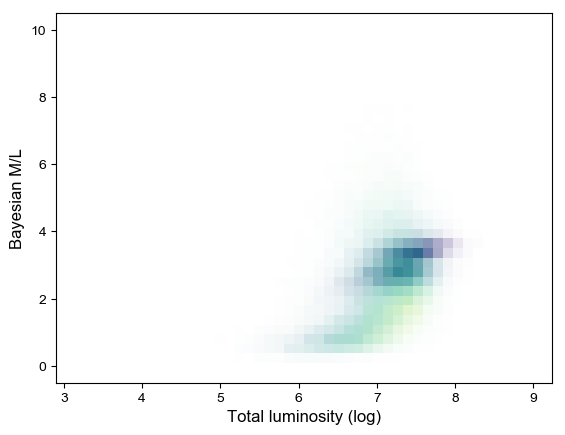

In [47]:
with plt.style.context(['ggplot', 'default']):
    plot_relation_bin('pre.sum.lum', 'ML_bayes',
                      'r50_scauto_197_gz2.1', subset=idx_tr, logx=True)

## Some relations (hexbin)

In [117]:
a = np.array([0.1, 0.6, 0.3])
a

array([0.1, 0.6, 0.3])

In [121]:
def scale_exp(x):
    x = 4*x
    return np.exp(x) / np.sum(np.exp(x))

def scale_sq(x):
    return np.square(x) / np.sum(np.square(x))

scale_sq(a)

array([0.02173913, 0.7826087 , 0.19565217])

In [870]:
from scipy import stats
from skimage import color

f_mode = lambda x: stats.mode(x, axis=None)[0][0]

def scale_sq(x):
    return np.square(x) / np.sum(np.square(x))

def blend_colors(c_arr, w_arr, mode='lab', weight_scale=None):
    """blend colors of shape (n_samp, 3) with weights of shape (n_samp) to shape (3)"""
    
    if weight_scale is not None:
        if weight_scale == 'sq':
            w_arr = scale_sq(w_arr)
    if mode == 'rgb':
        return (c_arr * w_arr[:, None]).sum(axis=0)
    elif mode == 'lab':
        clab_arr = color.rgb2lab((c_arr).reshape(1, -1, 3)).squeeze()
        clab_arr = (w_arr[:, None] * clab_arr).sum(axis=0)
        return color.lab2rgb((clab_arr).reshape(1, 1, 3)).squeeze()
    elif mode == 'max':
        return c_arr[w_arr.argmax()]
    
def plot_hexbin_classes(x, y, li_idx, li_colors, ax, tresfrac, scaleval, log_dens,
                        gridsize=100, extent=None, max_alpha=1.):
    mincnt = 1
    # x-like array with each element being the class index
    arr_class = np.zeros(len(x))
    for i in range(len(li_idx)):
        arr_class[li_idx[i].values] = i
    # Do hexbins to get total density
    sdens = ax.hexbin(x.values, y.values, C=arr_class, mincnt=mincnt, 
                      reduce_C_function=len, alpha=0.001, gridsize=gridsize, extent=extent)
    counts = sdens.get_array()
    sdens.remove()
    # Do hexbins to get class
    s = ax.hexbin(x, y, C=arr_class, mincnt=mincnt, reduce_C_function=f_mode, alpha=0.99,
                  gridsize=gridsize, extent=extent)
    plt.draw()
    cols = s.get_facecolors()
    arr_cls = s.get_array().astype(int)
    # set density (alpha)
    counts = counts + (np.max(counts)*tresfrac)
    if log_dens:
        if scaleval > 0:
            counts = counts / np.max(counts)
            counts = log_scale(counts, scaleval)
        else:
            counts = simple_log(counts)
    else:
        counts = counts / np.max(counts)
    counts = np.minimum(counts / max_alpha, 1.)
    cols[:, 3] = counts  # change alpha
#         cols[:, :3] = counts[:, None]*cols[:, :3]  # blend white
    for i in range(cols.shape[0]):
        cols[i, :3] = li_colors[arr_cls[i]]
    edgecols = cols.copy()
    edgecols[:, 3] = edgecols[:, 3] / 5.
    s.set_facecolor(cols)
    s.set_edgecolor(edgecols)
    s._facecolors = cols
    s._edgecolors = edgecols
#         s.changed()
    f = ax.get_figure()
    f.canvas.draw()
    f.canvas.draw_idle()
    return s

def plot_hexbin_classes_blend(x, y, li_idx, li_colors, ax, tresfrac, scaleval, log_dens,
                              blend_mode='lab', weight_scale='sq', gridsize=100, extent=None,
                              max_alpha=1.):
    mincnt = 1
    # x-like array with each element being the class index (not sure if used)
    arr_class = np.zeros(len(x), dtype=np.int)
    for i in range(len(li_idx)):
        arr_class[li_idx[i].values] = i
    # Do hexbins to get total density
    sdens = ax.hexbin(x.values, y.values, C=arr_class, mincnt=mincnt, 
                      reduce_C_function=len, alpha=0.001, gridsize=gridsize, extent=extent)
    counts = sdens.get_array()
    sdens.remove()
    # Do hexbins to get class
    arr_ncls = np.zeros((len(counts), len(li_idx)))
    for i in range(len(li_idx)):
        f_ncls = lambda x: np.sum(np.array(x) == i)
        s_cls = ax.hexbin(x, y, C=arr_class, mincnt=mincnt, reduce_C_function=f_ncls,
                          alpha=0.001, gridsize=gridsize, extent=extent)
        arr_ncls[:, i] = s_cls.get_array().copy()
        s_cls.remove()
    s = ax.hexbin(x, y, C=x, mincnt=mincnt, reduce_C_function=len, alpha=0.99,
                  gridsize=gridsize, extent=extent)
    plt.draw()
    cols = s.get_facecolors()
    # set density (alpha)
    counts = counts + (np.max(counts)*tresfrac)
    if log_dens:
        if scaleval > 0:
            counts = counts / np.max(counts)
            counts = log_scale(counts, scaleval)
        else:
            counts = simple_log(counts)
    else:
        counts = counts / np.max(counts)
    counts = np.minimum(counts / max_alpha, 1.)
    cols[:, 3] = counts  # change alpha
#         cols[:, :3] = counts[:, None]*cols[:, :3]  # blend white
    for i in range(cols.shape[0]):
        fracs = arr_ncls[i, :] / np.sum(arr_ncls[i, :])
        blend_cols = blend_colors(np.array(li_colors), fracs, mode=blend_mode,
                                  weight_scale=weight_scale)
        cols[i, :3] = blend_cols
    edgecols = cols.copy()
    edgecols[:, 3] = edgecols[:, 3] / 5.
    s.set_facecolor(cols)
    s.set_edgecolor(edgecols)
    s._facecolors = cols
    s._edgecolors = edgecols
#         s.changed()
    f = ax.get_figure()
    f.canvas.draw()
    f.canvas.draw_idle()
    return s

In [871]:
import matplotlib as mpl
import matplotlib.colors as colors
from matplotlib.lines import Line2D
from IPython.core.debugger import set_trace
from copy import deepcopy

def log_scale(x, a=100):
    return np.log10(1+(a*x)) / np.log10(1+a)

def simple_log(x):
    return np.log10(x) / np.log10(x.max())

def get_extent(x, margin=0.05):
    xmin, xmax = x.min(), x.max()
    xmn = xmin - (xmax - xmin)*margin
    xmx = xmax + (xmax - xmin)*margin
    return xmn, xmx

def plot_hexbin(x, y, c, ax, tresfrac, scaleval, log_dens, gridsize=100, extent=None,
                max_alpha=1.):
    mincnt = 1
    sdens = ax.hexbin(x, y, C=c, mincnt=mincnt, reduce_C_function=len, alpha=0.001,
                      gridsize=gridsize, extent=extent)
    counts = sdens.get_array()
    counts = counts + (np.max(counts)*tresfrac)
    sdens.remove()
    s = ax.hexbin(x, y, C=c, mincnt=mincnt, reduce_C_function=np.mean, alpha=0.99,
                  gridsize=gridsize, extent=extent)
    plt.draw()
    cols = s.get_facecolors()
#     print('counts', pd.Series(counts).describe())
    if log_dens:
        if scaleval > 0:
            counts = counts / np.max(counts)
            counts = log_scale(counts, scaleval)
        else:
            counts = simple_log(counts)
    else:
        counts = counts / np.max(counts)
    counts = np.minimum(counts / max_alpha, 1.)
    cols[:, 3] = counts  # change alpha
#         cols[:, :3] = counts[:, None]*cols[:, :3]  # blend white
    edgecols = cols.copy()
    edgecols[:, 3] = edgecols[:, 3] / 5.
    s.set_facecolor(cols)
    s.set_edgecolor(edgecols)
    s._facecolors = cols
    s._edgecolors = edgecols
#         s.changed()
    f.canvas.draw()
    f.canvas.draw_idle()
    return s

def plot_relation_hexbin(x_name, y_name, c_name, ax=None, logx=False, logy=False, logc=False,
                  alpha=0.3, subset=None, cax=None, sc_kwargs=None, xlim=None, ylim=None,
                        tresfrac=0.05, scaleval=0., log_dens=True, blend_mode="lab", 
                        weight_scale='sq', gridsize=100, vlim=None, max_alpha=1.):
    x = find_feature(x_name, logx, subset)
    y = find_feature(y_name, logy, subset)
    if ax is None:
        f, ax = plt.subplots()
    else:
        f = ax.get_figure()
    if sc_kwargs is None:
        sc_kwargs = {}
    if subset is None:
        subset = df_features.index
    if xlim is None:
        xlim = (-np.inf, np.inf)
    if ylim is None:
        ylim = (-np.inf, np.inf)
    # Subsetting
    b_sel = (x >= xlim[0]) & (x <= xlim[1]) & (y >= ylim[0]) & (y <= ylim[1])
    x, y = x[b_sel], y[b_sel]
    # Getting extent
    extent = [0]*4
    extent[0], extent[1] = get_extent(x)
    if y_name == 'ML_bayes':
        extent[2], extent[3] = -0.2, 9
    else:
        extent[2], extent[3] = get_extent(y)
    ax.set_xlim(extent[:2])
    ax.set_ylim(extent[2:])

    if (c_name != 'morpho') and (c_name != 'feat'):
        c = find_feature(c_name, logc, subset)[b_sel]
        if vlim is None:
            vlim = c.min(), c.max()
        else:
            c[c < vlim[0]] = vlim[0]
            c[c > vlim[1]] = vlim[1]
#         s = ax.scatter(x, y, c=c, alpha=alpha, s=10, **sc_kwargs)
        s = plot_hexbin(x, y, c, ax, tresfrac, scaleval, log_dens, gridsize=gridsize,
                        extent=extent, max_alpha=max_alpha)
    elif c_name == 'feat':
        raise NotImplementedError("Don't use c_name feat with hexbin!")
#         c_name = 'r50_scauto_197_gz2.1'
#         c = find_feature(c_name, logc, subset)
#         idx_edge = df_features.loc[subset, 'r50_scauto_197_gz2.3'] > 0.4
#         s = ax.scatter(x.loc[~idx_edge], y.loc[~idx_edge], c=c.loc[~idx_edge], 
#                        alpha=alpha, s=10, **sc_kwargs)
#         ax.scatter(x.loc[idx_edge], y.loc[idx_edge], label='edge-on', color='C1',
#                        alpha=alpha, s=10, **sc_kwargs)
    else:
        idx_edge = df_features.loc[x.index, 'r50_scauto_197_gz2.3'] > 0.4
        idx_feat = df_features.loc[x.index, 'r50_scauto_197_gz2.1'] > 0.4
        idx_irr = df_features.loc[x.index, 'r50_scauto_197_gz2.21'] > 0.2
        idx_ell = (~idx_edge) & (~idx_feat) & (~idx_irr)
        idx_feat = (~idx_edge) & (idx_feat) & (~idx_irr)
        idx_edge = (idx_edge) & (~idx_irr)
        idx_irr = idx_irr
#         d_classes = {'feature or disk': idx_feat, 'edge-on disk': idx_edge, 
#                      'elliptical': idx_ell, 'irregular': idx_irr}
        li_idx = [idx_irr, idx_feat, idx_edge, idx_ell]
        li_colors = [colors.to_rgba('xkcd:goldenrod')[:3],
                     colors.to_rgba('xkcd:blue')[:3],
                     colors.to_rgba('xkcd:teal')[:3],
                     colors.to_rgba('crimson')[:3]]
        s = plot_hexbin_classes_blend(x, y, li_idx, li_colors, ax, tresfrac, scaleval,
                                log_dens, blend_mode=blend_mode, weight_scale=weight_scale,
                                     gridsize=gridsize, extent=extent, max_alpha=max_alpha)
        li_names = ['irregular', 'feature or disk', 'edge-on disk', 'elliptical']
        legend_elements = [Line2D([0], [0], marker='h', color=li_colors[i], 
                                  label=li_names[i], markersize=7, linestyle='None')
                              for i in range(len(li_colors))]
        leg = ax.legend(handles=legend_elements, loc='upper left')
#         for lh in leg.legendHandles: 
#             lh.set_alpha(1)
    if cax:
        norm = mpl.colors.Normalize(vmin=vlim[0], vmax=vlim[1])
        mpl.colorbar.ColorbarBase(cax, orientation='horizontal', norm=norm)
#         cbar = f.colorbar(s, cax=cax, orientation='horizontal')
#         cbar.set_alpha(1)
#         cbar.draw_all()
#         with plt.rc_context(rc={'xtick.labeltop':True, 'xtick.labelbottom': False}):
        clabel = d_alias[c_name] if c_name in d_alias else c_name
        if logc:
            clabel = clabel + ' (log)'
        cax.set_xlabel(clabel)
        cax.get_xaxis().set_label_position('top')
        cax.tick_params(which='both', labelsize=8)
    xlabel = d_alias[x_name] if x_name in d_alias else x_name
    ylabel = d_alias[y_name] if y_name in d_alias else y_name
    if logx:
        xlabel = xlabel + ' (log)'
    if logy:
        ylabel = ylabel + ' (log)'
    ax.set_xlabel(xlabel, fontsize=12)
    ax.set_ylabel(ylabel, fontsize=12)
    return s, ax

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in log10


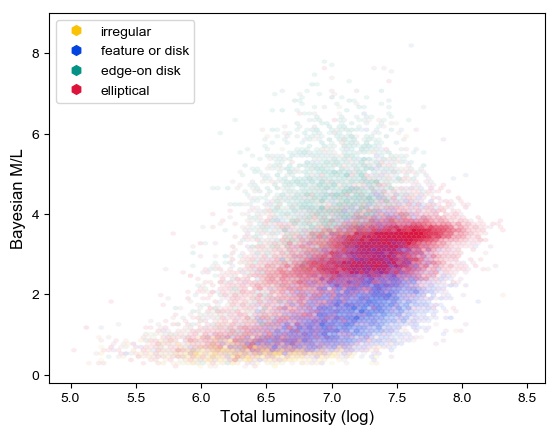

In [861]:
with plt.style.context(['ggplot', 'default']):
#     plt.rcParams['axes.facecolor'] = 'black'
    s, ax = plot_relation_hexbin('pre.sum.lum', 'ML_bayes',
                      'morpho', subset=idx_tr, logx=True, xlim=(5., 8.5), 
                                tresfrac=0.02, scaleval=2., log_dens=True,
                                blend_mode='lab', max_alpha=0.8)

(array([972., 307., 227., 228., 125., 165., 137., 110., 112.,  89., 109.,
        111.,  64.,  81.,  63.,  29.,  30.,  24.,  32.,  33.,  20.,  24.,
         18.,  21.,  30.,  18.,  11.,   6.,   3.,   4.]),
 array([0.06390784, 0.09511091, 0.12631399, 0.15751706, 0.18872013,
        0.2199232 , 0.25112627, 0.28232934, 0.31353242, 0.34473549,
        0.37593856, 0.40714163, 0.4383447 , 0.46954778, 0.50075085,
        0.53195392, 0.56315699, 0.59436006, 0.62556314, 0.65676621,
        0.68796928, 0.71917235, 0.75037542, 0.7815785 , 0.81278157,
        0.84398464, 0.87518771, 0.90639078, 0.93759386, 0.96879693,
        1.        ]),
 <a list of 30 Patch objects>)

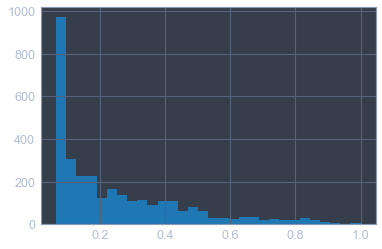

In [854]:
alphas = s._facecolors[:, 3]
plt.hist(alphas, bins=30)

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in log10


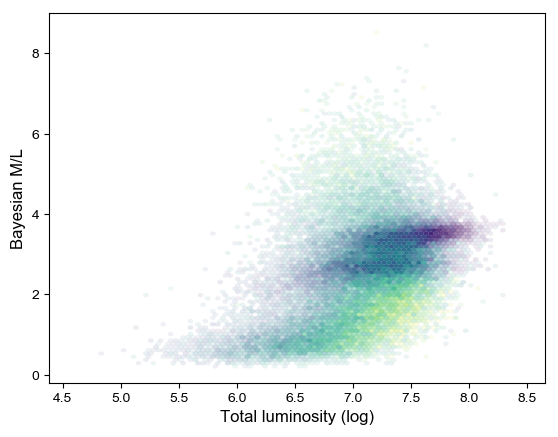

In [862]:
with plt.style.context(['ggplot', 'default']):
    s, ax = plot_relation_hexbin('pre.sum.lum', 'ML_bayes',
                      'r50_scauto_197_gz2.1', subset=idx_tr, logx=True, xlim=(4.5, 8.5),
                                tresfrac=0.02, scaleval=2., log_dens=True, gridsize=100,
                                max_alpha=0.8)

/Users/wouterdobbels/anaconda3/envs/mlearn/lib/python3.6/site-packages/ipykernel/__main__.py:11: RuntimeWarning: invalid value encountered in log10


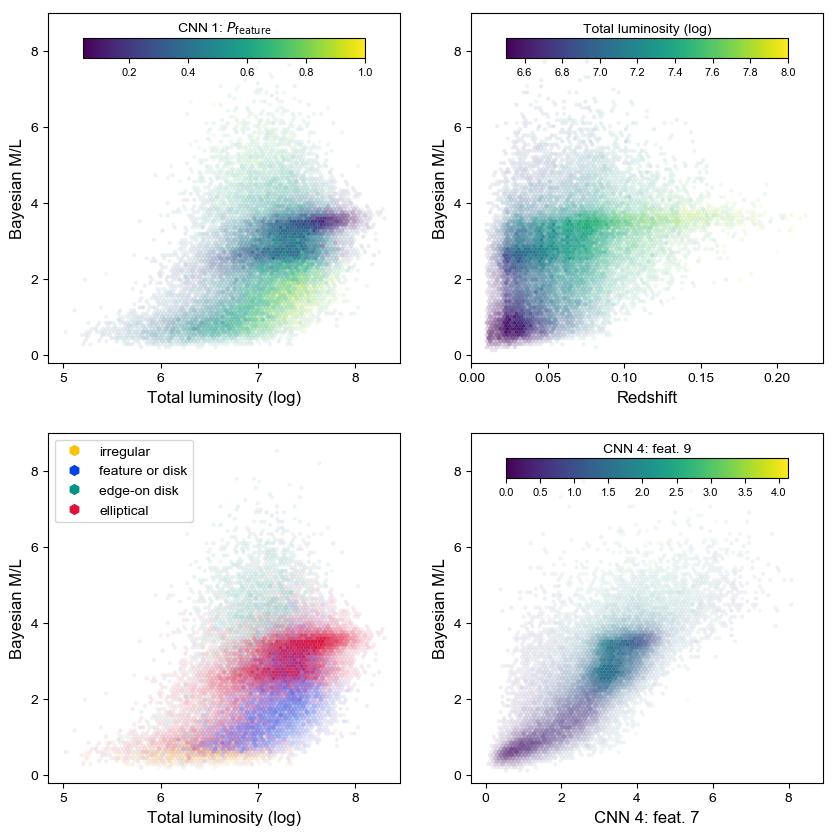

In [873]:
with plt.style.context(['ggplot', 'default']):
    # TODO: change subset to None (all points)
    subset = idx_tr
    tresfrac, scaleval, log_dens, gridsize = 0.02, 2., True, 100
    f, axarr = plt.subplots(2, 2, figsize=(10, 10))
    cax = create_subaxes(f, axarr[0, 0].get_position().bounds)
    plot_relation_hexbin('pre.sum.lum', 'ML_bayes', 'r50_scauto_197_gz2.1', axarr[0, 0],
                  logx=True, subset=subset, cax=cax, xlim=(5, 8.3), ylim=(-1, 9),
                        tresfrac=tresfrac, scaleval=scaleval, log_dens=log_dens, 
                        gridsize=gridsize, max_alpha=0.8)
    cax = create_subaxes(f, axarr[0, 1].get_position().bounds)
    plot_relation_hexbin('redshift', 'ML_bayes', 'pre.sum.lum', axarr[0, 1],
                         logc=True, subset=subset, cax=cax, xlim=(0., 0.22),
                         vlim=(6.5, 8),
                         tresfrac=tresfrac, scaleval=scaleval, log_dens=log_dens, 
                         gridsize=gridsize, max_alpha=0.8)
    plot_relation_hexbin('pre.sum.lum', 'ML_bayes', 'morpho', axarr[1, 0],
                  logx=True, subset=subset, xlim=(5, 8.3), ylim=(-1, 9),
                        tresfrac=tresfrac, scaleval=scaleval, log_dens=log_dens, 
                        gridsize=gridsize, max_alpha=0.8)
    cax = create_subaxes(f, axarr[1, 1].get_position().bounds)
    plot_relation_hexbin('r50_scauto_197_pretrainedchi.6.notop.layer2', 'ML_bayes', 
                  'r50_scauto_197_pretrainedchi.8.notop.layer2', axarr[1, 1],
                        subset=subset, cax=cax, xlim=(0., 8.5),
                        tresfrac=tresfrac, scaleval=scaleval, log_dens=log_dens, 
                        gridsize=gridsize, max_alpha=0.8)
#     plot_relation('r50_scauto_197_pretrained.6.notop', 'ML_bayes',
#                   'morpho', axarr[0, 2], subset=idx_test, alpha=0.07)
#     plot_relation('pre.scaleval', 'ML_bayes',
#                   'morpho', axarr[1, 2], subset=idx_test, logx=True, alpha=0.07)
    plt.savefig('plots/paper/scaling_relations_hexbin.pdf', dpi=300, bbox_inches='tight')

## Baseline chi-sq

In [725]:
import scipy.optimize

def base_chi(ybase):
    return np.mean(np.abs((ybase-y_test)/y_test_err))

res = scipy.optimize.minimize(base_chi, 1.3)

In [726]:
res

      fun: 6.523686605114441
 hess_inv: array([[1.63964466]])
      jac: array([4.99486923e-05])
  message: 'Desired error not necessarily achieved due to precision loss.'
     nfev: 333
      nit: 5
     njev: 107
   status: 2
  success: False
        x: array([2.15545668])

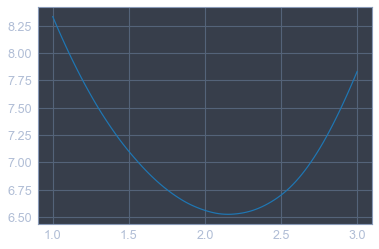

In [727]:
a = np.linspace(1, 3, 100)
b = np.array([base_chi(aval) for aval in a])
plt.plot(a, b)

In [ ]:
np.mean(np.square((res.x[0]-y_test) / y_test_err))

## Ablation histogram

In [800]:
d_preds.keys()

dict_keys(['nocnn', 'no_dist', 'no_lum', 'standard', 'no_cnn4', 'no_cnn13'])

In [804]:
d_names = {'nocnn': 'no morphology', 'no_dist': 'no distance', 'no_lum': 'no luminosity',
           'standard': 'all features', 'no_cnn4': 'no CNN 4', 'no_cnn13': 'no CNN 1-3'}

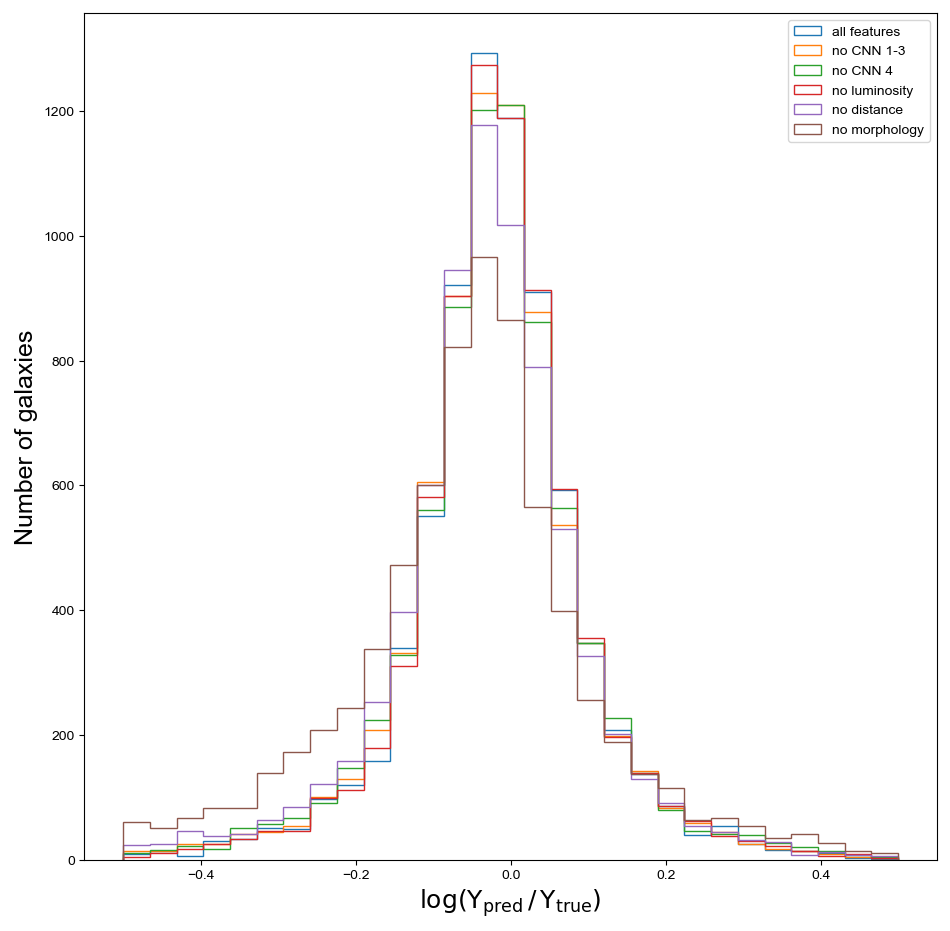

In [810]:
keys = ['standard', 'no_cnn13', 'no_cnn4', 'no_lum', 'no_dist', 'nocnn']
with plt.style.context(['ggplot', 'default']):
    plt.rcParams['axes.labelsize'] = 18
    f, ax = plt.subplots(figsize=(11, 11))
    bins = np.linspace(-0.5, 0.5, 30)
    for k in keys:
        y_pred = d_preds[k]
        dex = np.log10(y_pred / y_test)
        ax.hist(dex, bins=bins, histtype='step', label=d_names[k])
    ax.legend()
    ax.set_xlabel(r'$\log (\Upsilon_{\rm{pred}}\, / \, \Upsilon_{\rm{true}})$')
    ax.set_ylabel('Number of galaxies')
    plt.savefig('plots/lgbm/ablation_hist.pdf')

# Using cheat features

In [18]:
df_metamorph = pd.read_csv('data/metadata/metadata_morph_cumprobs.tsv', sep='\t',
                           index_col=0)
print(df_metamorph.shape)
df_metamorph.head()

(73627, 388)


,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t09_a27_cum_weighted,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.0,0.000000,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.0,0.213653,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226
1237662500

In [9]:
onlygz2 = False
if onlygz2:
    gz2cols = list(filter(lambda x: 'gz2' in x, df_features.columns))
    df_features.drop(columns=gz2cols, inplace=True)

In [307]:
pcols = list(filter(lambda x: 'cum_weighted' in x, df_metamorph.columns))
df_features[pcols] = df_metamorph.loc[df_features.index, pcols]

In [127]:
# Should include anyway
prelum_cols = list(filter(lambda x: ('pre' in x) and ('lum' in x) and (not 'log' in x),
                          df_features.columns))
prelumlog_cols = list(map(lambda x: x + '.log', prelum_cols))
df_features[prelumlog_cols] = np.log10(df_features[prelum_cols])
df_features['pre.min.lum.log'] = np.log10((-1)*df_features['pre.min.lum'])
df_features.fillna(0, inplace=True)

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:4: RuntimeWarning: invalid value encountered in log10


In [172]:
# Cheat: include true logL
df_features['logL_true'] = np.log10(df_metamorph.loc[df_features.index, 'L_g_bayes'])

In [34]:
# Cheat: include true logL
df_features['mag_g_true'] = df_metamorph.loc[df_features.index, 'modelMag_g']

In [133]:
df_features.describe()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,xcep_scauto_128_gz2.0,xcep_scauto_128_gz2.1,xcep_scauto_128_gz2.2,xcep_scauto_128_gz2.3,xcep_scauto_128_gz2.4,xcep_scauto_128_gz2.5,xcep_scauto_128_gz2.6,xcep_scauto_128_gz2.7,xcep_scauto_128_gz2.8,xcep_scauto_128_gz2.9,xcep_scauto_128_gz2.10,xcep_scauto_128_gz2.11,xcep_scauto_128_gz2.12,xcep_scauto_128_gz2.13,xcep_scauto_128_gz2.14,xcep_scauto_128_gz2.15,xcep_scauto_128_gz2.16,xcep_scauto_128_gz2.17,xcep_scauto_128_gz2.18,xcep_scauto_128_gz2.19,xcep_scauto_128_gz2.20,xcep_scauto_128_gz2.21,xcep_scauto_128_gz2.22,xcep_scauto_128_gz2.23,xcep_scauto_128_gz2.24,xcep_scauto_128_gz2.25,xcep_scauto_128_gz2.26,xcep_scauto_128_gz2.27,xcep_scauto_128_gz2.28,xcep_scauto_128_gz2.29,xcep_scauto_128_gz2.30,xcep_scauto_128_gz2.31,xcep_scauto_128_gz2.32,xcep_scauto_128_gz2.33,xcep_scauto_128_gz2.34,...,inv_dist_sq,redshift,inv_redshift,d_pix_kpc,t01_a01_cum_weighted,t01_a02_cum_weighted,t01_a03_cum_weighted,t02_a04_cum_weighted,t02_a05_cum_weighted,t03_a06_cum_weighted,t03_a07_cum_weighted,t04_a08_cum_weighted,t04_a09_cum_weighted,t05_a10_cum_weighted,t05_a11_cum_weighted,t05_a12_cum_weighted,t05_a13_cum_weighted,t06_a14_cum_weighted,t06_a15_cum_weighted,t07_a16_cum_weighted,t07_a17_cum_weighted,t07_a18_cum_weighted,t08_a19_cum_weighted,t08_a20_cum_weighted,t08_a21_cum_weighted,t08_a22_cum_weighted,t08_a23_cum_weighted,t08_a24_cum_weighted,t08_a38_cum_weighted,t09_a25_cum_weighted,t09_a26_cum_weighted,t09_a27_cum_weighted,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,pre.sum.lum.log,pre.mean.lum.log,pre.max.lum.log,pre.min.lum.log,pre.std.lum.log,pre.center.lum.log,pre.mean.center.lum.log,logL_true
count,7.362700e+04,73627.000000,7.362700e+04,7.362700e+04,73627.000000,7.362700e+04,7.362700e+04,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,...,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000,73627.000000
mean,1.994809e+07,842.802127,1.512352e+05,-4.854215e+03,4769.379983,1.160599e+05,8.819138e+04,166.295449,191.519611,5699.696009,0.113594,0.135012,0.971741,0.952346,0.502703,0.475504,0.021793,0.147880,0.327625,0.109160,0.218464,0.219312,0.108313,0.033384,0.166380,0.109682,0.018178,0.174604,0.803604,0.295412,0.371651,0.332936,0.035267,0.010258,0.021829,0.028577,0.043710,0.027940,0.007022,0.074993,0.014869,0.058018,0.082555,0.091274,0.045482,0.009289,0.112095,0.021481,0.011109,...,3.940873,0.059362,22.516923,0.493364,0.530634,0.445557,0.023808,0.113854,0.331701,0.098764,0.232923,0.225218,0.106468,0.030278,0.161755,0.118457,0.021162,0.195149,0.780796,0.144117,0.248071,0.138418,0.040037,0.011202,0.026011,0.030503,0.049241,0.032888,0.005150,0.062864,0.011331,0.039490,0.090376,0.09

In [26]:
df_features.head()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,xcep_scauto_128_gz2.0,xcep_scauto_128_gz2.1,xcep_scauto_128_gz2.2,xcep_scauto_128_gz2.3,xcep_scauto_128_gz2.4,xcep_scauto_128_gz2.5,xcep_scauto_128_gz2.6,xcep_scauto_128_gz2.7,xcep_scauto_128_gz2.8,xcep_scauto_128_gz2.9,xcep_scauto_128_gz2.10,xcep_scauto_128_gz2.11,xcep_scauto_128_gz2.12,xcep_scauto_128_gz2.13,xcep_scauto_128_gz2.14,xcep_scauto_128_gz2.15,xcep_scauto_128_gz2.16,xcep_scauto_128_gz2.17,xcep_scauto_128_gz2.18,xcep_scauto_128_gz2.19,xcep_scauto_128_gz2.20,xcep_scauto_128_gz2.21,xcep_scauto_128_gz2.22,xcep_scauto_128_gz2.23,xcep_scauto_128_gz2.24,xcep_scauto_128_gz2.25,xcep_scauto_128_gz2.26,xcep_scauto_128_gz2.27,xcep_scauto_128_gz2.28,xcep_scauto_128_gz2.29,xcep_scauto_128_gz2.30,xcep_scauto_128_gz2.31,xcep_scauto_128_gz2.32,xcep_scauto_128_gz2.33,xcep_scauto_128_gz2.34,...,custom_scauto_69_gz2.30,custom_scauto_69_gz2.31,custom_scauto_69_gz2.32,custom_scauto_69_gz2.33,custom_scauto_69_gz2.34,custom_scauto_69_gz2.35,custom_scauto_69_gz2.36,dist_sq,inv_dist_sq,redshift,inv_redshift,d_pix_kpc,t01_a01_cum_weighted,t01_a02_cum_weighted,t01_a03_cum_weighted,t02_a04_cum_weighted,t02_a05_cum_weighted,t03_a06_cum_weighted,t03_a07_cum_weighted,t04_a08_cum_weighted,t04_a09_cum_weighted,t05_a10_cum_weighted,t05_a11_cum_weighted,t05_a12_cum_weighted,t05_a13_cum_weighted,t06_a14_cum_weighted,t06_a15_cum_weighted,t07_a16_cum_weighted,t07_a17_cum_weighted,t07_a18_cum_weighted,t08_a19_cum_weighted,t08_a20_cum_weighted,t08_a21_cum_weighted,t08_a22_cum_weighted,t08_a23_cum_weighted,t08_a24_cum_weighted,t08_a38_cum_weighted,t09_a25_cum_weighted,t09_a26_cum_weighted,t09_a27_cum_weighted,t10_a28_cum_weighted,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.431856,0.554367,0.013777,0.374506,0.179861,0.034709,0.145152,0.108319,0.071542,0.021950,0.110565,0.042935,0.004411,0.118315,0.867908,0.192555,0.234059,0.573386,0.006736,0.006785,0.027225,0.027942,0.024642,0.007116,0.017869,0.222336,0.038988,0.113181,0.023639,0.043060,0.041620,0.006250,0.062368,0.000040,0.000000,...,0.024255,0.004543,0.042076,0.000000,0.000000,0.000000,0.030629,0.165959,6.025595,0.1213,8.244023,1.008135,0.935000,0.065000,0.000000,0.000000,0.065000,0.000000,0.065000,0.021645,0.043355,0.000000,0.043355,0.021645,0.000,0.023000,0.977000,0.043010,0.890120,0.001870,0.001587,0.000000,0.000000,0.000000,0.000000,0.000000,0.021413,0.000000,0.000000,0.000000,0.000000,0.000000,0.021645,0.0,0.000000,0.000000,0.000000,0.000000,0.021645
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.445743,0.517548,0.036708,0.261456,0.256093,0.094232,0.161860,0.130055,0.126038,0.005399,0.129719,0.094575,0.026400,0.205070,0.758222,0.191545,0.261148,0.547307,0.071554,0.015758,0.020113,0.005351,0.068273,0.024022,0.000000,0.172134,0.021752,0.067570,0.033184,0.044806,0.052064,0.007237,0.082995,0.000000,0.000000,...,0.149349,0.004747,0.136210,0.000000,0.000000,0.000000,0.025033,1.513561,0.660693,0.0403,24.813896,0.334937,0.615385,0.322677,0.061938,0.234586,0.088091,0.000000,0.088091,0.029334,0.058757,0.000000,0.000000,0.088091,0.000,0.088178,0.849884,0.000000,0.146462,0.468923,0.029363,0.058815,0.000000,0.000000,0.000000,0.000000,0.000000,0.175940,0.029323,0.029323,0.000000,0.000000,0.029334,0.0,0.029334,0.000000,0.000000,0.000000,0.000000
1237645943974396134,9.200295e+07,6081.231288,807584.197859,-14626.656286,30860.553

In [ ]:
# Now run GBM stuff again

# CV results
train_lgbm_cv.py ran on nancy

## Multisplit

In [10]:
df_cvresults = pd.read_csv('data/results/lgbm_results.tsv', sep='\t', index_col=0)
n_params = df_cvresults.shape[0]//3
# fix bad indexing (different index for different splits :( ))
splt1_cols = list(filter(lambda x: 'split1' in x, df_cvresults.columns))
splt2_cols = list(filter(lambda x: 'split2' in x, df_cvresults.columns))
df_cvresults.loc[:n_params-1, splt1_cols] = df_cvresults.loc[n_params:2*n_params-1, 
                                                             splt1_cols].values
df_cvresults.loc[:n_params-1, splt2_cols] = df_cvresults.loc[2*n_params:3*n_params-1, 
                                                             splt2_cols].values
df_cvresults = df_cvresults.iloc[:n_params]
print(df_cvresults.shape)
df_cvresults.head()

(125, 21)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,split0_test_chisq,split0_train_chisq,split0_test_rmse,split0_train_rmse,split0_test_r2,split0_train_r2,split1_test_chisq,split1_train_chisq,split1_test_rmse,split1_train_rmse,split1_test_r2,split1_train_r2,split2_test_chisq,split2_train_chisq,split2_test_rmse,split2_train_rmse,split2_test_r2,split2_train_r2
0,8,15,-1,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523
1,8,15,15,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523
2,8,15,10,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523
3,8,15,8,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523
4,8,15,5,17.349305,15.559457,0.304640,0.275305,0.351120,0.356699,18.448562,15.119752,0.322068,0.268311,0.356500,0.374494,18.249855,14.948159,0.327336,0.261716,0.353584,0.373656


In [11]:
n = df_cvresults.shape[0]
n_splits = 3
for mname in ['chisq', 'rmse', 'r2']:
    vals_test = np.zeros((n, n_splits))
    vals_train = np.zeros((n, n_splits))
    for i in range(n_splits):
        vals_test[:, i] = df_cvresults[f'split{i}_test_{mname}']
        vals_train[:, i] = df_cvresults[f'split{i}_train_{mname}']
    df_cvresults[f'mean_train_{mname}'] = np.mean(vals_train, axis=1)
    df_cvresults[f'std_train_{mname}'] = np.std(vals_train, axis=1)
    df_cvresults[f'mean_test_{mname}'] = np.mean(vals_test, axis=1)
    df_cvresults[f'std_test_{mname}'] = np.std(vals_test, axis=1)
print(df_cvresults.shape)
df_cvresults.head()

(125, 33)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,split0_test_chisq,split0_train_chisq,split0_test_rmse,split0_train_rmse,split0_test_r2,split0_train_r2,split1_test_chisq,split1_train_chisq,split1_test_rmse,split1_train_rmse,split1_test_r2,split1_train_r2,split2_test_chisq,split2_train_chisq,split2_test_rmse,split2_train_rmse,split2_test_r2,split2_train_r2,mean_train_chisq,std_train_chisq,mean_test_chisq,std_test_chisq,mean_train_rmse,std_train_rmse,mean_test_rmse,std_test_rmse,mean_train_r2,std_train_r2,mean_test_r2,std_test_r2
0,8,15,-1,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523,15.123375,0.150049,17.982818,0.524893,0.266926,0.003832,0.317433,0.010508,0.371567,0.005245,0.356643,0.001370
1,8,15,15,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523,15.123375,0.150049,17.982818,0.524893,0.266926,0.003832,0.317433,0.010508,0.371567,0.005245,0.356643,0.001370
2,8,15,10,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523,15.123375,0.150049,17.982818,0.524893,0.266926,0.003832,0.317433,0.010508,0.371567,0.005245,0.356643,0.001370
3,8,15,8,17.249453,15.318749,0.302886,0.271046,0.357657,0.364197,18.449001,15.097410,0.322076,0.267915,0.357567,0.375982,18.249999,14.953967,0.327338,0.261818,0.354706,0.374523,15.123375,0.150049,17.982818,0.524893,0.266926,0.003832,0.317433,0.010508,0.371567,0.005245,0.356643,0.001370
4,8,15,5,17.349305,15.559457,0.304640,0.275305,0.351120,0.356699,18.448562,15.119752,0.322068,0.268311,0.356500,0.374494,18.249855,14.948159,0.327336,0.261716,0.353584,0.373656,15.209123,0.257438,18.015907,0.478289,0.268444,0.005548,0.318014,0.009699,0.368283,0.008198,0.353734,0.002199


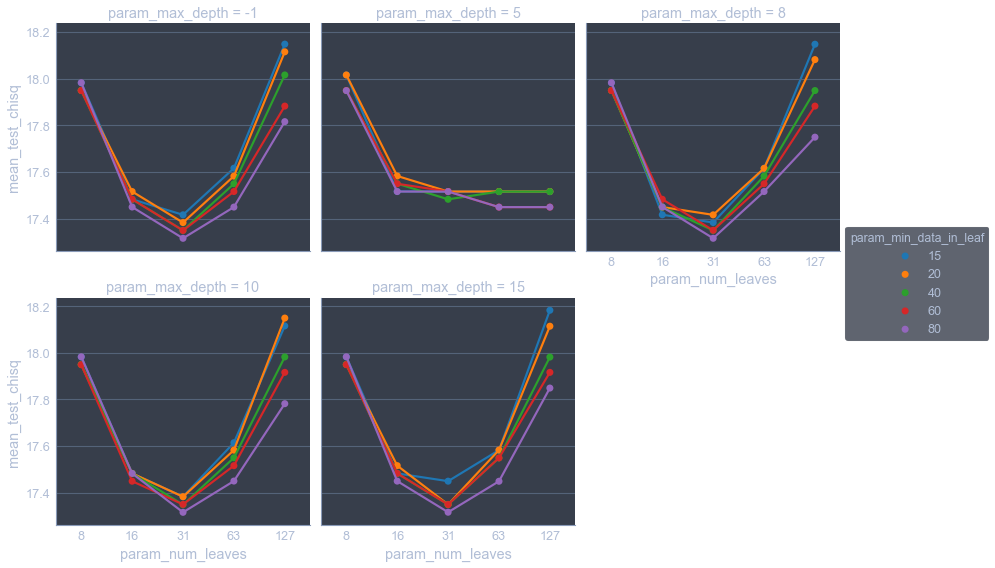

In [17]:
fgrid = sns.factorplot(x="param_num_leaves", y="mean_test_chisq", hue="param_min_data_in_leaf",
               col="param_max_depth", col_wrap=3,
               data=df_cvresults)

[<matplotlib.axes._subplots.AxesSubplot object at 0x1213c05c0>, <matplotlib.axes._subplots.AxesSubplot object at 0x121024b00>, <matplotlib.axes._subplots.AxesSubplot object at 0x1210bb240>, <matplotlib.axes._subplots.AxesSubplot object at 0x120fc59e8>, <matplotlib.axes._subplots.AxesSubplot object at 0x120ecfef0>]


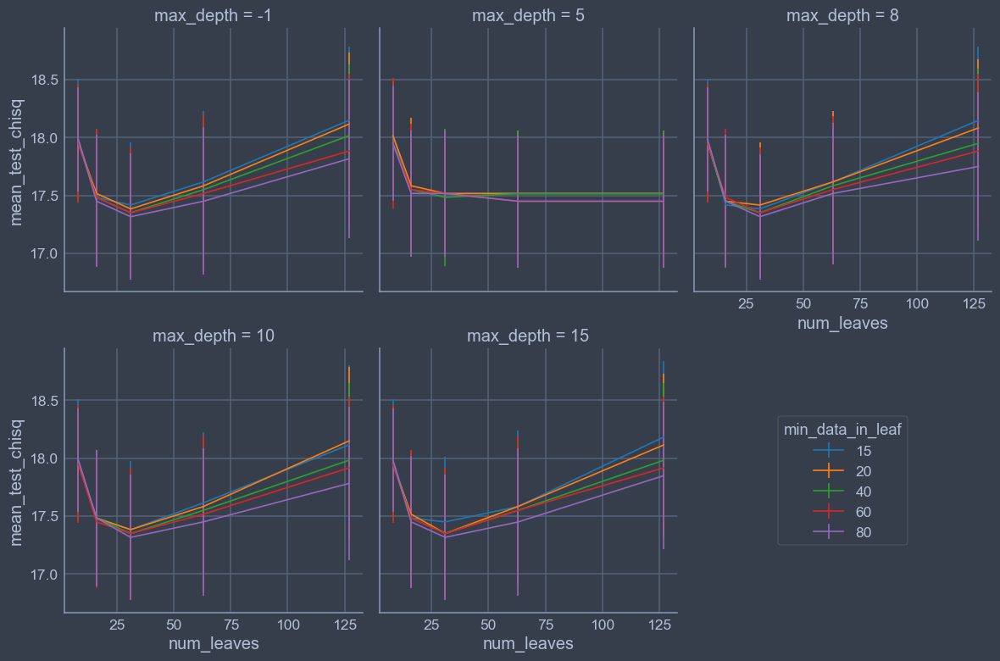

In [66]:
disc_cmap = plt.get_cmap('tab10')
df_rename = df_cvresults.copy()
df_rename.rename(columns={'param_max_depth': 'max_depth', 'param_num_leaves': 'num_leaves'},
                 inplace=True)
#plt.style.use(['default', 'ggplot'])
plt.style.use('onedork')
def plot_single(x, y, yerr, hue, **kwargs):
    ax = plt.gca()
    data = kwargs.pop("data")
    kwargs.pop("color")
    unique_hues = data[hue].unique()
    for i, cur_hue in enumerate(unique_hues):
        df_sub = data[data[hue] == cur_hue]
        df_sub.plot(x=x, y=y, yerr=yerr, ax=ax, c=disc_cmap.colors[i],
                    label=cur_hue, **kwargs)
g = sns.FacetGrid(df_rename, col="max_depth", col_wrap=3, size=4)
g.map_dataframe(plot_single, "num_leaves", "mean_test_chisq", "std_test_chisq",
                "param_min_data_in_leaf")
print(plt.gcf().axes)
handles, labels = g.axes[0].get_legend_handles_labels()
axlast = plt.gcf().add_subplot(236)
axlast.legend(handles, labels, title='min_data_in_leaf', loc="center")
axlast.get_xaxis().set_visible(False)
axlast.get_yaxis().set_visible(False)
axlast.spines['right'].set_visible(False)
axlast.spines['top'].set_visible(False)
axlast.spines['left'].set_visible(False)
axlast.spines['bottom'].set_visible(False)
#plt.savefig('plots/lgbm/lgbm_cv.pdf')
#g.add_legend(title='min_data_in_leaf', loc='lower right')

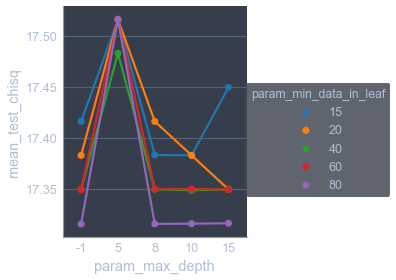

In [32]:
df_sub = df_cvresults[df_cvresults['param_num_leaves'] == 31]
sns.factorplot(x="param_max_depth", y="mean_test_chisq", hue="param_min_data_in_leaf",
               data=df_sub)

## Single split - 1

In [5]:
df_cvresults = pd.read_csv('data/results/lgbm_results.tsv', sep='\t', index_col=0)
print(df_cvresults.shape)
df_cvresults.head()

(96, 11)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,param_feature_fraction,param_bagging_fraction,val_chisq,tr_chisq,val_rmse,tr_rmse,val_r2,tr_r2
0,20,80,-1,0.8,0.8,13.449943,9.793473,0.235410,0.173575,0.547062,0.593123
1,20,80,-1,0.8,1.0,13.449943,9.793473,0.235410,0.173575,0.547062,0.593123
2,20,80,-1,1.0,0.8,13.447744,9.841711,0.235371,0.174430,0.546088,0.591927
3,20,80,-1,1.0,1.0,13.447744,9.841711,0.235371,0.174430,0.546088,0.591927
4,20,80,15,0.8,0.8,13.449943,9.793473,0.235410,0.173575,0.547062,0.593123


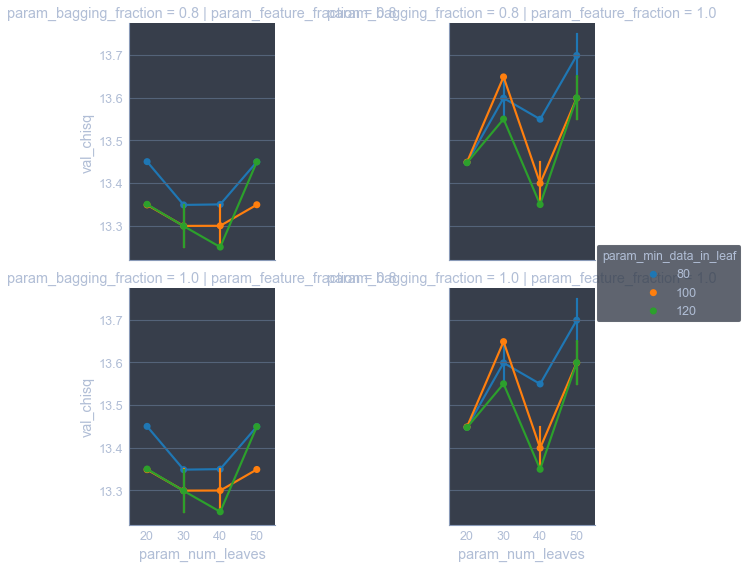

In [8]:
import seaborn as sns
sns.factorplot(x='param_num_leaves', y='val_chisq', hue='param_min_data_in_leaf', 
               row='param_bagging_fraction', col='param_feature_fraction', data=df_cvresults)

## Single split - 2

In [26]:
df_cvresults = pd.read_csv('data/results/lgbm_results_2.tsv', sep='\t', index_col=0)
print(df_cvresults.shape)
df_cvresults.head()

(27, 11)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,param_feature_fraction,param_bagging_fraction,val_chisq,tr_chisq,val_rmse,tr_rmse,val_r2,tr_r2
0,40,120,-1,0.4,0.6,13.249234,8.518743,0.231897,0.150982,0.575101,0.631145
1,40,120,-1,0.4,0.8,13.449102,8.664971,0.235395,0.153574,0.570468,0.625488
2,40,120,-1,0.4,1.0,13.348490,8.580369,0.233634,0.152074,0.570453,0.626384
3,40,120,-1,0.6,0.6,13.246149,8.571635,0.231843,0.151920,0.574877,0.631358
4,40,120,-1,0.6,0.8,13.149640,8.237996,0.230154,0.146006,0.579178,0.638829


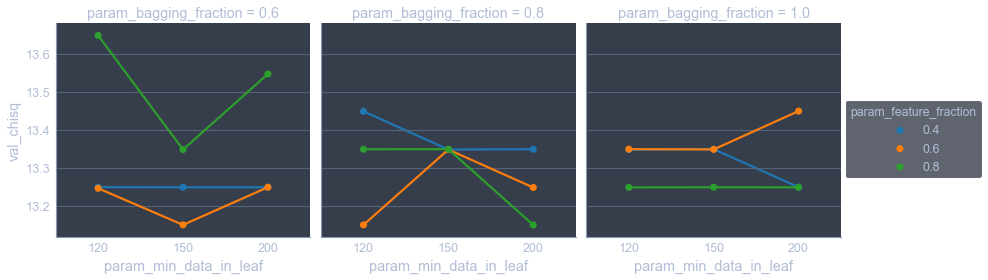

In [27]:
sns.factorplot(x='param_min_data_in_leaf', y='val_chisq', hue='param_feature_fraction', 
               col='param_bagging_fraction', data=df_cvresults)

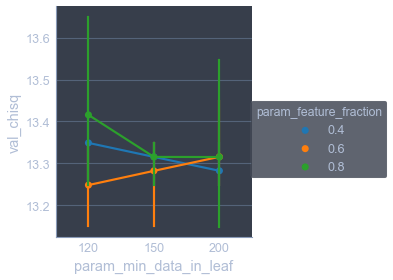

In [28]:
sns.factorplot(x='param_min_data_in_leaf', y='val_chisq', hue='param_feature_fraction', 
               data=df_cvresults)

## 5-fold

In [10]:
df_cvresults = pd.read_csv('data/results/lgbm_results_3.tsv', sep='\t', index_col=0)
df_cvresults.dropna(inplace=True)
print(df_cvresults.shape)
df_cvresults.head()

(27, 47)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,param_feature_fraction,param_bagging_fraction,split0_test_chisq,split0_train_chisq,split0_test_rmse,split0_train_rmse,split0_test_r2,split0_train_r2,split1_test_chisq,split1_train_chisq,split1_test_rmse,split1_train_rmse,split1_test_r2,split1_train_r2,split2_test_chisq,split2_train_chisq,split2_test_rmse,split2_train_rmse,split2_test_r2,split2_train_r2,split3_test_chisq,split3_train_chisq,split3_test_rmse,split3_train_rmse,split3_test_r2,split3_train_r2,split4_test_chisq,split4_train_chisq,split4_test_rmse,split4_train_rmse,split4_test_r2,split4_train_r2,mean_train_chisq,std_train_chisq,mean_test_chisq,std_test_chisq,mean_train_rmse,std_train_rmse,mean_test_rmse,std_test_rmse,mean_train_r2,std_train_r2,mean_test_r2,std_test_r2
0,40,120,-1,0.4,0.6,11.749224,9.096091,0.206284,0.161342,0.592977,0.609129,11.948705,9.302440,0.211622,0.164642,0.584388,0.600554,12.049768,9.430173,0.219971,0.165668,0.588935,0.601634,12.248959,9.279400,0.211428,0.165311,0.580572,0.605502,12.448868,9.113835,0.220980,0.161212,0.566364,0.618093,9.244388,0.125018,12.089105,0.241562,0.163635,0.001954,0.214057,0.005589,0.606983,0.006327,0.582647,0.009151
1,40,120,-1,0.4,0.8,11.749636,9.079319,0.206291,0.161045,0.589270,0.606211,11.949101,9.016858,0.211629,0.159587,0.589124,0.607601,12.048465,9.272884,0.219947,0.162905,0.589226,0.603716,12.148872,8.650282,0.209700,0.154103,0.591373,0.622379,12.348974,8.687332,0.219207,0.153668,0.572599,0.627569,8.941335,0.238285,12.049010,0.199779,0.158262,0.003727,0.213355,0.005365,0.613495,0.009596,0.586318,0.006911
2,40,120,-1,0.4,1.0,11.749335,8.942545,0.206286,0.158619,0.590530,0.610300,11.949738,8.911920,0.211641,0.157730,0.591290,0.609777,11.949698,8.901682,0.218144,0.156384,0.596282,0.613399,12.248869,8.690461,0.211426,0.154819,0.588763,0.620131,12.449636,8.817646,0.220994,0.155973,0.568713,0.623202,8.852851,0.091136,12.069455,0.248144,0.156705,0.001335,0.213698,0.005241,0.615362,0.005383,0.587116,0.009534
3,40,120,-1,0.6,0.6,11.849630,9.353668,0.208047,0.165911,0.586458,0.602140,11.948598,9.095786,0.211620,0.160984,0.591891,0.609706,12.049712,9.181432,0.219970,0.161298,0.596222,0.609959,12.149705,8.690444,0.209714,0.154818,0.593552,0.623643,12.449415,9.043971,0.220990,0.159977,0.567039,0.620822,9.073060,0.218286,12.089412,0.205979,0.160598,0.003540,0.214068,0.005365,0.613254,0.007901,0.587032,0.010494
4,40,120,-1,0.6,0.8,11.749847,8.950454,0.206295,0.158759,0.592187,0.611240,11.949322,8.934146,0.211633,0.158123,0.590573,0.610154,12.048413,9.093409,0.219946,0.159752,0.593573,0.610009,12.248428,8.611411,0.211418,0.153410,0.592054,0.623867,12.449197,8.766596,0.220986,0.155070,0.570983,0.626023,8.871203,0.166164,12.089041,0.241388,0.157023,0.002389,0.214056,0.005582,0.616259,0.007138,0.587874,0.008499


In [20]:
paramcols = list(filter(lambda x: 'param' in x, df_cvresults.columns))
splitcols = list(filter(lambda x: 'split' in x, df_cvresults.columns))
df_long = pd.melt(df_cvresults, id_vars=paramcols, value_vars=splitcols)
df_long = df_long[df_long['variable'].str.contains('test_chisq')]
cols = list(df_long.columns)
cols[-1] = 'test_chisq'
df_long.columns = cols
print(df_long.shape)
df_long.head()

(135, 7)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,param_feature_fraction,param_bagging_fraction,variable,test_chisq
0,40,120,-1,0.4,0.6,split0_test_chisq,11.749224
1,40,120,-1,0.4,0.8,split0_test_chisq,11.749636
2,40,120,-1,0.4,1.0,split0_test_chisq,11.749335
3,40,120,-1,0.6,0.6,split0_test_chisq,11.849630
4,40,120,-1,0.6,0.8,split0_test_chisq,11.749847


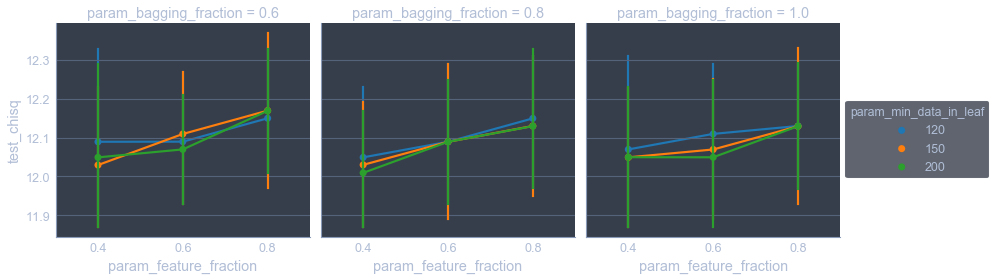

In [22]:
import seaborn as sns
sns.factorplot(x="param_feature_fraction", y="test_chisq", hue="param_min_data_in_leaf",
               col='param_bagging_fraction', data=df_long)

## 5-fold - 2

In [5]:
df_cvresults = pd.read_csv('data/results/lgbm_results_4.tsv', sep='\t', index_col=0)
df_cvresults.dropna(inplace=True)
print(df_cvresults.shape)
df_cvresults.head()

(6, 47)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,param_feature_fraction,param_bagging_fraction,split0_test_chisq,split0_train_chisq,split0_test_rmse,split0_train_rmse,split0_test_r2,split0_train_r2,split1_test_chisq,split1_train_chisq,split1_test_rmse,split1_train_rmse,split1_test_r2,split1_train_r2,split2_test_chisq,split2_train_chisq,split2_test_rmse,split2_train_rmse,split2_test_r2,split2_train_r2,split3_test_chisq,split3_train_chisq,split3_test_rmse,split3_train_rmse,split3_test_r2,split3_train_r2,split4_test_chisq,split4_train_chisq,split4_test_rmse,split4_train_rmse,split4_test_r2,split4_train_r2,mean_train_chisq,std_train_chisq,mean_test_chisq,std_test_chisq,mean_train_rmse,std_train_rmse,mean_test_rmse,std_test_rmse,mean_train_r2,std_train_r2,mean_test_r2,std_test_r2
0,40,150,-1,0.1,0.8,11.749423,9.051132,0.206288,0.160545,0.590278,0.605225,11.949670,9.235850,0.211639,0.163463,0.581325,0.597659,11.949667,9.155907,0.218143,0.160850,0.589510,0.603759,12.249765,9.027763,0.211441,0.160828,0.580357,0.608598,12.349406,8.664492,0.219215,0.153264,0.571121,0.623742,9.027029,0.196077,12.049586,0.219102,0.159790,0.003431,0.213345,0.004771,0.607796,0.008724,0.582518,0.007001
1,40,150,-1,0.2,0.8,11.649928,9.023468,0.204541,0.160054,0.591528,0.607350,11.848217,9.062948,0.209843,0.160403,0.587852,0.604708,11.949909,9.017395,0.218148,0.158417,0.594422,0.610347,12.249966,8.879233,0.211445,0.158182,0.585599,0.615073,12.349768,8.826680,0.219221,0.156133,0.568873,0.621603,8.961945,0.091869,12.009558,0.257861,0.158638,0.001527,0.212640,0.005450,0.611816,0.005984,0.585655,0.008920
2,40,150,-1,0.3,0.8,11.748355,9.101686,0.206269,0.161441,0.588949,0.605417,11.849355,8.995164,0.209863,0.159203,0.590983,0.607574,12.049642,9.283931,0.219968,0.163099,0.588908,0.602562,12.148416,8.586908,0.209692,0.152974,0.591582,0.624191,12.348201,8.872160,0.219194,0.156937,0.568917,0.621128,8.967970,0.233597,12.028794,0.213359,0.158731,0.003550,0.212997,0.005532,0.612174,0.008761,0.585868,0.008543
3,40,150,-1,0.4,0.8,11.749212,9.081895,0.206284,0.161090,0.589148,0.606075,11.849531,8.819522,0.209866,0.156094,0.594480,0.613077,11.948762,9.076555,0.218127,0.159456,0.594213,0.609439,12.149450,8.475470,0.209710,0.150989,0.593027,0.626836,12.248299,8.679988,0.217420,0.153538,0.573481,0.627507,8.826686,0.233448,11.989051,0.185229,0.156234,0.003708,0.212281,0.004669,0.616587,0.008924,0.588870,0.007927
4,40,150,-1,0.5,0.8,11.748692,9.050746,0.206275,0.160538,0.590202,0.606989,11.947986,9.178726,0.211610,0.162452,0.586344,0.602518,12.049551,9.279719,0.219967,0.163025,0.588627,0.602877,12.248794,8.660334,0.211425,0.154282,0.588713,0.621846,12.349875,8.829996,0.219223,0.156192,0.570194,0.623507,8.999904,0.226731,12.068980,0.213933,0.159298,0.003469,0.213700,0.005186,0.611547,0.009237,0.584816,0.007414


In [6]:
paramcols = list(filter(lambda x: 'param' in x, df_cvresults.columns))
splitcols = list(filter(lambda x: 'split' in x, df_cvresults.columns))
df_long = pd.melt(df_cvresults, id_vars=paramcols, value_vars=splitcols)
df_long = df_long[df_long['variable'].str.contains('test_chisq')]
cols = list(df_long.columns)
cols[-1] = 'test_chisq'
df_long.columns = cols
print(df_long.shape)
df_long.head()

(30, 7)


,param_num_leaves,param_min_data_in_leaf,param_max_depth,param_feature_fraction,param_bagging_fraction,variable,test_chisq
0,40,150,-1,0.1,0.8,split0_test_chisq,11.749423
1,40,150,-1,0.2,0.8,split0_test_chisq,11.649928
2,40,150,-1,0.3,0.8,split0_test_chisq,11.748355
3,40,150,-1,0.4,0.8,split0_test_chisq,11.749212
4,40,150,-1,0.5,0.8,split0_test_chisq,11.748692


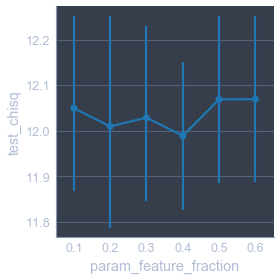

In [7]:
import seaborn as sns
sns.factorplot(x="param_feature_fraction", y="test_chisq", data=df_long)

# Interpretation

## Scaleval

In [11]:
df_features['pre.scaleval'].head()

SDSS_ID
1237645879578460255     28.777936
1237645941824356443    131.452257
1237645943974396134    219.225784
1237645943975837722     50.869790
1237645943978328289      8.887116
Name: pre.scaleval, dtype: float64

In [17]:
s_sv = df_features['pre.scaleval'].sort_values().copy()
n = len(s_sv)
s_sv.head()

SDSS_ID
1237662198276489572    0.1
1237666301627531485    0.1
1237667252936114226    0.1
1237658203440611536    0.1
1237654879114887459    0.1
Name: pre.scaleval, dtype: float64

In [51]:
plt.style.use(['default', 'ggplot'])

In [76]:
# Star sub fails?
np.sum(s_sv <= 0.11)

65

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:13: RuntimeWarning: divide by zero encountered in log10


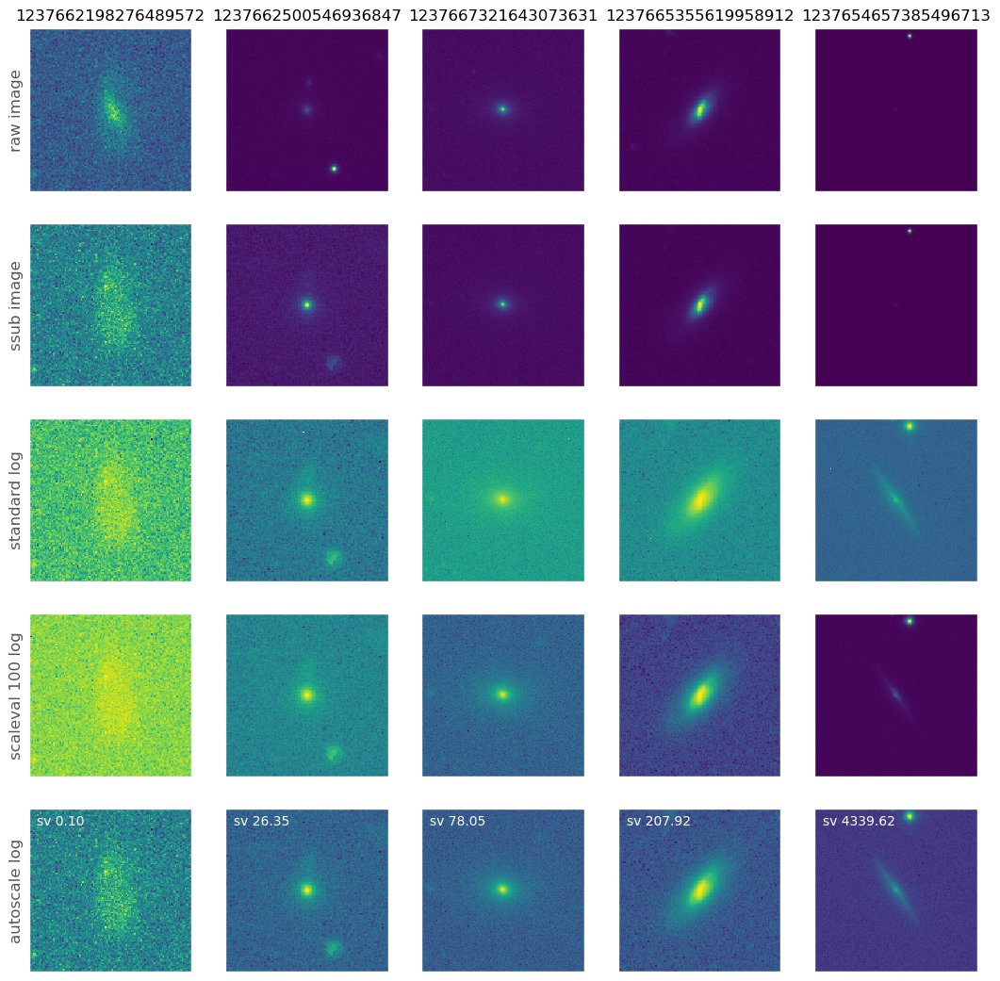

In [81]:
percentiles = [0, 0.25, 0.5, 0.75, 1]
offset = 0  # extra index to shift with
f, axarr = plt.subplots(ncols=5, nrows=5, figsize=(13, 13))
for i, percentile in enumerate(percentiles):
    idx = int(n * percentile) + offset
    if percentile == 1:
        idx = n - 1 - offset
    sdss_id = s_sv.index[idx]
    sv = s_sv.loc[sdss_id]
    img_raw = ht.get_galaxydata(sdss_id, ssubtype='raw')
    img = ht.get_galaxydata(sdss_id)
    img = (img - img.min()) / (img.max() - img.min())
    img_lg = np.log10(img)
    img_lg100 = np.log10(1 + 100*img)
    img_sc = np.log10(1 + sv*img)
    
    axes = axarr[:, i]
    axes[0].imshow(img_raw)
    axes[0].set_title(f'{sdss_id}', fontsize=12)
    axes[1].imshow(img)
    axes[2].imshow(img_lg)
    axes[3].imshow(img_lg100)
    axes[4].imshow(img_sc)
    axes[4].text(0.05, 0.9, f'sv {sv:.2f}', color='w', transform=axes[4].transAxes)
#         ax.get_xaxis().set_visible(False)
#         ax.get_yaxis().set_visible(False)
for ax in axarr.flatten():
    ax.tick_params(axis=u'both', which=u'both', length=0, labelbottom=False,
                   labelleft=False, bottom=False, left=False, grid_linewidth=0)
        
axarr[0, 0].set_ylabel('raw image')
axarr[1, 0].set_ylabel('ssub image')
axarr[2, 0].set_ylabel('standard log')
axarr[3, 0].set_ylabel('scaleval 100 log')
axarr[4, 0].set_ylabel('autoscale log')
plt.savefig(f'plots/scaleval/scaleval_{offset}.pdf')
#plt.tight_layout()
#plt.subplots_adjust(wspace=0.1, hspace=0.1)

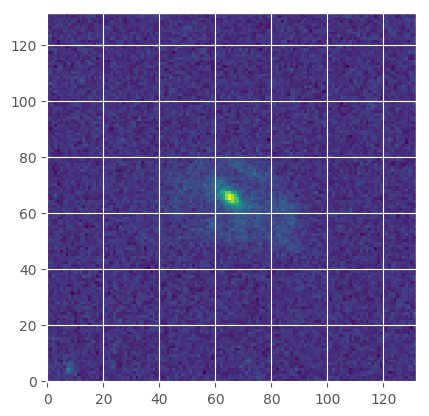

In [66]:
ht.plot_galaxy(s_sv.index[3], ssubtype='raw')

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:7: RuntimeWarning: divide by zero encountered in log10


Scaleval: 28.78


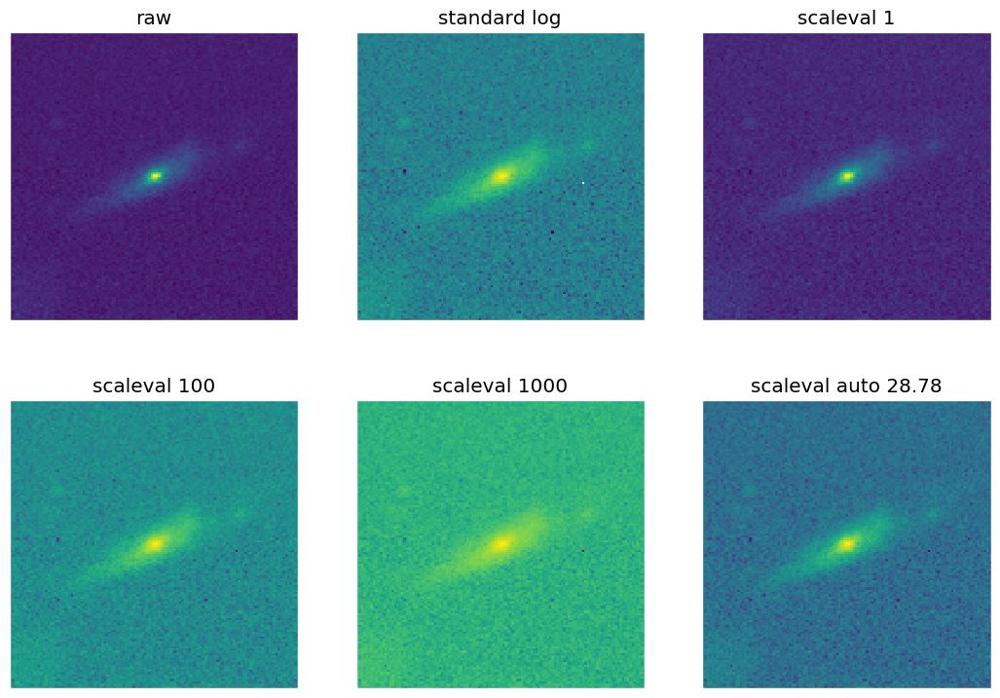

In [98]:
# galaxy with failed ssub
# ['1237652629098594325', '1237645943978328289', '1237645943978983683',
#            '1237645943979114622', '1237645879578460255']
sdss_id = 1237645879578460255
img = ht.get_galaxydata(sdss_id)
img = (img - img.min()) / (img.max() - img.min())
img_lg = np.log10(img)
img_sv1 = np.log10(1 + img)
img_sv100 = np.log10(1 + 100 * img)
img_sv1000 = np.log10(1 + 1000 * img)
sv = s_sv.loc[sdss_id]
img_svauto = np.log10(1 + sv*img)
print(f'Scaleval: {sv:.2f}')
f, axarr = plt.subplots(nrows=2, ncols=3, figsize=(13, 9))
axarr[0, 0].imshow(img)
axarr[0, 1].imshow(img_lg)
axarr[0, 2].imshow(img_sv1)
axarr[1, 0].imshow(img_sv100)
axarr[1, 1].imshow(img_sv1000)
axarr[1, 2].imshow(img_svauto)
axarr[0, 0].set_title('raw')
axarr[0, 1].set_title('standard log')
axarr[0, 2].set_title('scaleval 1')
axarr[1, 0].set_title('scaleval 100')
axarr[1, 1].set_title('scaleval 1000')
axarr[1, 2].set_title(f'scaleval auto {sv:.2f}')
for ax in axarr.flatten():
    ax.tick_params(axis=u'both', which=u'both', length=0, labelbottom=False,
                   labelleft=False, bottom=False, left=False, grid_linewidth=0)
plt.savefig(f'plots/scaleval/{sdss_id}.pdf')

78.0527042921


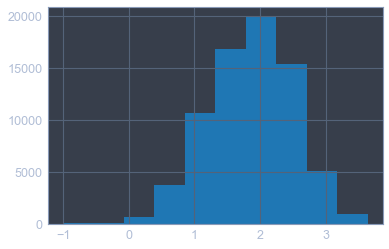

In [44]:
print(np.median(s_sv))
np.log10(s_sv).hist()

In [40]:
from ipywidgets import interact
from ipywidgets import IntSlider, Layout

def logscale_img(x, sv):
    return np.log10(1 + sv*x) / np.log10(1 + sv)

def show_slice(idx):
    sdss_id = s_sv.index[idx]
    sv = s_sv.iloc[idx]
    img_nossub = ht.get_galaxydata(sdss_id, ssubtype='raw')
    img = ht.get_galaxydata(sdss_id)
    img = (img - img.min()) / (img.max() - img.min())
    f, axarr = plt.subplots(ncols=4, figsize=(14, 6))
    axarr[0].imshow(img_nossub)
    axarr[1].imshow(img)
    axarr[2].imshow(logscale_img(img, 100))
    axarr[3].imshow(logscale_img(img, sv))
    axarr[0].set_title(f'{sdss_id}')
    axarr[1].set_title('ssub')
    axarr[2].set_title('sv 100')
    axarr[3].set_title(f'sv {sv:.2f}')
    for ax in axarr:
        ax.set_xticks([])
        ax.set_yticks([])
    plt.show()
    
interact(show_slice, idx=IntSlider(min=0, max=len(s_sv), continuous_update=False,
                                   layout=Layout(width='100%')))

interactive(children=(IntSlider(value=0, continuous_update=False, description='idx', layout=Layout(width='100%'), max=73627), Output()), _dom_classes=('widget-interact',))

<function __main__.show_slice(idx)>

In [46]:
good_ids = [1237658493341073551, 1237652946384191588, 1237671958591438878]

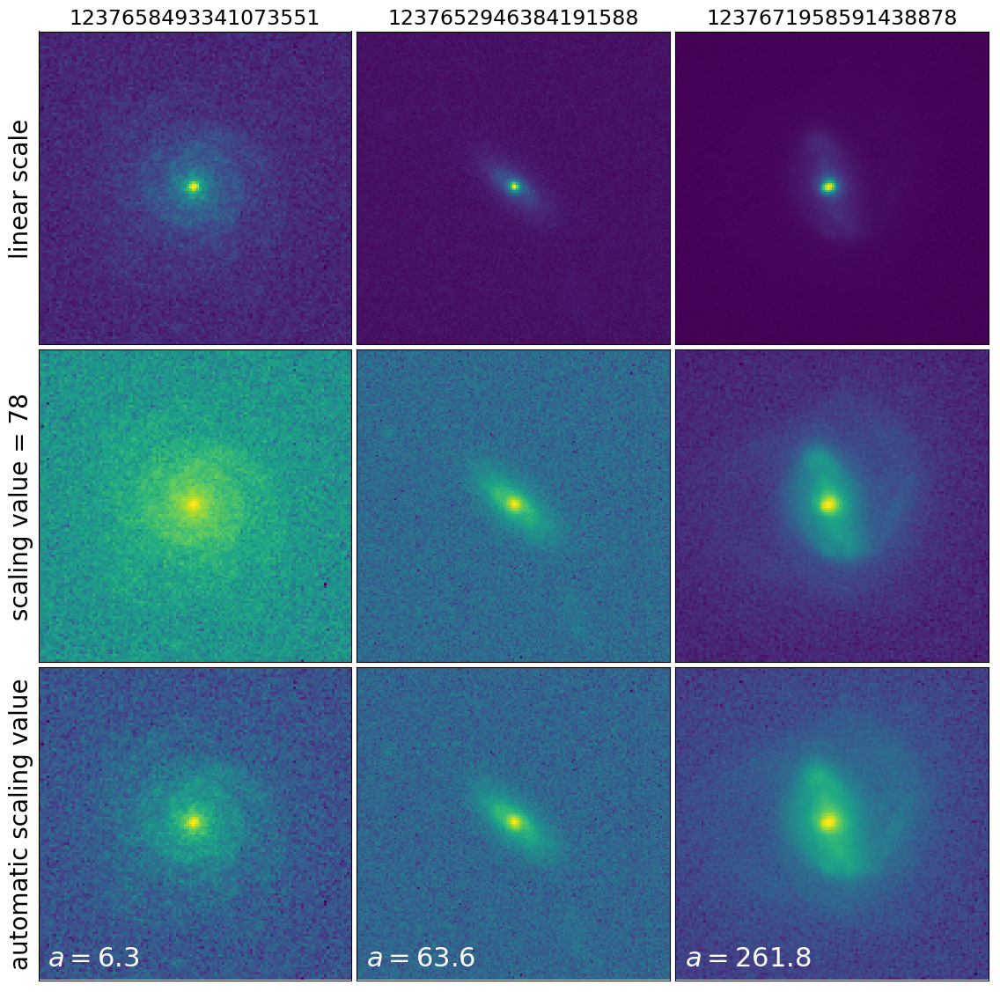

In [94]:
f, axarr = plt.subplots(nrows=3, ncols=len(good_ids), figsize=(14, 14), 
                        gridspec_kw={'wspace':0.0, 'hspace': 0.015})
fs = 20
plt.style.use(['default'])
for i, idx in enumerate(good_ids):
    sv = s_sv.loc[idx]
    img = ht.get_galaxydata(idx)
    img = (img - img.min()) / (img.max() - img.min())
    axs = axarr[:, i]
    axs[0].imshow(img)
    axs[1].imshow(logscale_img(img, 78))
    axs[2].imshow(logscale_img(img, sv))
    axs[0].set_title(f'{idx}', fontsize=17)
    axs[2].text(0.03, 0.03, f'$a = {sv:.1f}$',
        verticalalignment='bottom', horizontalalignment='left',
        transform=axs[2].transAxes,
        color='white', fontsize=22)
axarr[0, 0].set_ylabel('linear scale', fontsize=fs)
axarr[1, 0].set_ylabel('scaling value = 78', fontsize=fs)
axarr[2, 0].set_ylabel('automatic scaling value', fontsize=fs)

for ax in axarr.flatten():
    ax.set_xticks([])
    ax.set_yticks([])
plt.savefig('plots/scaleval/scauto_examples.pdf', bbox_inches='tight')
#f.tight_layout(pad=0.1, w_pad=0.5, h_pad=0.1, rect=(0, 0, 1, 1))
#f.tight_layout()

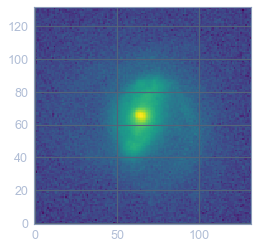

In [43]:
ht.plot_galaxy(1237671958591438878, scaleval=261.84)

## Axisratio outliers

In [25]:
# Now in metamorph!
df_axisratios = pd.read_csv('data/metadata/axisratios_sdss.csv', index_col=0)
df_axisratios['avg_AB'] = (df_axisratios['deVAB_g'] * df_axisratios['fracDeV_g'] + 
                           df_axisratios['expAB_g'] * (1 - df_axisratios['fracDeV_g']))
df_axisratios.iloc[127, 1:] = 1  # fix -9999
print(df_axisratios.shape)
df_axisratios.head()

(73627, 4)


,deVAB_g,expAB_g,fracDeV_g,avg_AB
objID,,,,
1237645879578460255,0.246842,0.285504,0.782729,0.255242
1237645941824356443,0.339572,0.335529,0.822057,0.338853
1237645943974396134,0.758263,0.658212,1.000000,0.758263
1237645943975837722,0.464938,0.503385,0.000000,0.503385
1237645943978328289,0.327550,0.358346,0.098875,0.355301


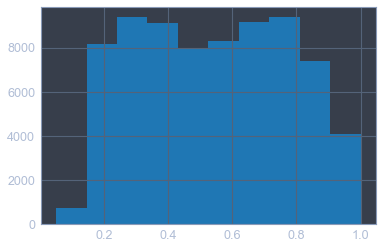

In [116]:
df_axisratios['avg_AB'].hist()

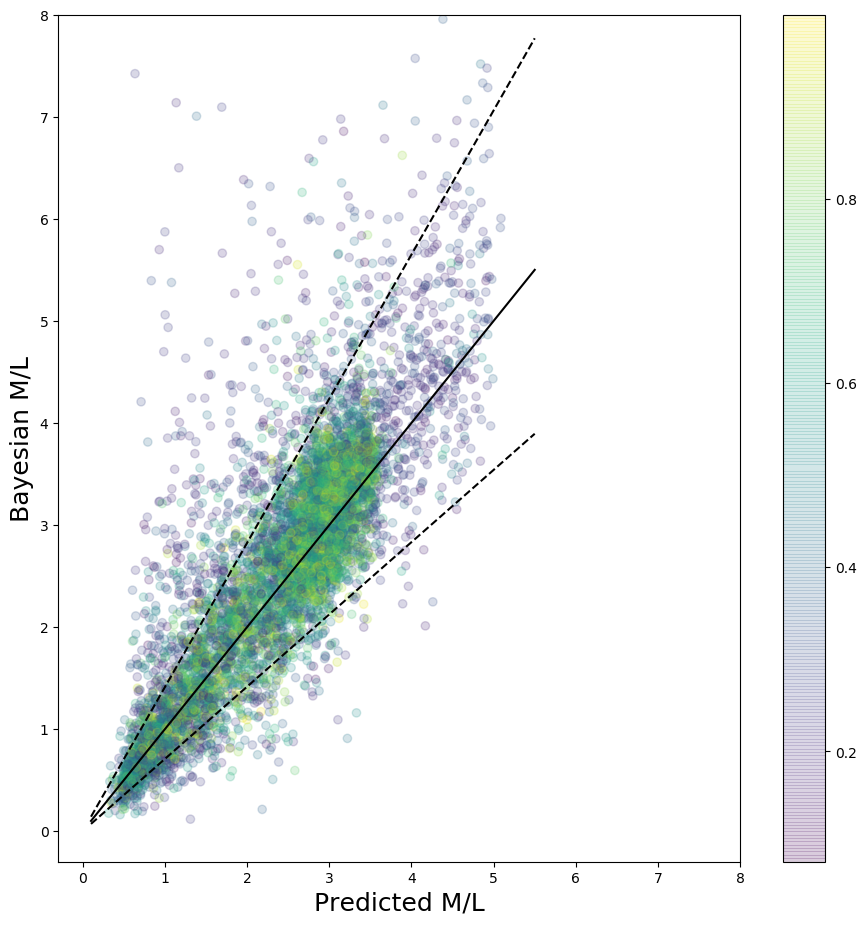

In [180]:
# Truevspred
c = df_axisratios.loc[idx_test, 'avg_AB']
badidx = (c < 0.6).values
badidx = np.zeros((len(idx_test))).astype(bool)
y_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
x = np.linspace(0.1, 5.5, 10)
dexlines = 0.15
with plt.style.context(['default']):
    plt.rcParams['axes.labelsize'] = 18
    plt.figure(figsize=(11, 11))
#     sns.kdeplot(y_test, y_pred, alpha=1, cmap=cmap, shade=True, #bw=0.2, cut=0, n_levels=60, 
#                 n_levels=60)
#     plt.scatter(y_pred, y_test, c=c, alpha=0.1,
#                 label=f'LGB chi² {cur_chisq:.2f}')
#     plt.errorbar(y_pred, y_test, yerr=y_err, c=c, linestyle='None', alpha=0.1, marker='o',
#                  ecolor='#beaed4', mfc='#7fc97f', mec='#588958')
    plt.scatter(y_pred[~badidx], y_test[~badidx], alpha=0.2, c=c[~badidx])
    plt.colorbar()
    plt.scatter(y_pred[badidx], y_test[badidx], alpha=0.2, c='r')    
    plt.plot(x, x, 'k')
    plt.plot(x, np.power(10, dexlines)*x, 'k--')
    plt.plot(x, np.power(10, -dexlines)*x, 'k--')
    plt.xlim([-0.3, 8])
    plt.ylim([-0.3, 8])
    
    #plt.legend()
    plt.ylabel('Bayesian M/L')
    plt.xlabel('Predicted M/L')
    #plt.savefig('plots/lgbm/truevspred.png', dpi=100, bbox_inches='tight')

In [92]:
window_w = 0.05
bins = np.linspace(0.1, 1, 100)
percentiles = [0.68, 0.95, 0.997]
li_perc = ([0.5 - (perc/2) for perc in percentiles[::-1]] + [0.5] + 
           [0.5 + (perc/2) for perc in percentiles])
avg_lfs = np.zeros_like(bins)
std_lfs = np.zeros_like(bins)
arr_lfs = np.zeros((len(li_perc), len(bins)))
abs_lf = np.abs(np.log10(y_test / y_pred))
axisratios = df_axisratios.loc[idx_test, 'avg_AB']
arr_nsamp = np.zeros_like(bins)
for i, ab_bin in enumerate(bins):
    idx = ((axisratios > (ab_bin - window_w)) & (axisratios < (ab_bin + window_w))).values
    lfs_sub = abs_lf.iloc[idx]
    avg_lfs[i] = np.mean(lfs_sub)
    std_lfs[i] = np.std(lfs_sub)
    arr_nsamp[i] = np.sum(idx)
    for j, perc in enumerate(li_perc):
        arr_lfs[j, i] = np.percentile(lfs_sub, 100*perc)

In [189]:
avg_chisqs = np.zeros_like(bins)
std_chisqs = np.zeros_like(bins)
arr_chisqs = np.zeros((len(li_perc), len(bins)))
abs_chisq = np.square((y_test - y_pred) / y_err)
axisratios = df_axisratios.loc[idx_test, 'avg_AB']
arr_nsamp = np.zeros_like(bins)
for i, ab_bin in enumerate(bins):
    idx = ((axisratios > (ab_bin - window_w)) & (axisratios < (ab_bin + window_w))).values
    chisqs_sub = abs_chisq.iloc[idx]
    avg_chisqs[i] = np.mean(chisqs_sub)
    std_chisqs[i] = np.std(chisqs_sub)
    arr_nsamp[i] = np.sum(idx)
    for j, perc in enumerate(li_perc):
        arr_chisqs[j, i] = np.percentile(chisqs_sub, 100*perc)

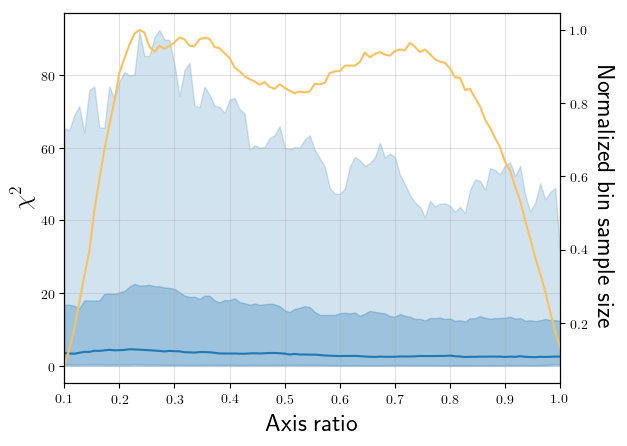

In [191]:
# Different percentiles
#plt.fill_between(bins, arr_chisqs[0], arr_chisqs[-1], alpha=0.15, color='C0')  # 99.8 percent
with plt.style.context(['ggplot', 'default']):
    plt.rc('text', usetex=True)
    plt.rc('axes', labelsize=18)
    plt.fill_between(bins, arr_chisqs[1], arr_chisqs[-2], alpha=0.2, color='C0')  # 95 percent
    plt.fill_between(bins, arr_chisqs[2], arr_chisqs[-3], alpha=0.3, color='C0')  # 68 percent
    plt.plot(bins, arr_chisqs[3])
    plt.xlabel('Axis ratio')
    plt.ylabel(r'$\chi^2$')
    plt.grid(alpha=0.4)
    plt.xlim([0.1, 1])
    ax2 = plt.gca().twinx()
    ax2.plot(bins, arr_nsamp / np.max(arr_nsamp), color='C4')
    ax2.set_ylabel('Normalized bin sample size', rotation=270, va='bottom')
    plt.savefig('plots/paper/axis_ratio_chisq.pdf')

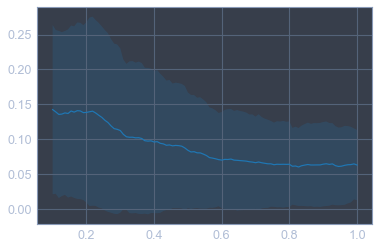

In [127]:
# Avg and std
plt.fill_between(bins, avg_lfs-std_lfs, avg_lfs+std_lfs, alpha=0.2)
plt.plot(bins, avg_lfs)

In [105]:
df_axisratios['avg_AB'].describe()

count    73627.000000
mean         0.405633
std         36.852778
min      -9999.000000
25%          0.336265
50%          0.542718
75%          0.739200
max          0.999997
Name: avg_AB, dtype: float64

## Outliers

In [220]:
lf = np.abs(np.log10(y_test / y_pred))
lf = lf.sort_values(ascending=False)
lf.head()

SDSS_ID
1237662641732059175    1.095674
1237652943694463423    1.070804
1237660764300116207    1.009319
1237662225689804887    0.787707
1237662223553528099    0.766933
dtype: float64

In [224]:
chisq = np.square((y_test - y_pred) / y_test_err)
chisq = chisq.sort_values(ascending=False)
chisq.name = 'chi-sq'
df_chisq = pd.DataFrame({'chi-sq': chisq, 'y_true': y_test.loc[chisq.index], 
              'y_pred': y_pred.loc[chisq.index], 'y_err': y_test_err.loc[chisq.index]})
df_chisq.head(20)

,chi-sq,y_true,y_pred,y_err
SDSS_ID,,,,
1237662641732059175,3675.237993,0.212809,2.652545,0.040244
1237652943694463423,1966.633983,0.116953,1.376630,0.028405
1237662663742783497,1524.169671,0.591004,1.832017,0.031788
1237659145631367193,918.843673,0.506345,2.275965,0.058379
1237674474365780176,873.633961,0.533635,1.626752,0.036983
1237662194525470884,766.364597,0.904630,2.282018,0.049755
1237654948374774024,570.123343,0.877069,3.190643,0.096894
1237664846123106367,439.542616,1.285735,3.187392,0.090705
1237670449986207875,425.852418,0.677013,2.022833,0.065217


(0, 25)

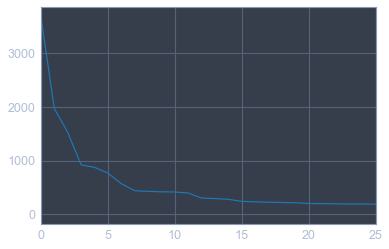

In [229]:
plt.plot(list(range(df_chisq.shape[0])), df_chisq['chi-sq'])
plt.xlim([0, 25])

(0, 100)

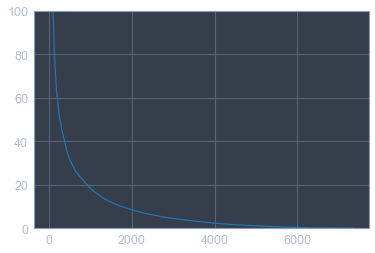

In [231]:
plt.plot(list(range(df_chisq.shape[0])), df_chisq['chi-sq'])
plt.ylim([0, 100])
# plt.xlim([0, 25])

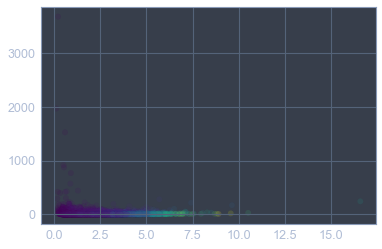

In [226]:
plt.scatter(df_chisq['y_true'], df_chisq['chi-sq'], c=df_chisq['y_err'], alpha=0.15)

In [72]:
y_pred = pd.Series(y_pred, index=y_test.index)

In [73]:
idx = 1237662223553528099

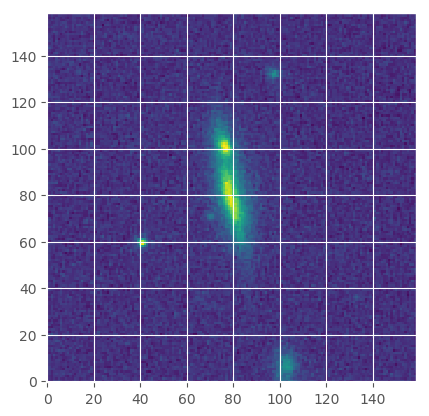

In [74]:
ht.plot_galaxy(idx, ssubtype='raw')

In [65]:
y_pred.loc[idx], y_test.loc[idx]

(0.8574033148109018, 5.393878127964156)

In [63]:
df_metamorph.loc[idx]

RA                          243.65
DEC                        22.1199
D25                       0.524807
redshift                     0.038
GalSize_kpc                24.8618
D_Mpc                      162.857
d_pix_kpc                 0.315821
reduced_chi_square         2.16572
logM_bayes                 10.3231
logM_bayes_err           0.0736448
L_g_bayes              3.90112e+09
L_g_bayes_err          3.73002e+07
hasimg                        True
isgalaxy                      True
M_bayes                2.10421e+10
M_bayes_err            3.56819e+09
ML_bayes                   5.39388
ML_bayes_err              0.914658
mag_g                       17.376
mag_i                       16.002
ML_zibetti                 3.81466
RA_leda                     243.65
DEC_leda                   22.1199
D25_leda                    0.5236
R25_leda                   2.47742
pa_leda                      12.62
id_gz1                      602594
dist_gz1               2.44444e-05
id_gz2              

In [85]:
pd.Series(df_metamorph.index).to_csv('data/splits/full_sample.txt', index=False)

In [77]:
from ipywidgets import interact

def plot_sample(worstnr, use_chisq=True):
    ser = chisq if use_chisq else lf
    idx = ser.index[worstnr]
    ht.plot_galaxy(idx)
    
interact(plot_sample, worstnr=(0, 30), use_chisq=True)

interactive(children=(IntSlider(value=15, description='worstnr', max=30), Checkbox(value=True, description='use_chisq'), Output()), _dom_classes=('widget-interact',))

<function __main__.plot_sample(worstnr, use_chisq=True)>

In [79]:
df_metamorph['D25'].describe()

count    73627.000000
mean         0.550221
std          0.179487
min          0.407380
25%          0.436516
50%          0.489779
75%          0.602560
max         10.964781
Name: D25, dtype: float64

Button(description='Next', style=ButtonStyle())

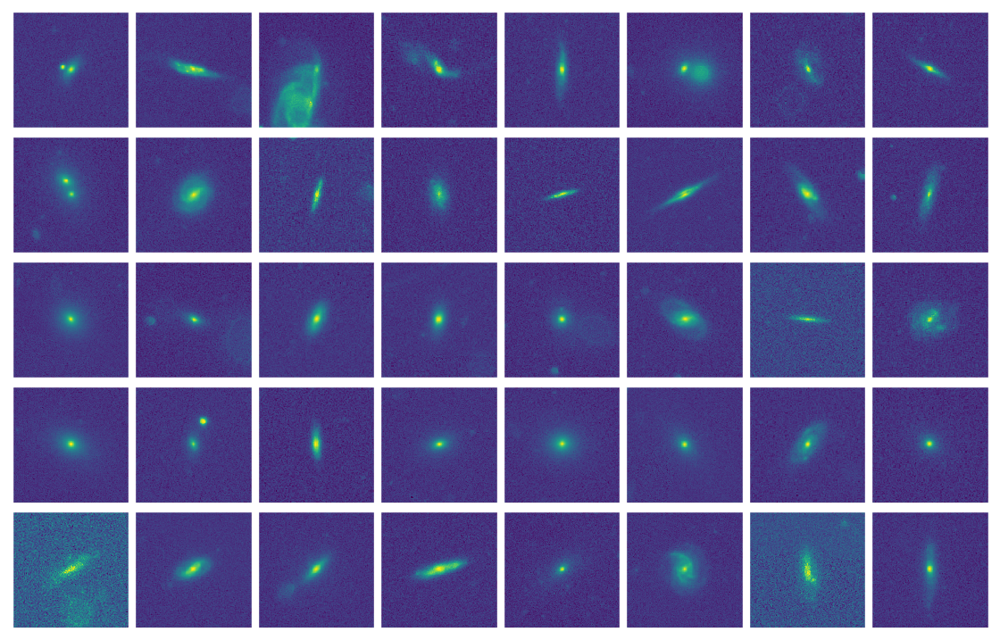

In [89]:
from IPython.display import display, clear_output
from ipywidgets import Button
button = Button(description="Next")
display(button)

nx = 8
ny = 5
extra_offset = 0

def on_button_clicked(b):
    global extra_offset
    extra_offset += nx
    clear_output()
    display(button)
    plot_grid()

button.on_click(on_button_clicked)

def plot_grid():
    f, axarr = plt.subplots(ny, nx, figsize=(11, 7))
    for y in range(ny):
        frac = (y/(ny - 1))
        startid = frac * (len(chisq) - 1)
        s = -1 if frac > 0.5 else 1  # sign (go back or forward?)
        for x in range(nx):
            ax = axarr[y, x]
            sdss_id = chisq.index[int(startid+(s*(x + extra_offset)))]
            img = ht.plot_galaxy(sdss_id, ax=ax)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
    plt.tight_layout(pad=0)
    plt.show()
plot_grid()

In [86]:
b_underest = y_test > y_pred
b_underest.name = 'underestimate'
pd.concat([chisq, b_underest], axis=1).sort_values('chi-sq', ascending=False)

,chi-sq,underestimate
SDSS_ID,,
1237662641732059175,3.564425e+03,False
1237652943694463423,2.056015e+03,False
1237662663742783497,1.393494e+03,False
1237674474365780176,1.023629e+03,False
1237659145631367193,9.446509e+02,False
1237662194525470884,8.915728e+02,False
1237665441514061916,4.959206e+02,False
1237670449986207875,4.930303e+02,False
1237654948374774024,4.686765e+02,False


## Correlation after retraining CNN 4

In [238]:
df_features.head()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,...,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,0.044273,0.039052,0.021237,0.010907,0.039915,0.000000,0.000000,...,0.0,0.0,0.000000,0.419165,0.0,0.043426,0.000000,0.000000,0.0,0.026036,0.085248,0.017091,0.0,0.001851,0.000000,0.373822,0.040094,0.000000,0.434619,0.000000,0.0,0.127402,0.000000,0.000000,0.000000,0.0,0.000000,0.043323,0.036078,0.285451,0.0,0.054541,0.000000,0.0,0.305673,0.0,0.000000,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,0.1213,1.008135
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,0.057638,0.014038,0.000000,0.002556,0.010689,0.006664,0.005807,...,0.0,0.0,0.019311,0.102425,0.0,0.270107,0.000000,0.040571,0.0,0.000000,0.011425,0.037226,0.0,0.116023,0.053348,0.250478,0.242314,0.024494,0.104177,0.000000,0.0,0.198361,0.0

In [240]:
diff_feats = np.unique(list(map(lambda x: x.split('.')[0], df_features.columns)))
diff_feats

array(['custom_scauto_69_gz2', 'd_pix_kpc', 'post', 'pre',
       'r50_scauto_197_gz2', 'r50_scauto_197_pretrained', 'redshift',
       'xcep_scauto_128_gz2'], dtype='<U25')

In [243]:
list(filter(lambda x: cnn4 in x, df_features.columns))

['r50_scauto_197_pretrained.0.notop',
 'r50_scauto_197_pretrained.1.notop',
 'r50_scauto_197_pretrained.2.notop',
 'r50_scauto_197_pretrained.3.notop',
 'r50_scauto_197_pretrained.4.notop',
 'r50_scauto_197_pretrained.5.notop',
 'r50_scauto_197_pretrained.6.notop',
 'r50_scauto_197_pretrained.7.notop',
 'r50_scauto_197_pretrained.8.notop',
 'r50_scauto_197_pretrained.9.notop',
 'r50_scauto_197_pretrained.10.notop',
 'r50_scauto_197_pretrained.11.notop',
 'r50_scauto_197_pretrained.12.notop',
 'r50_scauto_197_pretrained.13.notop',
 'r50_scauto_197_pretrained.14.notop',
 'r50_scauto_197_pretrained.15.notop',
 'r50_scauto_197_pretrained.16.notop',
 'r50_scauto_197_pretrained.17.notop',
 'r50_scauto_197_pretrained.18.notop',
 'r50_scauto_197_pretrained.19.notop',
 'r50_scauto_197_pretrained.20.notop',
 'r50_scauto_197_pretrained.21.notop',
 'r50_scauto_197_pretrained.22.notop',
 'r50_scauto_197_pretrained.23.notop',
 'r50_scauto_197_pretrained.24.notop',
 'r50_scauto_197_pretrained.25.noto

Text(0,0.5,'M/L')

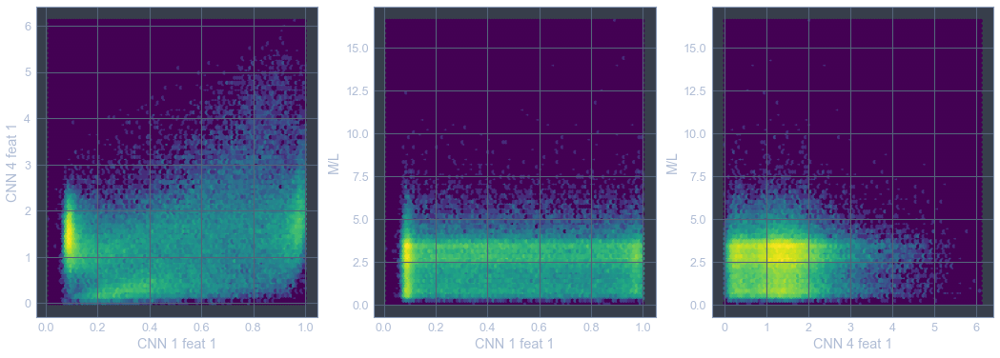

In [266]:
%autoreload
from customplots import plot_hexbin
feat = '1'
cnn1 = 'r50_scauto_197_gz2'
cnn4 = 'r50_scauto_197_pretrained'
x = df_features[cnn1 + '.' + feat]
y = df_features[cnn4 + '.' + feat + '.notop']
ml = df_metamorph['ML_bayes']
f, axarr = plt.subplots(ncols=3, figsize=(18, 6))
axarr[0].hexbin(x, y, bins='log')
axarr[0].set_xlabel('CNN 1 feat ' + feat)
axarr[0].set_ylabel('CNN 4 feat ' + feat)
axarr[1].hexbin(x, ml, bins='log')
axarr[1].set_xlabel('CNN 1 feat ' + feat)
axarr[1].set_ylabel('M/L')
axarr[2].hexbin(y, ml, bins='log')
axarr[2].set_xlabel('CNN 4 feat ' + feat)
axarr[2].set_ylabel('M/L')

## What parameter correlates with uncertainty?

In [170]:
# perc 0.84 = 1 sigma for gauss
chisq = np.square((y_test - y_pred) / y_test_err)
chi = (y_pred - y_test) / y_test_err

def binned_percentile(param, perc='1sigma', return_bins=False, min_samples_bin=150,
                      binw_frac=0.08, nbins=100):
    # Create arrays
    arr_param = df_metamorph.loc[idx_test, param]
    pmax, pmin = arr_param.max(), arr_param.min()
    bins = np.linspace(pmin, pmax, nbins)
    arr_chisq = np.zeros_like(bins)
    try:
        binw = (pmax - pmin) * binw_frac
    except TypeError as e:
        print(f'Weird pmax and pmin for param {param}')
        print('pmax', pmax)
        print('pmin', pmin)
    # Loop over bins
    for i, bin_c in enumerate(bins):
        binw_cur = binw
        idx = (arr_param > (bin_c - binw_cur)) & (arr_param <= (bin_c + binw_cur))
        j = 0
        while np.sum(idx) < min_samples_bin:
            binw_cur *= 1.5
            idx = (arr_param > (bin_c - binw_cur)) & (arr_param <= (bin_c + binw_cur))
            j += 1
            if j == 100:
                print(f'{param} not converged after 100 iterations for bin center {bin_c} '
                      f'(bin {i})')
                break
        if perc == '1sigma':
            chisq_perc = np.mean(chisq[idx]) + np.std(chisq[idx])
        else:
            chisq_perc = np.percentile(chisq[idx], 100*perc)
        arr_chisq[i] = chisq_perc
    if return_bins:
        return bins, arr_chisq
    return arr_chisq

def chisq_ratio(param, **kwargs):
    '''Highest chisq / lowest chisq, varying over that param (fixed bin percentage)'''
    
    arr_chisq = binned_percentile(param, **kwargs)
    return arr_chisq.max() / arr_chisq.min()

In [108]:
df_metamorph.loc[:, 'avg_AB'] = df_axisratios.loc[df_metamorph.index, 'avg_AB'].copy()

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:537: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


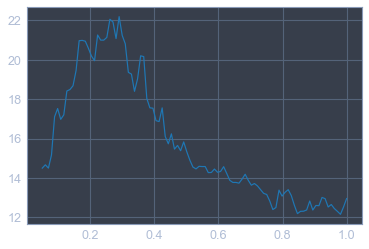

In [129]:
bins = np.linspace(0.05, 1, 100)
arr_ab = binned_percentile('avg_AB')
plt.plot(bins, arr_ab)

In [177]:
d_types = {df_metamorph.columns[i]: df_metamorph.dtypes[i] 
           for i in range(len(df_metamorph.columns))}
cols = list(filter(lambda x: d_types[x] == np.float64, df_metamorph.columns))
s_chisq_ratios = [chisq_ratio(col, perc=0.84, min_samples_bin=500)
                  for col in log_progress(cols)]
s_chisq_ratios = pd.Series(s_chisq_ratios, index=cols)
s_chisq_ratios

VBox(children=(HTML(value=''), IntProgress(value=0, max=302)))

RA                     1.340008
DEC                    1.503198
D25                    1.447590
redshift               3.195570
GalSize_kpc            2.664974
D_Mpc                  3.195570
d_pix_kpc              3.195570
reduced_chi_square     1.770964
logM_bayes             3.139573
logM_bayes_err         1.405866
L_g_bayes              2.107581
L_g_bayes_err          1.956966
M_bayes                2.095042
M_bayes_err            2.588948
ML_bayes               2.058690
ML_bayes_err           2.156991
mag_g                  1.245504
mag_i                  1.421000
ML_zibetti             2.058156
RA_leda                1.340008
DEC_leda               1.503198
D25_leda               1.468858
R25_leda               1.572425
pa_leda                1.309731
dist_gz1               1.001650
dist_gz2               1.071259
P_EL                   1.999013
P_CW                   1.288644
P_ACW                  1.420111
P_EDGE                 1.534120
                         ...   
t05_a12_

In [181]:
s_chisq_ratios.sort_values(ascending=False).head(10)

d_pix_kpc                               3.195570
redshift                                3.195570
D_Mpc                                   3.195570
logM_bayes                              3.139573
GalSize_kpc                             2.664974
M_bayes_err                             2.588948
t09_bulge_shape_a25_rounded_debiased    2.326993
P_CS_DEBIASED                           2.158290
ML_bayes_err                            2.156991
t02_a04_cum_debias                      2.151085
dtype: float64

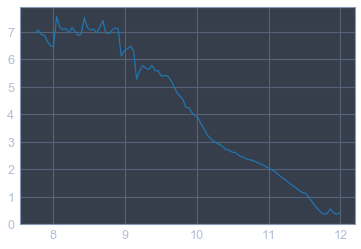

In [159]:
bins, arr_p = binned_percentile('logM_bayes', perc='1sigma', return_bins=True,
                                min_samples_bin=300)
plt.plot(bins, arr_p)

In [190]:
df_metamorph['GalSize_pix'] = df_metamorph['GalSize_kpc'] / df_metamorph['d_pix_kpc']

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


In [196]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,GalSize_pix
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.502520,0.199998,76.929204
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.176818,0.340460,67.002535
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.990084,0.811851,94.643604
1237662500543987

Text(0,0.5,'chisq')

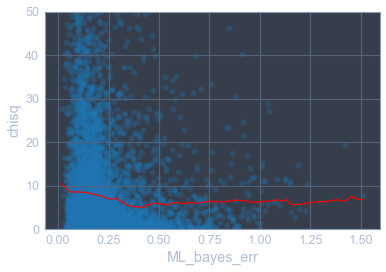

In [211]:
col = 'ML_bayes_err'
bins, arr_p = binned_percentile(col, perc=0.7, return_bins=True,
                                min_samples_bin=300)
plt.scatter(df_metamorph.loc[idx_test, col], chisq.loc[idx_test], alpha=0.3)
plt.plot(bins, arr_p, 'r')
plt.ylim([0, 50])
plt.xlabel(col)
plt.ylabel('chisq')

## Best and worst per bin of M/L

In [26]:
df_metamorph.loc[idx_test, 'ML_bayes'].describe()

count    7363.000000
mean        2.617712
std         1.228615
min         0.116953
25%         1.713455
50%         2.717024
75%         3.405722
max        16.591119
Name: ML_bayes, dtype: float64

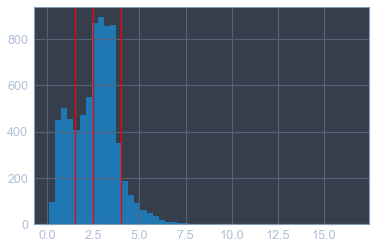

In [43]:
df_metamorph.loc[idx_test, 'ML_bayes'].hist(bins=50)
plt.axvline(x=1.5, color='r')
plt.axvline(x=2.5, color='r')
plt.axvline(x=4, color='r')

In [44]:
chisq = np.square((y_pred - y_test) / y_test_err)

In [47]:
chisq.sort_values(ascending=False)

SDSS_ID
1237662641732059175    3.564425e+03
1237652943694463423    2.056015e+03
1237662663742783497    1.393494e+03
1237674474365780176    1.023629e+03
1237659145631367193    9.446509e+02
1237662194525470884    8.915728e+02
1237665441514061916    4.959206e+02
1237670449986207875    4.930303e+02
1237654948374774024    4.686765e+02
1237664846123106367    4.161832e+02
1237667255624335412    3.956751e+02
1237664852037599488    3.748130e+02
1237661138493374589    3.165574e+02
1237662225689804887    2.798970e+02
1237663237124718740    2.573812e+02
1237663783663108378    2.442648e+02
1237665024373883026    2.297875e+02
1237655369286090795    2.245731e+02
1237662474234626448    2.225531e+02
1237660764300116207    2.185450e+02
1237673809193992352    2.020937e+02
1237667911124385842    1.942291e+02
1237660669820403728    1.880829e+02
1237672796109733939    1.869198e+02
1237656567585833097    1.792723e+02
1237655126624764150    1.778309e+02
1237659326029824332    1.768506e+02
1237661971192676512 

In [62]:
nbad = 3
splits = [0, 1.5, 2.5, 4, 20]
nsplit = len(splits) - 1
chisq = np.square((y_pred - y_test) / y_test_err)
arr_ml = df_metamorph.loc[idx_test, 'ML_bayes']
arr_sdssid = np.empty((nsplit, nbad*2), dtype=np.uint64)
for i in range(nsplit):
    ml_min, ml_max = splits[i], splits[i+1]
    idx = (arr_ml > ml_min) & (arr_ml <= ml_max)
    chisq_sub = chisq[idx].sort_values(ascending=False)
    for j in range(nbad):
        arr_sdssid[i, j] = chisq_sub.index[j]
        arr_sdssid[i, -(j+1)] = chisq_sub.index[-(j+1)]

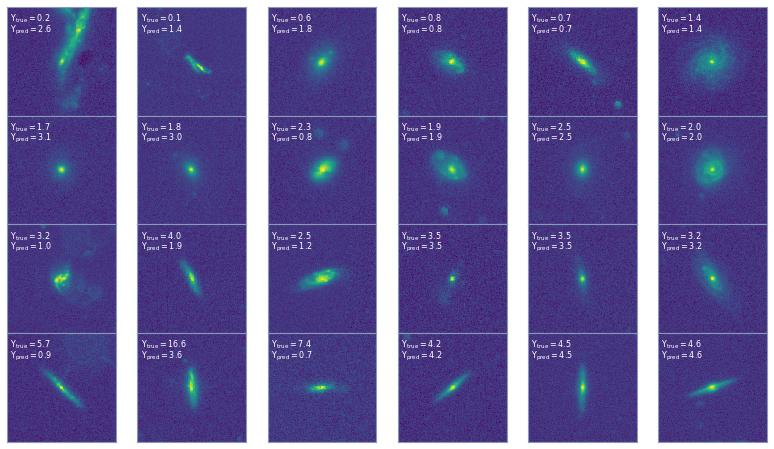

In [101]:
f, axarr = plt.subplots(nrows=nsplit, ncols=nbad*2, figsize=(14, 8), 
                        gridspec_kw={'wspace': 0, 'hspace': 0})
for i in range(nsplit):
    for j in range(nbad*2):
        sdssid = arr_sdssid[i, j]
        ax = axarr[i, j]
        ht.plot_galaxy(sdssid, ax=ax)
        ax.text(0.03, 0.95, r'$\Upsilon_{\mathrm{true}} = '+f'{y_test.loc[sdssid]:.1f}$',
                verticalalignment='top', horizontalalignment='left',
                transform=ax.transAxes,
                color='w', fontsize=8)
        ax.text(0.03, 0.85, r'$\Upsilon_{\mathrm{pred}} = '+f'{y_pred.loc[sdssid]:.1f}$',
                verticalalignment='top', horizontalalignment='left',
                transform=ax.transAxes,
                color='w', fontsize=8)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

## True vs pred galaxy

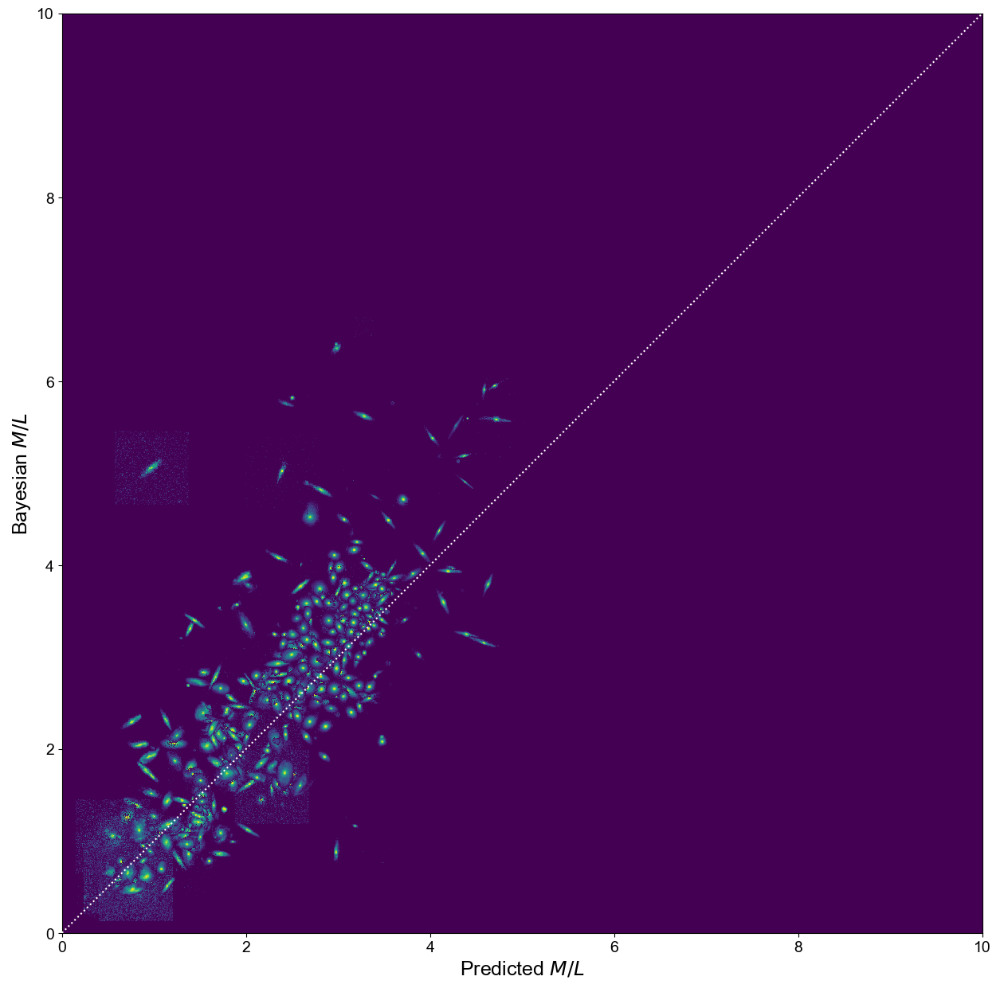

In [151]:
xmin, xmax = 0, 10
maxgal = 100
with plt.style.context(['ggplot', 'default']):
    f, ax = plt.subplots(figsize=(15, 15))
    plt.imshow(np.zeros((30, 30)), extent=[xmin, xmax, xmin, xmax], zorder=-5)
    plt.xlim([xmin, xmax])
    plt.ylim([xmin, xmax])
    plt.plot([xmin, xmax], [xmin, xmax], 'w:', zorder=5)
    plt.xlabel(r'Predicted $M/L$', fontsize=18)
    plt.ylabel(r'Bayesian $M/L$', fontsize=18)
    ax.tick_params(labelsize=14)

    def plot_galaxy(sdss_id, ax, tresh=0.3, w=0.4, h=0.4):
        img = ht.get_galaxydata(sdss_id)
        img = hp.scale_image(img, ellipse_mode='none')
        img[img < tresh] = tresh
        xno, yno = np.where(img <= tresh)
        img = (img - tresh) / (1 - tresh)
        imgrgb = plt.cm.viridis(img)
        for (x, y) in zip(xno, yno):
            imgrgb[x, y, -1] = 0        
        yt, yp = y_test.loc[sdss_id], y_pred.loc[sdss_id]

        ax.imshow(imgrgb, extent=[yp-w, yp+w, yt-w, yt+w], origin='lower')
    for sdss_id in idx_test[:400]:
        plot_galaxy(sdss_id, ax)
    plt.savefig('plots/lgbm/truevspred_images.pdf', dpi=150)

In [122]:
img = ht.get_galaxydata(1237662641732059175)
img = hp.scale_image(img, ellipse_mode='none')
img.max(), img.min()

(1.0, 0.0)

## M/L range

In [10]:
df_full.shape

(84722, 25)

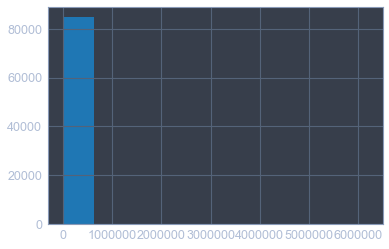

In [12]:
df_full['ML_g'].hist()

In [16]:
df_full['ML_g'].sort_values().head()

SDSS_ID
1237648705129283884     0.000000e+00
1237648703514804436     0.000000e+00
1237665331460309076    5.397903e-113
1237652899697983542    3.559423e-112
1237661850933264390    5.595432e-112
Name: ML_g, dtype: float64

In [17]:
df_full['ML_g'].sort_values(ascending=False).head()

SDSS_ID
1237661852008185915    6.191119e+06
1237648721784143987    1.187010e+06
1237651191363731488    3.037200e+05
1237668336861511907    2.037278e+05
1237663543680106584    1.444722e+05
Name: ML_g, dtype: float64

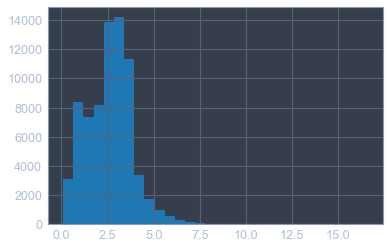

In [21]:
df_metamorph['ML_bayes'].hist(bins=30)

## Baseline (avg prediction)

In [36]:
from scipy.optimize import minimize

def base_chisq(y_mean):
    return np.mean(np.square((y_mean - y_tr) / y_tr_err))

res = minimize(base_chisq, 2.5)

In [37]:
res

      fun: 65.39631890937959
 hess_inv: array([[0.00886178]])
      jac: array([-5.7220459e-06])
  message: 'Optimization terminated successfully.'
     nfev: 21
      nit: 3
     njev: 7
   status: 0
  success: True
        x: array([1.62489306])

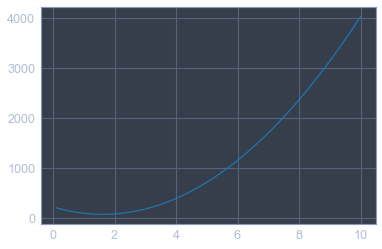

In [39]:
x = np.linspace(0.1, 10, 50)
y = np.array([base_chisq(xi) for xi in x])
plt.plot(x, y)

In [40]:
base_test = np.mean(np.square((res.x - y_test) / y_test_err))
print('baseline test chisq', base_test)

baseline test chisq 68.55843440573035


## Gbm without distance features

In [53]:
arr_chisq = np.square((y_pred - y_test) / y_test_err)
arr_lf = np.log10(y_pred / y_test)
z_test = df_metamorph.loc[idx_test, 'redshift']

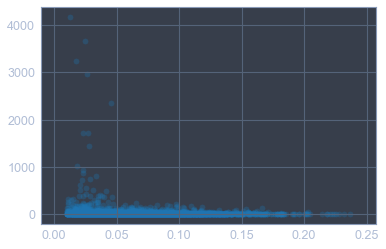

In [48]:
plt.scatter(z_test, arr_chisq, alpha=0.3)

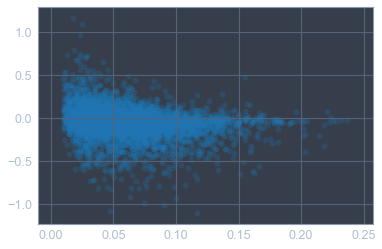

In [54]:
plt.scatter(z_test, arr_lf, alpha=0.25)

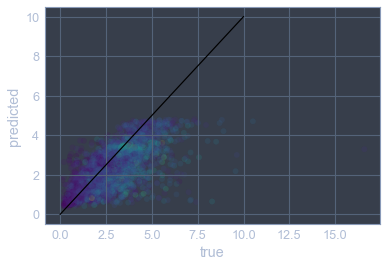

In [52]:
plt.scatter(y_test, y_pred, c=z_test, alpha=0.2)
plt.plot([0, 10], [0, 10], 'k')
plt.xlabel('true')
plt.ylabel('predicted');

## M/L histograms

In [7]:
ml_70 = df_metamorph.loc[:, 'ML_bayes']
ml_80 = df_full.loc[:, 'ML_bayes']
idx_80n70 = ml_80.index.difference(ml_70.index)
print(ml_70.index.shape, ml_80.index.shape, idx_80n70.shape)

(73627,) (84720,) (11093,)


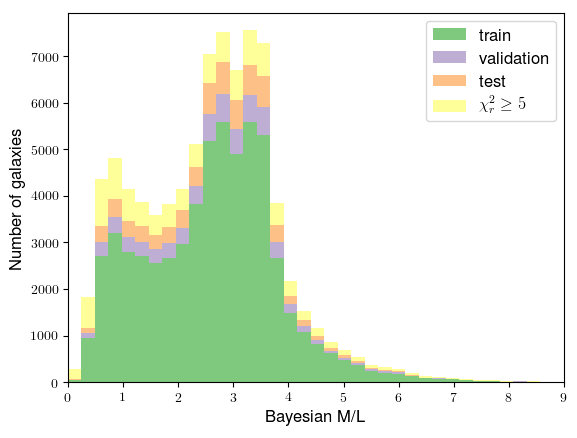

In [21]:
bins = np.linspace(0, 12, 50)
with plt.style.context(['ggplot', 'default']):
    plt.rc('text', usetex=True)
    plt.hist([ml_70.loc[idx_tr], ml_70.loc[idx_val], ml_70.loc[idx_test], ml_80.loc[idx_80n70]],
             bins=bins, histtype='barstacked',
             label=['train', 'validation', 'test', '$\chi_r^2 \ge 5$'],
             color=['#7fc97f', '#beaed4', '#fdc086', '#ffff99']);
    plt.xlabel('Bayesian M/L', fontsize=12)
    plt.ylabel('Number of galaxies', fontsize=12)
    plt.xlim(0, 9)
    plt.legend(fontsize=12)
    plt.savefig('plots/metadata/ml_hist.pdf', bbox_inches='tight')

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:52: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


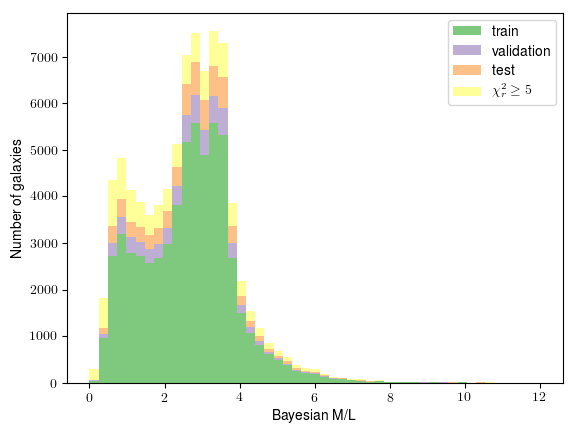

In [26]:
bins = np.linspace(0, 12, 50)
with plt.style.context(['ggplot', 'default']):
    plt.rc('text', usetex=True)
    plt.hist([ml_70.loc[idx_tr], ml_70.loc[idx_val], ml_70.loc[idx_test], ml_80.loc[idx_80n70]],
             bins=bins, histtype='barstacked',
             label=['train', 'validation', 'test', '$\chi_r^2 \ge 5$'],
             color=['#7fc97f', '#beaed4', '#fdc086', '#ffff99']);
    plt.xlabel('Bayesian M/L')
    plt.ylabel('Number of galaxies')
    plt.legend()
#     plt.savefig('plots/metadata/ml_hist.pdf')

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:52: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


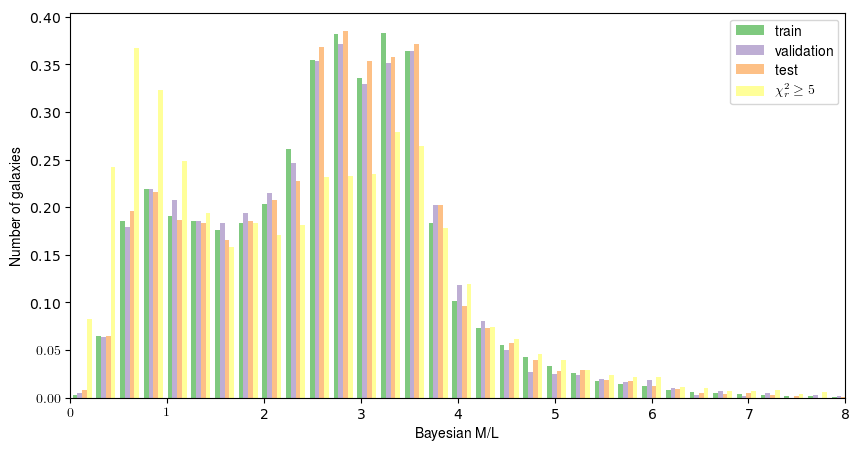

In [49]:
bins = np.linspace(0, 12, 50)
with plt.style.context(['ggplot', 'default']):
    plt.rc('text', usetex=True)
    plt.figure(figsize=(10,5))
    plt.hist([ml_70.loc[idx_tr], ml_70.loc[idx_val], ml_70.loc[idx_test], ml_80.loc[idx_80n70]],
             bins=bins, histtype='bar',
             label=['train', 'validation', 'test', '$\chi_r^2 \ge 5$'],
             color=['#7fc97f', '#beaed4', '#fdc086', '#ffff99'],
             density=True);
    plt.xlabel('Bayesian M/L')
    plt.ylabel('Number of galaxies')
    plt.xlim([0, 8])
    plt.legend()

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:52: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  return getattr(obj, method)(*args, **kwds)


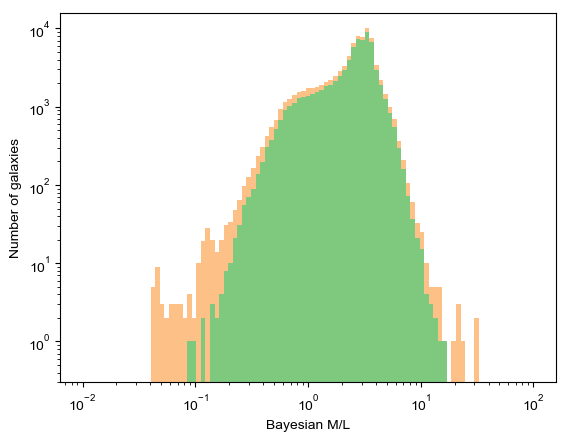

In [33]:
bins = np.logspace(-2, 2, 100)
with plt.style.context(['ggplot', 'default']):
    plt.hist([ml_70, ml_80.loc[idx_80n70]], bins=bins, histtype='barstacked',
             label=[r'$\chi_r^2 < 5$', '$\chi_r^2 \ge 5$'],
             color=['#7fc97f', '#fdc086']);
    plt.xscale('log')
    plt.yscale('log', nonposy='clip')
    plt.ylim(ymin=0.3)
    plt.xlabel('Bayesian M/L')
    plt.ylabel('Number of galaxies')
#     plt.savefig('plots/metadata/ml_hist_loglog.pdf')

In [32]:
ml_70[ml_70 < 0.1]

SDSS_ID
1237661972269891740    0.097912
1237658493337796865    0.090731
Name: ML_bayes, dtype: float64

In [45]:
def ntresh(tresh):
    if tresh < 1:  # all below tresh
        n_ori = ml_80[ml_80 < tresh].shape[0]
        n_cut = ml_70[ml_70 < tresh].shape[0]
        print(f'M/L below {tresh}: original sample: {n_ori}, cutted sample: {n_cut} ')
    else:
        n_ori = ml_80[ml_80 > tresh].shape[0]
        n_cut = ml_70[ml_70 > tresh].shape[0]
        print(f'M/L above {tresh}: original sample: {n_ori}, cutted sample: {n_cut}')
ntresh(0.1)
ntresh(0.2)
ntresh(10)
ntresh(15)

M/L below 0.1: original sample: 36, cutted sample: 2 
M/L below 0.2: original sample: 182, cutted sample: 22 
M/L above 10: original sample: 50, cutted sample: 20
M/L above 15: original sample: 8, cutted sample: 1


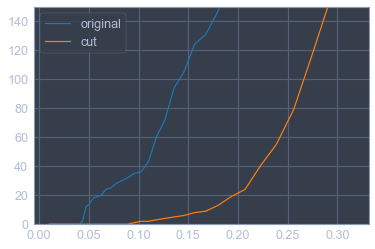

In [41]:
x = np.logspace(-2, -0.5, 50)
y_ori = np.array([ml_80[ml_80 < tresh].shape[0] for tresh in x])
y_cut = np.array([ml_70[ml_70 < tresh].shape[0] for tresh in x])
plt.plot(x, y_ori, label='original')
plt.plot(x, y_cut, label='cut')
plt.ylim([0, 150])
plt.legend()

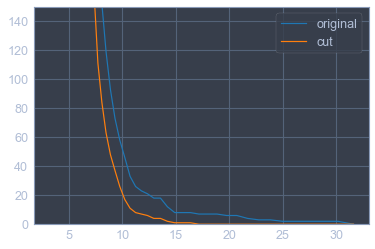

In [43]:
x = np.logspace(0.5, 1.5, 50)
y_ori = np.array([ml_80[ml_80 > tresh].shape[0] for tresh in x])
y_cut = np.array([ml_70[ml_70 > tresh].shape[0] for tresh in x])
plt.plot(x, y_ori, label='original')
plt.plot(x, y_cut, label='cut')
plt.ylim([0, 150])
plt.legend()

In [118]:
pd.concat([ml_70, ml_80], axis=1).describe()

,ML_bayes,ML_bayes
count,73627.000000,84720.000000
mean,2.613726,2.582680
std,1.219339,1.290475
min,0.090731,0.043739
25%,1.707687,1.601813
50%,2.702643,2.673637
75%,3.393876,3.392266
max,16.591119,30.817687


## Zibetti original vs refit

In [125]:
np.where(np.isnan(gi))

(array([54987]),)

In [130]:
-1.8968 / -2.5

0.7587200000000001

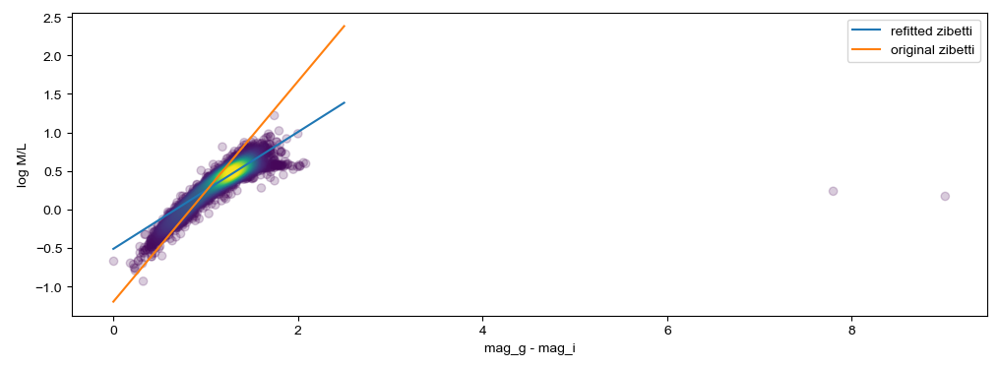

In [134]:
from usefulfuncs import estimate_density

with plt.style.context(['ggplot', 'default']):
    gi = df_metamorph.loc[idx_test, 'modelMag_g'] - df_metamorph.loc[idx_test, 'modelMag_i']
    gi.dropna(inplace=True)
    logML = np.log10(df_metamorph.loc[gi.index, 'ML_bayes'])
    x, y, c = estimate_density(gi, logML)
    plt.subplots(figsize=(12, 4))
    plt.scatter(x, y, c=c, alpha=0.2)
    xi = np.linspace(0, 2.5, 5)
    logml_refit = 0.75872 * xi - 0.511069
    logml_zib = 1.431 * xi - 1.197
    plt.plot(xi, logml_refit, label='refitted zibetti')
    plt.plot(xi, logml_zib, label='original zibetti')
    plt.legend()
    plt.xlabel('mag_g - mag_i')
    plt.ylabel('log M/L')
    plt.savefig('plots/zibetti/fit_zib_test.png')

## Significant difference between morph + gi vs gi?

In [383]:
# Run after import gimorph model
y_pred_gimorph = y_pred.copy()

In [73]:
# Run after training gi model
y_pred_gi = y_pred.copy()

In [384]:
chisq_gi = np.square((y_pred_gi - y_test) / y_test_err)
chisq_gimorph = np.square((y_pred_gimorph - y_test) / y_test_err)

In [385]:
# Save so we don't have to do the gbm training again...
import pickle
pickle.dump(y_pred_gimorph, open('data/pickle/y_pred_gimorph.pkl', 'wb'))
pickle.dump(y_pred_gi, open('data/pickle/y_pred_gi.pkl', 'wb'))

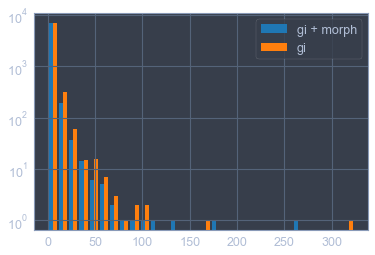

In [386]:
plt.hist([chisq_gimorph, chisq_gi], bins=30, label=['gi + morph', 'gi'])
plt.yscale('log', nonposy='clip')
plt.legend()

In [387]:
chisq_gimorph.describe()

count    7.363000e+03
mean     2.307111e+00
std      6.314418e+00
min      1.956148e-08
25%      1.544301e-01
50%      7.430776e-01
75%      2.364839e+00
max      2.629039e+02
dtype: float64

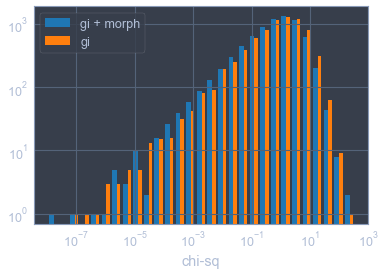

In [388]:
bins = np.logspace(-8, 2.5, 30)
plt.hist([chisq_gimorph, chisq_gi], bins=bins, label=['gi + morph', 'gi'])
plt.yscale('log', nonposy='clip')
plt.xscale('log')
plt.xlabel('chi-sq')
plt.legend()
plt.savefig('plots/other/chisq_distribution.pdf')

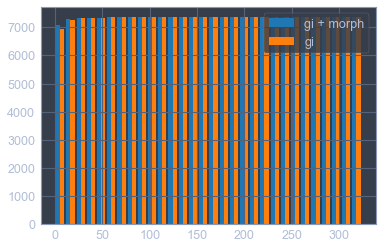

In [389]:
plt.hist([chisq_gimorph, chisq_gi], bins=30, label=['gi + morph', 'gi'], cumulative=True)
plt.legend()

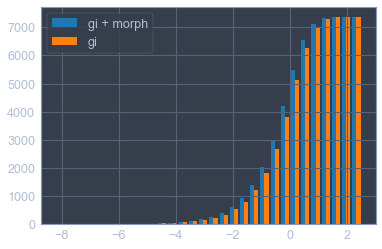

In [390]:
plt.hist([np.log10(chisq_gimorph), np.log10(chisq_gi)], bins=30, label=['gi + morph', 'gi'], cumulative=True)
plt.legend()

In [391]:
from scipy import stats

print('standard ks', stats.ks_2samp(chisq_gi.values, chisq_gimorph.values))
print('log ks', stats.ks_2samp(np.log10(chisq_gi.values), np.log10(chisq_gimorph.values)))
print('standard ad', stats.anderson_ksamp([chisq_gi.values, chisq_gimorph.values]))
print('log ad', stats.anderson_ksamp([np.log10(chisq_gi.values), np.log10(chisq_gimorph.values)]))

standard ks Ks_2sampResult(statistic=0.055683824528045656, pvalue=2.218583084736331e-10)
log ks Ks_2sampResult(statistic=0.055683824528045656, pvalue=2.218583084736331e-10)
standard ad Anderson_ksampResult(statistic=37.13125526684829, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.00818752466286169)
log ad Anderson_ksampResult(statistic=37.13125526684829, critical_values=array([0.325, 1.226, 1.961, 2.718, 3.752]), significance_level=0.00818752466286169)


In [392]:
z_gimorph = chisq_gimorph.sort_values()
c_gimorph = np.array(range(len(z_gimorph))).astype(float)
c_gimorph /= c_gimorph[-1]
c_gimorph

array([0.00000000e+00, 1.35832654e-04, 2.71665308e-04, ...,
       9.99728335e-01, 9.99864167e-01, 1.00000000e+00])

In [393]:
z_gi = chisq_gi.sort_values()
c_gi = np.array(range(len(z_gi))).astype(float)
c_gi /= c_gi[-1]
c_gi

array([0.00000000e+00, 1.35832654e-04, 2.71665308e-04, ...,
       9.99728335e-01, 9.99864167e-01, 1.00000000e+00])

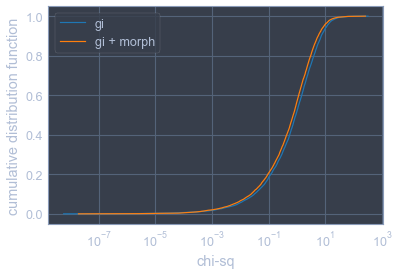

In [394]:
plt.plot(z_gi, c_gi, label='gi')
plt.plot(z_gimorph, c_gimorph, label='gi + morph')
plt.xscale('log')
plt.xlabel('chi-sq')
plt.ylabel('cumulative distribution function')
plt.legend()
plt.savefig('plots/other/chisq_cdf.pdf')

In [235]:
# Bootstrapped p-value estimates
from sklearn.utils import resample
import warnings
warnings.filterwarnings("ignore")

n = 10000
ks_p = np.zeros(n)
ad_p = np.zeros(n)
for i in range(n):
    r_gi = resample(chisq_gi.values)
    r_gimorph = resample(chisq_gimorph.values)
    ks_p[i] = stats.ks_2samp(r_gi, r_gimorph)[1]
    ad_p[i] = stats.anderson_ksamp([r_gi, r_gimorph])[2]

In [194]:
y_gi_uniq, y_gi_counts = np.unique(y_pred_gi.values, return_counts=True)

In [197]:
y_gi_counts.argmax()

3324

In [237]:
print('median ks p-value', np.mean(ks_p))
print('median ad p-value', np.mean(ad_p))

median ks p-value 9.117840822617614e-06
median ad p-value 3.341921471193651e+22


## One sided KS (R)

In [915]:
import sys
!conda install -c r --yes --prefix={sys.prefix} r

Solving environment: - 
  - anaconda::ca-certificates-2018.03.07-0, anaconda::certifi-2018.10.15-py36_0, anaconda::openssl-1.0.2p-h1de35cc_0
  - anaconda::ca-certificates-2018.03.07-0, anaconda::openssl-1.0.2p-h1de35cc_0, defaults::certifi-2018.10.15-py36_0
  - anaconda::certifi-2018.10.15-py36_0, anaconda::openssl-1.0.2p-h1de35cc_0, defaults::ca-certificates-2018.03.07-0
  - anaconda::openssl-1.0.2p-h1de35cc_0, defaults::ca-certificates-2018.03.07-0, defaults::certifi-2018.10.15-py36_0
  - anaconda::certifi-2018.10.15-py36_0, defaults::ca-certificates-2018.03.07-0, defaults::openssl-1.0.2p-h1de35cc_0
  - defaults::ca-certificates-2018.03.07-0, defaults::certifi-2018.10.15-py36_0, defaults::openssl-1.0.2p-h1de35cc_0
  - anaconda::ca-certificates-2018.03.07-0, anaconda::certifi-2018.10.15-py36_0, defaults::openssl-1.0.2p-h1de35cc_0
  - anaconda::ca-certificates-2018.03.07-0, defaults::certifi-2018.10.15-py36_0, defaults::openssl-1.0.2p-h1de35ccdone

## Package Plan ##

  environment loc

In [920]:
%autoreload
import rpy2.rinterface

RuntimeError: The R home directory could not be determined.

    Try to install R <https://www.r-project.org/>,
    set the R_HOME environment variable to the R home directory, or
    add the directory of the R interpreter to the PATH environment variable.
    

In [914]:
%load_ext rpy2.ipython

RuntimeError: The R home directory could not be determined.

    Try to install R <https://www.r-project.org/>,
    set the R_HOME environment variable to the R home directory, or
    add the directory of the R interpreter to the PATH environment variable.
    

In [897]:
chi_gimorph = (np.abs(y_pred - y_test) / y_err).copy().values

In [905]:
chi_gi = (np.abs(y_pred - y_test) / y_err).copy().values

In [921]:
df_exp = pd.DataFrame({'chi_gimorph': chi_gimorph, 'chi_gi': chi_gi})
print(df_exp.shape)
df_exp.head()

(7363, 2)


,chi_gimorph,chi_gi
0,0.391407,0.056028
1,0.613257,0.602438
2,0.504402,0.299411
3,0.263500,0.831398
4,1.027430,1.045864


In [922]:
df_exp.to_csv('data/export/df_chi.csv', index=False)

In [399]:
%%R -i chi_gi -i chi_gimorph
htest = ks.test(chi_gimorph, chi_gi, alternative='greater')
print(htest)
print(htest$p.value)


	Two-sample Kolmogorov-Smirnov test

data:  achisq_gimorph and achisq_gi
D^+ = 0.055684, p-value = 1.216e-10
alternative hypothesis: the CDF of x lies above that of y

[1] 1.215898e-10


In [267]:
chisq_gi.shape

(7363,)

In [258]:
%%R -i achisq_gi -i achisq_gimorph -o ks_p

n = 100
ks_p = rep(0, n)

for (i in 1:n) {
    rchisq_gi = sample(achisq_gi)
    rchisq_gimorph = sample(achisq_gimorph)
    ks_p[i] = ks.test(rchisq_gimorph, rchisq_gi, alternative='greater')$p.value
}
print(ks_p)

  [1] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
  [6] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [11] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [16] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [21] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [26] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [31] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [36] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [41] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [46] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [51] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [56] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [61] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [66] 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09 1.319499e-09
 [71] 

## Bootstrap

In [925]:
from sklearn.utils import resample
n = 100000
arr_gi = np.zeros(n)
arr_gimorph = np.zeros(n)
for i in range(n):
    arr_gi[i] = resample(chi_gi).mean()
    arr_gimorph[i] = resample(chi_gimorph).mean()

gi 1.258 +- 0.013
gi+morph 1.121 +- 0.012


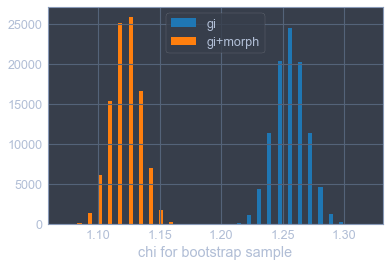

In [927]:
plt.hist([arr_gi, arr_gimorph], bins=30, label=['gi', 'gi+morph'])
plt.legend()
plt.xlabel('chi for bootstrap sample')
print(f'gi {np.mean(arr_gi):.3f} +- {np.std(arr_gi):.3f}')
print(f'gi+morph {np.mean(arr_gimorph):.3f} +- {np.std(arr_gimorph):.3f}')
plt.savefig('plots/other/chisq-bootstrap.pdf')

## Performance on 4 morpho categories

In [968]:
y_pred_gi = y_pred.copy()

In [981]:
y_pred_gimorph = y_pred.copy()

In [992]:
idx_edge = df_features.loc[idx_test, 'r50_scauto_197_gz2.3'] > 0.4
idx_feat = df_features.loc[idx_test, 'r50_scauto_197_gz2.1'] > 0.4
idx_irr = df_features.loc[idx_test, 'r50_scauto_197_gz2.21'] > 0.2
idx_ell = (~idx_edge) & (~idx_feat) & (~idx_irr)
idx_feat = (~idx_edge) & (idx_feat) & (~idx_irr)
idx_edge = (idx_edge) & (~idx_irr)
idx_irr = idx_irr

In [1003]:
np.nanmean([2, 3, np.nan])

2.5

In [1004]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,ML_zibetti_2009
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,3.298242
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,0.794834
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,0.573787
12376625005439

In [1007]:
y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_minchi']
idx_worst = y_zib.sort_values(ascending=False).index[:2]
y_zib.loc[idx_worst] = np.nan

In [1014]:
def chi(yp, idx):
    return np.nanmean(np.abs((yp.loc[idx] - y_test.loc[idx]) / y_test_err.loc[idx]))

print(f'Irregular  gi: {chi(y_pred_gi, idx_irr):.3f}, gimorph: {chi(y_pred_gimorph, idx_irr):.3f}',
      f', diff: {(chi(y_pred_gi, idx_irr) - chi(y_pred_gimorph, idx_irr)):.3f},',
      f'standard: {chi(y_pred, idx_irr):.3f}, zib: {chi(y_zib, idx_irr):.3f}')
print(f'Feature    gi: {chi(y_pred_gi, idx_feat):.3f}, gimorph: {chi(y_pred_gimorph, idx_feat):.3f}',
      f', diff: {(chi(y_pred_gi, idx_feat) - chi(y_pred_gimorph, idx_feat)):.3f},',
      f'standard: {chi(y_pred, idx_feat):.3f}, zib: {chi(y_zib, idx_feat):.3f}')
print(f'Elliptical gi: {chi(y_pred_gi, idx_ell):.3f}, gimorph: {chi(y_pred_gimorph, idx_ell):.3f}',
      f', diff: {(chi(y_pred_gi, idx_ell) - chi(y_pred_gimorph, idx_ell)):.3f},',
      f'standard: {chi(y_pred, idx_ell):.3f}, zib: {chi(y_zib, idx_ell):.3f}')
print(f'Edge-on    gi: {chi(y_pred_gi, idx_edge):.3f}, gimorph: {chi(y_pred_gimorph, idx_edge):.3f}',
      f', diff: {(chi(y_pred_gi, idx_edge) - chi(y_pred_gimorph, idx_edge)):.3f},',
      f'standard: {chi(y_pred, idx_edge):.3f}, zib: {chi(y_zib, idx_edge):.3f}')
print(f'Test       gi: {chi(y_pred_gi, idx_test):.3f}, gimorph: {chi(y_pred_gimorph, idx_test):.3f}',
      f', diff: {(chi(y_pred_gi, idx_test) - chi(y_pred_gimorph, idx_test)):.3f},',
      f'standard: {chi(y_pred, idx_test):.3f}, zib: {chi(y_zib, idx_test):.3f}')

Irregular  gi: 1.147, gimorph: 1.083 , diff: 0.064, standard: 2.407, zib: 2.654
Feature    gi: 1.309, gimorph: 1.177 , diff: 0.132, standard: 2.351, zib: 1.722
Elliptical gi: 1.143, gimorph: 1.073 , diff: 0.070, standard: 2.152, zib: 2.017
Edge-on    gi: 1.524, gimorph: 1.140 , diff: 0.384, standard: 2.557, zib: 1.791
Test       gi: 1.258, gimorph: 1.121 , diff: 0.136, standard: 2.292, zib: 1.903


In [1019]:
print(f'Irregular: {np.sum(idx_irr)}, Feature: {np.sum(idx_feat)}, Edge-on: {np.sum(idx_edge)},',
      f'Elliptical: {np.sum(idx_ell)}, Total: {len(idx_irr)}')

Irregular: 302, Feature: 2728, Edge-on: 1024, Elliptical: 3309, Total: 7363


In [1026]:
np.sqrt(13.54)

3.6796738985948196

## Fraction of outliers

In [832]:
lf = np.abs(np.log10(y_pred / y_test))
n_test = len(lf)
print('test set size', n_test)
lf.head()

test set size 7363


SDSS_ID
1237661360762257515    0.040010
1237659327092818026    0.032192
1237667430096765097    0.033509
1237657769627877412    0.283805
1237661358078886007    0.015878
dtype: float64

In [835]:
len(lf[lf > 0.5]) / n_test

0.006519081895966318

In [839]:
'max', y_pred.max()

('max', 5.5316710634037936)

## Test KS

In [167]:
n1, n2 = 7000, 7000
rvs1 = stats.norm.rvs(size=n1, loc=0., scale=1)
rvs2 = stats.norm.rvs(size=n2, loc=0.02, scale=1)
stats.ks_2samp(rvs1, rvs2)

Ks_2sampResult(statistic=0.02442857142857144, pvalue=0.030156088947822693)

In [199]:
import sys
!conda install --yes --prefix {sys.prefix} -c r r-irkernel rpy2

Solving environment: done

## Package Plan ##

  environment location: /Users/wouterdobbels/anaconda3

  added / updated specs: 
    - r-irkernel
    - rpy2


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    r-r6-2.2.2                 |   r343h889e2dd_0         256 KB  r
    conda-4.5.10               |           py36_0         1.0 MB
    r-blob-1.1.0               |   r343h889e2dd_0          18 KB  r
    r-pkgconfig-2.0.1          |   r343h889e2dd_0          21 KB  r
    r-memoise-1.1.0            |   r343h889e2dd_0          33 KB  r
    ld64-274.2                 |       h7c2db76_0         2.6 MB
    r-repr-0.12.0              |   r343h889e2dd_0          66 KB  r
    r-rsqlite-2.0              |   r343he124285_0         1.0 MB  r
    r-bindr-0.1                |   r343h889e2dd_0          18 KB  r
    clang_osx-64-4.0.1         |      h1ce6c1d_11           7 KB
    cctools-895           

In [201]:
import rpy2.rinterface

In [202]:
%load_ext rpy2.ipython

In [229]:
%%R -i achisq_gi -i achisq_gimorph
print(achisq_gimorph)

   [1] 1.032432e-04 8.820037e-01 2.510787e-01 5.477981e-01 7.699118e-01
   [6] 2.783119e-01 3.723731e-01 2.813000e+00 2.216504e-01 2.004495e+00
  [11] 2.050582e+01 2.181552e+00 6.929863e-01 3.800260e+00 4.017039e-01
  [16] 4.023984e+00 1.621349e-01 1.528135e+01 6.797949e-02 1.985327e+01
  [21] 3.890805e-03 6.114101e-01 3.271819e+00 2.854213e+00 1.196979e+00
  [26] 3.571831e+00 9.956772e-01 2.465965e+00 1.967679e+00 7.041137e+00
  [31] 2.967275e-01 1.335738e+00 1.667161e+00 8.124099e-01 4.508550e+00
  [36] 2.739647e-01 2.446985e+00 4.956045e+00 8.146576e-04 5.782462e-01
  [41] 1.203911e+00 2.067321e-01 6.208421e-02 1.189096e-01 1.227777e+00
  [46] 1.378279e+00 1.682660e-02 7.174664e+00 7.013628e-01 4.133687e-03
  [51] 7.501031e+00 2.978714e+00 1.753107e+00 1.292080e+00 5.945812e-01
  [56] 4.101252e-02 4.316301e+00 9.520291e+00 4.157783e-01 1.233530e+01
  [61] 4.804439e+00 6.355233e-01 4.001187e-03 5.611789e+00 3.889448e-01
  [66] 1.002130e+00 1.233291e+00 1.769236e-02 2.114066e+00 4.287

In [295]:
pd.DataFrame({'y_pred': y_pred, 'chi-sq_ratio': np.log10(chisq_gi/chisq_gimorph)}).sort_values(
    'y_pred'
).rolling(
    50, center=True, on='y_pred'
).mean()['chi-sq_ratio']

SDSS_ID
1237665536540869125         NaN
1237668624083845323         NaN
1237667255628923086         NaN
1237668350285119693         NaN
1237679437736706382         NaN
1237661812269514789         NaN
1237667551415632122         NaN
1237650369410760819         NaN
1237657222022430820         NaN
1237664671640060292         NaN
1237662262703358318         NaN
1237661418211508350         NaN
1237657118404182436         NaN
1237659324942581923         NaN
1237665025443889203         NaN
1237662341090574982         NaN
1237662526307434602         NaN
1237663237124718740         NaN
1237657630058152123         NaN
1237649954404827341         NaN
1237655374646739153         NaN
1237667912209334482         NaN
1237661435921432664         NaN
1237661416601026717         NaN
1237671992417190042         NaN
1237652943694463423   -0.116872
1237662641732059175   -0.086626
1237652900219322491   -0.086505
1237651736847843376   -0.101443
1237661362368610440   -0.065842
                         ...   


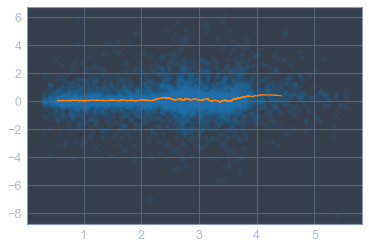

In [299]:
rolling_ratio = pd.DataFrame({'y_pred': y_pred, 'chi-sq_ratio': np.log10(chisq_gi/chisq_gimorph)}).sort_values(
    'y_pred'
).rolling(
    300, center=True, on='y_pred'
).mean()
plt.scatter(y_pred, np.log10(chisq_gi/chisq_gimorph), alpha=0.1)
plt.plot(rolling_ratio['y_pred'], rolling_ratio['chi-sq_ratio'], color='C1')

In [283]:
np.log10(chisq_gi/chisq_gimorph).mean()

0.09570055712772936

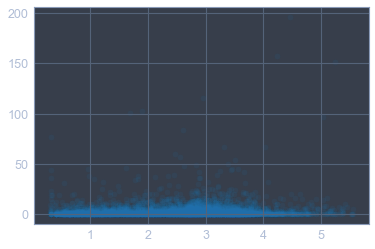

In [280]:
plt.scatter(y_pred, chisq_gimorph, alpha=0.1)

In [3]:
import sklearn
import pyplot as plt

ModuleNotFoundError: No module named 'pyplot'

In [ ]:
plt.plot([1, 2, 3], [5, 2, 4])

# Standardize modelmag (+morpho) predictions

## Model training (unified)

In [137]:
# params
lgbm_params = {
    'boosting_type': 'gbdt',
    'objective': 'regression_l2',
    'nthread': 2,
    'num_leaves': 40, # was 2**4,
    'min_data_in_leaf': 150,
    'learning_rate': 0.01,
    'max_depth': -1,  # was 10
    'max_bin': 255,
    'feature_fraction': 0.4,
    'bagging_fraction': 0.8,
    'bagging_freq': 40,
    'device' : 'cpu',  # was gpu
    'metric' : 'rmse',
    'verbose':0       
}
lgbm_params_small = lgbm_params.copy()
lgbm_params_small['bagging_fraction'] = 1.
lgbm_params_small['feature_fraction'] = 1
lgbm_params_small['num_leaves'] = 31
lgbm_params_small['min_data_in_leaf'] = 90
max_boost_runs = 30000

In [223]:
def lgb_chi_dec(decimals):
    def lgb_chi_ndec(Yp, train_data):
        Y = train_data.get_label()
        weight = train_data.get_weight()  # 1 / errsq
        xi = np.abs((Y - Yp) * np.sqrt(weight)).mean()
        return 'Chi', round(xi, decimals), False
    return lgb_chi_ndec

def lgb_chisq_dec(decimals):
    def lgb_chisq_ndec(Yp, train_data):
        Y = train_data.get_label()
        weight = train_data.get_weight()  # 1 / errsq
        xi_sq = (np.square(Y - Yp) * weight).mean()
        return 'Chi-sq', round(xi_sq, decimals), False
    return lgb_chisq_ndec

def lgb_rmsle_dec(decimals):
    def lgb_rmsle_ndec(Yp, train_data):
        Y = train_data.get_label()
        rmsle = np.sqrt(np.mean(np.square(np.log10(Yp / Y))))
        return 'rmsle', round(rmsle, decimals), False
    return lgb_rmsle_ndec

In [255]:
d_losses = {'chi': lgb_chi_dec(3), 'chi-sq': lgb_chisq_dec(3), 'rmsle': lgb_rmsle_dec(4)}

class GBMModel:
    def __init__(self, morph=True, fluxes=None, loss='chi'):
        self.model_, self.modelt50_ = None, None
        self.features = None
        self.morph = morph
        self.fluxes = fluxes if fluxes is not None else []
        self.idx = df_features.index
        self.loss_name = loss
        self.y_preds = {}
        self.score = {}
        self.setup_fluxfeatures()
        self.setup_colorfeatures()
        self.setup_datasets()
        self.setup_model()
        
    def setup_fluxfeatures(self):
        self.features = df_features.copy() if self.morph else pd.DataFrame()
        if not self.morph:
            self.features['redshift'] = df_metamorph.loc[self.idx, 'redshift'].copy()
        for flux_name in self.fluxes:
            mag_value = df_metamorph.loc[self.idx, f'modelMag_{flux_name}'].copy()
            dist = df_metamorph.loc[self.idx, 'D_Mpc']
            lum_value = np.power(10, mag_value) * np.square(dist) / 1e20
            self.features['lum_'+flux_name] = lum_value
    
    def setup_colorfeatures(self):
        '''Adds all colors with g-band'''
        
        if 'g' not in self.fluxes:
            return
        flux_g = self.features['lum_g']
        for flux_name in self.fluxes:
            if flux_name == 'g':
                continue
            color = np.log10(self.features[f'lum_{flux_name}'] / flux_g)
            self.features[f'col_{flux_name}'] = color
    
    def setup_datasets(self):
        self.y = df_metamorph.loc[self.idx, 'ML_bayes']
        self.yerr = df_metamorph.loc[self.idx, 'ML_bayes_err']
        self.yerr = np.maximum(self.yerr, 0.05*self.y)
        self.weight = 1 / np.square(self.yerr)
        X_tr, y_tr = self.features.loc[idx_tr], self.y.loc[idx_tr]
        X_val, y_val = self.features.loc[idx_val], self.y.loc[idx_val]
        self.X_test, self.y_test = self.features.loc[idx_test], self.y.loc[idx_test]
        self.dset_tr = lgbm.Dataset(X_tr, y_tr, weight=self.weight.loc[idx_tr])
        self.dset_val = lgbm.Dataset(X_val, y_val, weight=self.weight.loc[idx_val])
        lgb_train = lgbm.Dataset(X_tr, y_tr)

    def setup_model(self):
        if self.loss_name not in d_losses:
            raise ValueError(f'Loss {loss} not available in d_losses!')
        self.loss = d_losses[self.loss_name]
        self.params = lgbm_params if self.features.shape[1] > 400 else lgbm_params_small
        
    def train_model(self, max_boost_runs=30000):
        self.model_ = lgbm.train(self.params, self.dset_tr,
                                 num_boost_round=max_boost_runs,
                                 valid_sets=[self.dset_tr, self.dset_val],  # eval training data
                                 valid_names=['train', 'eval'],
                                 verbose_eval=100,
                                 early_stopping_rounds=100,
                                 feval=self.loss
                                )
        self.calculate_scores()
        
    def calculate_scores(self):
        nfeat = self.features.shape[1]
        run_name = 'full' if nfeat > 400 else f't{nfeat}'
        for idx_name, idx in zip(['tr', 'val', 'test'], [idx_tr, idx_val, idx_test]):
            y_pred = self.model_.predict(self.features.loc[idx])
            self.y_preds[idx_name] = y_pred
            mean_chi = np.mean(np.abs((self.y.loc[idx] - y_pred) / self.yerr.loc[idx]))
            self.score[run_name+'_'+idx_name] = mean_chi
        
    def train_modelt50(self):
        # Seems like this is not worth it
        t50_idx = self.model_.feature_importance().argsort()[::-1][:50]
        self.features = self.features.iloc[:, t50_idx]
        self.setup_datasets()
        self.setup_model()
        self.train_model()
        
    def load_best_model(self):
        self.load_model(t50=False)
        self.load_model(t50=True)
        if self.score['full_val'] < self.score['t50_val']:
            self.load_model(t50=False)
        
    def load_model(self, t50=False):
        # Throws lgbm.basic.LightGBMError when file does not exist
        filepath = self.get_savepath()
        if t50:
            filepath += '_t50'
        self.model_ = lgbm.Booster(model_file=filepath)
        if t50:
            #t50_idx = self.model_.feature_importance().argsort()[::-1][:50]
            t50_idx = self.model_.feature_name()
            self.features = self.features.loc[:, t50_idx]
            self.setup_datasets()
            self.setup_model()
        self.calculate_scores()
        
    def save_model(self):
        filepath = self.get_savepath()
        self.model_.save_model(filepath)
        
    def get_savepath(self):
        filename = 'morph_' if self.morph else ''
        for flux in self.fluxes:
            filename += flux
        if self.loss_name != 'chi':
            filename += '_' + self.loss_name
        if self.morph and self.features.shape[1] <= 400:
            filename += '_t' + str(self.features.shape[1])
        fdir = '/Users/wouterdobbels/phd/hackaton/data/lgbm_model/unified/'
        return fdir + filename

### Training

In [170]:
gbm_model_gi = GBMModel(morph=True, fluxes=['g', 'i'])
gbm_model_gi.train_model()
gbm_model_gi.save_model()
gbm_model_gi.train_modelt50()
gbm_model_gi.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.509033	train's Chi: 3.119	eval's rmse: 0.530724	eval's Chi: 3.168
[200]	train's rmse: 0.318654	train's Chi: 1.873	eval's rmse: 0.352627	eval's Chi: 1.969
[300]	train's rmse: 0.261638	train's Chi: 1.502	eval's rmse: 0.298692	eval's Chi: 1.619
[400]	train's rmse: 0.231882	train's Chi: 1.319	eval's rmse: 0.266904	eval's Chi: 1.435
[500]	train's rmse: 0.218232	train's Chi: 1.236	eval's rmse: 0.252521	eval's Chi: 1.355
[600]	train's rmse: 0.209338	train's Chi: 1.183	eval's rmse: 0.243716	eval's Chi: 1.306
[700]	train's rmse: 0.20276	train's Chi: 1.144	eval's rmse: 0.237386	eval's Chi: 1.273
[800]	train's rmse: 0.197673	train's Chi: 1.115	eval's rmse: 0.232768	eval's Chi: 1.248
[900]	train's rmse: 0.19346	train's Chi: 1.091	eval's rmse: 0.229249	eval's Chi: 1.23
[1000]	train's rmse: 0.189659	train's Chi: 1.069	eval's rmse: 0.226041	eval's Chi: 1.213
[1100]	train's rmse: 0.186491	train's Chi: 1.052	eval's rms

In [24]:
gbm_model_ = GBMModel(morph=True, fluxes=[])
gbm_model_.train_model()
gbm_model_.save_model()
gbm_model_.train_modelt50()
gbm_model_.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.570115	train's Chi: 3.476	eval's rmse: 0.606114	eval's Chi: 3.568
[200]	train's rmse: 0.43598	train's Chi: 2.534	eval's rmse: 0.497413	eval's Chi: 2.717
[300]	train's rmse: 0.399998	train's Chi: 2.276	eval's rmse: 0.471828	eval's Chi: 2.499
[400]	train's rmse: 0.385043	train's Chi: 2.179	eval's rmse: 0.46329	eval's Chi: 2.429
[500]	train's rmse: 0.375702	train's Chi: 2.124	eval's rmse: 0.458591	eval's Chi: 2.396
[600]	train's rmse: 0.368638	train's Chi: 2.086	eval's rmse: 0.455972	eval's Chi: 2.379
[700]	train's rmse: 0.36262	train's Chi: 2.055	eval's rmse: 0.454511	eval's Chi: 2.368
[800]	train's rmse: 0.35739	train's Chi: 2.028	eval's rmse: 0.453141	eval's Chi: 2.36
[900]	train's rmse: 0.352643	train's Chi: 2.004	eval's rmse: 0.45246	eval's Chi: 2.354
[1000]	train's rmse: 0.348367	train's Chi: 1.981	eval's rmse: 0.451897	eval's Chi: 2.349
[1100]	train's rmse: 0.344246	train's Chi: 1.96	eval's rmse: 0

In [172]:
gbm_model_g = GBMModel(morph=True, fluxes=['g'])
gbm_model_g.train_model()
gbm_model_g.save_model()
gbm_model_g.train_modelt50()
gbm_model_g.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.56943	train's Chi: 3.472	eval's rmse: 0.604137	eval's Chi: 3.564
[200]	train's rmse: 0.435522	train's Chi: 2.532	eval's rmse: 0.49613	eval's Chi: 2.714
[300]	train's rmse: 0.399614	train's Chi: 2.274	eval's rmse: 0.469645	eval's Chi: 2.497
[400]	train's rmse: 0.384669	train's Chi: 2.176	eval's rmse: 0.460829	eval's Chi: 2.425
[500]	train's rmse: 0.375338	train's Chi: 2.122	eval's rmse: 0.456075	eval's Chi: 2.393
[600]	train's rmse: 0.368335	train's Chi: 2.084	eval's rmse: 0.453638	eval's Chi: 2.377
[700]	train's rmse: 0.362403	train's Chi: 2.053	eval's rmse: 0.451783	eval's Chi: 2.365
[800]	train's rmse: 0.357191	train's Chi: 2.026	eval's rmse: 0.450424	eval's Chi: 2.356
[900]	train's rmse: 0.352516	train's Chi: 2.002	eval's rmse: 0.449912	eval's Chi: 2.351
[1000]	train's rmse: 0.348226	train's Chi: 1.98	eval's rmse: 0.449371	eval's Chi: 2.347
[1100]	train's rmse: 0.344171	train's Chi: 1.959	eval's rms

In [173]:
gbm_model_ugi = GBMModel(morph=True, fluxes=['u', 'g', 'i'])
gbm_model_ugi.train_model()
gbm_model_ugi.save_model()
gbm_model_ugi.train_modelt50()
gbm_model_ugi.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.490572	train's Chi: 3.008	eval's rmse: 0.503421	eval's Chi: 3.038
[200]	train's rmse: 0.305346	train's Chi: 1.796	eval's rmse: 0.327609	eval's Chi: 1.872
[300]	train's rmse: 0.250028	train's Chi: 1.431	eval's rmse: 0.274424	eval's Chi: 1.523
[400]	train's rmse: 0.229825	train's Chi: 1.302	eval's rmse: 0.254567	eval's Chi: 1.4
[500]	train's rmse: 0.218662	train's Chi: 1.234	eval's rmse: 0.244034	eval's Chi: 1.336
[600]	train's rmse: 0.211188	train's Chi: 1.191	eval's rmse: 0.237395	eval's Chi: 1.298
[700]	train's rmse: 0.204789	train's Chi: 1.155	eval's rmse: 0.23225	eval's Chi: 1.269
[800]	train's rmse: 0.199208	train's Chi: 1.123	eval's rmse: 0.227652	eval's Chi: 1.243
[900]	train's rmse: 0.194955	train's Chi: 1.099	eval's rmse: 0.224615	eval's Chi: 1.226
[1000]	train's rmse: 0.191125	train's Chi: 1.078	eval's rmse: 0.222098	eval's Chi: 1.212
[1100]	train's rmse: 0.187019	train's Chi: 1.056	eval's rms

In [174]:
gbm_model_ugiz = GBMModel(morph=True, fluxes=['u', 'g', 'i', 'z'])
gbm_model_ugiz.train_model()
gbm_model_ugiz.save_model()
gbm_model_ugiz.train_modelt50()
gbm_model_ugiz.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.467381	train's Chi: 2.868	eval's rmse: 0.475224	eval's Chi: 2.882
[200]	train's rmse: 0.274103	train's Chi: 1.609	eval's rmse: 0.288799	eval's Chi: 1.662
[300]	train's rmse: 0.218383	train's Chi: 1.245	eval's rmse: 0.235145	eval's Chi: 1.31
[400]	train's rmse: 0.199096	train's Chi: 1.121	eval's rmse: 0.215951	eval's Chi: 1.19
[500]	train's rmse: 0.190275	train's Chi: 1.066	eval's rmse: 0.20763	eval's Chi: 1.14
[600]	train's rmse: 0.184011	train's Chi: 1.032	eval's rmse: 0.202484	eval's Chi: 1.11
[700]	train's rmse: 0.179348	train's Chi: 1.006	eval's rmse: 0.199029	eval's Chi: 1.091
[800]	train's rmse: 0.175814	train's Chi: 0.987	eval's rmse: 0.196742	eval's Chi: 1.079
[900]	train's rmse: 0.172513	train's Chi: 0.969	eval's rmse: 0.194706	eval's Chi: 1.068
[1000]	train's rmse: 0.169549	train's Chi: 0.954	eval's rmse: 0.193138	eval's Chi: 1.06
[1100]	train's rmse: 0.166968	train's Chi: 0.94	eval's rmse: 0

In [175]:
gbm_model_ugriz = GBMModel(morph=True, fluxes=['u', 'g', 'r', 'i', 'z'])
gbm_model_ugriz.train_model()
gbm_model_ugriz.save_model()
gbm_model_ugriz.train_modelt50()
gbm_model_ugriz.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.453564	train's Chi: 2.785	eval's rmse: 0.45735	eval's Chi: 2.785
[200]	train's rmse: 0.254945	train's Chi: 1.493	eval's rmse: 0.262957	eval's Chi: 1.527
[300]	train's rmse: 0.204007	train's Chi: 1.156	eval's rmse: 0.214942	eval's Chi: 1.208
[400]	train's rmse: 0.189714	train's Chi: 1.063	eval's rmse: 0.202502	eval's Chi: 1.123
[500]	train's rmse: 0.183307	train's Chi: 1.023	eval's rmse: 0.197202	eval's Chi: 1.089
[600]	train's rmse: 0.178611	train's Chi: 0.999	eval's rmse: 0.194297	eval's Chi: 1.072
[700]	train's rmse: 0.174937	train's Chi: 0.98	eval's rmse: 0.192269	eval's Chi: 1.06
[800]	train's rmse: 0.171969	train's Chi: 0.964	eval's rmse: 0.190832	eval's Chi: 1.052
[900]	train's rmse: 0.169244	train's Chi: 0.95	eval's rmse: 0.189668	eval's Chi: 1.046
[1000]	train's rmse: 0.166836	train's Chi: 0.938	eval's rmse: 0.18887	eval's Chi: 1.041
[1100]	train's rmse: 0.164626	train's Chi: 0.926	eval's rmse:

In [176]:
gbm_g = GBMModel(morph=False, fluxes=['g'])
gbm_g.train_model()
gbm_g.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.814019	train's Chi: 5.061	eval's rmse: 0.824502	eval's Chi: 5.056
[200]	train's rmse: 0.764985	train's Chi: 4.609	eval's rmse: 0.78214	eval's Chi: 4.632
[300]	train's rmse: 0.755534	train's Chi: 4.482	eval's rmse: 0.775812	eval's Chi: 4.521
[400]	train's rmse: 0.752457	train's Chi: 4.44	eval's rmse: 0.775464	eval's Chi: 4.489
Early stopping, best iteration is:
[382]	train's rmse: 0.752847	train's Chi: 4.445	eval's rmse: 0.775369	eval's Chi: 4.493


In [177]:
gbm_gi = GBMModel(morph=False, fluxes=['g', 'i'])
gbm_gi.train_model()
gbm_gi.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.453902	train's Chi: 2.788	eval's rmse: 0.451772	eval's Chi: 2.767
[200]	train's rmse: 0.273979	train's Chi: 1.607	eval's rmse: 0.273431	eval's Chi: 1.608
[300]	train's rmse: 0.236576	train's Chi: 1.335	eval's rmse: 0.236829	eval's Chi: 1.344
[400]	train's rmse: 0.229325	train's Chi: 1.278	eval's rmse: 0.230139	eval's Chi: 1.289
[500]	train's rmse: 0.227232	train's Chi: 1.263	eval's rmse: 0.228521	eval's Chi: 1.274
[600]	train's rmse: 0.226147	train's Chi: 1.257	eval's rmse: 0.22795	eval's Chi: 1.269
[700]	train's rmse: 0.22526	train's Chi: 1.252	eval's rmse: 0.22775	eval's Chi: 1.268
[800]	train's rmse: 0.224617	train's Chi: 1.249	eval's rmse: 0.227667	eval's Chi: 1.267
Early stopping, best iteration is:
[710]	train's rmse: 0.225186	train's Chi: 1.252	eval's rmse: 0.227742	eval's Chi: 1.267


In [178]:
gbm_ugi = GBMModel(morph=False, fluxes=['u', 'g', 'i'])
gbm_ugi.train_model()
gbm_ugi.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.453015	train's Chi: 2.782	eval's rmse: 0.451161	eval's Chi: 2.762
[200]	train's rmse: 0.270131	train's Chi: 1.584	eval's rmse: 0.270243	eval's Chi: 1.59
[300]	train's rmse: 0.229971	train's Chi: 1.299	eval's rmse: 0.231243	eval's Chi: 1.315
[400]	train's rmse: 0.221127	train's Chi: 1.234	eval's rmse: 0.222966	eval's Chi: 1.252
[500]	train's rmse: 0.218062	train's Chi: 1.213	eval's rmse: 0.220502	eval's Chi: 1.234
[600]	train's rmse: 0.216308	train's Chi: 1.203	eval's rmse: 0.219316	eval's Chi: 1.225
[700]	train's rmse: 0.215035	train's Chi: 1.196	eval's rmse: 0.218724	eval's Chi: 1.221
[800]	train's rmse: 0.214114	train's Chi: 1.191	eval's rmse: 0.21837	eval's Chi: 1.218
[900]	train's rmse: 0.213388	train's Chi: 1.188	eval's rmse: 0.218131	eval's Chi: 1.216
[1000]	train's rmse: 0.212722	train's Chi: 1.184	eval's rmse: 0.21802	eval's Chi: 1.215
[1100]	train's rmse: 0.212062	train's Chi: 1.181	eval's rms

In [179]:
gbm_ugiz = GBMModel(morph=False, fluxes=['u', 'g', 'i', 'z'])
gbm_ugiz.train_model()
gbm_ugiz.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.443554	train's Chi: 2.726	eval's rmse: 0.441397	eval's Chi: 2.7
[200]	train's rmse: 0.251748	train's Chi: 1.477	eval's rmse: 0.251821	eval's Chi: 1.481
[300]	train's rmse: 0.208135	train's Chi: 1.174	eval's rmse: 0.209498	eval's Chi: 1.189
[400]	train's rmse: 0.198662	train's Chi: 1.105	eval's rmse: 0.200885	eval's Chi: 1.124
[500]	train's rmse: 0.195403	train's Chi: 1.084	eval's rmse: 0.198216	eval's Chi: 1.105
[600]	train's rmse: 0.193502	train's Chi: 1.073	eval's rmse: 0.19693	eval's Chi: 1.096
[700]	train's rmse: 0.192026	train's Chi: 1.065	eval's rmse: 0.196073	eval's Chi: 1.09
[800]	train's rmse: 0.190962	train's Chi: 1.059	eval's rmse: 0.195571	eval's Chi: 1.087
[900]	train's rmse: 0.19008	train's Chi: 1.055	eval's rmse: 0.195235	eval's Chi: 1.085
[1000]	train's rmse: 0.189352	train's Chi: 1.051	eval's rmse: 0.195005	eval's Chi: 1.083
[1100]	train's rmse: 0.18863	train's Chi: 1.048	eval's rmse: 

In [180]:
gbm_ugriz = GBMModel(morph=False, fluxes=['u', 'g', 'r', 'i', 'z'])
gbm_ugriz.train_model()
gbm_ugriz.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.443262	train's Chi: 2.723	eval's rmse: 0.441107	eval's Chi: 2.697
[200]	train's rmse: 0.250616	train's Chi: 1.47	eval's rmse: 0.250758	eval's Chi: 1.475
[300]	train's rmse: 0.206409	train's Chi: 1.165	eval's rmse: 0.207961	eval's Chi: 1.18
[400]	train's rmse: 0.196683	train's Chi: 1.095	eval's rmse: 0.199249	eval's Chi: 1.116
[500]	train's rmse: 0.193443	train's Chi: 1.073	eval's rmse: 0.196729	eval's Chi: 1.098
[600]	train's rmse: 0.191617	train's Chi: 1.062	eval's rmse: 0.195638	eval's Chi: 1.09
[700]	train's rmse: 0.190226	train's Chi: 1.054	eval's rmse: 0.194894	eval's Chi: 1.085
[800]	train's rmse: 0.189187	train's Chi: 1.049	eval's rmse: 0.194423	eval's Chi: 1.082
[900]	train's rmse: 0.188321	train's Chi: 1.044	eval's rmse: 0.194206	eval's Chi: 1.08
[1000]	train's rmse: 0.187544	train's Chi: 1.04	eval's rmse: 0.194068	eval's Chi: 1.079
[1100]	train's rmse: 0.186787	train's Chi: 1.037	eval's rmse:

In [185]:
gbm_model_ugriz.score

{'full_tr': 0.8681792019266718,
 'full_val': 1.0244467923315073,
 'full_test': 1.004452566214459,
 't50_tr': 0.9306327795715491,
 't50_val': 1.0234875822370033,
 't50_test': 0.9998609332318087}

### Save and load

In [150]:
# saving
gbm_model_g.model_.save_model('data/lgbm_model/unified/morph_g.txt')
gbm_g.model_.save_model('data/lgbm_model/unified/g.txt')
gbm_model_gi.model_.save_model('data/lgbm_model/unified/morph_gi.txt')
gbm_gi.model_.save_model('data/lgbm_model/unified/gi.txt')
gbm_model_ugi.model_.save_model('data/lgbm_model/unified/morph_ugi.txt')
gbm_ugi.model_.save_model('data/lgbm_model/unified/ugi.txt')
gbm_model_ugiz.model_.save_model('data/lgbm_model/unified/morph_ugiz.txt')
gbm_ugiz.model_.save_model('data/lgbm_model/unified/ugiz.txt')
gbm_model_ugriz.model_.save_model('data/lgbm_model/unified/morph_ugriz.txt')
gbm_ugriz.model_.save_model('data/lgbm_model/unified/ugriz.txt')

In [140]:
# loading
gbm_g = GBMModel(morph=False, fluxes=['g'])
gbm_g.load_model()
gbm_model_g = GBMModel(morph=True, fluxes=['g'])
gbm_model_g.load_model()
gbm_model_ = GBMModel(morph=True, fluxes=[])
gbm_model_.load_model()
gbm_gi = GBMModel(morph=False, fluxes=['g', 'i'])
gbm_gi.load_model()
gbm_model_gi = GBMModel(morph=True, fluxes=['g', 'i'])
gbm_model_gi.load_model()
gbm_ugi = GBMModel(morph=False, fluxes=['u', 'g', 'i'])
gbm_ugi.load_model()
gbm_model_ugi = GBMModel(morph=True, fluxes=['u', 'g', 'i'])
gbm_model_ugi.load_model()
gbm_ugiz = GBMModel(morph=False, fluxes=['u', 'g', 'i', 'z'])
gbm_ugiz.load_model()
gbm_model_ugiz = GBMModel(morph=True, fluxes=['u', 'g', 'i', 'z'])
gbm_model_ugiz.load_model()
gbm_ugriz = GBMModel(morph=False, fluxes=['u', 'g', 'r', 'i', 'z'])
gbm_ugriz.load_model()
gbm_model_ugriz = GBMModel(morph=True, fluxes=['u', 'g', 'r', 'i', 'z'])
gbm_model_ugriz.load_model()

In [248]:
gbm_model_gi = GBMModel(morph=True, fluxes=['g', 'i'])
gbm_model_gi.load_model(t50=True)

In [141]:
gbm_gi.score

{'t4_tr': 1.2520790785927567,
 't4_val': 1.2674972601826633,
 't4_test': 1.2558901345035811}

In [27]:
gbm_model_g.score

{'full_tr': 1.9059737227227123,
 'full_val': 2.33508307665647,
 'full_test': 2.28423813309674}

In [25]:
gbm_model_.score

{'full_tr': 1.9170091318612656,
 'full_val': 2.338707174228716,
 'full_test': 2.292387963758718,
 't50_tr': 2.040210080656277,
 't50_val': 2.366833208326589,
 't50_test': 2.3416939077721213}

## Model improvement barchart

In [95]:
models_nomorph = [gbm_g, gbm_gi, gbm_ugi, gbm_ugiz, gbm_ugriz]
models_morph = [gbm_model_g, gbm_model_gi, gbm_model_ugi, gbm_model_ugiz, gbm_model_ugriz]
eset = 'test'
scores_nomorph, scores_morph = [], []
for model_nomorph in models_nomorph:
    eset_keys = list(filter(lambda x: eset in x, model_nomorph.score.keys()))
    scores_nomorph.append(model_nomorph.score[eset_keys[0]])
    
for model_morph in models_morph:
    eset_keys = list(filter(lambda x: eset in x, model_morph.score.keys()))
    bestscore = np.inf
    for eset_key in eset_keys:
        if model_morph.score[eset_key] < bestscore:
            bestscore = model_morph.score[eset_key]
    scores_morph.append(bestscore)

In [127]:
scores_morph

[2.284238133096741,
 1.1390810114854664,
 1.1079962183797,
 1.0014480174636733,
 1.0016578249892365]

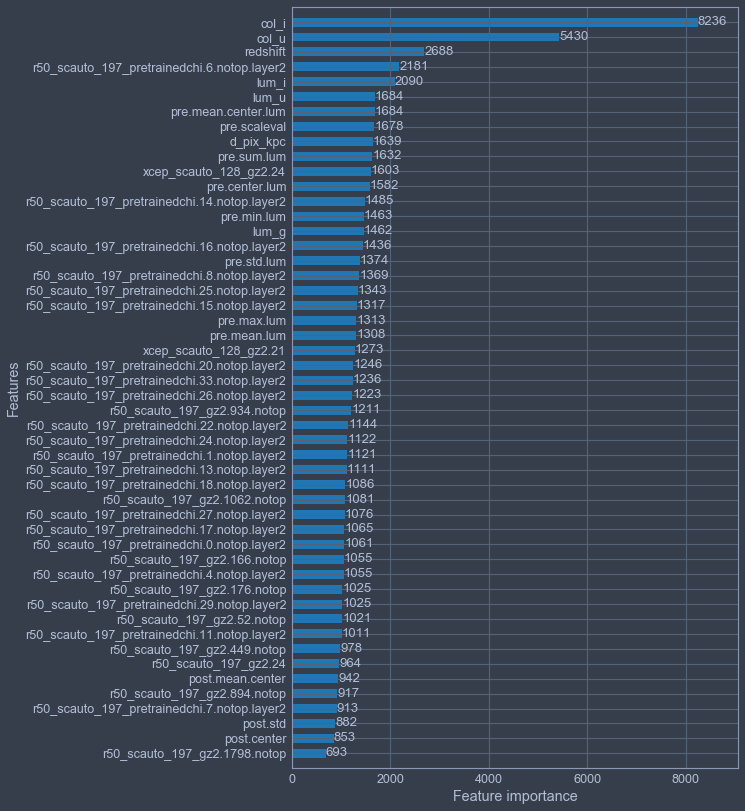

In [139]:
lgbm.plot_importance(gbm_model_ugi.model_, max_num_features=50, title='', height=0.6, 
                     figsize=(8, 14))

In [119]:
def darken(hexcol, frac=0.6):
    newcol = '#'
    for i in range(1, 7, 2):
        newcol += hex(int(int(hexcol[i:i+2], 16) * frac))[2:]
    return newcol

darken(morph_col)

'#4c784c'

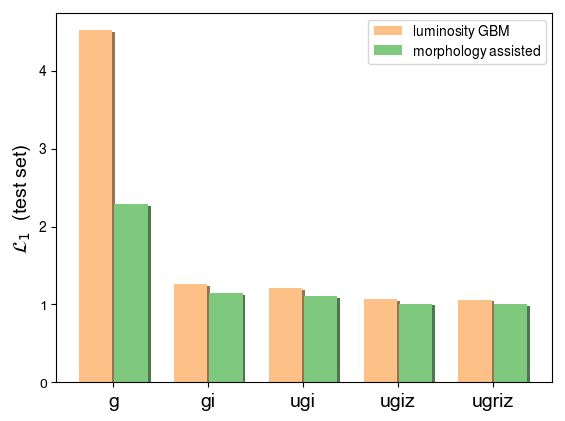

In [140]:
colors = ['g', 'gi', 'ugi', 'ugiz', 'ugriz']
morph_col = '#7fc97f'
lum_col = '#fdc086'
idx = np.array(list(range(len(colors))))
width = 0.35
offset = 0.03
gap = 0.012
topextra = -0.02 #0.02
with plt.style.context(['default']):
    plt.bar(idx+offset-gap, np.array(scores_nomorph)+topextra, width, color=darken(lum_col))
    plt.bar(idx-gap, scores_nomorph, width, label='luminosity GBM', color=lum_col)
    plt.bar(idx+width+offset+gap, np.array(scores_morph)+topextra, width, color=darken(morph_col))
    plt.bar(idx+width+gap, scores_morph, width, label='morphology assisted', color=morph_col)
    plt.xticks(idx + width / 2, colors, fontsize=14)
    plt.rc('text', usetex=True)
    plt.ylabel(r'$\mathcal{L}_1$  (test set)', fontsize=14)
    plt.legend()
    plt.savefig('plots/lgbm/ugriz_buildup_morphology.pdf', bbox_inches='tight')

## Compare residuals

In [210]:
l1_morph = (gbm_model_gi.y_preds['test'] - y_test) / y_test_err
l1_lum = (gbm_gi.y_preds['test'] - y_test) / y_test_err
y_pred_avg = (gbm_model_gi.y_preds['test'] + gbm_gi.y_preds['test']) / 2
l1_avg = (y_pred_avg - y_test) / y_test_err
print('l1 morph', l1_morph.abs().mean())
print('l1 lum', l1_lum.abs().mean())
print('l1 avg', l1_avg.abs().mean())

l1 morph 1.1186353941033522
l1 lum 1.2559012060294346
l1 avg 1.1503648045996733


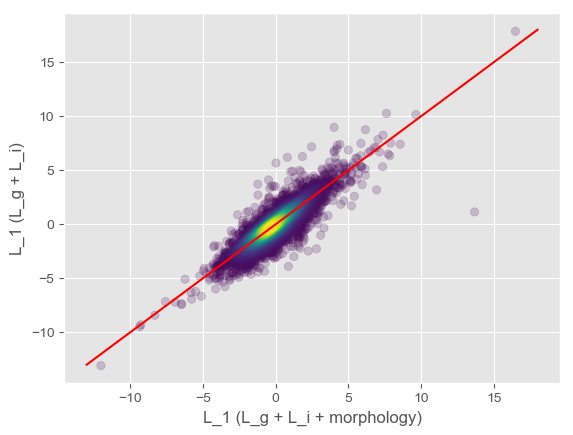

In [207]:
with plt.style.context(['ggplot'], after_reset=True):
    x, y, c = estimate_density(l1_morph, l1_lum)
    plt.scatter(x, y, c=c, alpha=0.2)
    plt.plot([-13, 18], [-13, 18], 'r-')
    plt.xlabel('L_1 (L_g + L_i + morphology)')
    plt.ylabel('L_1 (L_g + L_i)')

In [211]:
l1_morph = (gbm_model_g.y_preds['test'] - y_test) / y_test_err
l1_lum = (gbm_g.y_preds['test'] - y_test) / y_test_err
print('l1 morph', l1_morph.abs().mean())
print('l1 lum', l1_lum.abs().mean())

l1 morph 2.333343916563006
l1 lum 4.520386605596401


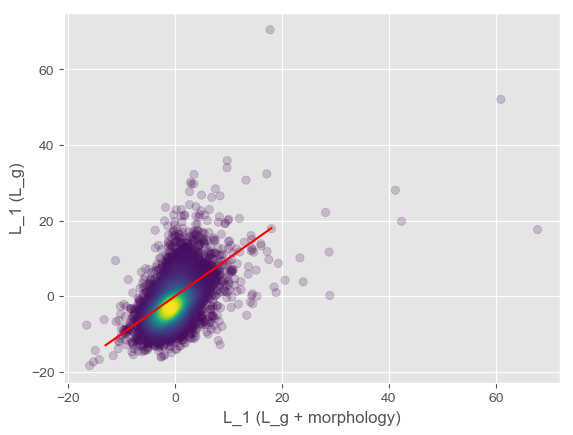

In [213]:
with plt.style.context(['ggplot'], after_reset=True):
    x, y, c = estimate_density(l1_morph, l1_lum)
    plt.scatter(x, y, c=c, alpha=0.2)
    plt.plot([-13, 18], [-13, 18], 'r-')
    plt.xlabel('L_1 (L_g + morphology)')
    plt.ylabel('L_1 (L_g)')

## Compare estimators (true vs pred panels)

In [231]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,modelMag_u,modelMag_r,modelMag_z
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,20.35955,17.40932,16.63860
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,19.38518,17.61691,17.15460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,17.51221,16.00672,15.59723
1237662500543987740,242.00880,36.05398,

In [28]:
from cycler import cycler
import matplotlib.patheffects as path_effects
from matplotlib.patches import Rectangle
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredDrawingArea

x = np.linspace(0.001, 9, 10)
dexlines = 0.15

def plot_truevspred_gbm(gbm_model, ax, **kwargs):
    y_pred = gbm_model.y_preds['test']
    title = build_title_gbm(gbm_model)
    plot_truevspred(y_pred, ax, title=title, **kwargs)
    
def plot_truevspred_zib(ax, **kwargs):
    y_zib = df_metamorph.loc[idx_test, 'ML_zibetti_minchi']
    b_sel = (y_zib < 1e3)
    plot_truevspred(y_zib, ax, b_sel=b_sel, title='$g-i$ power law', **kwargs)

def plot_truevspred(y_pred, ax, b_sel=None, title='', pix_per_letter=None, add_color=None):
    if b_sel is not None:
        y_test_cur = y_test[b_sel]
        y_pred = y_pred[b_sel]
        y_test_err_cur = y_test_err[b_sel]
    else:
        y_test_cur = y_test
        y_test_err_cur = y_test_err
    y_test_c, y_pred_c, c = estimate_density(y_test_cur, y_pred,
                                            verbose=True)
    ax.errorbar(y_test_cur, y_pred, xerr=y_test_err_cur, linestyle='None', alpha=0.15, marker='None',
                 ecolor='#beaed4')
    ax.scatter(y_test_c, y_pred_c, c=c, alpha=0.15, zorder=50, cmap='inferno')
    
    chi = np.mean(np.abs((y_test_cur - y_pred) / y_test_err_cur))
    lf = np.sqrt(np.mean(np.square(np.log10(y_pred / y_test_cur))))
    top, offset = 0.87, 0.07
    ax.text(0.05, top, r'$\mathcal{L}_1$ = '+f'{chi:.2f}', transform=ax.transAxes,
                fontsize=25, path_effects=[
                    path_effects.Stroke(linewidth=3, foreground='white'),
                    path_effects.Normal()], zorder=200)
    ax.text(0.05, top-offset, r'RMSLE = '+f'{lf:.3f}', transform=ax.transAxes,
                fontsize=18, path_effects=[
                    path_effects.Stroke(linewidth=3, foreground='white'),
                    path_effects.Normal()], zorder=200)
    alpha = 0.7
    ax.plot(x, x, 'k', zorder=100, alpha=alpha)
    ax.plot(x, np.power(10, dexlines)*x, 'k--', zorder=100, alpha=alpha)
    ax.plot(x, np.power(10, -dexlines)*x, 'k--', zorder=100, alpha=alpha)
    ax.set_ylim([0, 9])
    ax.set_xlim([0, 9])
    # path_effects = [
#                 path_effects.SimpleLineShadow(offset=(-2, 2), shadow_color='r'),
#                 path_effects.Normal()]
    # path_effects.Stroke(linewidth=3, foreground='white'),
    # -- add title background --
    if pix_per_letter is None:
        pix_per_letter = 13.
        if 'power' in title:
            pix_per_letter = 11.8
        elif title.startswith('Morph'):
            pix_per_letter = 10.
        elif '$' in title:
            pix_per_letter = 8.7
    width = len(title) * pix_per_letter
    height = 20
    rect = Rectangle((0, 0), width, height, color='white', zorder=200)
    ada = AnchoredDrawingArea(width, height, 0, 20,
                          loc='upper center', pad=0., frameon=False)
    ada.set_zorder(200)

    ada.drawing_area.add_artist(rect)
    ax.add_artist(ada)
#     ax.add_collection(pc)
    ax.text(0.5, 1., title, transform=ax.transAxes,
            fontsize=25, zorder=500,
            horizontalalignment='center', verticalalignment='center')
    # -- add colored box -- 
    if add_color is not None:
        rectwidth = 45
        bgrect = Rectangle((0, 0), rectwidth, height, color='white', zorder=200)
        rect = Rectangle((5, 0), rectwidth-10, height-5, zorder=210, linewidth=4.,
                         facecolor=hex2rgb(add_color, alpha=0.3), 
                         edgecolor=hex2rgb(add_color, alpha=0.65))
        ada = AnchoredDrawingArea(width, height, width+12, 20,
                          loc='upper center', pad=0., frameon=False)
        ada.set_zorder(200)
        ada.drawing_area.add_artist(bgrect)
        ada.drawing_area.add_artist(rect)
        ax.add_artist(ada)
    ax.set_xlabel('Bayesian $M/L$')
    ax.set_ylabel('Predicted $M/L$')
    
def build_title_gbm(gbm_model):
    title = 'Morphology' if gbm_model.morph else ''
    for band in gbm_model.fluxes:
        if len(title) > 0:
            title += ' + '
        title += '$L_' + band + '$'
    title += ' GBM'
    return title

def plot_comparison_hist(d_models, ax, metric='l1', **kwargs):
    if metric == 'l1':
        plot_comparison_hist_feval(d_models, ax, xmax=10, feval=get_model_l1, **kwargs)
        ax.set_xlabel(r'Individual $\mathcal{L}_1$')
    elif metric == 'lf':
        plot_comparison_hist_feval(d_models, ax, xmax=0.5, feval=get_model_lf, **kwargs)
        ax.set_xlabel(r'$\log (\Upsilon_{\rm{pred}}\, / \, \Upsilon_{\rm{true}})$')
        ax.axvline(x=dexlines, color='k', linestyle='--', zorder=15, linewidth=1)
        ax.axvline(x=-dexlines, color='k', linestyle='--', zorder=15, linewidth=1)
    
def hex2rgb(hexcol, alpha=1.):
    hexcol = hexcol.lstrip('#')
    rgbcol = [int(hexcol[i:i+2], 16)/255 for i in (0, 2 ,4)]
    rgbcol.append(alpha)
    return rgbcol
    
def plot_comparison_hist_feval(d_models, ax, xmax, feval, legend_loc='best', li_colors=None):
    if li_colors is None:
        li_colors = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99']
    bins = np.linspace(-xmax, xmax, 30)
    for i, (model_name, model) in enumerate(d_models.items()):
        score = feval(model)
        ax.hist(score.values, bins=bins, histtype='stepfilled',
                alpha=0.3, color=li_colors[i], zorder=i)
        ax.hist(score.values, bins=bins, histtype='step', label=model_name, linewidth=4,
                alpha=0.65, color=li_colors[i], zorder=(len(d_models.values())+i))

    # Legend
    if legend_loc is not None:
        new_handles = []
        for i, handle in enumerate(handles):
            ecol = hex2rgb(li_colors[i], alpha=0.65)
            fcol = ecol.copy()
            fcol[-1] = 0.3
            patch = mpatches.Patch(edgecolor=ecol, facecolor=fcol, label=labels[i],
                                   linewidth=3)
            new_handles.append(patch)
            ax.legend(handles=new_handles, labels=d_models.keys(), fontsize=12, 
                      loc=legend_loc).set_zorder(60)
        
    ax.set_xlim([-xmax, xmax])
    ax.xaxis.set_major_locator(plt.LinearLocator(numticks=5))
    ax.axvline(x=0, color='k', zorder=15)
    stroke = [path_effects.withStroke(linewidth=3, foreground='white')]
    ax.set_ylabel('Number of galaxies', path_effects=stroke)
        
def get_model_l1(model):
    if isinstance(model, GBMModel):
        y_pred = model.y_preds['test']
        return (y_pred - y_test) / y_test_err
    else:
        y_pred = model
        b_sel = y_pred < 1e3
        return ((y_pred - y_test) / y_test_err)[b_sel]
    
def get_model_lf(model):
    if isinstance(model, GBMModel):
        y_pred = model.y_preds['test']
        return np.log10(y_pred / y_test)
    else:
        y_pred = model
        b_sel = y_pred < 1e3
        return (np.log10(y_pred / y_test))[b_sel]

Calculating density...
Kernel factor = 0.22673080521045796
Sorting by density
Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density
Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density


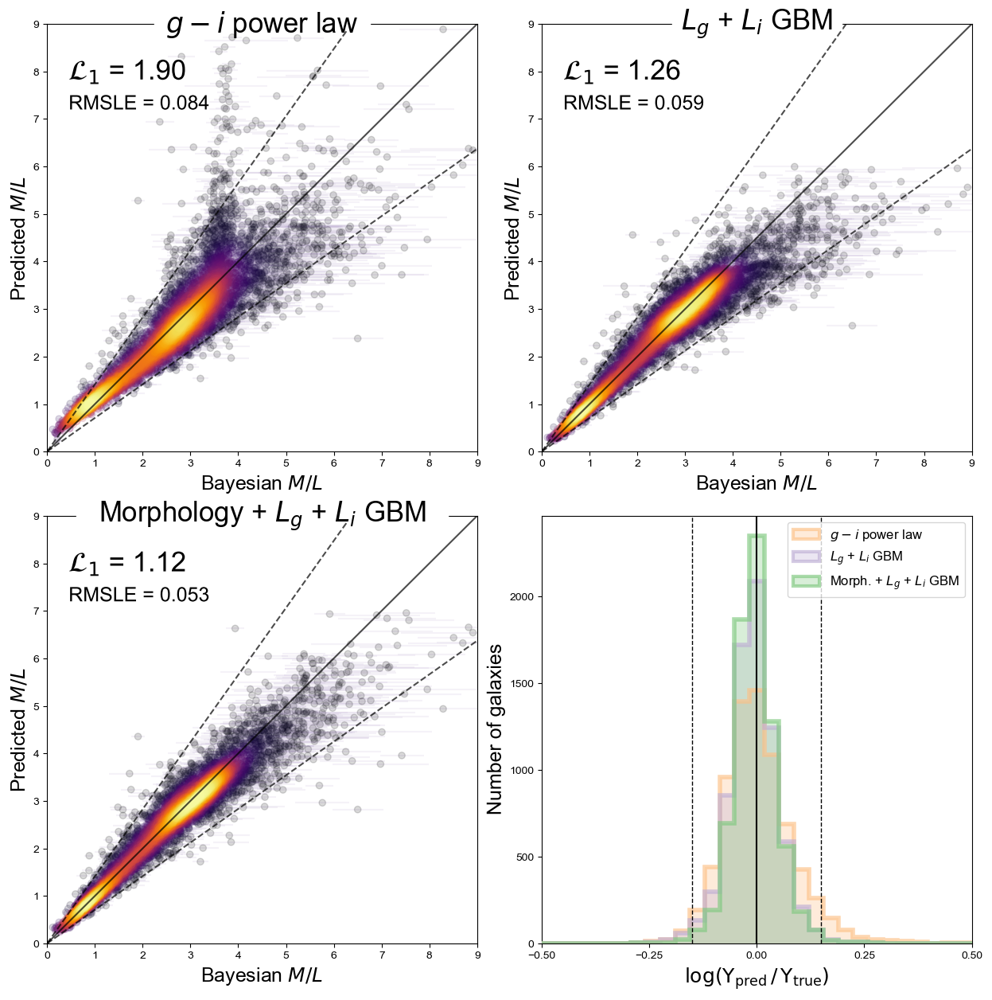

In [627]:
import matplotlib.gridspec as gridspec

li_colors = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99']

with plt.style.context(['default'], after_reset=True):
    plt.rcParams['axes.labelsize'] = 18
#     plt.rc('text', usetex=False)
    f = plt.figure(figsize=(15, 15))
    margin = 0.15
    gs = gridspec.GridSpec(2, 2, f, hspace=margin, wspace=margin)
    ax = plt.subplot(gs[0, 0])
    plot_truevspred_zib(ax, pix_per_letter=13.)
    ax = plt.subplot(gs[0, 1])
    plot_truevspred_gbm(gbm_gi, ax, pix_per_letter=9.)
    ax = plt.subplot(gs[1, 0])
    plot_truevspred_gbm(gbm_model_gi, ax, pix_per_letter=11.2)
    ax = plt.subplot(gs[1, 1])
    d_models = {'$g-i$ power law': df_metamorph.loc[idx_test, 'ML_zibetti_minchi'], 
                r'$L_g$ + $L_i$ GBM': gbm_gi,
                r'Morph. + $L_g$ + $L_i$ GBM': gbm_model_gi}
    plot_comparison_hist(d_models, ax, metric='lf', 
                         li_colors=[li_colors[2], li_colors[1], li_colors[0]])
    plt.savefig('plots/comparison/gi_comparison.pdf', bbox_inches='tight')

Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density
Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density


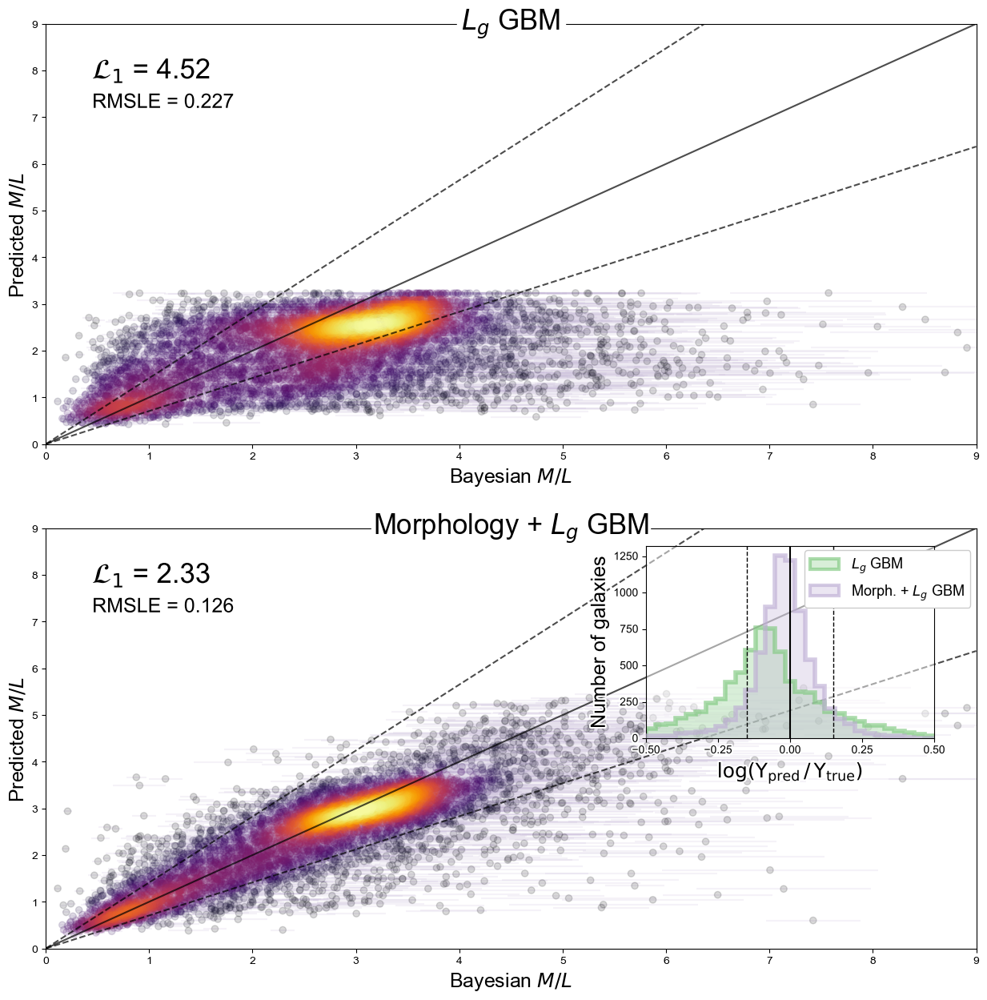

In [592]:
import matplotlib.gridspec as gridspec

with plt.style.context(['default'], after_reset=True):
    plt.rcParams['axes.labelsize'] = 18
#     plt.rc('text', usetex=False)
    f = plt.figure(figsize=(15, 15))
    margin = 0.15
    gs = gridspec.GridSpec(2, 1, f, wspace=margin)
    ax = plt.subplot(gs[0, 0])
    plot_truevspred_gbm(gbm_g, ax, pix_per_letter=10.8)
    ax = plt.subplot(gs[1, 0])
    plot_truevspred_gbm(gbm_model_g, ax, pix_per_letter=11.4)
    axh = f.add_axes([0.625, 0.285, 0.24, 0.16])  # bottom: 0.64, 0.155, legend: 0.425, 1.02
    axh.patch.set_alpha(0.5)
    d_models = {r'$L_g$ GBM': gbm_g,
                r'Morph. + $L_g$ GBM': gbm_model_g}
    plot_comparison_hist(d_models, axh, metric='lf', legend_loc=(0.55, 0.68))
    stroke = [path_effects.withStroke(linewidth=3, foreground='white')]
    for ticklabel in axh.get_yaxis().get_majorticklabels() + axh.get_xaxis().get_majorticklabels():
        ticklabel.set_path_effects(stroke)
    axh.get_xaxis().get_label().set_path_effects(stroke)
    axh.get_legend().set_alpha(1)
    axh.get_legend().get_frame().set_alpha(1)

Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density
Calculating density...
Kernel factor = 0.22672053962711222
Sorting by density


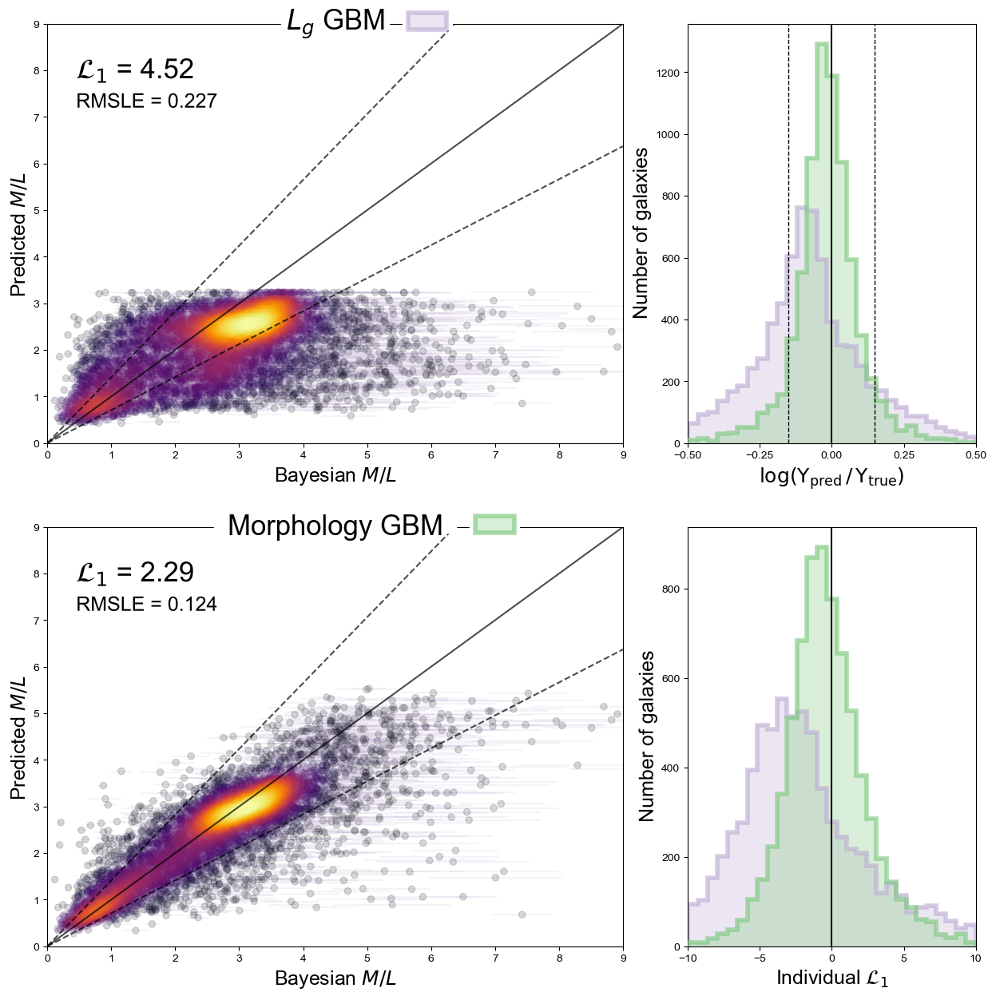

In [61]:
import matplotlib.gridspec as gridspec

li_colors = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99']

with plt.style.context(['default'], after_reset=True):
    plt.rcParams['axes.labelsize'] = 18
#     plt.rc('text', usetex=False)
    f = plt.figure(figsize=(15, 15))
    margin = 0.15
    gs = gridspec.GridSpec(2, 2, f, wspace=margin, width_ratios=[2, 1])
    ax = plt.subplot(gs[0, 0])
    plot_truevspred_gbm(gbm_g, ax, pix_per_letter=10.8, add_color=li_colors[1])
    ax = plt.subplot(gs[1, 0])
    # pix_per_letter when showing: 11.4
    plot_truevspred_gbm(gbm_model_, ax, pix_per_letter=15.6, add_color=li_colors[0])
    ax = plt.subplot(gs[0, 1])
    d_models = {r'$L_g$ GBM': gbm_g,
                r'Morph. + $L_g$ GBM': gbm_model_}
    plot_comparison_hist(d_models, ax, metric='lf', legend_loc=None, 
                         li_colors=[li_colors[1], li_colors[0]])
    ax = plt.subplot(gs[1, 1])
    plot_comparison_hist(d_models, ax, metric='l1', legend_loc=None,
                         li_colors=[li_colors[1], li_colors[0]])
    plt.savefig('plots/comparison/g_comparison.pdf', bbox_inches='tight')

In [92]:
gbm_gi.y_preds

{'tr': array([3.14449213, 2.81694177, 3.84581617, ..., 2.89605987, 0.97989059,
        1.58517034]),
 'val': array([2.45973134, 3.48852608, 3.25159959, ..., 2.8159101 , 2.6450069 ,
        2.73030378]),
 'test': array([0.93465183, 3.50366087, 1.01908329, ..., 3.50517862, 3.51677992,
        3.42984716])}

In [93]:
#yp = df_metamorph.loc[idx_test, 'ML_zibetti_minchi']
yp = gbm_gi.y_preds['test']
lf = np.log10(yp / y_test)
ngal = y_test.shape[0]
print('> 0.15 dex', np.sum(lf > 0.15),  np.sum(lf > 0.15) / ngal)
print('< -0.15 dex', np.sum(lf < -0.15), np.sum(lf < -0.15) / ngal)
print('outside 0.15 dex', np.sum(np.abs(lf) > 0.15), np.sum(np.abs(lf) > 0.15)/ngal)

> 0.15 dex 58 0.007877223957625967
< -0.15 dex 113 0.01534700529675404
outside 0.15 dex 171 0.02322422925438001


In [86]:
y_test.shape

(7363,)

In [74]:
np.sum(np.abs(rmsle) <= 0.15)

4055

In [76]:
4055 / len(rmsle)

0.550726606002988

frac smaller than 0.15 dex 0.550726606002988


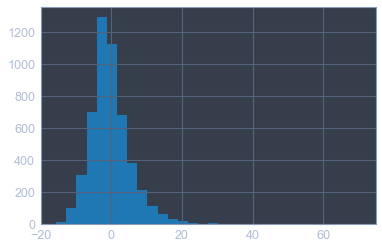

In [83]:
yp = gbm_g.y_preds['test']
l1 = (yp - y_test) / df_metamorph.loc[idx_test, 'ML_bayes_err']
rmsle = np.log10(yp / y_test)
print('frac smaller than 0.15 dex', np.sum(np.abs(rmsle) <= 0.15) / len(rmsle))
l1 = l1[y_test < 3.24]
l1.hist(bins=30)

In [84]:
y_test.max()

16.591119276544006

In [78]:
yp = gbm_model_.y_preds['test']
l1 = (yp - y_test) / df_metamorph.loc[idx_test, 'ML_bayes_err']
rmsle = np.log10(yp / y_test)
print('frac smaller than 0.15 dex', np.sum(np.abs(rmsle) <= 0.15) / len(rmsle))

frac smaller than 0.15 dex 0.8541355425777536


In [66]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,modelMag_u,modelMag_r,modelMag_z
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,20.35955,17.40932,16.63860
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,19.38518,17.61691,17.15460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,17.51221,16.00672,15.59723
1237662500543987740,242.00880,36.05398,

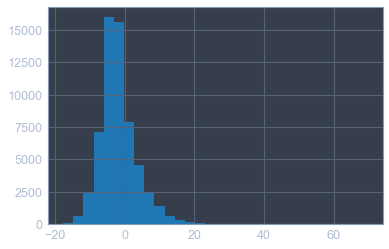

In [69]:
yp = gbm_g.y_preds['tr']
l1 = (yp - y_tr) / df_metamorph.loc[idx_tr, 'ML_bayes_err']
l1.hist(bins=30)

In [70]:
l1.mean()

-1.6858966624174105

## Train other optimizers

In [251]:
gbm_model_gi = GBMModel(morph=True, fluxes=['g', 'i'], loss='chi-sq')
gbm_model_gi.train_model()
gbm_model_gi.save_model()
gbm_model_gi.train_modelt50()
gbm_model_gi.save_model()
gbm_model_gi_chisq = gbm_model_gi

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.509033	train's Chi-sq: 14.62	eval's rmse: 0.530533	eval's Chi-sq: 16.081
[200]	train's rmse: 0.318673	train's Chi-sq: 5.73	eval's rmse: 0.352356	eval's Chi-sq: 7.093
[300]	train's rmse: 0.261635	train's Chi-sq: 3.862	eval's rmse: 0.298156	eval's Chi-sq: 5.079
[400]	train's rmse: 0.231848	train's Chi-sq: 3.033	eval's rmse: 0.266277	eval's Chi-sq: 4.051
[500]	train's rmse: 0.218259	train's Chi-sq: 2.688	eval's rmse: 0.251798	eval's Chi-sq: 3.622
[600]	train's rmse: 0.209328	train's Chi-sq: 2.472	eval's rmse: 0.242761	eval's Chi-sq: 3.367
[700]	train's rmse: 0.202755	train's Chi-sq: 2.319	eval's rmse: 0.236481	eval's Chi-sq: 3.195
[800]	train's rmse: 0.19767	train's Chi-sq: 2.205	eval's rmse: 0.231956	eval's Chi-sq: 3.074
[900]	train's rmse: 0.193432	train's Chi-sq: 2.111	eval's rmse: 0.228384	eval's Chi-sq: 2.98
[1000]	train's rmse: 0.189644	train's Chi-sq: 2.029	eval's rmse: 0.225156	eval's Chi-sq: 2.89

In [256]:
gbm_model_gi_chisq = GBMModel(morph=True, fluxes=['g', 'i'], loss='chi-sq')
gbm_model_gi_chisq.load_model()
gbm_model_gi_chisq.train_modelt50()
gbm_model_gi_chisq.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.448894	train's Chi-sq: 11.369	eval's rmse: 0.448128	eval's Chi-sq: 11.474
[200]	train's rmse: 0.260874	train's Chi-sq: 3.84	eval's rmse: 0.264206	eval's Chi-sq: 3.988
[300]	train's rmse: 0.217403	train's Chi-sq: 2.667	eval's rmse: 0.223671	eval's Chi-sq: 2.858
[400]	train's rmse: 0.206666	train's Chi-sq: 2.41	eval's rmse: 0.215098	eval's Chi-sq: 2.643
[500]	train's rmse: 0.202168	train's Chi-sq: 2.306	eval's rmse: 0.212083	eval's Chi-sq: 2.57
[600]	train's rmse: 0.199331	train's Chi-sq: 2.242	eval's rmse: 0.210545	eval's Chi-sq: 2.533
[700]	train's rmse: 0.197094	train's Chi-sq: 2.192	eval's rmse: 0.209526	eval's Chi-sq: 2.508
[800]	train's rmse: 0.19528	train's Chi-sq: 2.152	eval's rmse: 0.208985	eval's Chi-sq: 2.495
[900]	train's rmse: 0.193663	train's Chi-sq: 2.116	eval's rmse: 0.208576	eval's Chi-sq: 2.486
[1000]	train's rmse: 0.192238	train's Chi-sq: 2.085	eval's rmse: 0.208238	eval's Chi-sq: 2.47

In [252]:
gbm_model_gi_rmsle = GBMModel(morph=True, fluxes=['g', 'i'], loss='rmsle')
gbm_model_gi_rmsle.train_model()
gbm_model_gi_rmsle.save_model()
gbm_model_gi_rmsle.train_modelt50()
gbm_model_gi_rmsle.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.509033	train's rmsle: 0.14	eval's rmse: 0.530533	eval's rmsle: 0.1433
[200]	train's rmse: 0.318673	train's rmsle: 0.0914	eval's rmse: 0.352356	eval's rmsle: 0.097
[300]	train's rmse: 0.261635	train's rmsle: 0.0747	eval's rmse: 0.298156	eval's rmsle: 0.0812
[400]	train's rmse: 0.231848	train's rmsle: 0.0649	eval's rmse: 0.266277	eval's rmsle: 0.0715
[500]	train's rmse: 0.218259	train's rmsle: 0.0604	eval's rmse: 0.251798	eval's rmsle: 0.0671
[600]	train's rmse: 0.209328	train's rmsle: 0.0575	eval's rmse: 0.242761	eval's rmsle: 0.0645
[700]	train's rmse: 0.202755	train's rmsle: 0.0555	eval's rmse: 0.236481	eval's rmsle: 0.0626
[800]	train's rmse: 0.19767	train's rmsle: 0.054	eval's rmse: 0.231956	eval's rmsle: 0.0613
[900]	train's rmse: 0.193432	train's rmsle: 0.0527	eval's rmse: 0.228384	eval's rmsle: 0.0602
[1000]	train's rmse: 0.189644	train's rmsle: 0.0517	eval's rmse: 0.225156	eval's rmsle: 0.0593
[

In [260]:
gbm_model_gi_rmsle = GBMModel(morph=True, fluxes=['g', 'i'], loss='rmsle')
gbm_model_gi_rmsle.load_model()
gbm_model_gi_rmsle.train_modelt50()
gbm_model_gi_rmsle.save_model()

Training until validation scores don't improve for 100 rounds.
[100]	train's rmse: 0.448731	train's rmsle: 0.1188	eval's rmse: 0.447793	eval's rmsle: 0.1189
[200]	train's rmse: 0.260526	train's rmsle: 0.071	eval's rmse: 0.26379	eval's rmsle: 0.0718
[300]	train's rmse: 0.217005	train's rmsle: 0.0583	eval's rmse: 0.223442	eval's rmsle: 0.0596
[400]	train's rmse: 0.20627	train's rmsle: 0.055	eval's rmse: 0.214881	eval's rmsle: 0.0565
[500]	train's rmse: 0.201758	train's rmsle: 0.0538	eval's rmse: 0.212003	eval's rmsle: 0.0554
[600]	train's rmse: 0.198968	train's rmsle: 0.0531	eval's rmse: 0.210488	eval's rmsle: 0.0549
[700]	train's rmse: 0.196869	train's rmsle: 0.0525	eval's rmse: 0.209446	eval's rmsle: 0.0546
[800]	train's rmse: 0.195062	train's rmsle: 0.052	eval's rmse: 0.208822	eval's rmsle: 0.0544
[900]	train's rmse: 0.193446	train's rmsle: 0.0516	eval's rmse: 0.208256	eval's rmsle: 0.0542
[1000]	train's rmse: 0.191965	train's rmsle: 0.0513	eval's rmse: 0.20786	eval's rmsle: 0.054
Ear

## Compare different metrix (appendix B)

In [261]:
y_pred = gbm_model_gi_rmsle.y_preds['test']
y_test = df_metamorph.loc[idx_test, 'ML_bayes']
y_test_err = df_metamorph.loc[idx_test, 'ML_bayes_err']
chi_sample = (y_pred - y_test) / y_test_err
dexerr_sample = np.log10(y_pred / y_test)
rms = lambda x: np.sqrt(np.mean(np.square(x)))
mae = lambda x: np.mean(np.abs(x))

print('metric L1', mae(chi_sample))
print('metric L2', rms(chi_sample))
print('RMSLE', rms(dexerr_sample))
print('median L1', np.median(np.abs(chi_sample)))

metric L1 1.1253632876560238
metric L2 1.5295419056482285
RMSLE 0.0528853255756517
median L1 0.8636929201799194


# Testing

In [43]:
import cv2
from tqdm import tqdm

In [119]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t10_a29_cum_weighted,t10_a30_cum_weighted,t11_a31_cum_weighted,t11_a32_cum_weighted,t11_a33_cum_weighted,t11_a34_cum_weighted,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.502520,0.199998
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.024399,0.000000,0.000000,0.024399,0.000000,0.000000,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.176818,0.340460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.320800,0.107147,0.000000,0.133453,0.107147,0.160400,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.990084,0.811851
1237662500

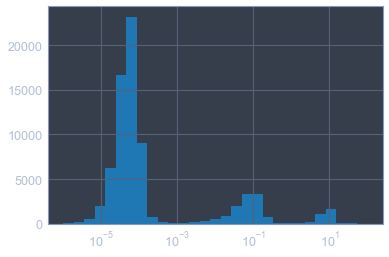

In [146]:
bins = np.logspace(-6, 2, 30)
dists = df_metamorph.loc[:, 'dist_gz2']
dists.hist(bins=bins)
plt.xscale('log')

In [149]:
dists[dists < 1e-3].max()

0.0009669912316843576

In [154]:
df_features.head()

,pre.sum.lum,pre.mean.lum,pre.max.lum,pre.min.lum,pre.std.lum,pre.center.lum,pre.mean.center.lum,pre.width,pre.scaleval,post.sum,post.mean,post.std,post.center,post.mean.center,r50_scauto_197_gz2.0,r50_scauto_197_gz2.1,r50_scauto_197_gz2.2,r50_scauto_197_gz2.3,r50_scauto_197_gz2.4,r50_scauto_197_gz2.5,r50_scauto_197_gz2.6,r50_scauto_197_gz2.7,r50_scauto_197_gz2.8,r50_scauto_197_gz2.9,r50_scauto_197_gz2.10,r50_scauto_197_gz2.11,r50_scauto_197_gz2.12,r50_scauto_197_gz2.13,r50_scauto_197_gz2.14,r50_scauto_197_gz2.15,r50_scauto_197_gz2.16,r50_scauto_197_gz2.17,r50_scauto_197_gz2.18,r50_scauto_197_gz2.19,r50_scauto_197_gz2.20,r50_scauto_197_gz2.21,r50_scauto_197_gz2.22,r50_scauto_197_gz2.23,r50_scauto_197_gz2.24,r50_scauto_197_gz2.25,r50_scauto_197_gz2.26,r50_scauto_197_gz2.27,r50_scauto_197_gz2.28,r50_scauto_197_gz2.29,r50_scauto_197_gz2.30,r50_scauto_197_gz2.31,r50_scauto_197_gz2.32,r50_scauto_197_gz2.33,r50_scauto_197_gz2.34,...,r50_scauto_197_gz2.2001.notop,r50_scauto_197_gz2.2002.notop,r50_scauto_197_gz2.2003.notop,r50_scauto_197_gz2.2004.notop,r50_scauto_197_gz2.2005.notop,r50_scauto_197_gz2.2006.notop,r50_scauto_197_gz2.2007.notop,r50_scauto_197_gz2.2008.notop,r50_scauto_197_gz2.2009.notop,r50_scauto_197_gz2.2010.notop,r50_scauto_197_gz2.2011.notop,r50_scauto_197_gz2.2012.notop,r50_scauto_197_gz2.2013.notop,r50_scauto_197_gz2.2014.notop,r50_scauto_197_gz2.2015.notop,r50_scauto_197_gz2.2016.notop,r50_scauto_197_gz2.2017.notop,r50_scauto_197_gz2.2018.notop,r50_scauto_197_gz2.2019.notop,r50_scauto_197_gz2.2020.notop,r50_scauto_197_gz2.2021.notop,r50_scauto_197_gz2.2022.notop,r50_scauto_197_gz2.2023.notop,r50_scauto_197_gz2.2024.notop,r50_scauto_197_gz2.2025.notop,r50_scauto_197_gz2.2026.notop,r50_scauto_197_gz2.2027.notop,r50_scauto_197_gz2.2028.notop,r50_scauto_197_gz2.2029.notop,r50_scauto_197_gz2.2030.notop,r50_scauto_197_gz2.2031.notop,r50_scauto_197_gz2.2032.notop,r50_scauto_197_gz2.2033.notop,r50_scauto_197_gz2.2034.notop,r50_scauto_197_gz2.2035.notop,r50_scauto_197_gz2.2036.notop,r50_scauto_197_gz2.2037.notop,r50_scauto_197_gz2.2038.notop,r50_scauto_197_gz2.2039.notop,r50_scauto_197_gz2.2040.notop,r50_scauto_197_gz2.2041.notop,r50_scauto_197_gz2.2042.notop,r50_scauto_197_gz2.2043.notop,r50_scauto_197_gz2.2044.notop,r50_scauto_197_gz2.2045.notop,r50_scauto_197_gz2.2046.notop,r50_scauto_197_gz2.2047.notop,redshift,d_pix_kpc
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237645879578460255,1.677568e+07,1108.842721,120081.973917,-11193.145374,5918.939360,118214.070367,83053.235891,123,28.777936,4918.47,0.098024,0.134287,0.960285,0.932042,0.478470,0.500767,0.020763,0.313108,0.187659,0.026418,0.161241,0.104562,0.083097,0.002991,0.116534,0.060867,0.007267,0.102270,0.876968,0.175626,0.223926,0.600448,0.014018,0.009072,0.021433,0.015786,0.028490,0.013470,0.00000,0.185133,0.020312,0.107662,0.044273,0.039052,0.021237,0.010907,0.039915,0.000000,0.000000,...,0.0,0.0,0.000000,0.419165,0.0,0.043426,0.000000,0.000000,0.0,0.026036,0.085248,0.017091,0.0,0.001851,0.000000,0.373822,0.040094,0.000000,0.434619,0.000000,0.0,0.127402,0.000000,0.000000,0.000000,0.0,0.000000,0.043323,0.036078,0.285451,0.0,0.054541,0.000000,0.0,0.305673,0.0,0.000000,0.0,0.000000,0.489177,0.000000,0.212933,0.123509,0.000000,0.0,0.035646,0.295623,0.1213,1.008135
1237645941824356443,1.315777e+08,950.816184,81600.327817,-2185.093425,1916.093672,73178.871336,60356.808305,372,131.452257,5817.36,0.115939,0.116485,0.972291,0.914552,0.365805,0.454698,0.179497,0.359130,0.095569,0.025574,0.069995,0.071676,0.023893,0.000000,0.049261,0.036608,0.009700,0.052088,0.768415,0.201001,0.286599,0.512400,0.003049,0.005331,0.004726,0.000000,0.023159,0.015443,0.00038,0.188076,0.005762,0.165292,0.057638,0.014038,0.000000,0.002556,0.010689,0.006664,0.005807,...,0.0,0.0,0.019311,0.102425,0.0,0.270107,0.000000,0.040571,0.0,0.000000,0.011425,0.037226,0.0,0.116023,0.053348,0.250478,0.242314,0.024494,0.104177,0.000000,0.0,0.198361,0.0

In [180]:
df_metamorph.head()

,RA,DEC,D25,redshift,GalSize_kpc,D_Mpc,d_pix_kpc,reduced_chi_square,logM_bayes,logM_bayes_err,L_g_bayes,L_g_bayes_err,hasimg,isgalaxy,M_bayes,M_bayes_err,ML_bayes,ML_bayes_err,mag_g,mag_i,ML_zibetti,RA_leda,DEC_leda,D25_leda,R25_leda,pa_leda,id_gz1,dist_gz1,id_gz2,dist_gz2,NVOTE,P_EL,P_CW,P_ACW,P_EDGE,P_DK,P_MG,P_CS,P_EL_DEBIASED,P_CS_DEBIASED,SPIRAL,ELLIPTICAL,UNCERTAIN,ra_gz1,dec_gz1,objid_gz1,sample,gz2_class,total_classifications,...,t11_a36_cum_weighted,t11_a37_cum_weighted,t01_a01_cum_debias,t01_a02_cum_debias,t01_a03_cum_debias,t02_a04_cum_debias,t02_a05_cum_debias,t03_a06_cum_debias,t03_a07_cum_debias,t04_a08_cum_debias,t04_a09_cum_debias,t05_a10_cum_debias,t05_a11_cum_debias,t05_a12_cum_debias,t05_a13_cum_debias,t06_a14_cum_debias,t06_a15_cum_debias,t07_a16_cum_debias,t07_a17_cum_debias,t07_a18_cum_debias,t08_a19_cum_debias,t08_a20_cum_debias,t08_a21_cum_debias,t08_a22_cum_debias,t08_a23_cum_debias,t08_a24_cum_debias,t08_a38_cum_debias,t09_a25_cum_debias,t09_a26_cum_debias,t09_a27_cum_debias,t10_a28_cum_debias,t10_a29_cum_debias,t10_a30_cum_debias,t11_a31_cum_debias,t11_a32_cum_debias,t11_a33_cum_debias,t11_a34_cum_debias,t11_a36_cum_debias,t11_a37_cum_debias,modelMag_g,modelMag_i,ML_zibetti_modelmag,avg_AB,ML_zibetti_modelmaglogprev,ML_zibetti_minlfsq,ML_zibetti_minchi,modelMag_u,modelMag_r,modelMag_z
SDSS_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1237662301367173202,231.31860,41.34601,0.512861,0.0761,48.655727,326.142854,0.632474,3.980811,10.328326,0.057643,8.880467e+09,8.891944e+07,True,True,2.129739e+10,2.826764e+09,2.398229,0.318312,18.100,16.927,2.553861,231.318646,41.346012,0.516416,4.677351,52.77,552094,0.000016,131054,0.191547,43,0.163,0.000,0.000,0.837,0.000,0.0,0.837,0.032,0.968,1,0,0,231.318583,41.346000,588018055118979181,original,Er,44,...,0.000,0.000000,0.853440,0.065803,0.080758,0.000000,0.065803,0.000000,0.065803,0.000000,0.065803,0.000000,0.000000,0.065803,0.000000,0.319856,0.599386,0.773361,0.080079,0.00000,0.000000,0.000000,0.000000,0.000000,0.319848,0.000008,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,18.16554,16.96688,2.373405,0.199998,2.502520,2.446654,2.459747,20.35955,17.40932,16.63860
1237662301905813735,236.00985,39.28830,0.446684,0.0685,38.145197,293.571417,0.569310,0.537818,9.834362,0.037180,7.007162e+09,4.118548e+07,True,True,6.829077e+09,5.846309e+08,0.974585,0.083433,18.028,17.298,1.054716,236.009916,39.288303,0.441570,2.897344,131.08,572069,0.000104,177157,0.094953,27,0.148,0.037,0.222,0.593,0.000,0.0,0.852,0.036,0.964,1,0,0,236.009958,39.288361,588018055657619729,original,SBb2m,41,...,0.000,0.000000,0.104520,0.895480,0.000000,0.008608,0.886873,0.741942,0.144931,0.873702,0.013170,0.000000,0.191614,0.695259,0.000000,0.470153,0.529847,0.001058,0.089841,0.01362,0.380599,0.000000,0.023430,0.012257,0.027839,0.026028,0.0,0.000000,0.008608,0.0,0.000000,0.873702,0.000000,0.000000,0.873702,0.000000,0.000000,0.000000,0.000000,18.09630,17.32951,1.153118,0.340460,1.176818,1.035656,1.086128,19.38518,17.61691,17.15460
1237662534360301834,237.49500,9.27861,0.630957,0.0390,30.677076,167.142861,0.324133,0.280960,9.851568,0.057156,1.047446e+10,5.972507e+07,True,True,7.105062e+09,9.350765e+08,0.678322,0.089272,16.279,15.684,0.805557,237.494992,9.278609,0.629506,1.312200,155.89,577778,0.000041,37238,0.000052,68,0.103,0.029,0.765,0.088,0.015,0.0,0.882,0.103,0.882,1,0,0,237.494958,9.278611,587736813135397122,original,Sc?m,38,...,0.000,0.240600,0.091535,0.908465,0.000000,0.000000,0.908465,0.154953,0.753512,0.901004,0.007460,0.085446,0.788886,0.000000,0.034132,0.234249,0.765751,0.037177,0.054358,0.00000,0.000000,0.029814,0.091769,0.112666,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.321991,0.443565,0.135449,0.000000,0.144137,0.176307,0.261280,0.000000,0.319281,16.43015,15.76226,0.977420,0.811851,0.990084,0.850581,0.900704,17.51221,16.00672,15.59723
1237662500543987740,242.00880,36.05398,

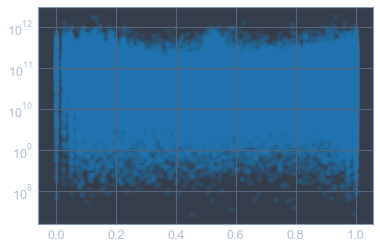

In [181]:
p_edge = df_metamorph['t01_a02_cum_debias']
m_star = df_metamorph['M_bayes']
plt.scatter(p_edge, m_star, alpha=0.2)
plt.yscale('log')

In [182]:
from scipy.stats import spearmanr

spearmanr(p_edge.values, m_star.values)

SpearmanrResult(correlation=0.03060104012386116, pvalue=9.966777318025004e-17)

In [150]:
print('Amount less than 3.6 arcsec:', len(dists[dists < 1e-3]))
print('Amount less than 1 arcsec:', len(dists[dists < 1e-3/3.6]))

Amount less than 3.6 arcsec: 58966
Amount less than 1 arcsec: 58716


In [152]:
(58966 - 58716) / 58966

0.004239731370620357

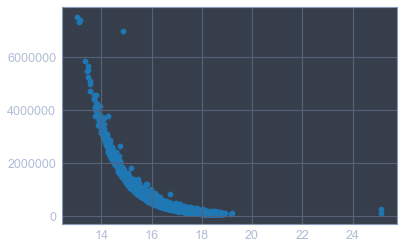

In [43]:
plt.scatter(df_metamorph.loc[idx_test, 'modelMag_g'], df_metamorph.loc[idx_test, 'L_g_bayes'] / np.square(df_metamorph.loc[idx_test, 'D_Mpc']))

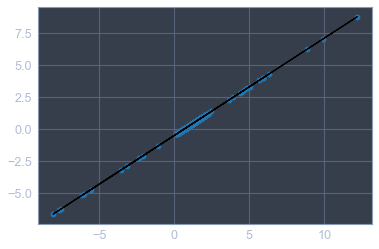

In [59]:
sx = df_metamorph.loc[idx_tr, 'modelMag_g'] - df_metamorph.loc[idx_tr, 'modelMag_i']
sy = np.log10(df_metamorph.loc[idx_tr, 'ML_zibetti_modelmag'])
plt.scatter(sx, sy)
sypred = (a / -2.5) * sx + b
plt.plot(sx, sypred, 'k')

In [61]:
i = 5000
srico = (sy - sy.iloc[i]) / (sx - sx.iloc[i])
sa = -2.5 * srico
sb = ((-sx.iloc[i]) * srico) + sy.iloc[i]
a = sa.iloc[0]
b = sb.iloc[0]
print(f'a {a:.3f}, b {b:.3f}, a\' {a/(-2.5):.3f}')

a -1.897, b -0.511, a' 0.759


In [62]:
ml_zib = df_metamorph.loc[idx_test, 'ML_zibetti_modelmag']
ml_true = df_metamorph.loc[idx_test, 'ML_bayes']
ratio = ml_zib / ml_true

In [64]:
ratio.sort_values()

SDSS_ID
1237658802034900998    3.735813e-01
1237663783663108378    3.906943e-01
1237660764300116207    4.940326e-01
1237672796109733939    5.054417e-01
1237667429032984707    5.293761e-01
1237658303277105373    5.340508e-01
1237662225689804887    5.351006e-01
1237658917455790210    5.452110e-01
1237660635991900321    5.480892e-01
1237668584896921853    5.488225e-01
1237665428097073283    5.592292e-01
1237661382241157294    5.630755e-01
1237651735762698420    5.734647e-01
1237654600493105271    5.779461e-01
1237670359251812836    5.783244e-01
1237665428089995515    5.819975e-01
1237667911665582165    5.876273e-01
1237667915953340609    5.945574e-01
1237657873790337143    5.966026e-01
1237665428096221225    6.012626e-01
1237659896173166973    6.016920e-01
1237661065493217556    6.067074e-01
1237665427562627344    6.075056e-01
1237662701332136316    6.166973e-01
1237674459876295136    6.186319e-01
1237668296595669099    6.199325e-01
1237662302981783955    6.201535e-01
1237661851480227995 

In [66]:
ratio.sort_values()[:-2].mean()

1.0565666237882962

In [67]:
ratio.sort_values()[:-2].std()

0.2436517241468873

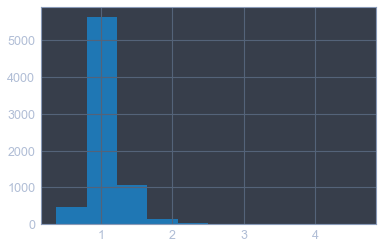

In [65]:
ratio.sort_values()[:-2].hist()

In [89]:
df_full.shape

(84722, 25)

In [67]:
x = np.random.randn(50000, 69, 69, 1)
M = cv2.getRotationMatrix2D((34, 34), 45, 1)
y = np.zeros((50000, 69, 69, 1))

In [58]:
cv2.warpAffine(x[0, ...], M, (69, 69)).shape

(69, 69)

In [68]:
for i in tqdm(range(x.shape[0])):
    y[i, ...] = np.expand_dims(cv2.warpAffine(x[i, ...], M, (69, 69)), axis=-1)

100%|██████████| 50000/50000 [00:03<00:00, 12587.50it/s]


In [70]:
x = np.random.randn(30, 15, 5)
y = np.zeros_like(x)

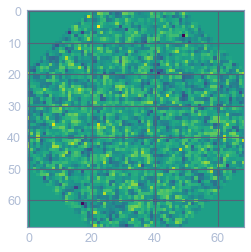

In [69]:
plt.imshow(y[555, ...].squeeze())

In [84]:
x = np.random.randn(4, 5, 1)

In [168]:
ns = np.logspace(0, 4, 30)
li_mean = [np.median(np.abs(np.random.randn(int(n)))) for n in ns]

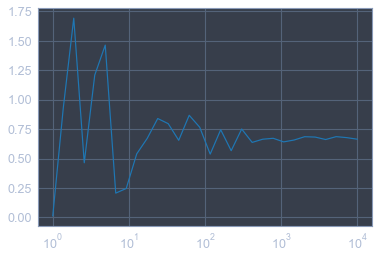

In [169]:
plt.plot(ns, np.array(li_mean))
plt.xscale('log')

In [86]:
y = np.repeat(x, repeats=3, axis=-1)

In [90]:
y[2, 3, 0] -= 1
y[2, 3, 1] -= 2

In [91]:
y[2, 3, :]

array([-1.11999975, -2.11999975, -0.11999975])

In [16]:
x = ht.get_galaxydata(1237645943975837722)
x = (x - x.min()) / (x.max() - x.min())

(array([1.9351e+04, 8.3700e+02, 3.6000e+02, 2.2300e+02, 1.0800e+02,
        8.7000e+01, 4.1000e+01, 1.0000e+01, 4.0000e+00, 4.0000e+00]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <a list of 10 Patch objects>)

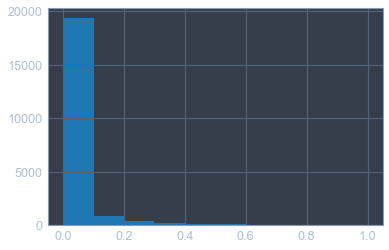

In [17]:
plt.hist(x.flatten())

In [23]:
p = x.flatten()
li_preds = np.linspace(0, 0.5, 100)
li_xe = []
for pred in li_preds:
    xe1 = np.mean((-1)*p*np.log10(pred))
    xe2 = np.mean((-1)*(1 - p)*np.log10(1-pred))
    li_xe.append(xe1 + xe2)
#print(xe1 + xe2, xe1, xe2)

/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:5: RuntimeWarning: divide by zero encountered in log10
/Users/wouterdobbels/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:5: RuntimeWarning: invalid value encountered in multiply


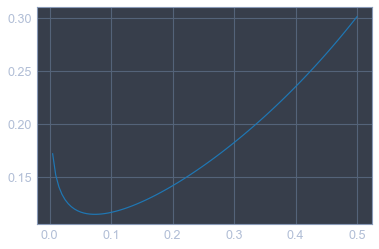

In [24]:
plt.plot(li_preds, li_xe)

In [15]:
pd.Series(x.flatten()).describe()

count    21025.000000
mean         0.010793
std          0.045339
min         -0.038246
25%         -0.004912
50%          0.001620
75%          0.008938
max          0.626198
dtype: float64

In [38]:
np.sum(df_metamorph.loc[idx_test, 'ML_bayes'] > 9)

4

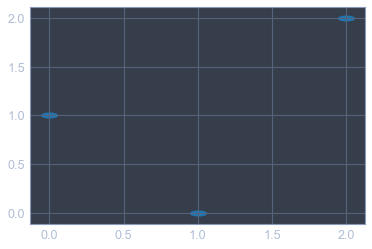

In [41]:
x = [0, 1, 2]
y = [1, 0, 2]

rx, ry = 3., 1.
area = rx * ry * np.pi
theta = np.arange(0, 2 * np.pi + 0.01, 0.1)
verts = np.column_stack([rx / area * np.cos(theta), ry / area * np.sin(theta)])

plt.scatter(x, y, s=300, marker=None, verts=verts)

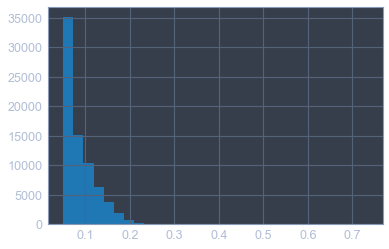

In [29]:
re = df_metamorph['ML_bayes_err'] / df_metamorph['ML_bayes']
re.hist(bins=30)

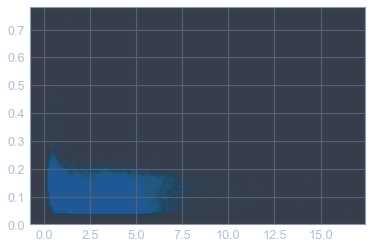

In [37]:
plt.scatter(df_metamorph['ML_bayes'], re, alpha=0.03)

In [31]:
np.sum(re <= (0.05 + 1e-7))

18927

In [32]:
df_metamorph.shape

(73627, 390)

In [33]:
18927 / 73627

0.25706602197563394

In [42]:
verts.shape

(63, 2)

In [24]:
dir(pc)

['_A',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_agg_filter',
 '_alpha',
 '_animated',
 '_antialiaseds',
 '_axes',
 '_bcast_lwls',
 '_capstyle',
 '_clipon',
 '_clippath',
 '_contains',
 '_edge_default',
 '_edgecolors',
 '_facecolors',
 '_factor',
 '_gid',
 '_hatch',
 '_hatch_color',
 '_is_filled',
 '_is_stroked',
 '_joinstyle',
 '_label',
 '_linestyles',
 '_linewidths',
 '_mouseover',
 '_offset_position',
 '_offsets',
 '_oid',
 '_original_edgecolor',
 '_original_facecolor',
 '_path_effects',
 '_paths',
 '_picker',
 '_pickradius',
 '_prepare_points',
 '_prop_order',
 '_propobservers',
 '_rasterized',
 '_remove_method',
 '_set_edgecolor',
 '_set_

In [29]:
p1 = pc.get_paths()

In [35]:
p1[0]

Path(array([[ 0.        , -0.5       ],
       [ 0.13260155, -0.5       ],
       [ 0.25978994, -0.44731685],
       [ 0.35355339, -0.35355339],
       [ 0.44731685, -0.25978994],
       [ 0.5       , -0.13260155],
       [ 0.5       ,  0.        ],
       [ 0.5       ,  0.13260155],
       [ 0.44731685,  0.25978994],
       [ 0.35355339,  0.35355339],
       [ 0.25978994,  0.44731685],
       [ 0.13260155,  0.5       ],
       [ 0.        ,  0.5       ],
       [-0.13260155,  0.5       ],
       [-0.25978994,  0.44731685],
       [-0.35355339,  0.35355339],
       [-0.44731685,  0.25978994],
       [-0.5       ,  0.13260155],
       [-0.5       ,  0.        ],
       [-0.5       , -0.13260155],
       [-0.44731685, -0.25978994],
       [-0.35355339, -0.35355339],
       [-0.25978994, -0.44731685],
       [-0.13260155, -0.5       ],
       [ 0.        , -0.5       ],
       [ 0.        , -0.5       ]]), array([ 1,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
        

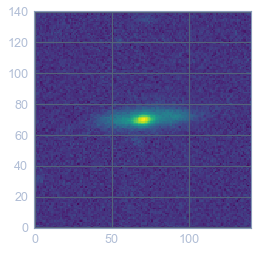

In [43]:
ht.plot_galaxy(1237650761325084915)

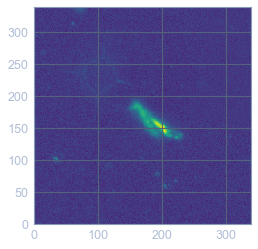

In [44]:
ht.plot_galaxy(1237652943694463423)

In [70]:
y_test.index[3075]

1237657118943019245

In [61]:
dir(df_metamorph.index.astype(str).str)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__frozen',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__iter__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_data',
 '_freeze',
 '_is_categorical',
 '_make_accessor',
 '_orig',
 '_wrap_result',
 'capitalize',
 'cat',
 'center',
 'contains',
 'count',
 'decode',
 'encode',
 'endswith',
 'extract',
 'extractall',
 'find',
 'findall',
 'get',
 'get_dummies',
 'index',
 'isalnum',
 'isalpha',
 'isdecimal',
 'isdigit',
 'islower',
 'isnumeric',
 'isspace',
 'istitle',
 'isupper',
 'join',
 'len',
 'ljust',
 'lower',
 'lstrip',
 'match',
 'normalize',
 'pad',
 'partition',
 'repeat',
 'replace',
 'rfind',
 'rindex',
 'rjust',
 'rpartition',
 'rsplit',
 'rstrip',
 'slice',
 'slice_replace',
 

In [51]:
y_test.index[4259]

1237650761325084915

## Color histogram with transparency

In [ ]:
# matplotlib hist2d code
# h, xedges, yedges = np.histogram2d(x, y, bins=bins, range=range,
#                                            normed=normed, weights=weights)

#         if cmin is not None:
#             h[h < cmin] = None
#         if cmax is not None:
#             h[h > cmax] = None

#         pc = self.pcolormesh(xedges, yedges, h.T, **kwargs)
#         self.set_xlim(xedges[0], xedges[-1])
#         self.set_ylim(yedges[0], yedges[-1])

(array([[  0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.],
        [  0.,   1.,   2.,   0.,   3.,   5.,   3.,   1.,   0.,   0.],
        [  1.,   4.,   8.,  27.,  37.,  30.,  19.,   8.,   2.,   0.],
        [  0.,   8.,  28.,  47.,  92.,  95.,  53.,  26.,   4.,   2.],
        [  1.,  16.,  51., 129., 205., 197., 108.,  39.,  13.,   2.],
        [  0.,  16.,  67., 148., 245., 234., 123.,  57.,  13.,   3.],
        [  0.,  10.,  34.,  92., 135., 139.,  94.,  28.,  15.,   3.],
        [  1.,   2.,  21.,  44.,  49.,  55.,  28.,  13.,   1.,   1.],
        [  0.,   1.,   3.,   6.,  17.,  12.,  10.,   2.,   0.,   1.],
        [  0.,   0.,   0.,   1.,   3.,   1.,   2.,   1.,   1.,   0.]]),
 array([-3.93165092, -3.18546629, -2.43928166, -1.69309703, -0.9469124 ,
        -0.20072777,  0.54545685,  1.29164148,  2.03782611,  2.78401074,
         3.53019537]),
 array([-3.39373038, -2.70886969, -2.024009  , -1.33914831, -0.65428763,
         0.03057306,  0.71543375,  1.40029443,  2.085155

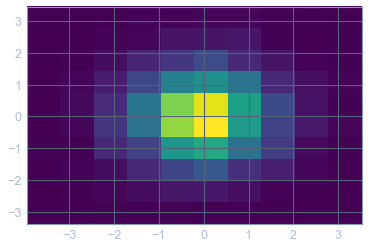

In [109]:
n = 3000
x = np.random.randn(n)
y = np.random.randn(n)
c = np.random.randn(n)
plt.hist2d(x, y)

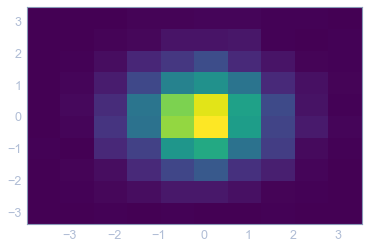

In [116]:
dens, xedges, yedges = np.histogram2d(x, y)
f, ax = plt.subplots()
ax.pcolormesh(xedges, yedges, dens.T)

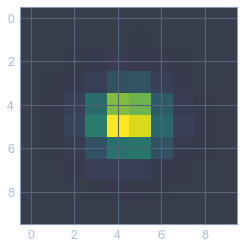

In [130]:
# color and alpha based on density
from matplotlib.colors import Normalize
cmap = plt.cm.viridis
color = Normalize()(dens)  # needs to be color in the end
color = cmap(color)
color[..., -1] = dens / np.max(dens)
f, ax = plt.subplots()
ax.imshow(color)
plt.show()

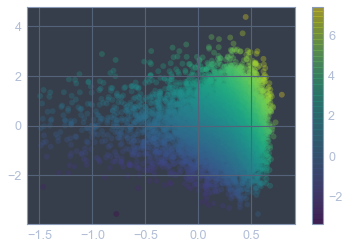

In [243]:
from matplotlib.colors import Normalize
cmap = plt.cm.viridis

n = 10000
x = np.log10(np.abs(np.random.randn(n)+2))
x[x<-1.5] = 0
y = np.random.randn(n)
c = np.power(10, x)+y

plt.scatter(x, y, c=c, alpha=0.3)
plt.colorbar()

In [245]:
xedges.shape

(31,)

In [251]:
def avg_color(ix, iy):
    xl, xr = xedges[ix], xedges[ix+1]
    yl, yr = yedges[iy], yedges[iy+1]
    li_c = []
    li_i = []
    for i, cpoint in enumerate(c):
        if (x[i] >= xl) and (x[i] < xr) and (y[i] >= yl) and (y[i] <= yr):
            li_c.append(cpoint)
            li_i.append(i)
    return li_i

c[avg_color(25,15)].mean()

3.3511908760076103

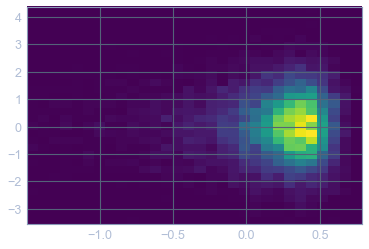

In [258]:
plt.hist2d(x, y, bins=30);

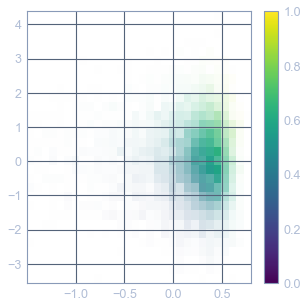

In [278]:
def avg_color(ix, iy):
    xl, xr = xedges[ix], xedges[ix+1]
    yl, yr = yedges[iy], yedges[iy+1]
    li_c = []
    n = 0
    for i, cpoint in enumerate(c):
        if (x[i] >= xl) and (x[i] < xr) and (y[i] >= yl) and (y[i] < yr):
            li_c.append(cpoint)
            n += 1
    if li_c:
#         return dens.T[iy, ix]
#         return n
        return np.mean(li_c)
    return 0

# gridding
dens, xedges, yedges = np.histogram2d(x, y, bins=30)

# create color array
arr_c = np.zeros_like(dens)
for iy in range(arr_c.shape[0]):
    for ix in range(arr_c.shape[1]):
        arr_c[iy, ix] = avg_color(ix, iy)
        
color = Normalize()(arr_c)
color = cmap(color)
color[..., -1] = (dens.T - dens.min()) / (dens.max() - dens.min())

f, ax = plt.subplots(figsize=(5, 5))
ax.set_facecolor((1, 1, 1))
plt.imshow(color, extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], origin='lower',
          aspect='auto')
plt.colorbar()
#ax.set_aspect(1, adjustable='box')
plt.show()

## Benchmark without numba

In [279]:
dens, xedges, yedges = np.histogram2d(x, y, bins=60)

In [324]:
%%timeit
def avg_color(ix, iy):
    xl, xr = xedges[ix], xedges[ix+1]
    yl, yr = yedges[iy], yedges[iy+1]
    li_c = []
    for i, cpoint in enumerate(c):
        if (x[i] >= xl) and (x[i] < xr) and (y[i] >= yl) and (y[i] <= yr):
            li_c.append(cpoint)
    if li_c:
        return np.mean(li_c)
    return 0

# create color array
arr_c = np.zeros_like(dens)
for iy in range(arr_c.shape[0]):
    for ix in range(arr_c.shape[1]):
        arr_c[iy, ix] = avg_color(ix, iy)

10.5 s ± 444 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


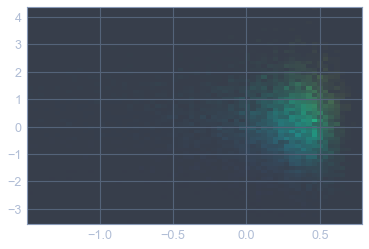

In [282]:
color = Normalize()(arr_c)  # needs to be color in the end
color = cmap(color)
color[..., -1] = dens.T / np.max(dens)

f, ax = plt.subplots()
ax.set_facecolor((1, 1, 1))
ax.imshow(color, extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], origin='lower',
          aspect='auto')
plt.show()

## Benchmark with numba

In [297]:
dens, xedges, yedges = np.histogram2d(x, y, bins=60)

In [186]:
from numba import jit

In [303]:
(x > 1) & (x > 2)

array([False, False, False, ..., False, False, False])

In [323]:
%%timeit

@jit(nopython=True)
def avg_color_np(ix, iy, xedges, yedges, x, y, c, nbins):
    xl, xr = xedges[ix], xedges[ix+1]
    yl, yr = yedges[iy], yedges[iy+1]
    li_c = np.zeros(nbins)
    j = 0
    sub = c[(x >= xl) & (x <= xr) & (y >= yl) & (y <= yr)]
    if len(sub) > 0:
        return sub.mean()
    return 0

@jit(nopython=True)
def avg_color(ix, iy, xedges, yedges, x, y, c, nbins):
    xl, xr = xedges[ix], xedges[ix+1]
    yl, yr = yedges[iy], yedges[iy+1]
    li_c = np.zeros(nbins)
    j = 0
    for i, cpoint in enumerate(c):
        if (x[i] >= xl) and (x[i] <= xr) and (y[i] >= yl) and (y[i] <= yr):
            li_c[j] = cpoint
            j += 1
    if j > 0:
        return np.mean(li_c)
    return 0
#     for i, cpoint in enumerate(c):
#         if (x[i] >= xl) and (x[i] <= xr) and (y[i] >= yl) and (y[i] <= yr):
#             li_c[j] = cpoint
#             j += 1
#     if j != nbins:
#         print(f'index {ix}, {iy} has nbins {nbins} and j {j}')
#     if j > 0:
#         return np.mean(li_c)
#     return 0

@jit(nopython=True)
def create_color_array(x, y, c, xedges, yedges, dens):
    arr_c = np.zeros_like(dens)
    for iy in range(arr_c.shape[0]):
        for ix in range(arr_c.shape[1]):
            arr_c[iy, ix] = avg_color_np(ix, iy, xedges, yedges, x, y, c, dens[ix, iy])
    return arr_c
            
arr_c = create_color_array(x, y, c, xedges, yedges, dens.astype(np.int))

428 ms ± 31.5 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


* numba avg_color with for loop: 300 ms +- 16 ms per loop
* numba avg_color with numpy array ands: 428 ms +- 31.5 ms per loop
* without numba: 10.5 s +- 444 ms per loop

In [325]:
color.shape

(60, 60, 4)

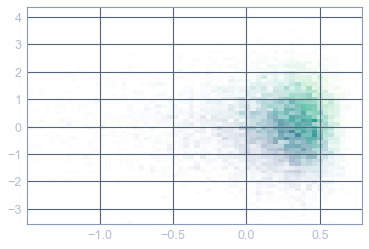

In [321]:
color = Normalize()(arr_c)  # needs to be color in the end
color = cmap(color)
color[..., -1] = dens.T / np.max(dens)

f, ax = plt.subplots()
ax.set_facecolor((1, 1, 1))
ax.imshow(color, extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]], origin='lower',
          aspect='auto')
plt.show()

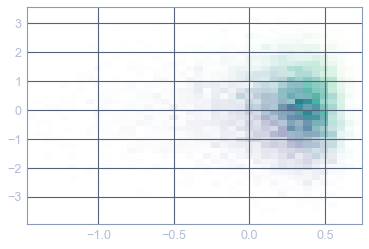

In [330]:
%autoreload
from customplots import color_hist2d

n = 10000
x = np.log10(np.abs(np.random.randn(n)+2))
x[x<-1.5] = 0
y = np.random.randn(n)
c = np.power(10, x)+y
color_hist2d(x, y, c, bins=40)